## Analysis of wafer thickness measurements

This utility takes raw thickness measurement data (such as ellipsometry) of a wafer and computes mean, sigma and physical correlation length for the thickness variations.

In this example, the variations are measured in nanometers.

1. Import python dependencies and specify functions
2. Read out the measurement data, and process it against a nominal thickness value, in this case, 200 nm
3. select either the whole sample or process a section from the total sample
4. 


<img src="./images/wafer_map.png?gx" style="width: 70%; float:left"/>

In [137]:
"""
Import dependencies
"""
import numpy as np
import matplotlib.pyplot as plt
import matplotlib, random, time, warnings, os, sys, csv, warnings
from scipy.io import loadmat
from copy import deepcopy
from scipy import interpolate
from tqdm import tqdm, tqdm_notebook
from scipy.optimize import curve_fit
from scipy.optimize import differential_evolution


font = {'family' : 'arial',
        'weight': 'normal',
        'size'   : 12}

matplotlib.rc('font', **font)

# functions used throughout the program

#function to plot the raw data and the fit curve
def ModelAndScatterPlot(xData, yData, xscale, yscale, graphWidth=800, graphHeight=600, plot='y'):

    # create data for the fitted equation plot
    xModel = numpy.linspace(min(xData), max(xData))
    yModel = func(xModel, *fittedParameters)
    
    ydiff = np.diff(yModel)/np.diff(xModel)
    if(np.argmin(ydiff>=0.15)>0): #TOLERANCE
        fit = 1
    else:
        fit = 0
    if(plot=='y'):
        f = plt.figure(figsize=(graphWidth/100.0, graphHeight/100.0), dpi=300)
        axes = f.add_subplot(111)
        # first the raw data as a scatter plot
        axes.plot((xData*(xscale[1]-xscale[0])) + xscale[0], (yData*(yscale[1]-yscale[0])) + yscale[0],  'D')    
        # now the model as a line plot
        axes.plot((xModel*(xscale[1]-xscale[0])) + xscale[0], (yModel*(yscale[1]-yscale[0])) + yscale[0])
        axes.plot((xModel[1:]*(xscale[1]-xscale[0])) + xscale[0], ydiff)
        axes.set_xlabel('X Data') # X axis data label
        axes.set_ylabel('Y Data') # Y axis data label
        plt.show()
        plt.close('all') # clean up after using pyplot
    
    return (xModel*(xscale[1]-xscale[0])) + xscale[0], (yModel*(yscale[1]-yscale[0])) + yscale[0], fit

# sigmoid function
def func(x, a, b, Offset): # Sigmoid A With Offset from zunzun.com
    return  1.0 / (1.0 + numpy.exp(-a * (x-b))) + Offset


# function for genetic algorithm to minimize (sum of squared error)
def sumOfSquaredError(parameterTuple):
    warnings.filterwarnings("ignore") # do not print warnings by genetic algorithm
    val = func(xData, *parameterTuple)
    return numpy.sum((yData - val) ** 2.0)

# function to define initial parameters for the sigmoid curve
def generate_Initial_Parameters():
    # min and max used for bounds
    maxX = max(xData)
    minX = min(xData)
    maxY = max(yData)
    minY = min(yData)

    parameterBounds = []
    parameterBounds.append([minX, maxX]) # seach bounds for a
    parameterBounds.append([minX, maxX]) # seach bounds for b
    parameterBounds.append([minX, maxY]) # seach bounds for Offset

    # "seed" the numpy random number generator for repeatable results
    result = differential_evolution(sumOfSquaredError, parameterBounds, seed=3)
    return result.x
    

In [138]:
#Define nominal thickness and read thickness measurement data

nominal_w = 220 #in nm
avg_h = [[],[]]
filename ='./ANT_waferpro/WaferPro_FineScan_50mm.csv'

tot_hx_array = []
tot_hy_array = []
tot_dh = []

count = 0
#filename = 'data_faster_uniform(div=20).csv'
with open(filename) as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    for row in csv_reader:
        
        if(count>0):
            tot_hx_array.append(float(row[0])*1e3)
            tot_hy_array.append(float(row[1])*1e3)
            tot_dh.append(float(row[2])-nominal_w)
            
        else:
            print(row)
            count+=1



['Die x (mm)', 'Die y (mm)', 'Site 1 Layer 1 Thickness (nm)', 'Site 1 Layer 2 Thickness (nm)', 'Site 1 Original Point Order']


<Figure size 432x288 with 0 Axes>

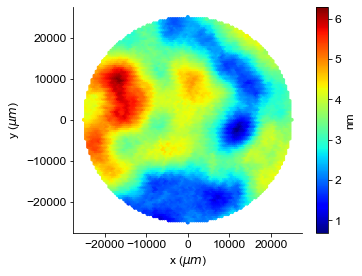

In [139]:
fig = plt.figure()
ogfig = plt.figure()
fig = plt.subplot(111)
plt.scatter( tot_hx_array, tot_hy_array,  c = tot_dh, s=10,  cmap = 'jet', marker = 'h')
ogfig.set_size_inches(5.25, 4)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().yaxis.set_ticks_position('left')
plt.gca().xaxis.set_ticks_position('bottom')
plt.xlabel(r'x ($\mu m$)')
plt.ylabel(r'y ($\mu m$)')
plt.tight_layout()
colorbar = plt.colorbar()
colorbar.set_label('nm')
plt.tight_layout()
plt.savefig('./images/wafer_map.png', dpi=300)
plt.show()


### Select a die sample from the wafer map

Specify a virtual die size ($\mu m$) and origin ($\mu m$)

<img src="./images/slice_map.png?a" style="width: 70%; float: left"/>


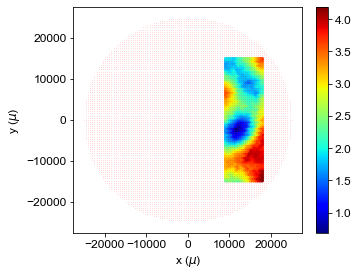

2.5616909604519775 0.7852465072750018


In [174]:
#select a wafer slice

origin_places = [-13500, -4500, 4500, 13500] #

origin = [origin_places[3],0]
yspan = 30000
xspan = 9000
tot_hx_arr = []
tot_hy_arr = []
all_dh = []
for i in range(len(tot_hx_array)):
    temp_x = tot_hx_array[i]
    temp_y = tot_hy_array[i]
    
    if(temp_x >= origin[0]-(xspan/2) and temp_x< origin[0]+(xspan/2)):
        if(temp_y >= origin[1]-(yspan/2) and temp_y< origin[1]+(yspan/2)):
            tot_hx_arr.append(temp_x)
            tot_hy_arr.append(temp_y)
            all_dh.append(tot_dh[i])
np.mean(all_dh), np.std(all_dh)
fig = plt.figure()
plt.plot(tot_hx_array, tot_hy_array, 'rx', markersize = .05)
#plt.plot(tot_hx_arr, tot_hy_arr, 'bx', markersize = 1)
plt.scatter( tot_hx_arr, tot_hy_arr,  c = all_dh, s=10,  cmap = 'jet', marker = 'h')
fig.set_size_inches(5.25,4)
plt.colorbar()
plt.tight_layout()
plt.xlabel(r'x ($\mu$)')
plt.ylabel(r'y ($\mu$)')
plt.tight_layout()
#plt.xlim(left=-24495, right=-24485)
#plt.ylim(top=10, bottom = -10)
#plt.savefig('./images/slice_map.png', dpi=300)
plt.show()

print(np.mean(all_dh), np.std(all_dh))

### Plot Cumulative Distribution Function (CDF) for the variations

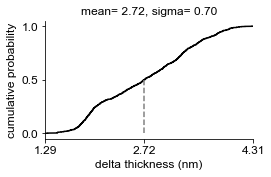

In [115]:
temp_data = all_dh
fig = plt.figure()
h, edges = np.histogram(temp_data, density=False, bins=len(temp_data))
h = np.cumsum(h)/np.cumsum(h).max()
X = edges.repeat(2)[:-1]
y = np.zeros_like(X)
y[1:] = h.repeat(2)
plt.plot(X, y, 'k')
plt.plot([round(np.mean(temp_data),2), round(np.mean(temp_data),2)],[0, 0.5], linestyle='--', color= 'grey')
plt.xlim(left =min(temp_data), right= max(temp_data))
plt.xticks([round(min(temp_data),2), np.mean(temp_data), round(max(temp_data),2)], [round(min(temp_data),2), round(np.mean(temp_data),2), round(max(temp_data),2)])
plt.yticks([0, 0.5, 1])
plt.xlabel('delta thickness (nm)')
plt.ylabel('cumulative probability', fontsize=12)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().yaxis.set_ticks_position('left')
plt.gca().xaxis.set_ticks_position('bottom')

#plt.title('mean = '+str(np.mean(temp_data))[0:5]+' (nm), sigma = '+ str(np.std(temp_data))[0:5]+' (nm)', fontsize = 18)
fig.set_size_inches(1.5*2.625, 2.625)
plt.title('mean= ' +str(np.mean(temp_data))[:4]+', sigma= ' + str(np.std(temp_data))[:4], fontsize=12)
plt.tight_layout()
#plt.savefig('die_mean_sigma.pdf', dpi=600)

In [175]:
#for each pair generate absolute difference between heights

rh_pair = [[], []]
count = 0
for i in tqdm_notebook(range(len(tot_hx_arr))):
    for j in range(i+1,len(tot_hx_arr),1):
        e = np.sqrt((tot_hx_arr[i] - tot_hx_arr[j])**2 + (tot_hy_arr[i] - tot_hy_arr[j])**2)        
        
        #rh = np.sqrt((all_dh[i] - all_dh[j])**2)
        rh = abs(all_dh[i]**2 - all_dh[j]**2)
        
        rh_pair[0].append(e)
        rh_pair[1].append(rh)
        

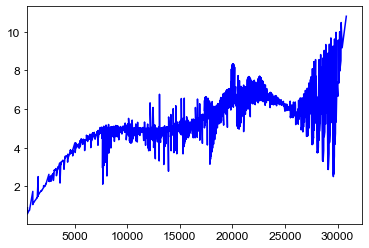

In [176]:
bin_size = 1

#generate limits as arrays
ranges = []
for max_limit in range(0, int(max(rh_pair[0])), bin_size):
    ranges.append([max_limit, max_limit+bin_size,  [], []])

waferdata = [[], []]


#n times add them in the appropriate dictionaries
for i in tqdm_notebook(range(len(rh_pair[0]))):
    each_val = rh_pair[0][i]
    #print(i, len(rh_pair[0]))
    #binary search to find the best match
    left = 0
    right = len(ranges)-1
    while True:
        arr_idx = int(round((left+right)/2))
        if(each_val >= ranges[arr_idx][0] and each_val < ranges[arr_idx][1]):
            break
            
        else:
            if(each_val < ranges[arr_idx][0]):
                if(arr_idx > 0):
                    right = arr_idx -1
                else:
                    break
            elif(each_val >= ranges[arr_idx][1]):
                if(arr_idx < len(ranges)-1):
                    left = arr_idx + 1
                else:
                    break
                    
    ranges[arr_idx][2].append(rh_pair[1][i])
    ranges[arr_idx][3].append(rh_pair[0][i])

    
for i in range(len(ranges)):
        if(len(ranges[i][2])>0):
            waferdata[0].append(np.mean(ranges[i][3]))
            waferdata[1].append(np.mean(ranges[i][2]))
        
#print(max(avg_h))
plt.plot(waferdata[0], waferdata[1], 'b')
#plt.plot([cl,cl], [min(avg_h[1]),max(avg_h[1])], 'y')
#plt.plot(avg_h[0], avg_h_median, 'r',alpha=0.2)
plt.xlim(left = min(waferdata[0]))
plt.show()


Parameters [ 5.25028269  0.31874795 -0.06743549]
RMSE: 0.07058341833076644
R-squared: 0.9171112380375901
DIV 73


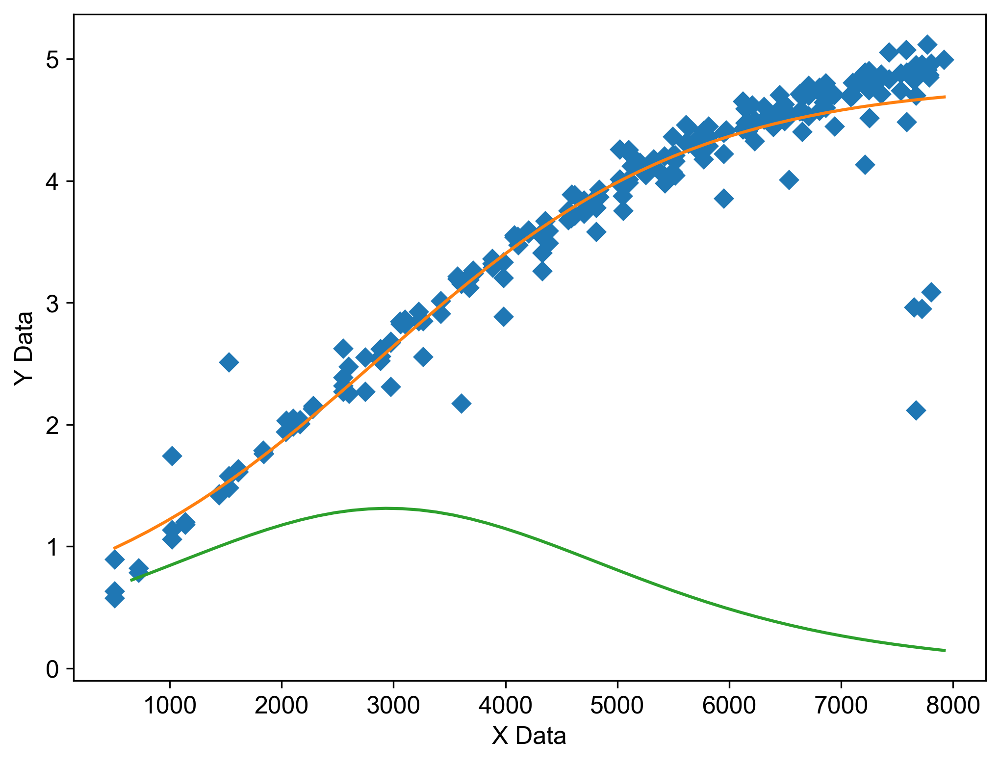


0.9 = 5551.349881980128 , 0.925 = 5904.09466770888 , 0.95 = 6342.920409106185 , 0.975 = 6941.744448539607 , 
0.99 = 7452.616207181247 , 
1 = 7920.447487988608 , 


In [177]:
#you might have to tweak the tolerance and range to get better estimations

import numpy, scipy, matplotlib
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.optimize import differential_evolution
import warnings

graphWidth = 800
graphHeight = 600

##########################################################
# graphics output section
def ModelAndScatterPlot(xData, yData, xscale, yscale, graphWidth, graphHeight, plot='y'):


    # create data for the fitted equation plot
    xModel = numpy.linspace(min(xData), max(xData))
    yModel = func(xModel, *fittedParameters)
    
    ydiff = np.diff(yModel)/np.diff(xModel)
    if(np.argmin(ydiff>=0.15)>0): #TOLERANCE
        fit = 1
    else:
        fit = 0
    if(plot=='y'):
        f = plt.figure(figsize=(graphWidth/100.0, graphHeight/100.0), dpi=300)
        axes = f.add_subplot(111)
        #xData = xData*xscale
        #yData=  yData*yscale
        # first the raw data as a scatter plot
        axes.plot((xData*(xscale[1]-xscale[0])) + xscale[0], (yData*(yscale[1]-yscale[0])) + yscale[0],  'D')    
        # now the model as a line plot
        axes.plot((xModel*(xscale[1]-xscale[0])) + xscale[0], (yModel*(yscale[1]-yscale[0])) + yscale[0])
        axes.plot((xModel[1:]*(xscale[1]-xscale[0])) + xscale[0], ydiff)

        axes.set_xlabel('X Data') # X axis data label
        axes.set_ylabel('Y Data') # Y axis data label

        plt.show()
        plt.close('all') # clean up after using pyplot
    
    return (xModel*(xscale[1]-xscale[0])) + xscale[0], (yModel*(yscale[1]-yscale[0])) + yscale[0], fit


def func(x, a, b, Offset): # Sigmoid A With Offset from zunzun.com
    return  1.0 / (1.0 + numpy.exp(-a * (x-b))) + Offset


# function for genetic algorithm to minimize (sum of squared error)
def sumOfSquaredError(parameterTuple):
    warnings.filterwarnings("ignore") # do not print warnings by genetic algorithm
    val = func(xData, *parameterTuple)
    return numpy.sum((yData - val) ** 2.0)


def generate_Initial_Parameters():
    # min and max used for bounds
    maxX = max(xData)
    minX = min(xData)
    maxY = max(yData)
    minY = min(yData)

    parameterBounds = []
    parameterBounds.append([minX, maxX]) # seach bounds for a
    parameterBounds.append([minX, maxX]) # seach bounds for b
    parameterBounds.append([minX, maxY]) # seach bounds for Offset

    # "seed" the numpy random number generator for repeatable results
    result = differential_evolution(sumOfSquaredError, parameterBounds, seed=3)
    return result.x
    
    
rsquared_arr = []
div_arr = []
avg_h = waferdata

for div in tqdm_notebook(range(1,120,1)): #RANGE
    divisor = div/10
    xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
    #normalize
    max_x = max(xData)
    min_x = min(xData)
    
    xData = (xData - min_x)/(max_x - min_x)

    yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
    max_y = max(yData)
    min_y = min(yData)
    #scaley = max(yData)
    yData = (yData - min_y)/(max_y - min_y)



    # generate initial parameter values
    geneticParameters = generate_Initial_Parameters()

    # curve fit the test data
    fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

    #print('Parameters', fittedParameters)

    modelPredictions = func(xData, *fittedParameters) 

    absError = modelPredictions - yData

    SE = numpy.square(absError) # squared errors
    MSE = numpy.mean(SE) # mean squared errors
    RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
    Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
    xfit, yfit, tempfit = ModelAndScatterPlot(xData, yData, [min_x, max_x], [min_y, max_y], graphWidth, graphHeight, 'n')
    if(tempfit ==1):
        rsquared_arr.append(Rsquared)
        div_arr.append(div)
        #print('RMSE:', RMSE)
        #print('R-squared:', Rsquared)
    #print()
    #xfit, yfit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight)

#idx = len(rsquared_arr)-1#rsquared_arr.index(max(rsquared_arr))
div = div_arr[-1]
divisor = div/10
xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
#normalize
max_x = max(xData)
min_x = min(xData)

xData = (xData - min_x)/(max_x - min_x)

yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
max_y = max(yData)
min_y = min(yData)
#scaley = max(yData)
yData = (yData - min_y)/(max_y - min_y)


# generate initial parameter values
geneticParameters = generate_Initial_Parameters()

# curve fit the test data
fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

print('Parameters', fittedParameters)

modelPredictions = func(xData, *fittedParameters) 

absError = modelPredictions - yData

SE = numpy.square(absError) # squared errors
MSE = numpy.mean(SE) # mean squared errors
RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
print('RMSE:', RMSE)
print('R-squared:', Rsquared)
print('DIV', div)
rsquared_arr.append(Rsquared)
div_arr.append(div)
xofit, yofit, fit = ModelAndScatterPlot(xData, yData, [min_x, max_x], [min_y, max_y], graphWidth, graphHeight)


xfit = (xData*(max_x - min_x)) + min_x
yfit = (modelPredictions*(max_y - min_y)) + min_y

func = interpolate.interp1d(xfit, yfit)
xnew = np.linspace(min(xfit), max(xfit), max(xfit)+1)
ynew = func(xnew)
#plt.plot(xnew, ynew,'b')
maxz_idx = np.argmax(ynew > 0.9 * max(ynew))

#print(xnew[maxz_idx])
print('')
print(0.9, '=',xnew[np.argmax(ynew >= 0.9 * max(ynew))],', ', end='')
print(0.925, '=', xnew[np.argmax(ynew >= 0.925 * max(ynew))], ', ', end='')
print(0.95, '=',  xnew[np.argmax(ynew >= 0.95 * max(ynew))], ', ', end= '')
print(0.975, '=', xnew[np.argmax(ynew >= 0.975 * max(ynew))], ', ')
print(0.99, '=', xnew[np.argmax(ynew >= 0.99 * max(ynew))], ', ')
print(1, '=', xnew[np.argmax(ynew >= 1 * max(ynew))], ', ')

Text(0.5, 1.0, 'E[cl] = 10344 um')

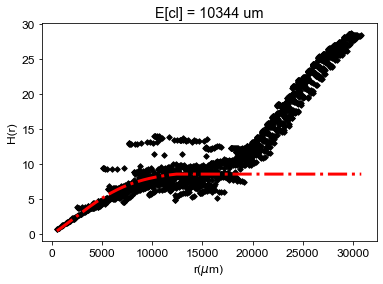

In [158]:
#0.9 = 8797.560702738667 , 0.925 = 9401.182249985382 , 0.95 = 10143.953438489287 , 0.975 = 11126.637801574558 , 
#0.99 = 11926.988151977992 , 1 = 12621.776705565624 , 
#experimental_avg = avg_h
#avg_h = experimental_avg
avg_h[0][int(len(avg_h[0])/16)]
#print(result_sq_diff)
#plt.axvline(x=10047)
plt.scatter(avg_h[0], avg_h[1], color = 'k', s=15, marker = 'D')
plt.plot(np.concatenate((xfit, [max(avg_h[0])])), np.concatenate((yfit, [max(yfit)])), color = 'r', linewidth =3, linestyle='-.')
#plt.xlim(right=20000)
plt.xlabel('r($\mu$m)')
plt.ylabel('H(r)')
plt.title(str('E[cl] = '+ str(int(xnew[np.argmax(ynew >= 0.95 * max(ynew))]))+' um'))

Text(0.5, 1.0, 'Estimated CL = 9.404 mm')

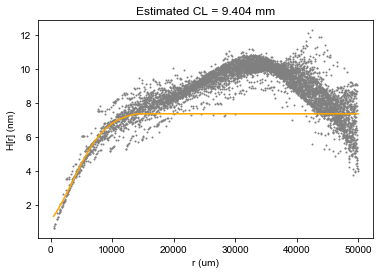

In [75]:
nx_fit = np.concatenate((xnew, np.arange(xnew[-1],max(avg_h[0]),1)))
ny_fit = np.concatenate((ynew, np.ones(np.arange(xnew[-1],max(avg_h[0]),1).size)*ynew[-1]))
plt.scatter(avg_h[0], avg_h[1], color='grey', s = 1)
plt.plot(nx_fit, ny_fit, color = 'orange')
plt.xlabel('r (um)')
plt.ylabel('H[r] (nm)')
plt.title('Estimated CL = %s mm'%(int(xnew[np.argmax(ynew > 0.9 * max(ynew))])/1000))
#0.99 = 7278.90096249262 , 

In [ ]:
places = [-13500, -4500, 4500, 13500]
#origin_arr = [[0, -4500], [0, 4500], [-4500, 0], [4500, 0]]#
origin_arr = [[0, places[0]], [0, places[1]],[0, places[2]],[0, places[3]], [places[0], 0], [places[1], 0], [places[2], 0], [places[3], 0]]  
#origin_arr = [[0,0]]

#xspan_arr = [30000, 30000, 30000, 30000]#
xspan_arr = [30000, 30000,30000,30000, 9000,9000,9000,9000]
#xspan_arr = [300000]

#yspan_arr = [30000, 30000, 30000, 30000]#
yspan_arr = [9000, 9000,9000,9000, 30000, 30000,30000,30000]
#yspan_arr = [300000]

cl_ext_arr = []

for itr_idx in range(len(origin_arr)):
    try:
        # SELECT POINTS
        xspan = xspan_arr[itr_idx]
        yspan = yspan_arr[itr_idx]
        origin = origin_arr[itr_idx]
        tot_hx_arr = []
        tot_hy_arr = []
        all_dh = []
        for i in range(len(tot_hx_array)):
            temp_x = tot_hx_array[i]
            temp_y = tot_hy_array[i]
            if(temp_x >= origin[0]-(xspan/2) and temp_x< origin[0]+(xspan/2)):
                if(temp_y >= origin[1]-(yspan/2) and temp_y< origin[1]+(yspan/2)):
                    tot_hx_arr.append(temp_x)
                    tot_hy_arr.append(temp_y)
                    all_dh.append(tot_dh[i])
        np.mean(all_dh), np.std(all_dh)

        #PLOT POINTS
        fig = plt.figure()
        plt.plot(tot_hx_array, tot_hy_array, 'ro', markersize = 1)
        plt.plot(tot_hx_arr, tot_hy_arr, 'bx', markersize = 1)
        fig.set_size_inches(7,7)
        plt.xlabel(r'x ($\mu$)')
        plt.ylabel(r'y ($\mu$)')
        plt.show()


        #CREATE PAIRS

        rh_pair = [[], []]        
        for i in range(len(tot_hx_arr)):
            for j in range(i+1,len(tot_hx_arr),1):

                e = np.sqrt((tot_hx_arr[i] - tot_hx_arr[j])**2 + (tot_hy_arr[i] - tot_hy_arr[j])**2)        

                rh = np.sqrt((all_dh[i] - all_dh[j])**2)
                #rh = abs(all_dh[i]**2 - all_dh[j]**2)

                rh_pair[0].append(e)
                rh_pair[1].append(rh)

        bin_size = 1

        #generate limits as arrays
        ranges = []
        for max_limit in range(0, int(max(rh_pair[0])), bin_size):
            ranges.append([max_limit, max_limit+bin_size,  [], []])

        avg_h = [[], []]



        #n times add them in the appropriate dictionaries
        for i in range(len(rh_pair[0])):
            each_val = rh_pair[0][i]
            #print(i, len(rh_pair[0]))
            #binary search to find the best match
            left = 0
            right = len(ranges)-1
            while True:
                arr_idx = int(round((left+right)/2))
                if(each_val >= ranges[arr_idx][0] and each_val < ranges[arr_idx][1]):
                    break

                else:
                    if(each_val < ranges[arr_idx][0]):
                        if(arr_idx > 0):
                            right = arr_idx -1
                        else:
                            break
                    elif(each_val >= ranges[arr_idx][1]):
                        if(arr_idx < len(ranges)-1):
                            left = arr_idx + 1
                        else:
                            break

            ranges[arr_idx][2].append(rh_pair[1][i])
            ranges[arr_idx][3].append(rh_pair[0][i])

        for i in range(len(ranges)):
                if(len(ranges[i][2])>0):
                    avg_h[0].append(np.mean(ranges[i][3]))
                    avg_h[1].append(np.mean(ranges[i][2]))

        plt.plot(avg_h[0], avg_h[1], 'b')
        plt.xlim(left = min(avg_h[0]))
        plt.show()

        graphWidth = 800
        graphHeight = 600

        ##########################################################
        # graphics output section
        def ModelAndScatterPlot(xData, yData, xscale, yscale, graphWidth, graphHeight, plot='y'):


            # create data for the fitted equation plot
            xModel = numpy.linspace(min(xData), max(xData))
            yModel = func(xModel, *fittedParameters)

            ydiff = np.diff(yModel)/np.diff(xModel)
            if(np.argmin(ydiff>=0.1)>0):
                fit = 1
            else:
                fit = 0
            if(plot=='y'):
                f = plt.figure(figsize=(graphWidth/100.0, graphHeight/100.0), dpi=300)
                axes = f.add_subplot(111)
                #xData = xData*xscale
                #yData=  yData*yscale
                # first the raw data as a scatter plot
                axes.plot(xData*xscale, yData*yscale,  'D')    
                # now the model as a line plot
                axes.plot(xModel*xscale, yModel*yscale)
                axes.plot(xModel[1:]*xscale, ydiff)

                axes.set_xlabel('X Data') # X axis data label
                axes.set_ylabel('Y Data') # Y axis data label

                plt.show()
                plt.close('all') # clean up after using pyplot

            return xModel*xscale, yModel*yscale, fit


        def func(x, a, b, Offset): # Sigmoid A With Offset from zunzun.com
            return  1.0 / (1.0 + numpy.exp(-a * (x-b))) + Offset


        # function for genetic algorithm to minimize (sum of squared error)
        def sumOfSquaredError(parameterTuple):
            warnings.filterwarnings("ignore") # do not print warnings by genetic algorithm
            val = func(xData, *parameterTuple)
            return numpy.sum((yData - val) ** 2.0)


        def generate_Initial_Parameters():
            # min and max used for bounds
            maxX = max(xData)
            minX = min(xData)
            maxY = max(yData)
            minY = min(yData)

            parameterBounds = []
            parameterBounds.append([minX, maxX]) # seach bounds for a
            parameterBounds.append([minX, maxX]) # seach bounds for b
            parameterBounds.append([minX, maxY]) # seach bounds for Offset

            # "seed" the numpy random number generator for repeatable results
            result = differential_evolution(sumOfSquaredError, parameterBounds, seed=3)
            return result.x

        rsquared_arr = []
        div_arr = []


        for div in range(19,201,1):
            divisor = div/10
            xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
            scalex = max(xData)
            xData = xData/scalex

            yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
            scaley = max(yData)
            yData = yData/scaley



            # generate initial parameter values
            geneticParameters = generate_Initial_Parameters()

            # curve fit the test data
            fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

            #print('Parameters', fittedParameters)

            modelPredictions = func(xData, *fittedParameters) 

            absError = modelPredictions - yData

            SE = numpy.square(absError) # squared errors
            MSE = numpy.mean(SE) # mean squared errors
            RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
            Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
            xfit, yfit, tempfit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight, 'n')
            if(tempfit ==1):
                rsquared_arr.append(Rsquared)
                div_arr.append(div)
                #print('RMSE:', RMSE)
                #print('R-squared:', Rsquared)
            #print()
            #xfit, yfit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight)

        #idx = rsquared_arr.index(max(rsquared_arr))
        div = div_arr[-1]#idx]
        divisor = div/10
        xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
        scalex = max(xData)
        xData = xData/scalex
        yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
        scaley = max(yData)
        yData = yData/scaley



        # generate initial parameter values
        geneticParameters = generate_Initial_Parameters()

        # curve fit the test data
        fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

        print('Parameters', fittedParameters)

        modelPredictions = func(xData, *fittedParameters) 

        absError = modelPredictions - yData

        SE = numpy.square(absError) # squared errors
        MSE = numpy.mean(SE) # mean squared errors
        RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
        Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
        print('RMSE:', RMSE)
        print('R-squared:', Rsquared)
        print('DIV', div)
        rsquared_arr.append(Rsquared)
        div_arr.append(div)
        xofit, yofit, fit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight)
        xfit = xData*scalex
        yfit = modelPredictions*scaley

        func = interpolate.interp1d(xfit, yfit)
        xnew = np.linspace(min(xfit), max(xfit), max(xfit)+1)
        ynew = func(xnew)
        #plt.plot(xnew, ynew,'b')
        maxz_idx = np.argmax(ynew > 0.9 * max(ynew))

        #print(xnew[maxz_idx])
        
        print(0.9, '=',xnew[np.argmax(ynew > 0.9 * max(ynew))],', ', end='')
        print(0.925, '=', xnew[np.argmax(ynew > 0.925 * max(ynew))], ', ', end='')
        print(0.95, '=',  xnew[np.argmax(ynew > 0.95 * max(ynew))], ', ', end= '')
        print(0.975, '=', xnew[np.argmax(ynew > 0.975 * max(ynew))], ', ')

        cl_ext_arr.append([itr_idx, xnew[np.argmax(ynew >= 0.9 * max(ynew))], xnew[np.argmax(ynew >= 0.925 * max(ynew))], xnew[np.argmax(ynew >= 0.95 * max(ynew))], xnew[np.argmax(ynew >= 0.975 * max(ynew))], xnew[np.argmax(ynew >= 0.99 * max(ynew))]])

    except Exception as e:
        pass

In [ ]:
places = [-13500, -4500, 4500, 13500]
#origin_arr =  [[0, places[0]], [0, places[1]],[0, places[2]],[0, places[3]], [places[0], 0], [places[1], 0], [places[2], 0], [places[3], 0]]  
#xspan_arr = [30000, 30000,30000,30000, 9000,9000,9000,9000]
#yspan_arr = [9000, 9000,9000,9000, 30000, 30000,30000,30000]

ocl_ext_arr = []

for itr_idx in range(len(origin_arr)):
    try:
        # SELECT POINTS
        xspan = xspan_arr[itr_idx]
        yspan = yspan_arr[itr_idx]
        origin = origin_arr[itr_idx]
        tot_hx_arr = []
        tot_hy_arr = []
        all_dh = []
        for i in range(len(tot_hx_array)):
            temp_x = tot_hx_array[i]
            temp_y = tot_hy_array[i]
            if(temp_x >= origin[0]-(xspan/2) and temp_x< origin[0]+(xspan/2)):
                if(temp_y >= origin[1]-(yspan/2) and temp_y< origin[1]+(yspan/2)):
                    tot_hx_arr.append(temp_x)
                    tot_hy_arr.append(temp_y)
                    all_dh.append(tot_dh[i])
        np.mean(all_dh), np.std(all_dh)

        #PLOT POINTS
        fig = plt.figure()
        plt.plot(tot_hx_array, tot_hy_array, 'ro', markersize = 1)
        plt.plot(tot_hx_arr, tot_hy_arr, 'bx', markersize = 1)
        fig.set_size_inches(7,7)
        plt.xlabel(r'x ($\mu$)')
        plt.ylabel(r'y ($\mu$)')
        plt.show()


        #CREATE PAIRS

        rh_pair = [[], []]        
        for i in range(len(tot_hx_arr)):
            for j in range(i+1,len(tot_hx_arr),1):

                e = np.sqrt((tot_hx_arr[i] - tot_hx_arr[j])**2 + (tot_hy_arr[i] - tot_hy_arr[j])**2)        

                #rh = np.sqrt((all_dh[i] - all_dh[j])**2)
                rh = abs(all_dh[i]**2 - all_dh[j]**2)

                rh_pair[0].append(e)
                rh_pair[1].append(rh)

        bin_size = 1

        #generate limits as arrays
        ranges = []
        for max_limit in range(0, int(max(rh_pair[0])), bin_size):
            ranges.append([max_limit, max_limit+bin_size,  [], []])

        avg_h = [[], []]



        #n times add them in the appropriate dictionaries
        for i in range(len(rh_pair[0])):
            each_val = rh_pair[0][i]
            #print(i, len(rh_pair[0]))
            #binary search to find the best match
            left = 0
            right = len(ranges)-1
            while True:
                arr_idx = int(round((left+right)/2))
                if(each_val >= ranges[arr_idx][0] and each_val < ranges[arr_idx][1]):
                    break

                else:
                    if(each_val < ranges[arr_idx][0]):
                        if(arr_idx > 0):
                            right = arr_idx -1
                        else:
                            break
                    elif(each_val >= ranges[arr_idx][1]):
                        if(arr_idx < len(ranges)-1):
                            left = arr_idx + 1
                        else:
                            break

            ranges[arr_idx][2].append(rh_pair[1][i])
            ranges[arr_idx][3].append(rh_pair[0][i])

        for i in range(len(ranges)):
                if(len(ranges[i][2])>0):
                    avg_h[0].append(np.mean(ranges[i][3]))
                    avg_h[1].append(np.mean(ranges[i][2]))

        plt.plot(avg_h[0], avg_h[1], 'b')
        plt.xlim(left = min(avg_h[0]))
        plt.show()

        graphWidth = 800
        graphHeight = 600

        ##########################################################
        # graphics output section
        def ModelAndScatterPlot(xData, yData, xscale, yscale, graphWidth, graphHeight, plot='y'):


            # create data for the fitted equation plot
            xModel = numpy.linspace(min(xData), max(xData))
            yModel = func(xModel, *fittedParameters)

            ydiff = np.diff(yModel)/np.diff(xModel)
            if(np.argmin(ydiff>=0.05)>0):
                fit = 1
            else:
                fit = 0
            if(plot=='y'):
                f = plt.figure(figsize=(graphWidth/100.0, graphHeight/100.0), dpi=300)
                axes = f.add_subplot(111)
                #xData = xData*xscale
                #yData=  yData*yscale
                # first the raw data as a scatter plot
                axes.plot(xData*xscale, yData*yscale,  'D')    
                # now the model as a line plot
                axes.plot(xModel*xscale, yModel*yscale)
                axes.plot(xModel[1:]*xscale, ydiff)

                axes.set_xlabel('X Data') # X axis data label
                axes.set_ylabel('Y Data') # Y axis data label

                plt.show()
                plt.close('all') # clean up after using pyplot

            return xModel*xscale, yModel*yscale, fit


        def func(x, a, b, Offset): # Sigmoid A With Offset from zunzun.com
            return  1.0 / (1.0 + numpy.exp(-a * (x-b))) + Offset


        # function for genetic algorithm to minimize (sum of squared error)
        def sumOfSquaredError(parameterTuple):
            warnings.filterwarnings("ignore") # do not print warnings by genetic algorithm
            val = func(xData, *parameterTuple)
            return numpy.sum((yData - val) ** 2.0)


        def generate_Initial_Parameters():
            # min and max used for bounds
            maxX = max(xData)
            minX = min(xData)
            maxY = max(yData)
            minY = min(yData)

            parameterBounds = []
            parameterBounds.append([minX, maxX]) # seach bounds for a
            parameterBounds.append([minX, maxX]) # seach bounds for b
            parameterBounds.append([minX, maxY]) # seach bounds for Offset

            # "seed" the numpy random number generator for repeatable results
            result = differential_evolution(sumOfSquaredError, parameterBounds, seed=3)
            return result.x

        rsquared_arr = []
        div_arr = []


        for div in range(19,201,1):
            divisor = div/10
            xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
            scalex = max(xData)
            xData = xData/scalex

            yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
            scaley = max(yData)
            yData = yData/scaley



            # generate initial parameter values
            geneticParameters = generate_Initial_Parameters()

            # curve fit the test data
            fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

            #print('Parameters', fittedParameters)

            modelPredictions = func(xData, *fittedParameters) 

            absError = modelPredictions - yData

            SE = numpy.square(absError) # squared errors
            MSE = numpy.mean(SE) # mean squared errors
            RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
            Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
            xfit, yfit, tempfit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight, 'n')
            if(tempfit ==1):
                rsquared_arr.append(Rsquared)
                div_arr.append(div)
                #print('RMSE:', RMSE)
                #print('R-squared:', Rsquared)
            #print()
            #xfit, yfit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight)

        #idx = rsquared_arr.index(max(rsquared_arr))
        div = div_arr[-1]#idx]
        divisor = div/10
        xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
        scalex = max(xData)
        xData = xData/scalex
        yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
        scaley = max(yData)
        yData = yData/scaley



        # generate initial parameter values
        geneticParameters = generate_Initial_Parameters()

        # curve fit the test data
        fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

        print('Parameters', fittedParameters)

        modelPredictions = func(xData, *fittedParameters) 

        absError = modelPredictions - yData

        SE = numpy.square(absError) # squared errors
        MSE = numpy.mean(SE) # mean squared errors
        RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
        Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
        print('RMSE:', RMSE)
        print('R-squared:', Rsquared)
        print('DIV', div)
        rsquared_arr.append(Rsquared)
        div_arr.append(div)
        xofit, yofit, fit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight)
        xfit = xData*scalex
        yfit = modelPredictions*scaley

        func = interpolate.interp1d(xfit, yfit)
        xnew = np.linspace(min(xfit), max(xfit), max(xfit)+1)
        ynew = func(xnew)
        #plt.plot(xnew, ynew,'b')
        maxz_idx = np.argmax(ynew > 0.9 * max(ynew))

        #print(xnew[maxz_idx])
        print('')
        print(0.9, '=',xnew[np.argmax(ynew > 0.9 * max(ynew))],', ', end='')
        print(0.925, '=', xnew[np.argmax(ynew > 0.925 * max(ynew))], ', ', end='')
        print(0.95, '=',  xnew[np.argmax(ynew > 0.95 * max(ynew))], ', ', end= '')
        print(0.975, '=', xnew[np.argmax(ynew > 0.975 * max(ynew))], ', ')

        ocl_ext_arr.append([itr_idx, xnew[np.argmax(ynew >= 0.9 * max(ynew))], xnew[np.argmax(ynew >= 0.925 * max(ynew))], xnew[np.argmax(ynew >= 0.95 * max(ynew))], xnew[np.argmax(ynew >= 0.975 * max(ynew))], xnew[np.argmax(ynew >= 0.99 * max(ynew))]])

    except Exception as e:
        pass

In [ ]:
cl_euclidean = cl_ext_arr
#np.mean([each[1] for each in cl_euclidean])
#cl_square = ocl_ext_arr
#sQUARE = 



#print('ABS', cl_ext_arr)
#print('SQR', ocl_ext_arr)
#ABS [[0, 8916.917161442028, 9536.1316834393, 10293.589447556893, 11285.292705267253, 12080.191347459098]]
#SQR [[0, 8939.957701795414, 9560.132246307412, 10316.629987910279, 11303.533133047016, 12090.751595121068]]

#SQR [8426.274886107707, 11910.552005382919, 9694.866646785173, 18125.556531750735, 6865.348173036539, 8753.326528526653, 7696.113561190738]
#ABS [6329.864609194805, 8831.54642215849, 9328.50561245114, 7385.477206708593, 13413.46819249469, 5145.289777189574, 6556.239613738869, 5568.191808089194]

In [ ]:
## ysq = []
#for each in cl_square:
#    ysq.append(each[-1])
#    ysq.append(each[-1])

#plt.plot([each for each in range(8)], ysq, 'b')
#plt.plot([i for i in range(len(cl_square))], [i[-1] for i in cl_square])
#plt.axhline(12090.75, color = 'b', lineStyle = '--')
#plt.plot([i for i in range(8)], [8426.274886107707, 8426.274886107707, 11910.552005382919, 9694.866646785173, 18125.556531750735, 6865.348173036539, 8753.326528526653, 7696.113561190738], color='b', lineStyle = '-.')


yabs = []
for each in cl_euclidean:
    yabs.append(each[1])
    yabs.append(each[1])

#plt.plot([each for each in range(len(yabs))], yabs, 'g')
plt.plot([i for i in range(len(cl_euclidean))], [i[1] for i in cl_euclidean])
#plt.plot([i for i in range(8)], [6329.864609194805, 8831.54642215849, 9328.50561245114, 7385.477206708593, 13413.46819249469, 5145.289777189574, 6556.239613738869, 5568.191808089194], color='r', lineStyle = '-.')
plt.axhline(10016.91, color = 'k', lineStyle = '--')


print(np.mean(cl_square), np.std(cl_square))
print(np.mean(cl_euclidean), np.std(cl_euclidean))

print([each[-1] for each in cl_square])
print([each[1] for each in cl_euclidean])

In [ ]:
#plt.plot(np.array([each[0] for each in cl_square]), np.array([each[-1] for each in cl_square])-12090, 'b')
plt.plot(np.array([each[0] for each in cl_euclidean]),np.array([each[1] for each in cl_euclidean])-8917, 'r')

#print(np.mean(np.array([each[-1] for each in cl_square])-12090), np.std(np.array([each[-1] for each in cl_square])-12090))
print(np.mean(np.array([each[1] for each in cl_euclidean])-8916), np.std(np.array([each[1] for each in cl_euclidean])-8917))


In [ ]:
plt.plot([each[0] for each in cl_square], [each[1] for each in cl_square], 'b')
plt.plot([each[0] for each in cl_euclidean],[each[1] for each in cl_euclidean], 'r')

print(np.mean(cl_square), np.std(cl_square))
print(np.mean(cl_euclidean), np.std(cl_euclidean))

print(cl_square)
print(cl_euclidean)

#### Generate Virtual wafer to compare the results

In [13]:

"""
The following function generates a square 2-dimensional random rough surface f(x,y) with NxN  surface points, 
where rL is the length of the surface side, h is the RMS height and clx and cly are the correlation lengths in x and y. 
"""
def surfgen2D(N, rL, h, cl, x, y, plot):


    print(x[-2], x[-1], y[-2], y[-1])
    [X,Y] = np.meshgrid(x,y)
    N = x.size
    del x,y
    
    #np.random.seed(1)
    Z = h * np.random.randn(N, N) 
    # uncorrelated Gaussian random rough surface distribution 
    #with mean 0 and standard deviation h
                                   
    #Gaussian filter
    F = np.exp(-( (X**2/(cl**2/2)) + (Y**2/(cl**2/2)) ))
    
    
    #exp(-(X.^2/(clx^2/2)+Y.^2/(cly^2/2)));
    
    # correlation of surface using convolution (faltung), inverse
    # Fourier transform and normalizing prefactors
    f = 2/np.sqrt(np.pi) * rL/N/np.sqrt(cl)/np.sqrt(cl) * np.fft.ifft2(np.fft.fft2(Z) * np.fft.fft2(F))
    f = f.real
    
    if(plot == 'y'):
        plt.figure()
        plt.imshow(f, origin="lower", cmap='GnBu')
        plt.show()
     
    del Z, F
    return X,Y,f

#Eucledian distance function
def eucledian(x1, y1, x2, y2):
    distance = np.sqrt( (x1 - x2)**2 + (y1 - y2)**2 )
    return distance

24490.0 25000.0 24490.0 25000.0


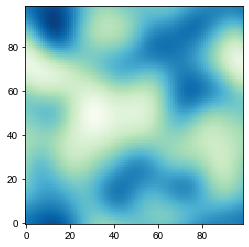

8720 50000 99 0.49915496980600976 -0.035293988148330686
24490.0 25000.0 24490.0 25000.0


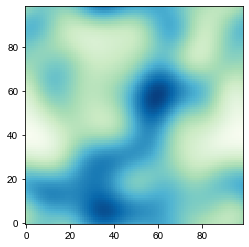

8720 50000 99 0.540430854827861 -0.09760693554770794
24490.0 25000.0 24490.0 25000.0


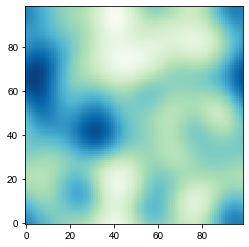

8720 50000 99 0.4702782496335145 0.1035291449799106
24490.0 25000.0 24490.0 25000.0


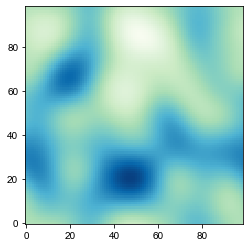

8720 50000 99 0.4997300735727749 -0.24239908156560713
24490.0 25000.0 24490.0 25000.0


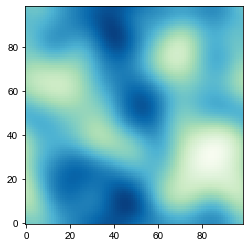

8720 50000 99 0.5241210797687686 0.04485816216422726
24490.0 25000.0 24490.0 25000.0


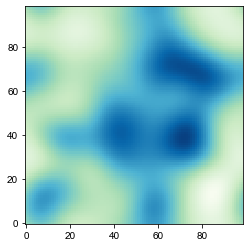

8720 50000 99 0.6978879508022556 -0.17649129034659014
24490.0 25000.0 24490.0 25000.0


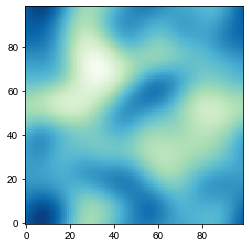

8720 50000 99 0.5301975196892998 0.04101339232132395
24490.0 25000.0 24490.0 25000.0


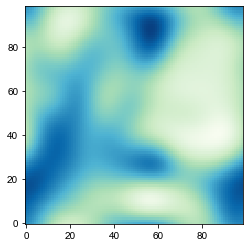

8720 50000 99 0.5105233544371426 -0.11513725256416943
24490.0 25000.0 24490.0 25000.0


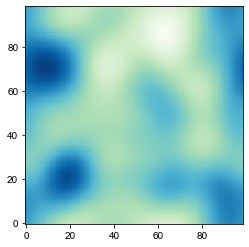

8720 50000 99 0.6135266339155919 0.1973688037085812
24490.0 25000.0 24490.0 25000.0


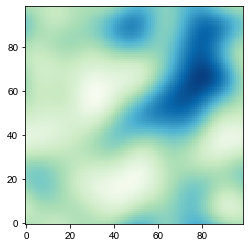

8720 50000 99 0.5661881446517998 -0.31084747483051095
24490.0 25000.0 24490.0 25000.0


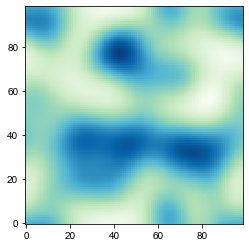

8720 50000 99 0.44223079149647143 0.1201717706035276
24490.0 25000.0 24490.0 25000.0


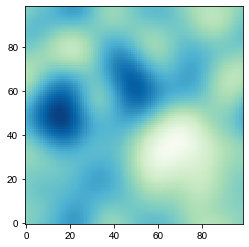

8720 50000 99 0.6136149275020701 -0.16896951085145354
24490.0 25000.0 24490.0 25000.0


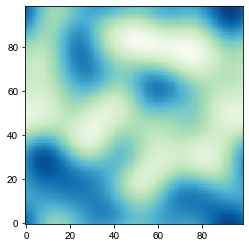

8720 50000 99 0.5034665805600116 0.08325963479677355
24490.0 25000.0 24490.0 25000.0


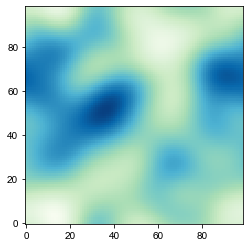

8720 50000 99 0.6349185383849995 -0.08303823670788817
24490.0 25000.0 24490.0 25000.0


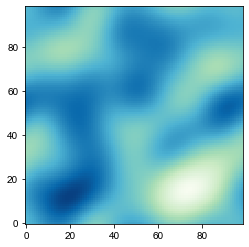

8720 50000 99 0.6188344352159408 -0.2789027104884317
24490.0 25000.0 24490.0 25000.0


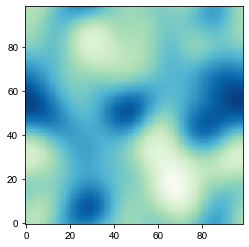

8720 50000 99 0.5169446189361978 0.1649210703333652
24490.0 25000.0 24490.0 25000.0


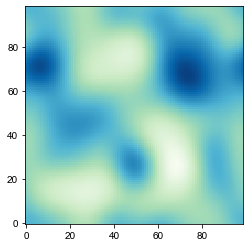

8720 50000 99 0.44025946050944376 0.2463814441272465
24490.0 25000.0 24490.0 25000.0


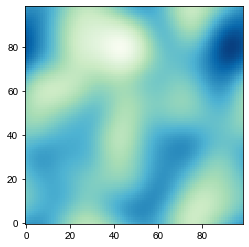

8720 50000 99 0.5092934792485007 0.03121856045475276
24490.0 25000.0 24490.0 25000.0


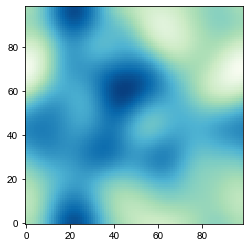

8720 50000 99 0.6678517378158975 0.18229776646533058
24490.0 25000.0 24490.0 25000.0


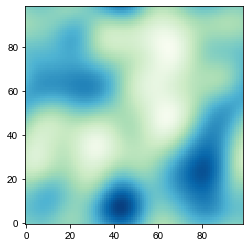

8720 50000 99 0.4515071392553503 -0.3360196975392199
24490.0 25000.0 24490.0 25000.0


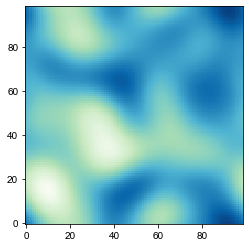

8720 50000 99 0.4982711711440426 0.25272426500122974
24490.0 25000.0 24490.0 25000.0


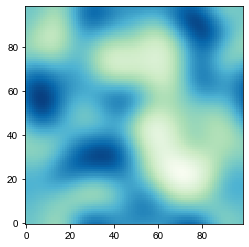

8720 50000 99 0.4849460903267077 0.0752154191265292
24490.0 25000.0 24490.0 25000.0


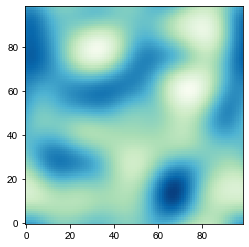

8720 50000 99 0.40445080798971417 -0.0015256753638384429
24490.0 25000.0 24490.0 25000.0


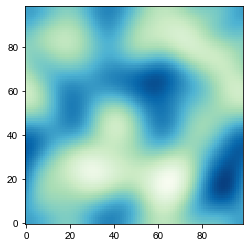

8720 50000 99 0.5305109896726299 -0.12466612481736059
24490.0 25000.0 24490.0 25000.0


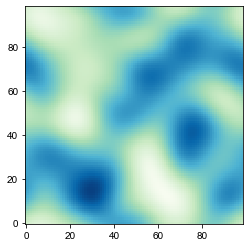

8720 50000 99 0.40122415867290967 -0.0854137865556699
24490.0 25000.0 24490.0 25000.0


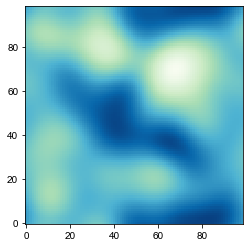

8720 50000 99 0.545546644780871 -0.23967812280691655
24490.0 25000.0 24490.0 25000.0


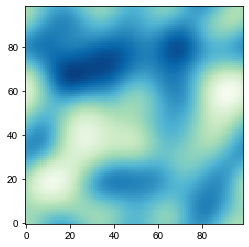

8720 50000 99 0.4722838809857072 0.32690993228435883
24490.0 25000.0 24490.0 25000.0


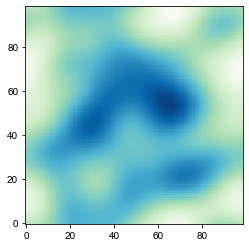

8720 50000 99 0.6322849504405491 -0.1514248594785544
24490.0 25000.0 24490.0 25000.0


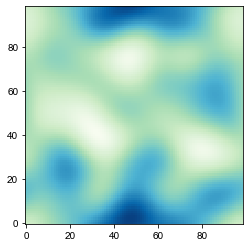

8720 50000 99 0.4728728399632239 0.030169335999168923
24490.0 25000.0 24490.0 25000.0


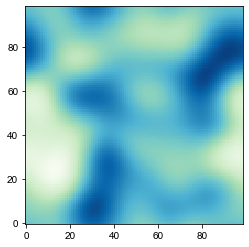

8720 50000 99 0.5184520266736223 -0.13650664085150357
24490.0 25000.0 24490.0 25000.0


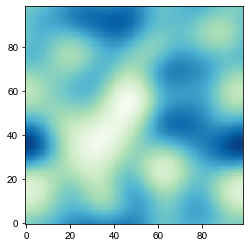

8720 50000 99 0.4935831482258054 -0.32601043969218063
24490.0 25000.0 24490.0 25000.0


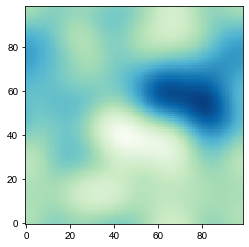

8720 50000 99 0.854805530237875 -0.0859739043497005
24490.0 25000.0 24490.0 25000.0


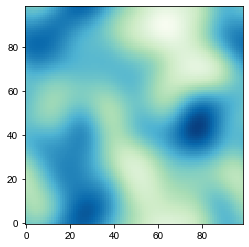

8720 50000 99 0.5587923819924276 0.08180380538749665
24490.0 25000.0 24490.0 25000.0


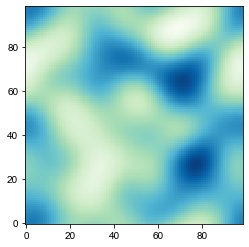

8720 50000 99 0.47567849969718845 -0.05102310747117133
24490.0 25000.0 24490.0 25000.0


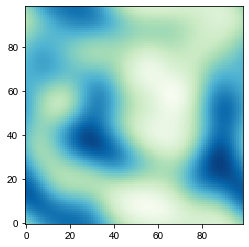

8720 50000 99 0.6245119705882899 -0.03471940051142635
24490.0 25000.0 24490.0 25000.0


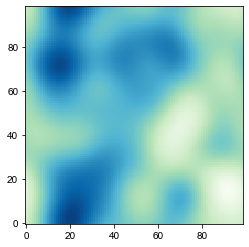

8720 50000 99 0.6245454930212153 0.1996510572515807
24490.0 25000.0 24490.0 25000.0


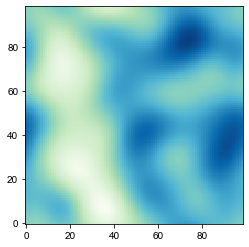

8720 50000 99 0.5955350043316261 0.3715867042369642
24490.0 25000.0 24490.0 25000.0


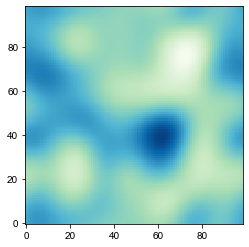

8720 50000 99 0.41027071978541624 0.17805569032762597
24490.0 25000.0 24490.0 25000.0


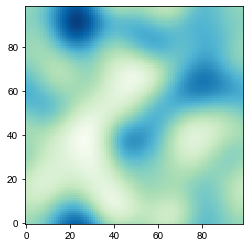

8720 50000 99 0.5387334475886555 0.1572686946145863
24490.0 25000.0 24490.0 25000.0


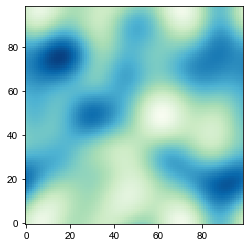

8720 50000 99 0.4681686339379343 0.23507700189450567
24490.0 25000.0 24490.0 25000.0


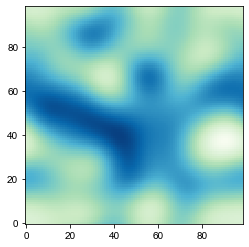

8720 50000 99 0.4754852520734445 -0.02172334576807988
24490.0 25000.0 24490.0 25000.0


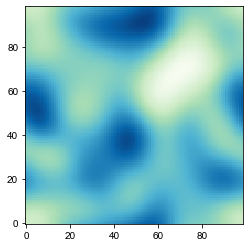

8720 50000 99 0.5439347665598132 0.17028482741525763
24490.0 25000.0 24490.0 25000.0


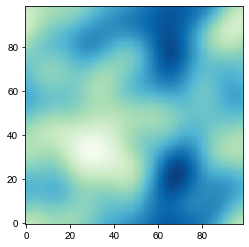

8720 50000 99 0.569240027679781 0.1406301377026823
24490.0 25000.0 24490.0 25000.0


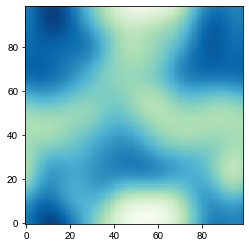

8720 50000 99 0.6617846524791973 0.10839260337797056
24490.0 25000.0 24490.0 25000.0


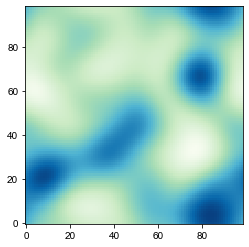

8720 50000 99 0.5015997359458506 0.2512063139758561
24490.0 25000.0 24490.0 25000.0


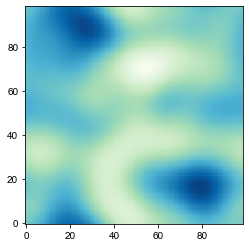

8720 50000 99 0.576017511031552 0.17142178383813328
24490.0 25000.0 24490.0 25000.0


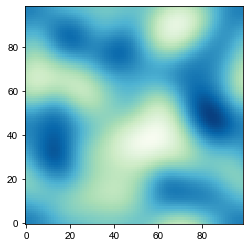

8720 50000 99 0.5314026474835288 0.10397233518194807
24490.0 25000.0 24490.0 25000.0


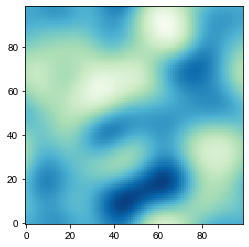

8720 50000 99 0.5527639154564102 -0.006307510566085244
24490.0 25000.0 24490.0 25000.0


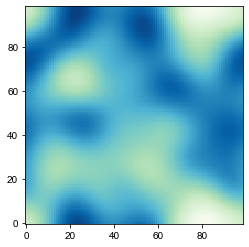

8720 50000 99 0.600976305581597 0.20388865310932913
24490.0 25000.0 24490.0 25000.0


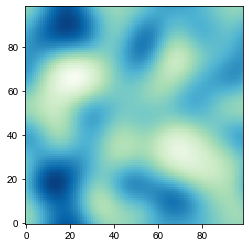

8720 50000 99 0.45670813007782357 -0.28600074714075385
24490.0 25000.0 24490.0 25000.0


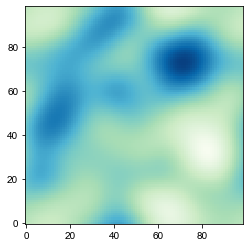

8720 50000 99 0.5334874806642879 -0.1108574485346111
24490.0 25000.0 24490.0 25000.0


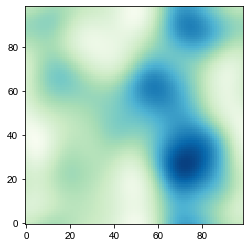

8720 50000 99 0.7243950397606144 -0.03048400215718889
24490.0 25000.0 24490.0 25000.0


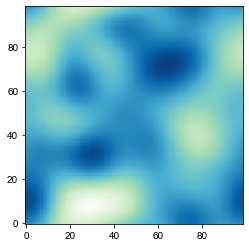

8720 50000 99 0.5938190394372957 0.29790870021365673
24490.0 25000.0 24490.0 25000.0


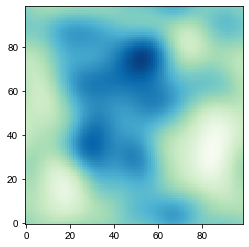

8720 50000 99 0.5291548832065849 -0.18817729147644532
24490.0 25000.0 24490.0 25000.0


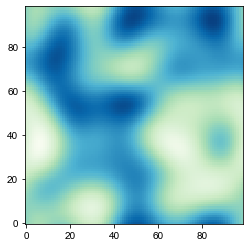

8720 50000 99 0.5047617300927144 -0.09470230088361883
24490.0 25000.0 24490.0 25000.0


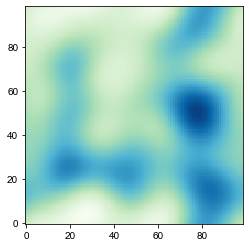

8720 50000 99 0.5637825015910447 -0.20460514007529124
24490.0 25000.0 24490.0 25000.0


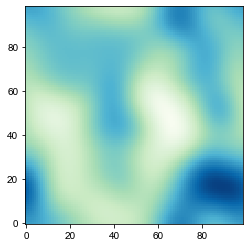

8720 50000 99 0.6398234189444177 0.15706482722606646
24490.0 25000.0 24490.0 25000.0


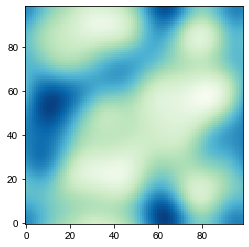

8720 50000 99 0.5445953445473426 0.22387958748691786
24490.0 25000.0 24490.0 25000.0


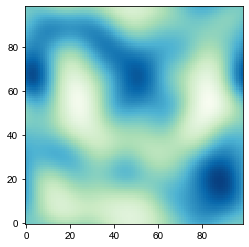

8720 50000 99 0.4434103310268796 0.0410458202369264
24490.0 25000.0 24490.0 25000.0


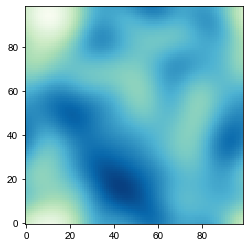

8720 50000 99 0.6668718632843103 0.02966242074243316
24490.0 25000.0 24490.0 25000.0


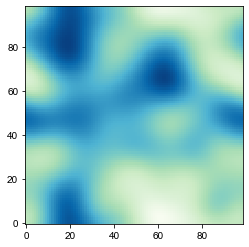

8720 50000 99 0.5231923117185845 -0.03911054513857841
24490.0 25000.0 24490.0 25000.0


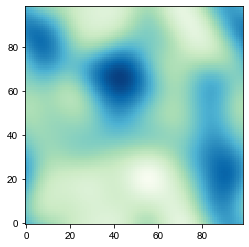

8720 50000 99 0.5989820194398868 0.14066470891607216
24490.0 25000.0 24490.0 25000.0


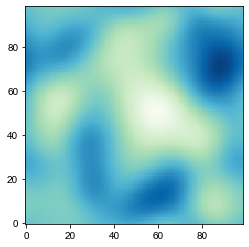

8720 50000 99 0.566148677905625 0.12996416345110218
24490.0 25000.0 24490.0 25000.0


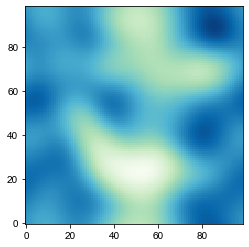

8720 50000 99 0.6330114385618334 -0.06832607693425623
24490.0 25000.0 24490.0 25000.0


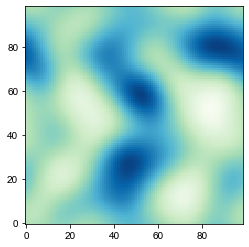

8720 50000 99 0.5260550089468121 -0.11318180470807958
24490.0 25000.0 24490.0 25000.0


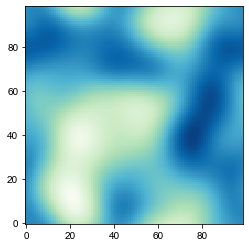

8720 50000 99 0.7155078995395979 -0.012221543132666546
24490.0 25000.0 24490.0 25000.0


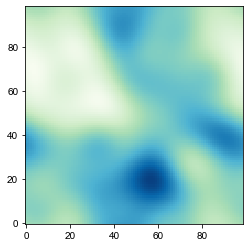

8720 50000 99 0.6209540188796899 -0.03234107060723385
24490.0 25000.0 24490.0 25000.0


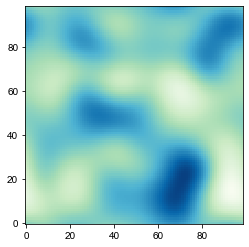

8720 50000 99 0.42114151455996923 0.33317505442057654
24490.0 25000.0 24490.0 25000.0


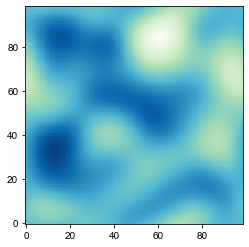

8720 50000 99 0.4415568412742835 0.1601053724016888
24490.0 25000.0 24490.0 25000.0


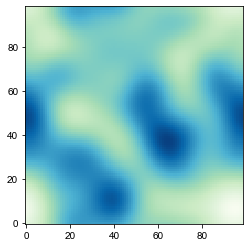

8720 50000 99 0.4841526758248423 0.05203864788458506
24490.0 25000.0 24490.0 25000.0


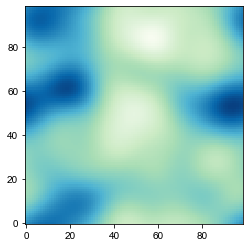

8720 50000 99 0.5656435444550655 0.02834638529690841
24490.0 25000.0 24490.0 25000.0


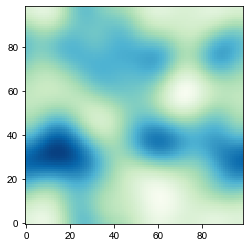

8720 50000 99 0.5562446700603906 -0.17944405795290505
24490.0 25000.0 24490.0 25000.0


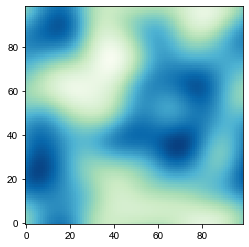

8720 50000 99 0.5793583197185315 0.07486815782486338
24490.0 25000.0 24490.0 25000.0


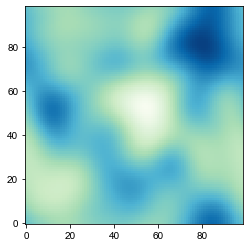

8720 50000 99 0.5270567822813835 -0.1100884172122112
24490.0 25000.0 24490.0 25000.0


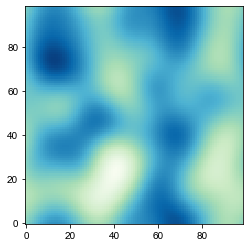

8720 50000 99 0.5210539213468446 0.11999007927971032
24490.0 25000.0 24490.0 25000.0


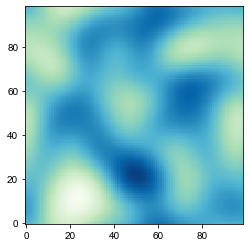

8720 50000 99 0.4695870625562354 0.28931207779668977
24490.0 25000.0 24490.0 25000.0


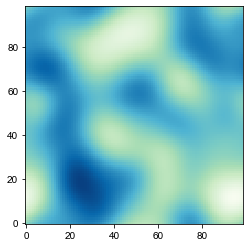

8720 50000 99 0.5013657881337331 -0.0698953203753283
24490.0 25000.0 24490.0 25000.0


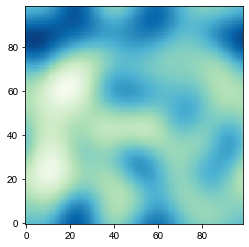

8720 50000 99 0.45314649458684686 0.008912002025915381
24490.0 25000.0 24490.0 25000.0


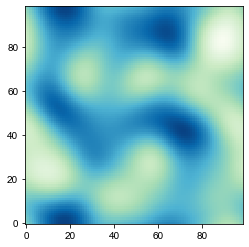

8720 50000 99 0.47830158146701346 0.21197413741951712
24490.0 25000.0 24490.0 25000.0


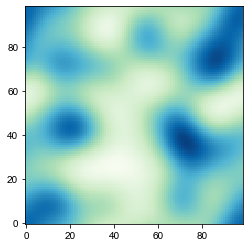

8720 50000 99 0.5243026614538385 -0.1942666548823568
24490.0 25000.0 24490.0 25000.0


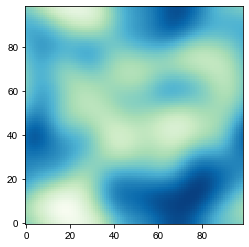

8720 50000 99 0.594134513469346 0.001223038718949003
24490.0 25000.0 24490.0 25000.0


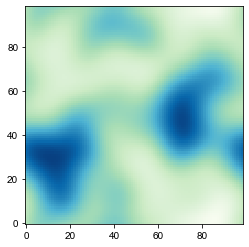

8720 50000 99 0.6406357908245529 -0.23410614118001719
24490.0 25000.0 24490.0 25000.0


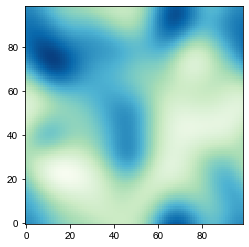

8720 50000 99 0.5337058380895335 0.2517715474504378
24490.0 25000.0 24490.0 25000.0


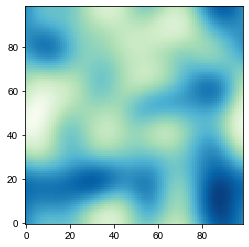

8720 50000 99 0.46865847407500344 0.1347701183793217
24490.0 25000.0 24490.0 25000.0


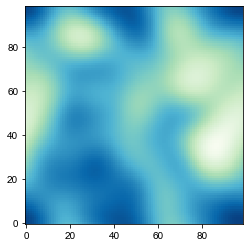

8720 50000 99 0.5018668986584425 0.08045489373111986
24490.0 25000.0 24490.0 25000.0


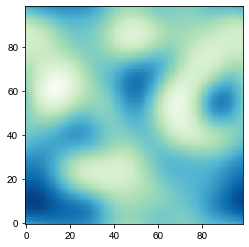

8720 50000 99 0.507606246758399 -0.10481387517701517
24490.0 25000.0 24490.0 25000.0


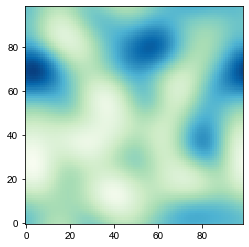

8720 50000 99 0.5248056884429878 -0.09397356685991719
24490.0 25000.0 24490.0 25000.0


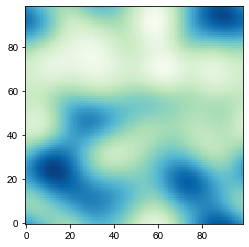

8720 50000 99 0.6470875699128937 0.009667310082773061
24490.0 25000.0 24490.0 25000.0


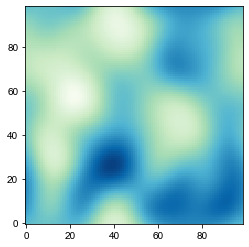

8720 50000 99 0.6158673461146108 -0.0941004895407076
24490.0 25000.0 24490.0 25000.0


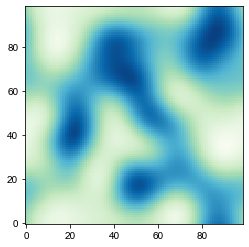

8720 50000 99 0.3906645200696844 -0.11133911332855999
24490.0 25000.0 24490.0 25000.0


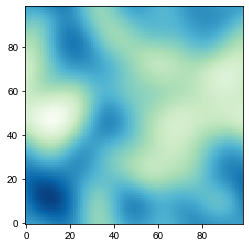

8720 50000 99 0.5383161618154679 -0.06364614243442845
24490.0 25000.0 24490.0 25000.0


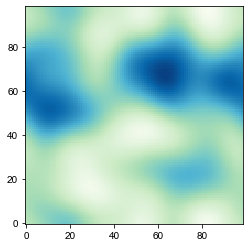

8720 50000 99 0.5593999338772876 0.12433974013643083
24490.0 25000.0 24490.0 25000.0


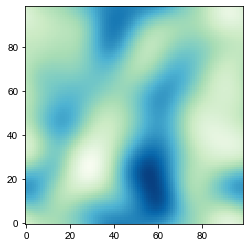

8720 50000 99 0.4916777540246302 0.11732211068781723
24490.0 25000.0 24490.0 25000.0


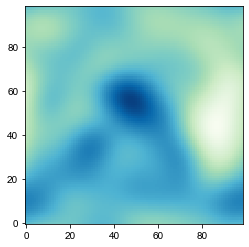

8720 50000 99 0.7166087534547692 0.37601580637358584
24490.0 25000.0 24490.0 25000.0


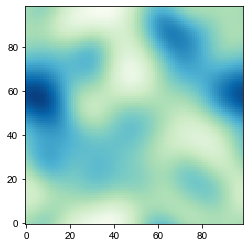

8720 50000 99 0.5578682124662983 0.12096521872098766
24490.0 25000.0 24490.0 25000.0


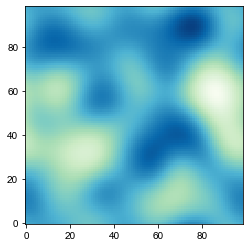

8720 50000 99 0.4285185812108468 0.11078670572843366
24490.0 25000.0 24490.0 25000.0


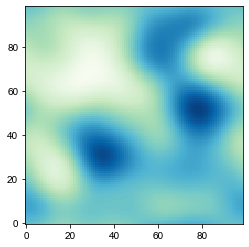

8720 50000 99 0.6843922184371093 -0.022560473975357202
24490.0 25000.0 24490.0 25000.0


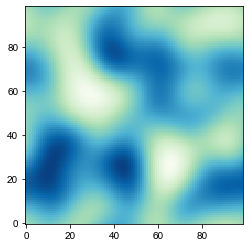

8720 50000 99 0.4418177573382141 -0.3009181857815396
24490.0 25000.0 24490.0 25000.0


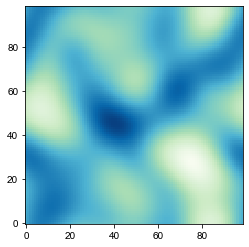

8720 50000 99 0.5168011395235063 0.20760430068981361
24490.0 25000.0 24490.0 25000.0


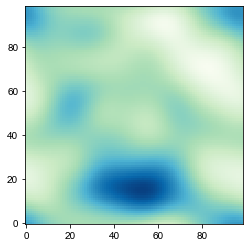

8720 50000 99 0.7002850437597383 -0.004227294177261431
24490.0 25000.0 24490.0 25000.0


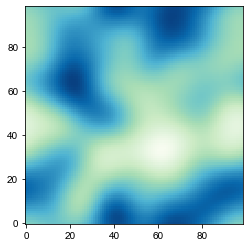

8720 50000 99 0.6110155565374336 -0.04810581552471928
24490.0 25000.0 24490.0 25000.0


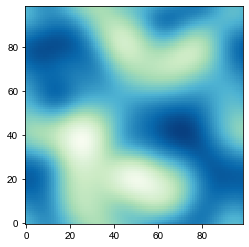

8720 50000 99 0.5710298569696546 0.13553942949966866
24490.0 25000.0 24490.0 25000.0


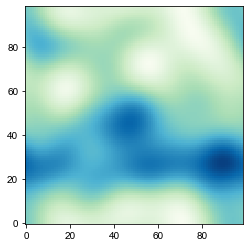

8720 50000 99 0.6560926563033318 0.13162117492475583
24490.0 25000.0 24490.0 25000.0


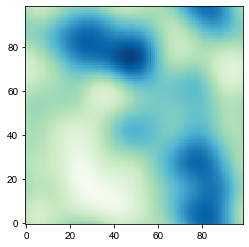

8720 50000 99 0.5874626020378451 -0.12427676067657345
24490.0 25000.0 24490.0 25000.0


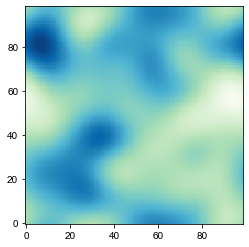

8720 50000 99 0.4974445776183491 0.1588047210605485
24490.0 25000.0 24490.0 25000.0


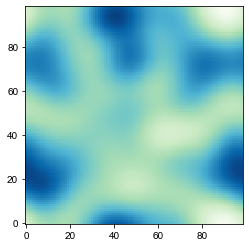

8720 50000 99 0.4712252561597162 0.050991823863318166
24490.0 25000.0 24490.0 25000.0


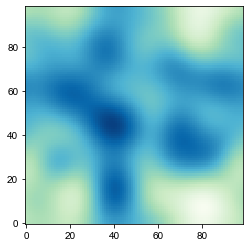

8720 50000 99 0.5408326923133553 0.002430075029336278
24490.0 25000.0 24490.0 25000.0


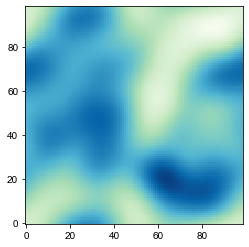

8720 50000 99 0.6465781373476949 0.206891661363764
24490.0 25000.0 24490.0 25000.0


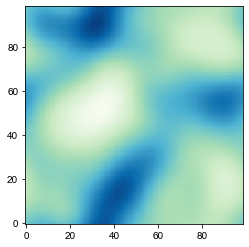

8720 50000 99 0.5899227180478072 -0.10868928544081788
24490.0 25000.0 24490.0 25000.0


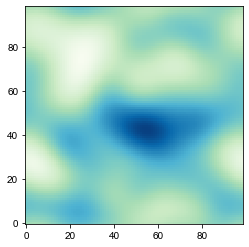

8720 50000 99 0.59681056571666 0.15219352480119422
24490.0 25000.0 24490.0 25000.0


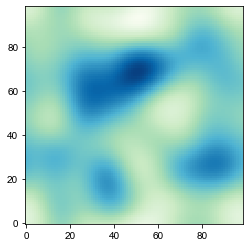

8720 50000 99 0.5525459836914473 -0.09004753520397678
24490.0 25000.0 24490.0 25000.0


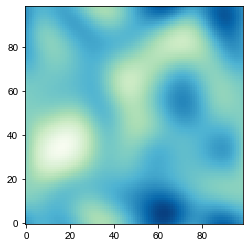

8720 50000 99 0.4243353179903776 -0.02449620148794925
24490.0 25000.0 24490.0 25000.0


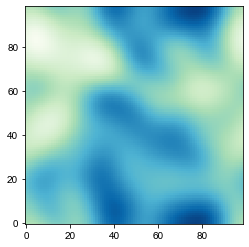

8720 50000 99 0.5005774702485917 -0.06972874571972397
24490.0 25000.0 24490.0 25000.0


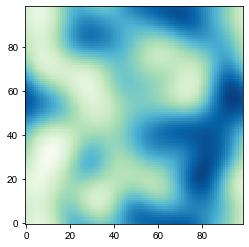

8720 50000 99 0.5055145200590665 0.06515719745398554
24490.0 25000.0 24490.0 25000.0


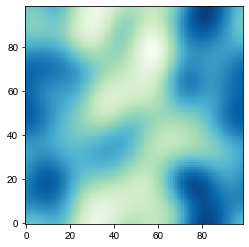

8720 50000 99 0.5006642201379593 -0.027277978502355627
24490.0 25000.0 24490.0 25000.0


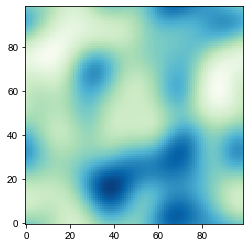

8720 50000 99 0.4803969763692971 -0.21835708209695284
24490.0 25000.0 24490.0 25000.0


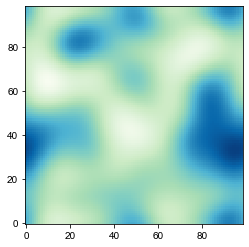

8720 50000 99 0.49549257840037164 -0.18891902670920208
24490.0 25000.0 24490.0 25000.0


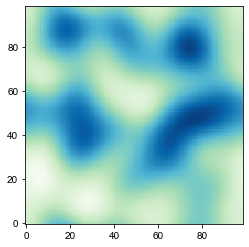

8720 50000 99 0.5324753414826633 -0.17868791819441115
24490.0 25000.0 24490.0 25000.0


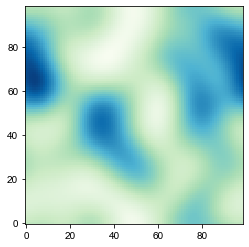

8720 50000 99 0.6300321989170716 -0.3460636951944458
24490.0 25000.0 24490.0 25000.0


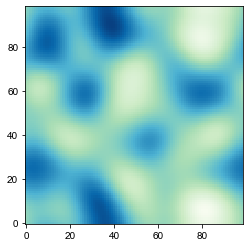

8720 50000 99 0.41364246423053486 0.09128753591301397
24490.0 25000.0 24490.0 25000.0


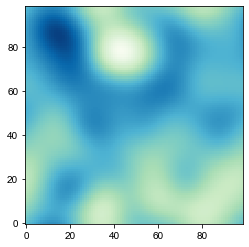

8720 50000 99 0.611509156783373 -0.04996818834087484
24490.0 25000.0 24490.0 25000.0


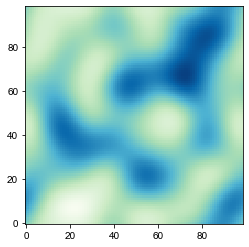

8720 50000 99 0.42268702657431395 -0.053869397063092836
24490.0 25000.0 24490.0 25000.0


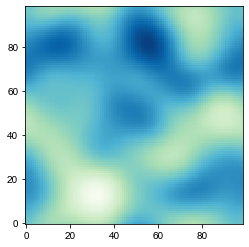

8720 50000 99 0.5290043385154295 -0.26943260500921623
24490.0 25000.0 24490.0 25000.0


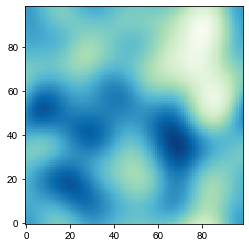

8720 50000 99 0.5863364834538095 0.021467461288513637
24490.0 25000.0 24490.0 25000.0


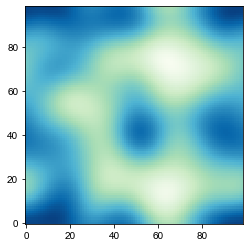

8720 50000 99 0.687188244696032 -0.12774474931240337
24490.0 25000.0 24490.0 25000.0


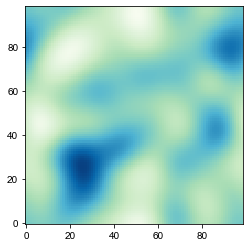

8720 50000 99 0.4002975492869623 -0.4483097929685368
24490.0 25000.0 24490.0 25000.0


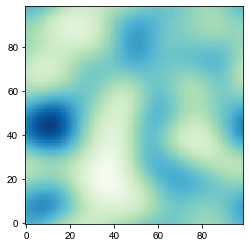

8720 50000 99 0.5870641316529793 0.17797511568089205
24490.0 25000.0 24490.0 25000.0


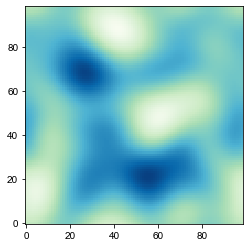

8720 50000 99 0.5030765765937502 0.08166228329763921
24490.0 25000.0 24490.0 25000.0


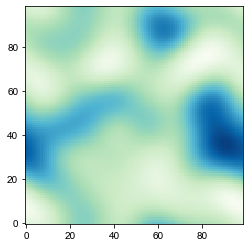

8720 50000 99 0.5772117700538559 0.03464950276862596
24490.0 25000.0 24490.0 25000.0


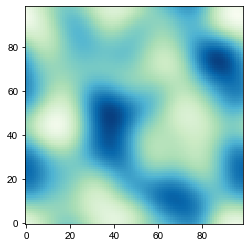

8720 50000 99 0.4214866290336845 0.39841410974654645
24490.0 25000.0 24490.0 25000.0


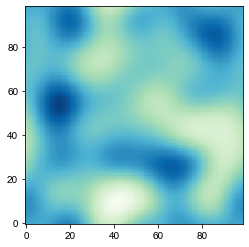

8720 50000 99 0.4608827261919157 0.0518995335229685
24490.0 25000.0 24490.0 25000.0


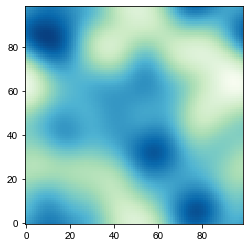

8720 50000 99 0.5675384591435509 0.6413093275691317
24490.0 25000.0 24490.0 25000.0


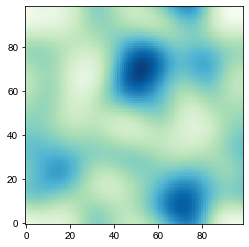

8720 50000 99 0.4838160333715421 -0.22426230394464255
24490.0 25000.0 24490.0 25000.0


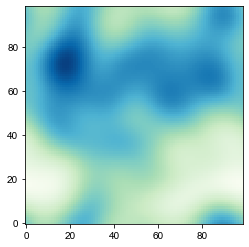

8720 50000 99 0.6645848742143553 -0.0807439221912761
24490.0 25000.0 24490.0 25000.0


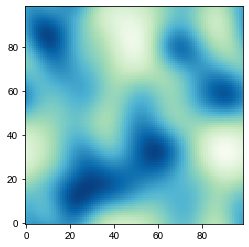

8720 50000 99 0.5060671895023594 -0.08247566903457336
24490.0 25000.0 24490.0 25000.0


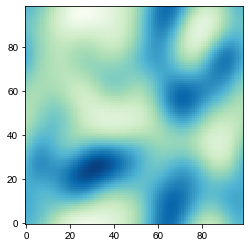

8720 50000 99 0.4231452201029394 0.2460416255406242
24490.0 25000.0 24490.0 25000.0


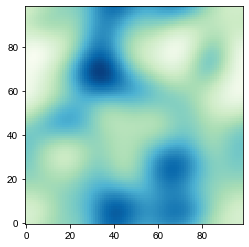

8720 50000 99 0.5482137184892435 0.12119803711895721
24490.0 25000.0 24490.0 25000.0


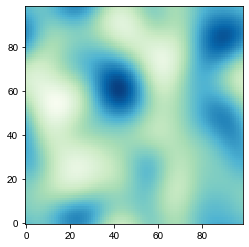

8720 50000 99 0.5068856853581396 -0.12257160812265736
24490.0 25000.0 24490.0 25000.0


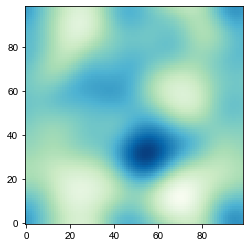

8720 50000 99 0.562205913745823 0.128590217053604
24490.0 25000.0 24490.0 25000.0


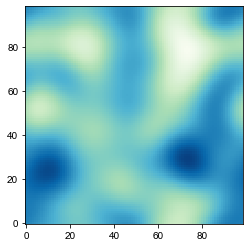

8720 50000 99 0.5155293494600895 -0.18660523289495357
24490.0 25000.0 24490.0 25000.0


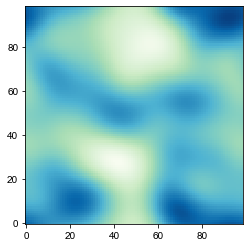

8720 50000 99 0.55711971551121 -0.011970135885178148
24490.0 25000.0 24490.0 25000.0


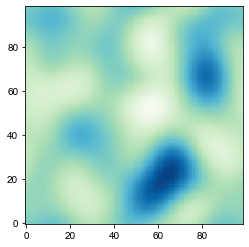

8720 50000 99 0.5074367442541611 -0.04205705233830229
24490.0 25000.0 24490.0 25000.0


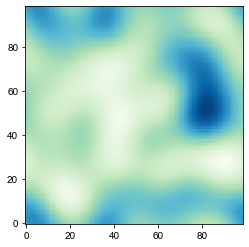

8720 50000 99 0.573127757822159 -0.1442625399748533
24490.0 25000.0 24490.0 25000.0


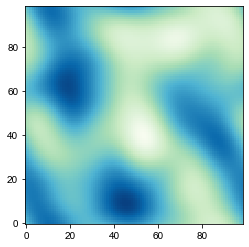

8720 50000 99 0.5061541378273928 0.02485014223490752
24490.0 25000.0 24490.0 25000.0


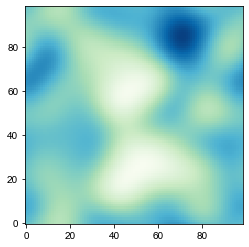

8720 50000 99 0.5527167636603979 0.15863113846382115
24490.0 25000.0 24490.0 25000.0


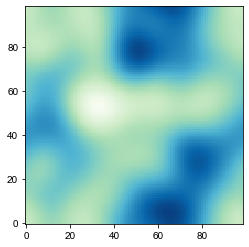

8720 50000 99 0.5844977533564132 0.09030302912915915
24490.0 25000.0 24490.0 25000.0


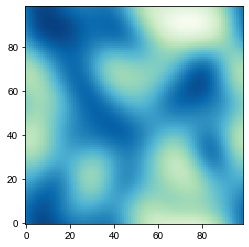

8720 50000 99 0.5411296485324659 0.058943441690866634
24490.0 25000.0 24490.0 25000.0


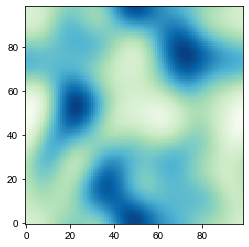

8720 50000 99 0.5777419924989075 -0.04247926619247205
24490.0 25000.0 24490.0 25000.0


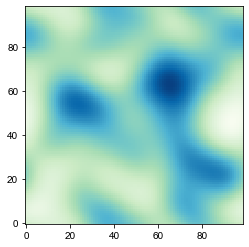

8720 50000 99 0.46941150669583626 -0.06381338153345187
24490.0 25000.0 24490.0 25000.0


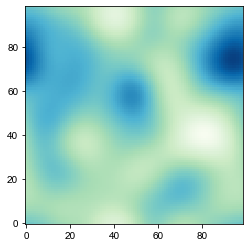

8720 50000 99 0.6765205388842948 0.17074111043466583
24490.0 25000.0 24490.0 25000.0


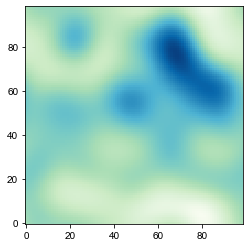

8720 50000 99 0.5428769362230271 0.06582601548577816
24490.0 25000.0 24490.0 25000.0


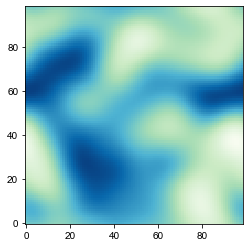

8720 50000 99 0.47000704778024627 -0.07550151120235797
24490.0 25000.0 24490.0 25000.0


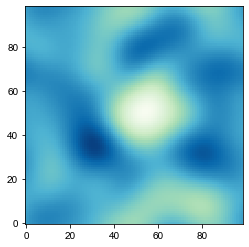

8720 50000 99 0.5656056535420982 0.04072727861566626
24490.0 25000.0 24490.0 25000.0


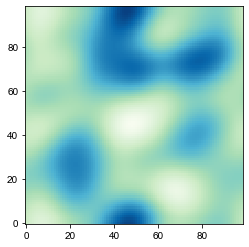

8720 50000 99 0.6130914445016847 -0.09077339590692811
24490.0 25000.0 24490.0 25000.0


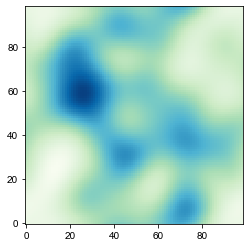

8720 50000 99 0.4708586190407347 -0.2750306027972419
24490.0 25000.0 24490.0 25000.0


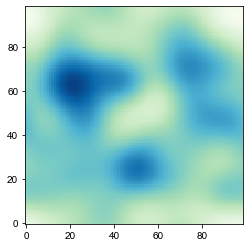

8720 50000 99 0.5113605935849903 0.0876510530037306
24490.0 25000.0 24490.0 25000.0


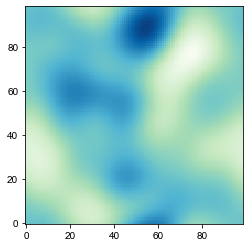

8720 50000 99 0.558214866610326 0.1970921274421347
24490.0 25000.0 24490.0 25000.0


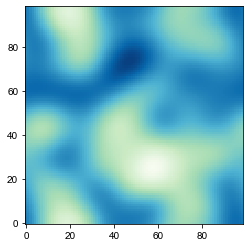

8720 50000 99 0.5101086776062622 -0.11011252753623821
24490.0 25000.0 24490.0 25000.0


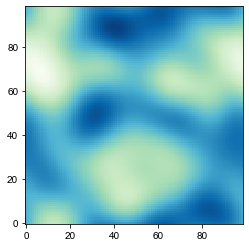

8720 50000 99 0.6072568662807899 0.25076865623448774
24490.0 25000.0 24490.0 25000.0


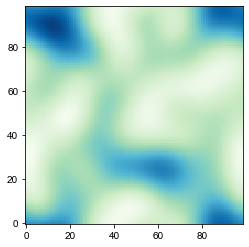

8720 50000 99 0.5332039281806376 0.2276879658282191
24490.0 25000.0 24490.0 25000.0


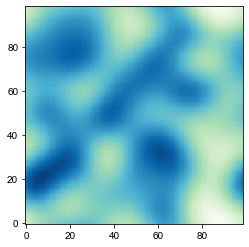

8720 50000 99 0.4592276013776975 0.14275935669205464
24490.0 25000.0 24490.0 25000.0


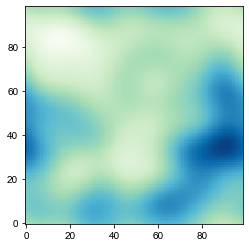

8720 50000 99 0.6523621583151804 -0.013308973560503045
24490.0 25000.0 24490.0 25000.0


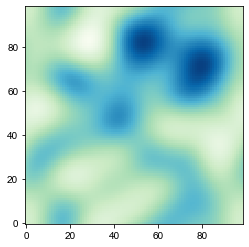

8720 50000 99 0.433086225734663 0.18535349545376475
24490.0 25000.0 24490.0 25000.0


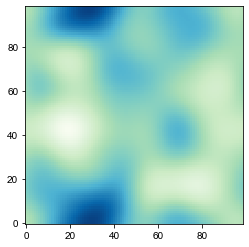

8720 50000 99 0.5320975857151503 0.11424850973397431
24490.0 25000.0 24490.0 25000.0


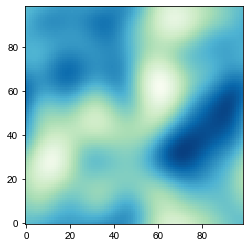

8720 50000 99 0.4477586505228728 -0.32943042143946344
24490.0 25000.0 24490.0 25000.0


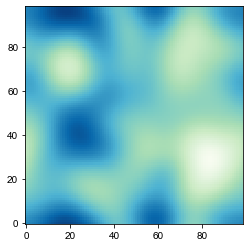

8720 50000 99 0.5577149058906554 0.07426075456230435
24490.0 25000.0 24490.0 25000.0


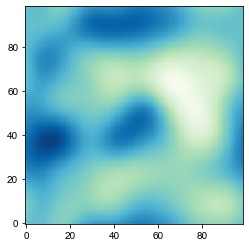

8720 50000 99 0.535960690778426 0.14144546077375195
24490.0 25000.0 24490.0 25000.0


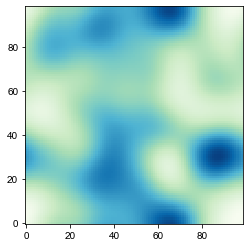

8720 50000 99 0.5760571707350177 -0.14394121479083666
24490.0 25000.0 24490.0 25000.0


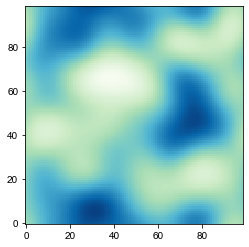

8720 50000 99 0.5243486167641473 0.023503077033946673
24490.0 25000.0 24490.0 25000.0


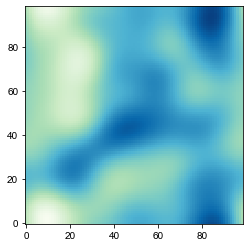

8720 50000 99 0.5719552556239367 0.02547686138698544
24490.0 25000.0 24490.0 25000.0


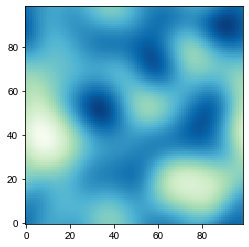

8720 50000 99 0.5944469171153118 -0.16414184892593284
24490.0 25000.0 24490.0 25000.0


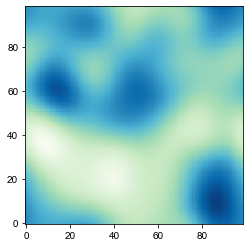

8720 50000 99 0.6508400763040855 0.2213152112664898
24490.0 25000.0 24490.0 25000.0


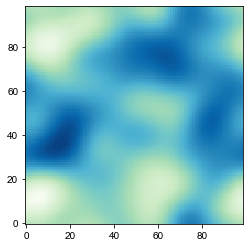

8720 50000 99 0.5282974809649668 -0.2520435489249965
24490.0 25000.0 24490.0 25000.0


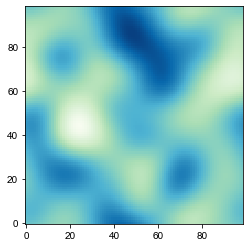

8720 50000 99 0.5555243294677482 0.058279105051438
24490.0 25000.0 24490.0 25000.0


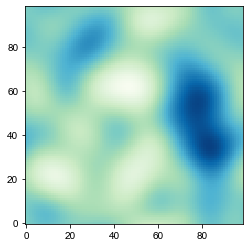

8720 50000 99 0.4760355726667253 -0.15382012847094992
24490.0 25000.0 24490.0 25000.0


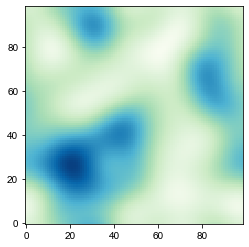

8720 50000 99 0.5883184514230032 -0.5131017031741748
24490.0 25000.0 24490.0 25000.0


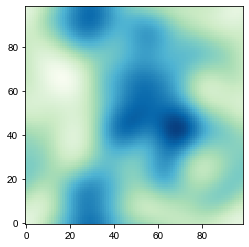

8720 50000 99 0.5822183690119027 -0.12160936467543981
24490.0 25000.0 24490.0 25000.0


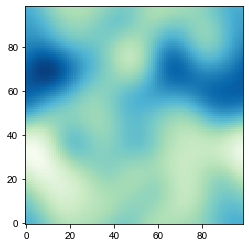

8720 50000 99 0.6650432945672256 0.07800087006779542
24490.0 25000.0 24490.0 25000.0


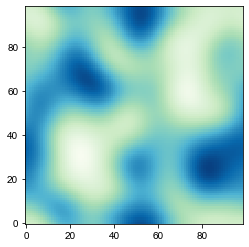

8720 50000 99 0.43886261005232285 0.2690937911764598
24490.0 25000.0 24490.0 25000.0


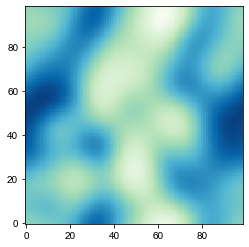

8720 50000 99 0.5177692581832634 -0.07527598816743782
24490.0 25000.0 24490.0 25000.0


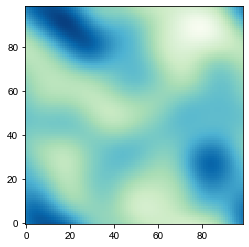

8720 50000 99 0.5874953595063731 -0.21690460870974407
24490.0 25000.0 24490.0 25000.0


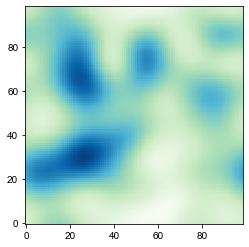

8720 50000 99 0.4512543550706928 -0.1063000422811859
24490.0 25000.0 24490.0 25000.0


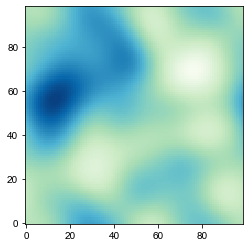

8720 50000 99 0.6674229958922167 0.33703540158234396
24490.0 25000.0 24490.0 25000.0


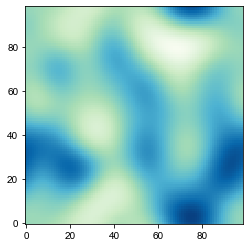

8720 50000 99 0.5934396309985874 0.2186313775242129
24490.0 25000.0 24490.0 25000.0


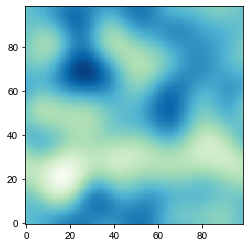

8720 50000 99 0.3983325461920167 -0.004239509351856894
24490.0 25000.0 24490.0 25000.0


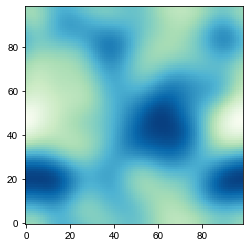

8720 50000 99 0.6097850217174591 -0.10827981326755304
24490.0 25000.0 24490.0 25000.0


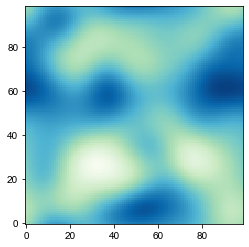

8720 50000 99 0.5735586056070281 0.1003485524033462
24490.0 25000.0 24490.0 25000.0


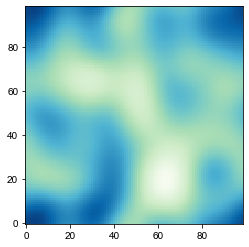

8720 50000 99 0.5131563893226283 -0.11515064771857579
24490.0 25000.0 24490.0 25000.0


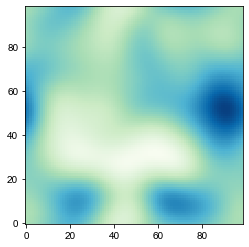

8720 50000 99 0.6990348695494565 -0.14782329033784558
24490.0 25000.0 24490.0 25000.0


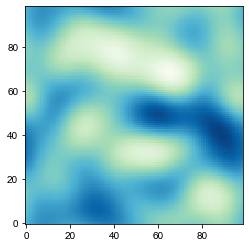

8720 50000 99 0.37141089425369195 0.21756415725647557
24490.0 25000.0 24490.0 25000.0


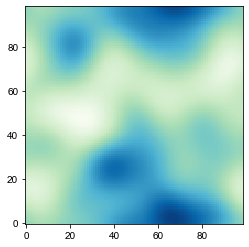

8720 50000 99 0.576277497156977 0.05724378874605297
24490.0 25000.0 24490.0 25000.0


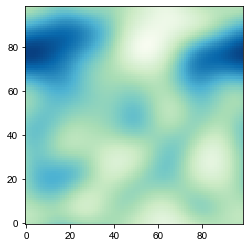

8720 50000 99 0.5275061686603633 0.3093783790166975
24490.0 25000.0 24490.0 25000.0


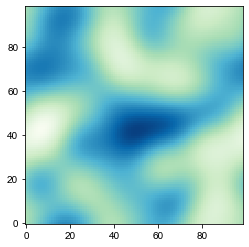

8720 50000 99 0.6243175957068482 0.4005330895012863
24490.0 25000.0 24490.0 25000.0


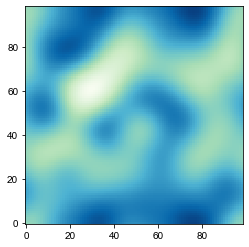

8720 50000 99 0.4595019219726733 -0.22655483491571698
24490.0 25000.0 24490.0 25000.0


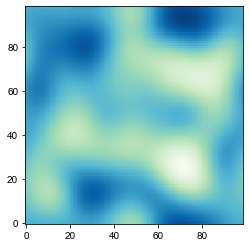

8720 50000 99 0.5169542043467222 0.12317949115673481
24490.0 25000.0 24490.0 25000.0


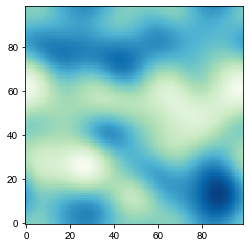

8720 50000 99 0.457582192993165 -0.2994708258086436
24490.0 25000.0 24490.0 25000.0


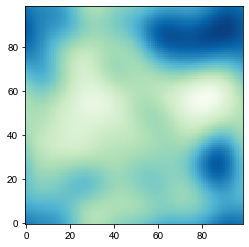

8720 50000 99 0.6407346465515538 -0.1264244078496157
24490.0 25000.0 24490.0 25000.0


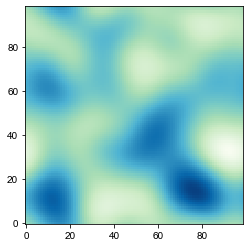

8720 50000 99 0.4913731196805614 0.2826925639325534
24490.0 25000.0 24490.0 25000.0


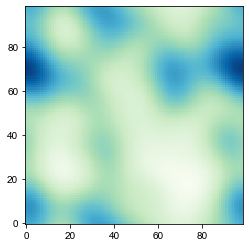

8720 50000 99 0.6105414869688696 0.29193909097200565
24490.0 25000.0 24490.0 25000.0


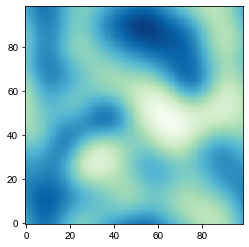

8720 50000 99 0.49696198522833035 0.08657402145232049
24490.0 25000.0 24490.0 25000.0


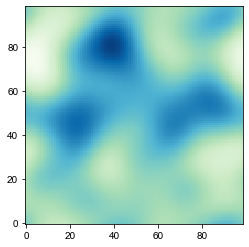

8720 50000 99 0.6378570737438349 -0.05836230501566666
24490.0 25000.0 24490.0 25000.0


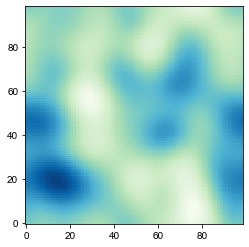

8720 50000 99 0.43381299060185263 0.1013988903378936
24490.0 25000.0 24490.0 25000.0


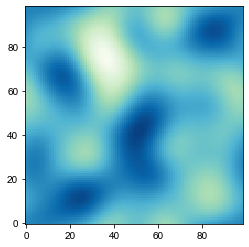

8720 50000 99 0.48670417071156685 0.23422236520036185
24490.0 25000.0 24490.0 25000.0


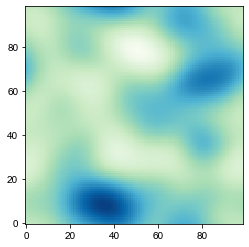

8720 50000 99 0.49797500292886776 0.05596199641657046
24490.0 25000.0 24490.0 25000.0


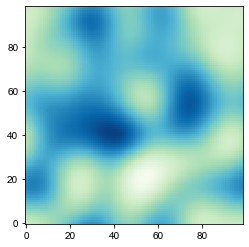

8720 50000 99 0.5877259562966459 0.13882921732838552
24490.0 25000.0 24490.0 25000.0


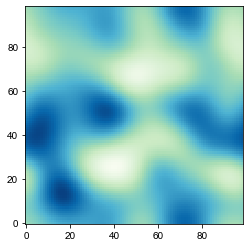

8720 50000 99 0.4690146740554437 -0.24783105600532
24490.0 25000.0 24490.0 25000.0


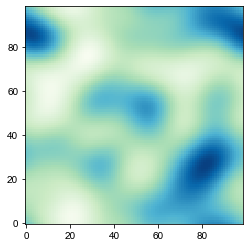

8720 50000 99 0.43341763219825513 -0.05165758104281851
24490.0 25000.0 24490.0 25000.0


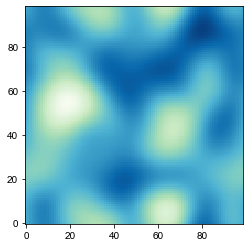

8720 50000 99 0.4004867214459884 -0.21801413319233076
24490.0 25000.0 24490.0 25000.0


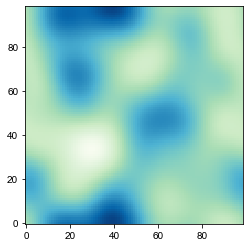

8720 50000 99 0.5398639383828899 0.10304711293823561
24490.0 25000.0 24490.0 25000.0


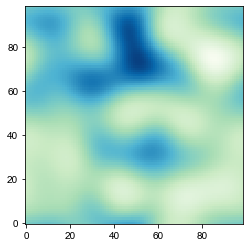

8720 50000 99 0.5075534171292689 0.12005344030659094
24490.0 25000.0 24490.0 25000.0


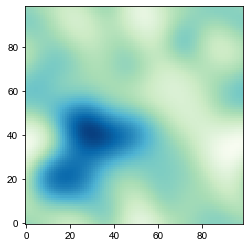

8720 50000 99 0.564816190956069 -0.04950268409734231
24490.0 25000.0 24490.0 25000.0


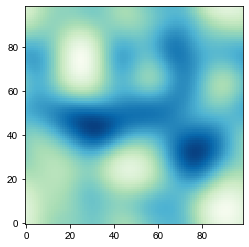

8720 50000 99 0.551423709630927 -0.050332901037638406
24490.0 25000.0 24490.0 25000.0


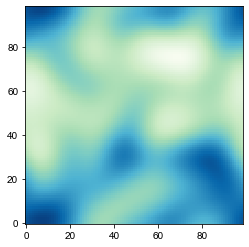

8720 50000 99 0.5501789294495414 -0.10504959867857161
24490.0 25000.0 24490.0 25000.0


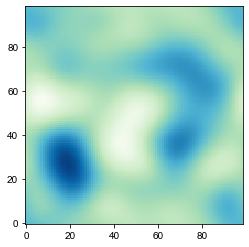

8720 50000 99 0.47879694307860626 0.15424556630414127
24490.0 25000.0 24490.0 25000.0


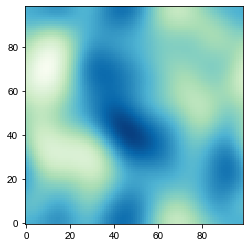

8720 50000 99 0.6342732391490459 -0.059035533781656845
24490.0 25000.0 24490.0 25000.0


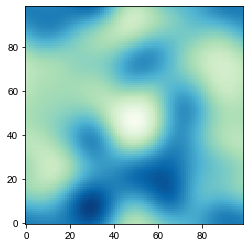

8720 50000 99 0.5337954313160852 -0.15794336812398593
24490.0 25000.0 24490.0 25000.0


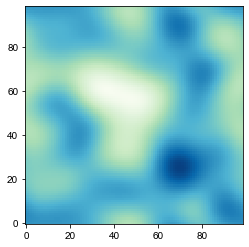

8720 50000 99 0.38307759411167736 -0.028458156247808238
24490.0 25000.0 24490.0 25000.0


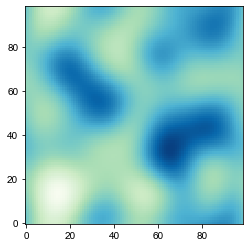

8720 50000 99 0.6298820694523593 -0.2398344955525332
24490.0 25000.0 24490.0 25000.0


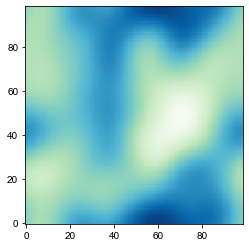

8720 50000 99 0.6860596866269223 -0.05636092148207588
24490.0 25000.0 24490.0 25000.0


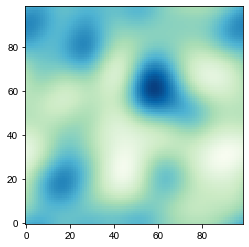

8720 50000 99 0.5610413798955777 0.0268435189639861
24490.0 25000.0 24490.0 25000.0


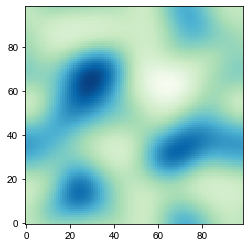

8720 50000 99 0.5242560573845212 -0.03484067082970415
24490.0 25000.0 24490.0 25000.0


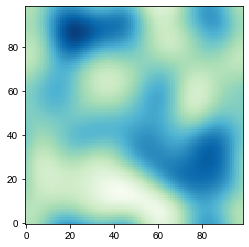

8720 50000 99 0.5229374473203438 -0.14111835872257655
24490.0 25000.0 24490.0 25000.0


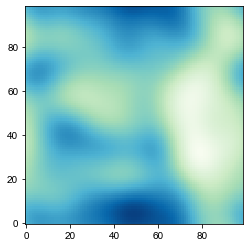

8720 50000 99 0.5821178152682769 -0.15685473739776384
24490.0 25000.0 24490.0 25000.0


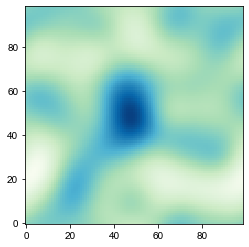

8720 50000 99 0.5138232791099737 0.27468129647082845
24490.0 25000.0 24490.0 25000.0


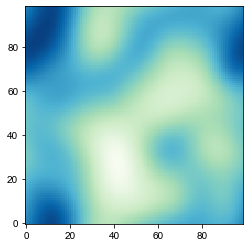

8720 50000 99 0.6827367434638981 -0.3441124308832626
24490.0 25000.0 24490.0 25000.0


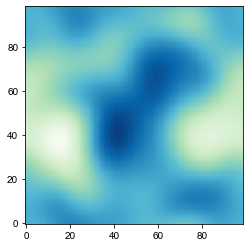

8720 50000 99 0.6721693631714232 -0.21775372191295467
24490.0 25000.0 24490.0 25000.0


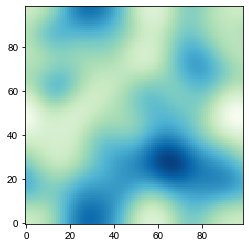

8720 50000 99 0.5894686015650149 -0.11987283435114654
24490.0 25000.0 24490.0 25000.0


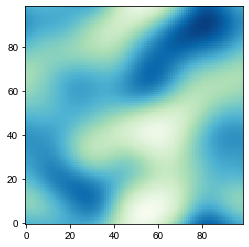

8720 50000 99 0.7500577619567819 0.08660008664822921
24490.0 25000.0 24490.0 25000.0


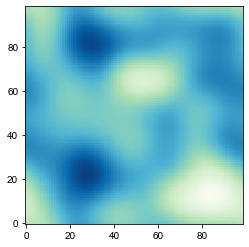

8720 50000 99 0.6374954772576157 0.13903157013942605
24490.0 25000.0 24490.0 25000.0


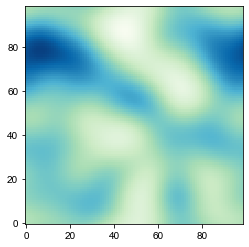

8720 50000 99 0.5026479043993101 -0.16555168793267755
24490.0 25000.0 24490.0 25000.0


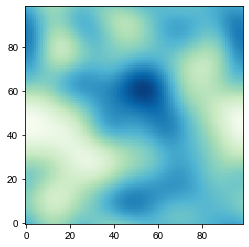

8720 50000 99 0.5700103167533016 -0.24567532387160837
24490.0 25000.0 24490.0 25000.0


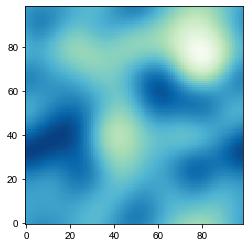

8720 50000 99 0.7374700542978703 0.09923816940048255
24490.0 25000.0 24490.0 25000.0


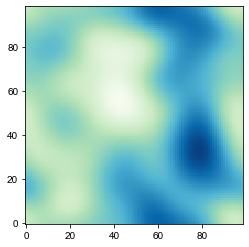

8720 50000 99 0.6670830921068216 0.11943419999418306
24490.0 25000.0 24490.0 25000.0


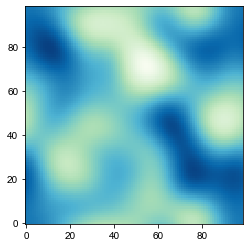

8720 50000 99 0.570837033320524 -0.061053216247439625
24490.0 25000.0 24490.0 25000.0


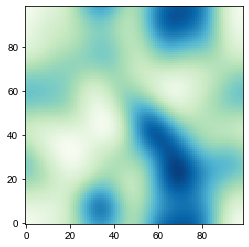

8720 50000 99 0.5240689066410472 0.006224106078339372
24490.0 25000.0 24490.0 25000.0


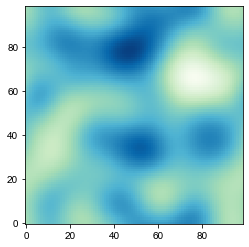

8720 50000 99 0.4881158285177315 0.054603163175909936
24490.0 25000.0 24490.0 25000.0


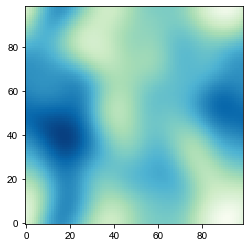

8720 50000 99 0.6512228842934354 0.23523893393557777
24490.0 25000.0 24490.0 25000.0


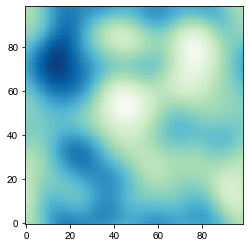

8720 50000 99 0.501873675317086 -0.152575489383431
24490.0 25000.0 24490.0 25000.0


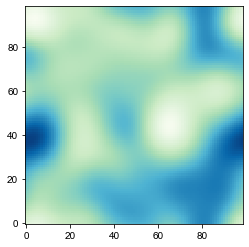

8720 50000 99 0.5562716572434294 0.06476817767084078
24490.0 25000.0 24490.0 25000.0


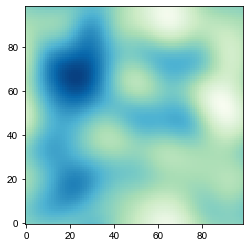

8720 50000 99 0.6139465765882882 -0.0963746623333727
24490.0 25000.0 24490.0 25000.0


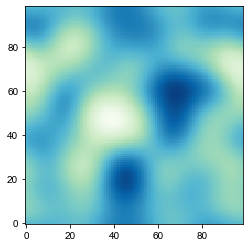

8720 50000 99 0.49690807607178106 -0.40531389581091765
24490.0 25000.0 24490.0 25000.0


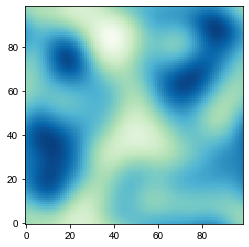

8720 50000 99 0.5435259788166649 0.15067276474245256
24490.0 25000.0 24490.0 25000.0


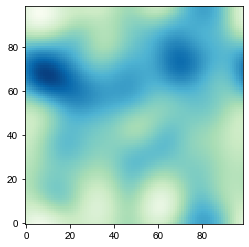

8720 50000 99 0.5009557524836757 0.0203438691275247
24490.0 25000.0 24490.0 25000.0


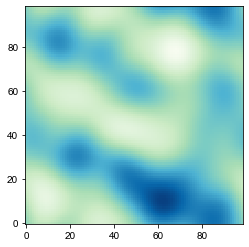

8720 50000 99 0.47907318448736785 0.1351665571954229
24490.0 25000.0 24490.0 25000.0


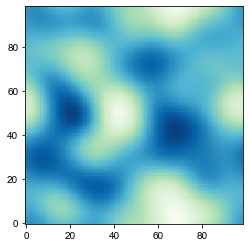

8720 50000 99 0.4341872262459879 -0.33268416063692413
24490.0 25000.0 24490.0 25000.0


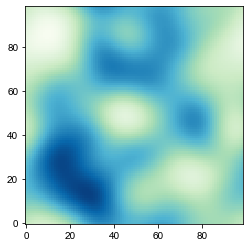

8720 50000 99 0.5792676715709225 0.2325954541997801
24490.0 25000.0 24490.0 25000.0


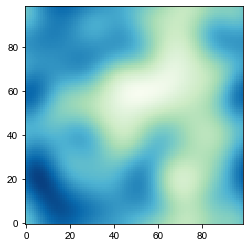

8720 50000 99 0.6172975914688151 -0.13905384071110075
24490.0 25000.0 24490.0 25000.0


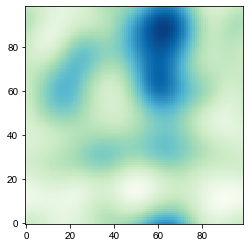

8720 50000 99 0.7235728320862842 -0.14613092613760767
24490.0 25000.0 24490.0 25000.0


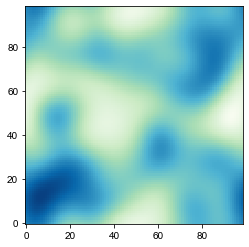

8720 50000 99 0.5319902194616271 -0.041941410274163086
24490.0 25000.0 24490.0 25000.0


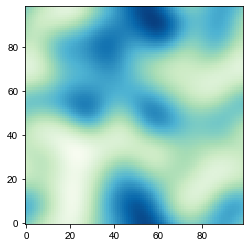

8720 50000 99 0.4803911380180464 -0.2997316195852404
24490.0 25000.0 24490.0 25000.0


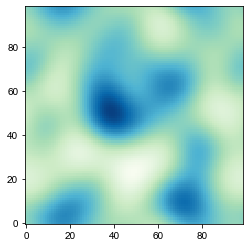

8720 50000 99 0.5469307651153941 0.10865684357435297
24490.0 25000.0 24490.0 25000.0


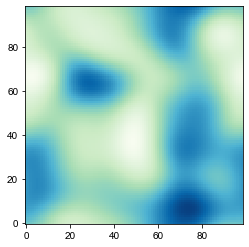

8720 50000 99 0.5458609060182313 0.2813689876765666
24490.0 25000.0 24490.0 25000.0


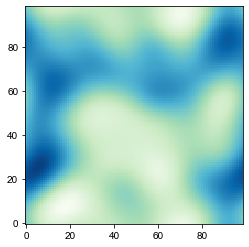

8720 50000 99 0.6292771042500865 0.27647803774193036
24490.0 25000.0 24490.0 25000.0


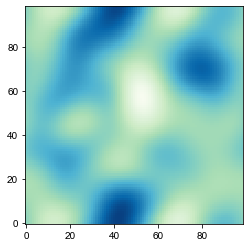

8720 50000 99 0.47775236774996765 -0.24031266372699547
24490.0 25000.0 24490.0 25000.0


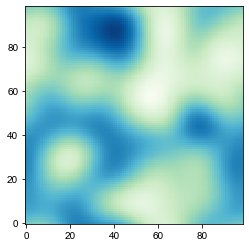

8720 50000 99 0.5310035199634823 -0.08214143892841722
24490.0 25000.0 24490.0 25000.0


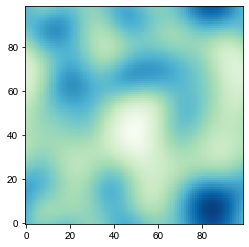

8720 50000 99 0.5721773058443309 -0.05584936157653802
24490.0 25000.0 24490.0 25000.0


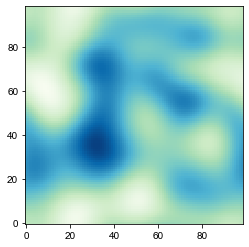

8720 50000 99 0.607847367656881 0.13872374144487326
24490.0 25000.0 24490.0 25000.0


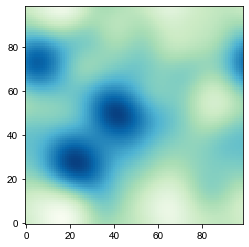

8720 50000 99 0.7223529195970448 0.15427888577302568
24490.0 25000.0 24490.0 25000.0


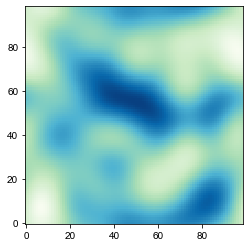

8720 50000 99 0.4667569133115941 0.07322674074524206
24490.0 25000.0 24490.0 25000.0


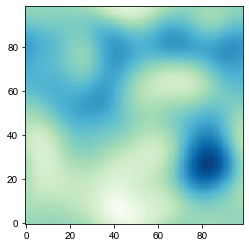

8720 50000 99 0.525004574805081 -0.035344019463755316
24490.0 25000.0 24490.0 25000.0


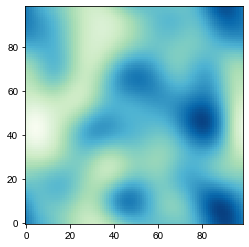

8720 50000 99 0.4525328920127528 -0.08757269134338903
24490.0 25000.0 24490.0 25000.0


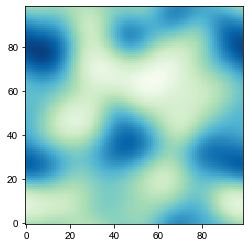

8720 50000 99 0.49805733959406434 -0.19441078957000768
24490.0 25000.0 24490.0 25000.0


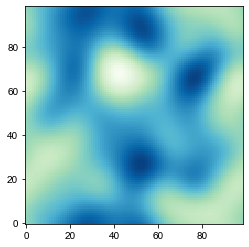

8720 50000 99 0.4631044727975333 -0.09048751246656667
24490.0 25000.0 24490.0 25000.0


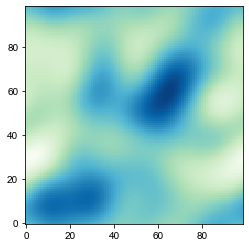

8720 50000 99 0.6336908157313917 -0.2552156612042086
24490.0 25000.0 24490.0 25000.0


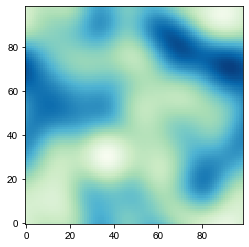

8720 50000 99 0.4279693492112107 0.1138818237195156
24490.0 25000.0 24490.0 25000.0


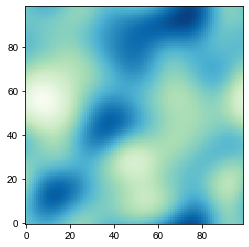

8720 50000 99 0.5250773616898398 -0.08708861261367408
24490.0 25000.0 24490.0 25000.0


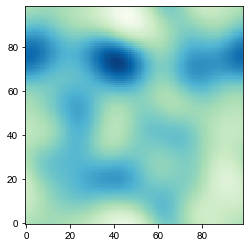

8720 50000 99 0.5522912905362407 0.015910679794393156
24490.0 25000.0 24490.0 25000.0


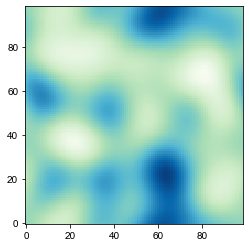

8720 50000 99 0.4755440454747018 -0.18169074939120936
24490.0 25000.0 24490.0 25000.0


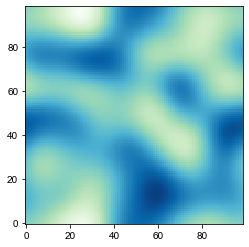

8720 50000 99 0.45117745568841133 0.3379672853484393
24490.0 25000.0 24490.0 25000.0


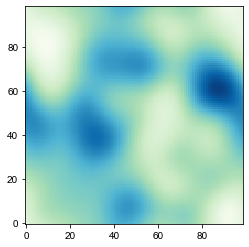

8720 50000 99 0.5950523086503156 0.0010634174509316261
24490.0 25000.0 24490.0 25000.0


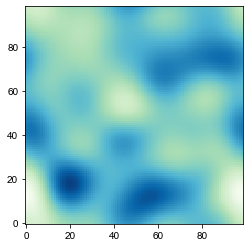

8720 50000 99 0.4066062512703011 -0.3704201490582954
24490.0 25000.0 24490.0 25000.0


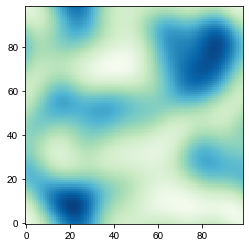

8720 50000 99 0.47637502015535904 0.08241621525878798
24490.0 25000.0 24490.0 25000.0


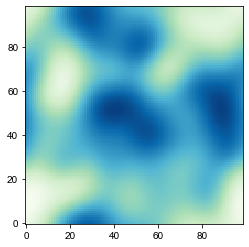

8720 50000 99 0.5184480385991799 0.2835549114744469
24490.0 25000.0 24490.0 25000.0


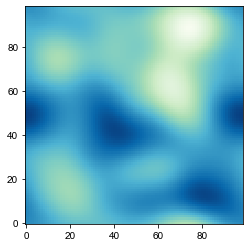

8720 50000 99 0.7064623719977825 -0.03143109328986693
24490.0 25000.0 24490.0 25000.0


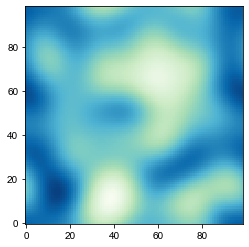

8720 50000 99 0.5008287449457558 -0.1664354990639162
24490.0 25000.0 24490.0 25000.0


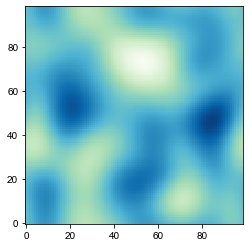

8720 50000 99 0.48272563333231794 -0.06707375339771483
24490.0 25000.0 24490.0 25000.0


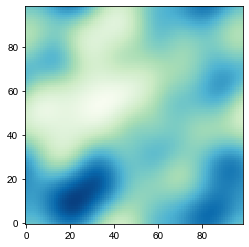

8720 50000 99 0.7171620612820604 0.2780105539599136
24490.0 25000.0 24490.0 25000.0


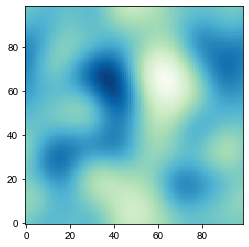

8720 50000 99 0.5485420319748044 0.07337609496852868
24490.0 25000.0 24490.0 25000.0


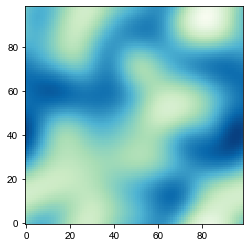

8720 50000 99 0.5072767063203432 -0.13192634117029237
24490.0 25000.0 24490.0 25000.0


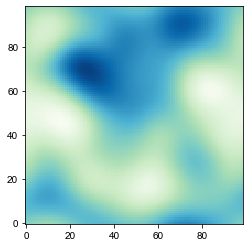

8720 50000 99 0.7445444804048038 -0.11798261295137834
24490.0 25000.0 24490.0 25000.0


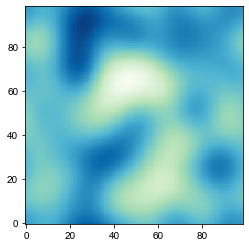

8720 50000 99 0.4832598129145063 0.18784080751028276
24490.0 25000.0 24490.0 25000.0


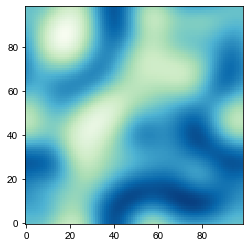

8720 50000 99 0.49717761930145316 -0.09295508299276559
24490.0 25000.0 24490.0 25000.0


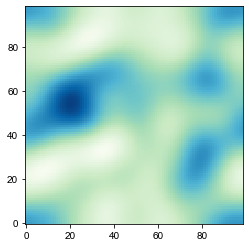

8720 50000 99 0.4888008553531189 -0.24083488456481597
24490.0 25000.0 24490.0 25000.0


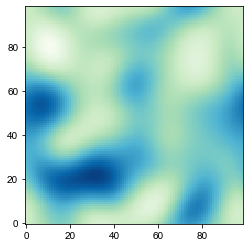

8720 50000 99 0.4843530452355529 -0.03490853030383441
24490.0 25000.0 24490.0 25000.0


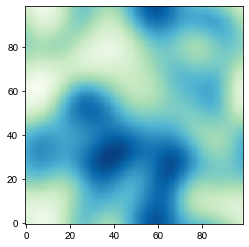

8720 50000 99 0.5160282435519234 0.19602169698444835
24490.0 25000.0 24490.0 25000.0


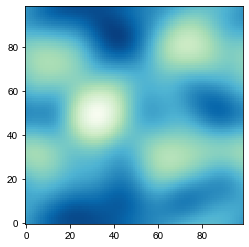

8720 50000 99 0.6635981375580751 0.14444030410453593
24490.0 25000.0 24490.0 25000.0


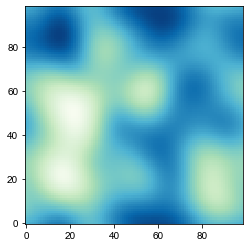

8720 50000 99 0.6112998121850362 0.26043984604671794
24490.0 25000.0 24490.0 25000.0


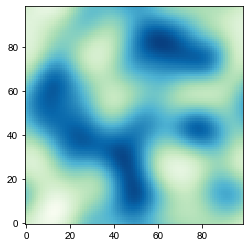

8720 50000 99 0.4105292265418238 -0.3015009039031975
24490.0 25000.0 24490.0 25000.0


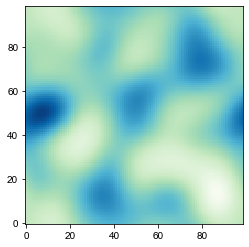

8720 50000 99 0.4657840969542857 -0.01629049739516438
24490.0 25000.0 24490.0 25000.0


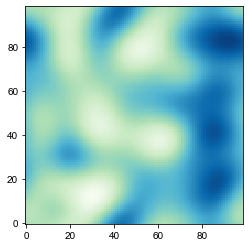

8720 50000 99 0.4084281322216545 0.012605264488641623
24490.0 25000.0 24490.0 25000.0


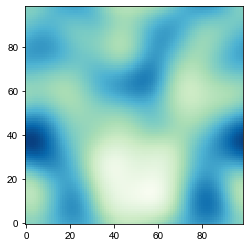

8720 50000 99 0.66894483827835 0.2562120836199541
24490.0 25000.0 24490.0 25000.0


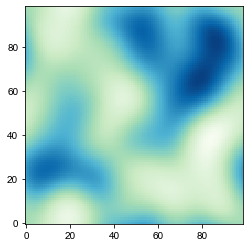

8720 50000 99 0.6694644048184133 0.05103372206834071
24490.0 25000.0 24490.0 25000.0


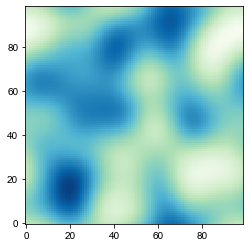

8720 50000 99 0.5321738882950169 0.2672776820198991
24490.0 25000.0 24490.0 25000.0


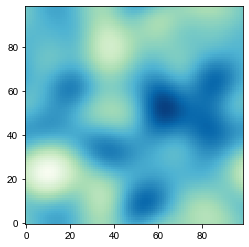

8720 50000 99 0.4589930911444602 0.2533361952388989
24490.0 25000.0 24490.0 25000.0


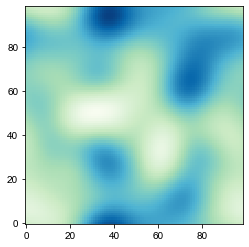

8720 50000 99 0.5804907136372695 -0.07525227915955067
24490.0 25000.0 24490.0 25000.0


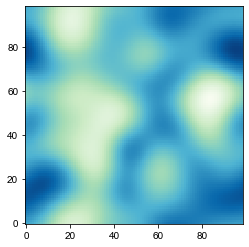

8720 50000 99 0.4944543137477155 -0.20465864413423787
24490.0 25000.0 24490.0 25000.0


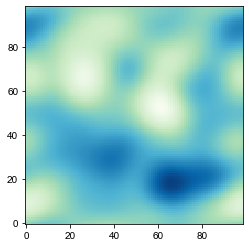

8720 50000 99 0.3955010981394364 0.3886007266052862
24490.0 25000.0 24490.0 25000.0


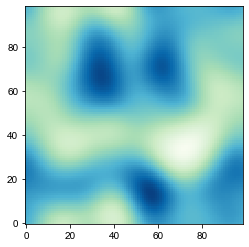

8720 50000 99 0.5563689303680633 -0.019889072215482514
24490.0 25000.0 24490.0 25000.0


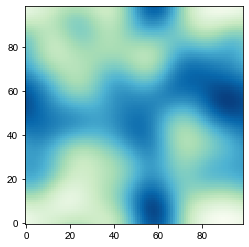

8720 50000 99 0.6562423170413708 -0.07047953993848824
24490.0 25000.0 24490.0 25000.0


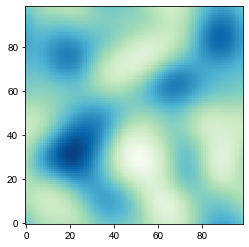

8720 50000 99 0.5544734170811116 0.22521990263769598
24490.0 25000.0 24490.0 25000.0


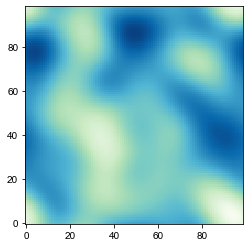

8720 50000 99 0.5144198974562838 -0.023235213069929594
24490.0 25000.0 24490.0 25000.0


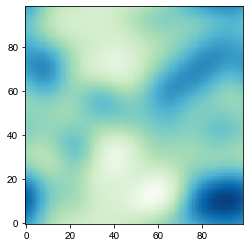

8720 50000 99 0.6015410765331948 -0.0750307164418704
24490.0 25000.0 24490.0 25000.0


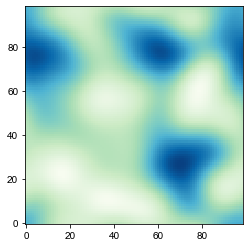

8720 50000 99 0.5244993782886138 0.1325953386196387
24490.0 25000.0 24490.0 25000.0


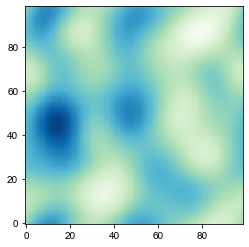

8720 50000 99 0.4789290106138739 -0.09568251442321245
24490.0 25000.0 24490.0 25000.0


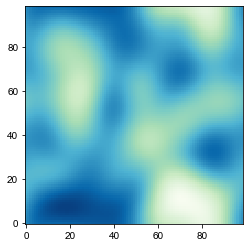

8720 50000 99 0.5333554877854737 -0.03516677861969326
24490.0 25000.0 24490.0 25000.0


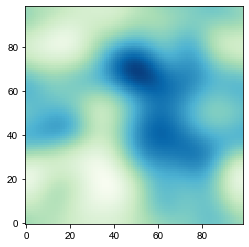

8720 50000 99 0.6698862806043757 -0.009681125949885263
24490.0 25000.0 24490.0 25000.0


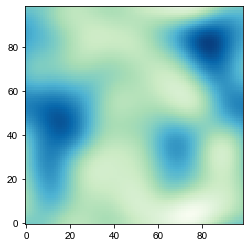

8720 50000 99 0.5564618122151287 -0.18675615755566582
24490.0 25000.0 24490.0 25000.0


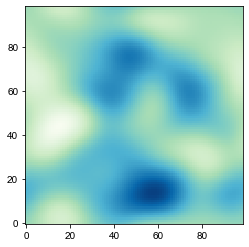

8720 50000 99 0.49286547632284344 -0.029087052879980955
24490.0 25000.0 24490.0 25000.0


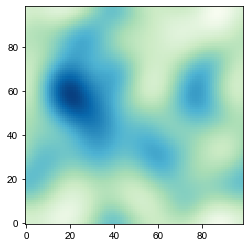

8720 50000 99 0.6612666619779334 -0.04590728462069011
24490.0 25000.0 24490.0 25000.0


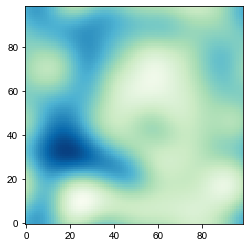

8720 50000 99 0.549154368989116 -0.18100570459602522
24490.0 25000.0 24490.0 25000.0


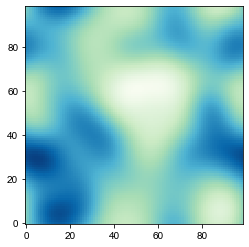

8720 50000 99 0.5346491595507897 0.04086873402704909
24490.0 25000.0 24490.0 25000.0


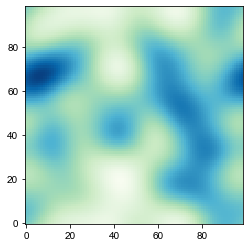

8720 50000 99 0.48416719667425834 -0.2642618714447914
24490.0 25000.0 24490.0 25000.0


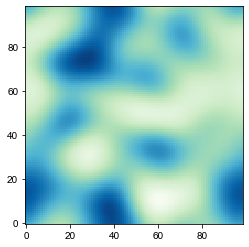

8720 50000 99 0.40520339480702544 -0.07312491972732706
24490.0 25000.0 24490.0 25000.0


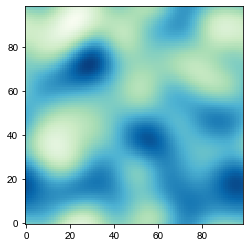

8720 50000 99 0.4110813725079293 -0.017833318460296958
24490.0 25000.0 24490.0 25000.0


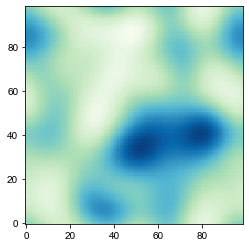

8720 50000 99 0.4374994179029869 0.3923521085882087
24490.0 25000.0 24490.0 25000.0


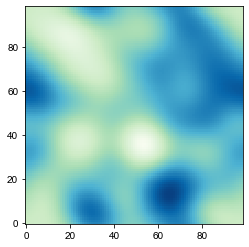

8720 50000 99 0.5814826484761324 -0.07851773143476777
24490.0 25000.0 24490.0 25000.0


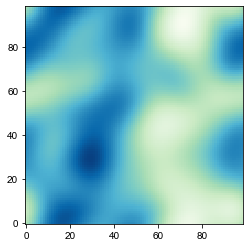

8720 50000 99 0.5375907987982781 -0.08391402059218676
24490.0 25000.0 24490.0 25000.0


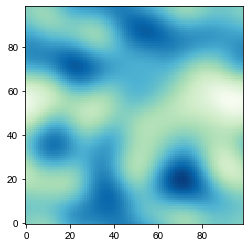

8720 50000 99 0.3825327337948851 0.07781482698296101
24490.0 25000.0 24490.0 25000.0


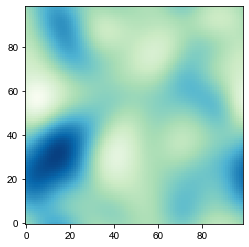

8720 50000 99 0.5174474452456962 0.43754160443019885
24490.0 25000.0 24490.0 25000.0


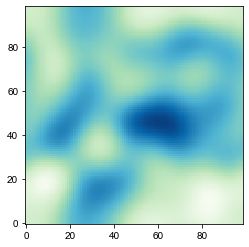

8720 50000 99 0.5401445034145741 -0.29012035954429927
24490.0 25000.0 24490.0 25000.0


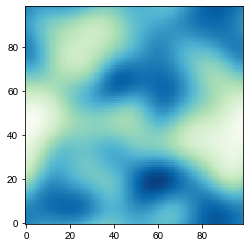

8720 50000 99 0.5583246086421316 0.142943634882053
24490.0 25000.0 24490.0 25000.0


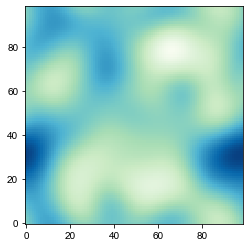

8720 50000 99 0.5686378180253895 0.07557673865538563
24490.0 25000.0 24490.0 25000.0


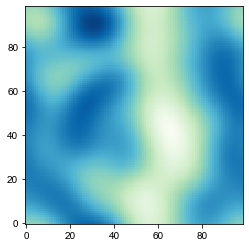

8720 50000 99 0.7449353305054311 0.03650667967715044
24490.0 25000.0 24490.0 25000.0


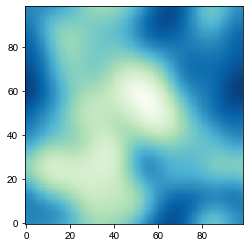

8720 50000 99 0.5816680851677827 -0.13726503874159085
24490.0 25000.0 24490.0 25000.0


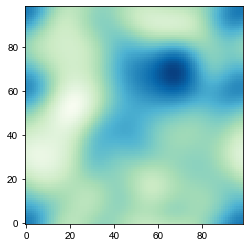

8720 50000 99 0.47941424464737703 -0.015180992275422044
24490.0 25000.0 24490.0 25000.0


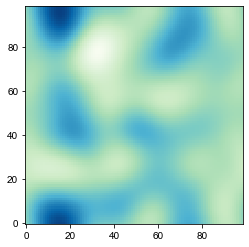

8720 50000 99 0.5321218630317757 -0.319086103859405
24490.0 25000.0 24490.0 25000.0


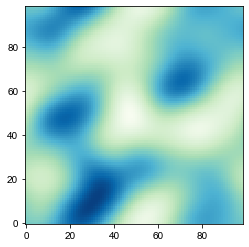

8720 50000 99 0.5317358613706025 0.05410661270285581
24490.0 25000.0 24490.0 25000.0


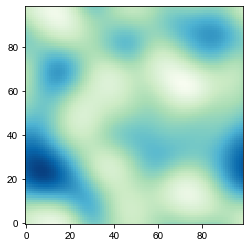

8720 50000 99 0.5450647824578277 -0.22540599342454695
24490.0 25000.0 24490.0 25000.0


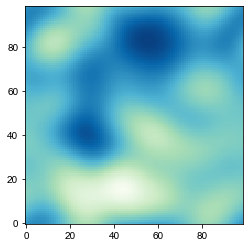

8720 50000 99 0.5954094234551514 0.2075938717418252
24490.0 25000.0 24490.0 25000.0


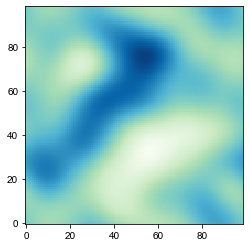

8720 50000 99 0.6602260360015755 -0.1268369946614018
24490.0 25000.0 24490.0 25000.0


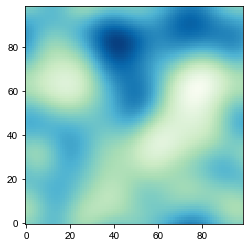

8720 50000 99 0.5307908588860877 -0.18863561637711038
24490.0 25000.0 24490.0 25000.0


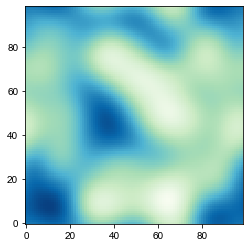

8720 50000 99 0.4304047088723449 -0.2824233290590807
24490.0 25000.0 24490.0 25000.0


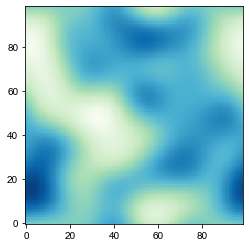

8720 50000 99 0.5630941212746288 0.18554441127262303
24490.0 25000.0 24490.0 25000.0


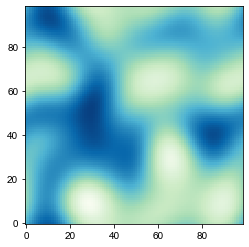

8720 50000 99 0.5225334806984276 0.3075000162273823
24490.0 25000.0 24490.0 25000.0


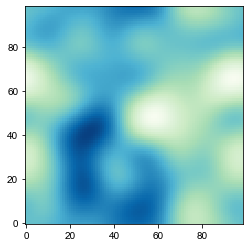

8720 50000 99 0.5388449652196662 -0.04555491523319399
24490.0 25000.0 24490.0 25000.0


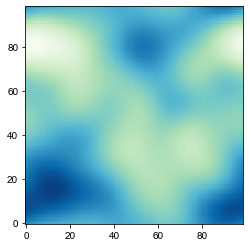

8720 50000 99 0.7090890827434786 0.2874502526638116
24490.0 25000.0 24490.0 25000.0


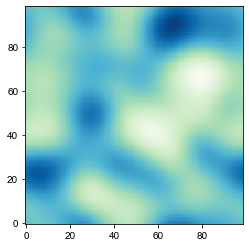

8720 50000 99 0.4134652533672449 -0.1355106511353372
24490.0 25000.0 24490.0 25000.0


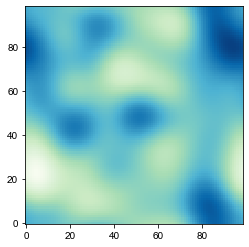

8720 50000 99 0.4575638493637322 -0.18779385016238087
24490.0 25000.0 24490.0 25000.0


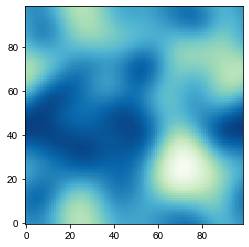

8720 50000 99 0.5742498099372574 0.05079758557053594
24490.0 25000.0 24490.0 25000.0


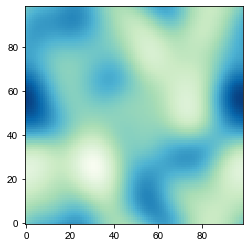

8720 50000 99 0.5764263734968805 0.15356063002498052
24490.0 25000.0 24490.0 25000.0


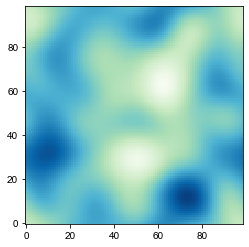

8720 50000 99 0.4422866407394257 -0.0109622093130254
24490.0 25000.0 24490.0 25000.0


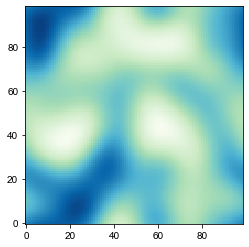

8720 50000 99 0.5742202876924779 -0.24313033283923108
24490.0 25000.0 24490.0 25000.0


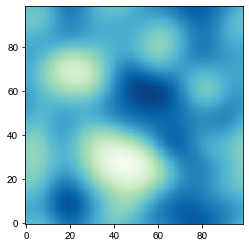

8720 50000 99 0.48410492722238324 0.12336657183788738
24490.0 25000.0 24490.0 25000.0


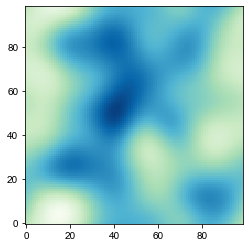

8720 50000 99 0.5031924628120974 0.2842315859371873
24490.0 25000.0 24490.0 25000.0


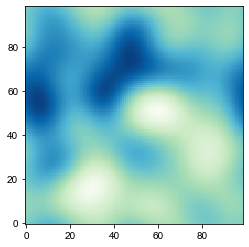

8720 50000 99 0.7411120989161601 -0.20765201669695865
24490.0 25000.0 24490.0 25000.0


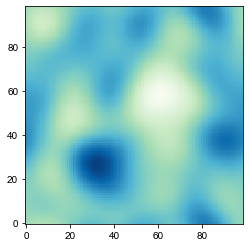

8720 50000 99 0.4696695625720103 -0.05995914438399477
24490.0 25000.0 24490.0 25000.0


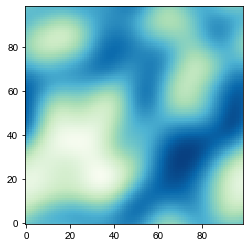

8720 50000 99 0.47890709967247475 -0.06650539677456059
24490.0 25000.0 24490.0 25000.0


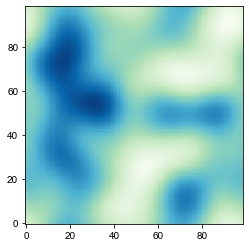

8720 50000 99 0.5861970896393539 -0.170071539092545
24490.0 25000.0 24490.0 25000.0


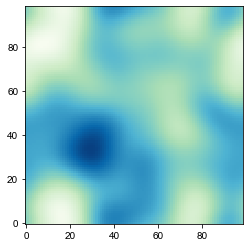

8720 50000 99 0.6292350663461093 0.2763503523369717
24490.0 25000.0 24490.0 25000.0


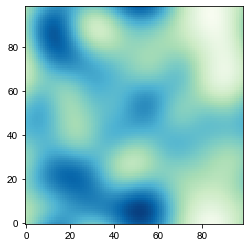

8720 50000 99 0.6971700960777146 0.03166414827014561
24490.0 25000.0 24490.0 25000.0


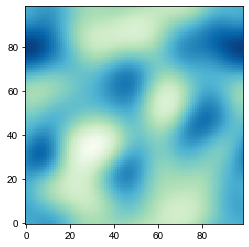

8720 50000 99 0.4767021025724214 0.15654964875732916
24490.0 25000.0 24490.0 25000.0


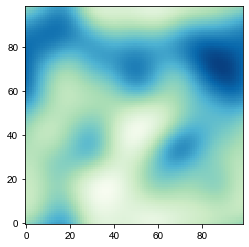

8720 50000 99 0.6180730849028276 0.25085844400311325
24490.0 25000.0 24490.0 25000.0


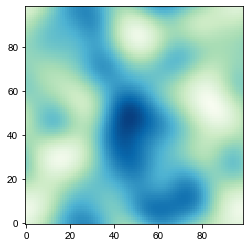

8720 50000 99 0.49587800724979114 -0.20673600352857843
24490.0 25000.0 24490.0 25000.0


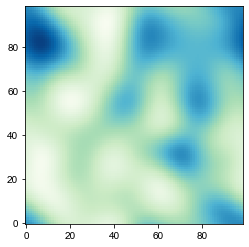

8720 50000 99 0.44354043759857636 -0.0076297533721975015
24490.0 25000.0 24490.0 25000.0


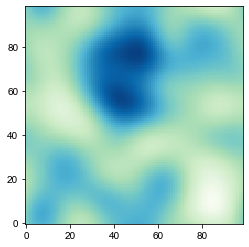

8720 50000 99 0.49333346206903617 -0.19579999160540262
24490.0 25000.0 24490.0 25000.0


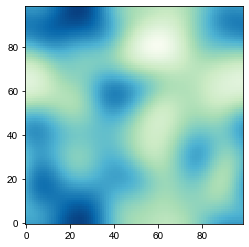

8720 50000 99 0.5482876899234326 0.10727958799615257
24490.0 25000.0 24490.0 25000.0


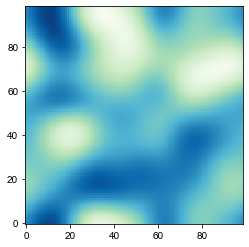

8720 50000 99 0.5399162756365511 0.12609112483208706
24490.0 25000.0 24490.0 25000.0


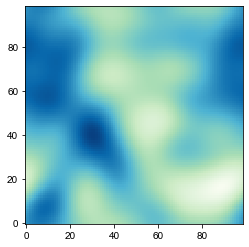

8720 50000 99 0.4954592066367582 0.09164457474137426
24490.0 25000.0 24490.0 25000.0


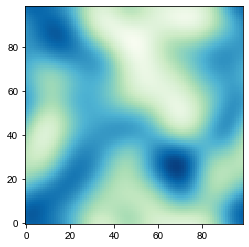

8720 50000 99 0.5503515488540983 -0.012819059666270043
24490.0 25000.0 24490.0 25000.0


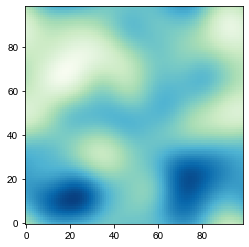

8720 50000 99 0.6347250864730107 -0.04698412089046881
24490.0 25000.0 24490.0 25000.0


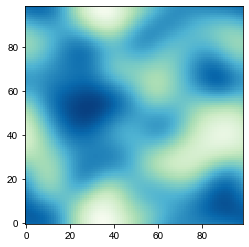

8720 50000 99 0.47434261057460037 -0.08317897703413263
24490.0 25000.0 24490.0 25000.0


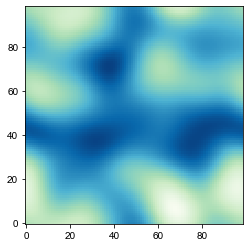

8720 50000 99 0.5566502771711103 -0.14709622202406536
24490.0 25000.0 24490.0 25000.0


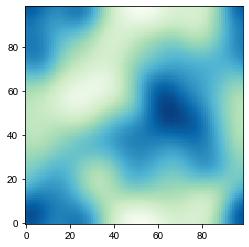

8720 50000 99 0.6963851008847887 -0.13232005893879675
24490.0 25000.0 24490.0 25000.0


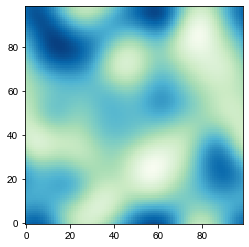

8720 50000 99 0.43845818351743043 0.21112023764296925
24490.0 25000.0 24490.0 25000.0


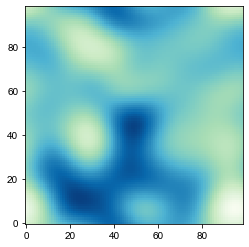

8720 50000 99 0.4913289883607597 0.017679523671578396
24490.0 25000.0 24490.0 25000.0


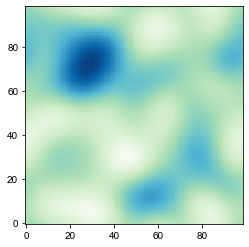

8720 50000 99 0.4328302292660856 -0.1854992134603951
24490.0 25000.0 24490.0 25000.0


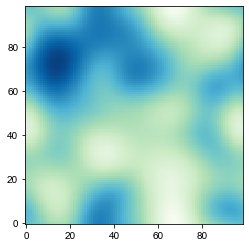

8720 50000 99 0.6370927325909932 -0.04545210196099469
24490.0 25000.0 24490.0 25000.0


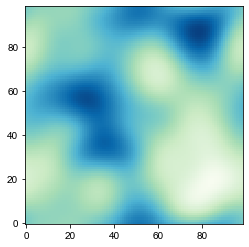

8720 50000 99 0.5116118904803753 -0.19059928245905713
24490.0 25000.0 24490.0 25000.0


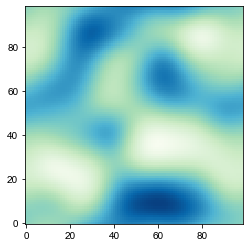

8720 50000 99 0.5437162278443504 -0.18791157170944553
24490.0 25000.0 24490.0 25000.0


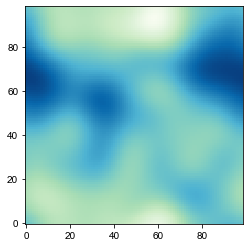

8720 50000 99 0.7231874701329527 -0.07212732211847436
24490.0 25000.0 24490.0 25000.0


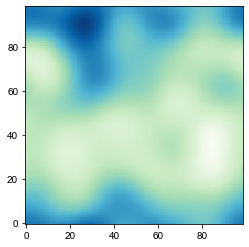

8720 50000 99 0.6312753387184414 0.09477828669672003
24490.0 25000.0 24490.0 25000.0


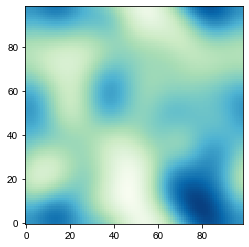

8720 50000 99 0.6523769152615431 -0.18820594388513923
24490.0 25000.0 24490.0 25000.0


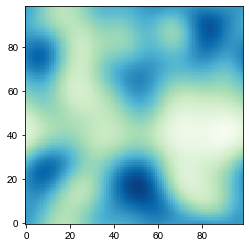

8720 50000 99 0.5587368657921139 0.13109737052498086
24490.0 25000.0 24490.0 25000.0


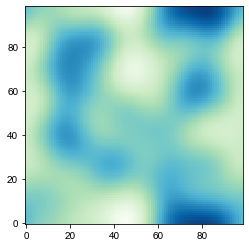

8720 50000 99 0.5140520826105378 -0.2840837066447245
24490.0 25000.0 24490.0 25000.0


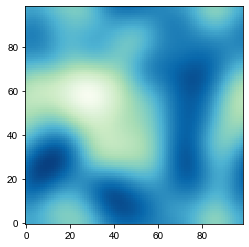

8720 50000 99 0.6679445883537701 0.30501970493060393
24490.0 25000.0 24490.0 25000.0


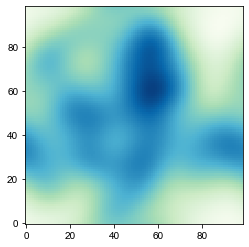

8720 50000 99 0.7584365622611412 0.07289922301669469
24490.0 25000.0 24490.0 25000.0


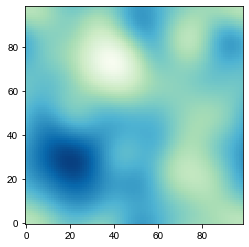

8720 50000 99 0.7084546306795608 0.20857797366494182
24490.0 25000.0 24490.0 25000.0


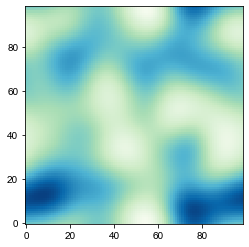

8720 50000 99 0.49511483866531686 0.03789337755105921
24490.0 25000.0 24490.0 25000.0


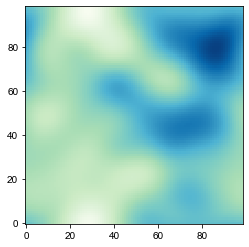

8720 50000 99 0.641476819668757 0.009184962691934863
24490.0 25000.0 24490.0 25000.0


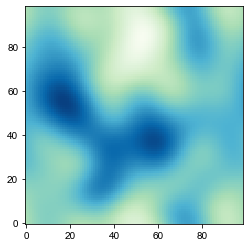

8720 50000 99 0.5957628820175599 0.035942760918306296
24490.0 25000.0 24490.0 25000.0


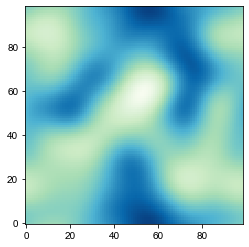

8720 50000 99 0.5031535684503557 -0.05091663706397661
24490.0 25000.0 24490.0 25000.0


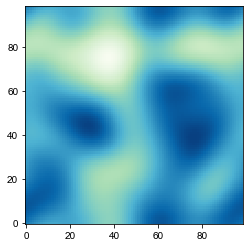

8720 50000 99 0.6347444607729296 0.2870699425891552
24490.0 25000.0 24490.0 25000.0


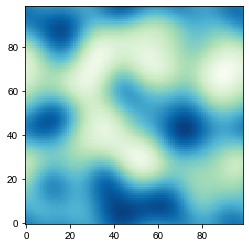

8720 50000 99 0.4610018751429126 -0.06752957563276508
24490.0 25000.0 24490.0 25000.0


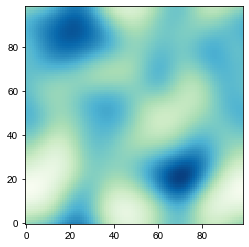

8720 50000 99 0.466225070218702 -0.16031289912336621
24490.0 25000.0 24490.0 25000.0


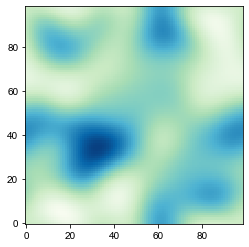

8720 50000 99 0.5676840517756986 0.18773793304388436
24490.0 25000.0 24490.0 25000.0


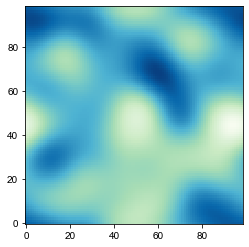

8720 50000 99 0.5213078120291724 0.08161119161169644
24490.0 25000.0 24490.0 25000.0


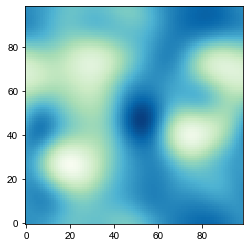

8720 50000 99 0.5736672454263229 -0.08109194887036059
24490.0 25000.0 24490.0 25000.0


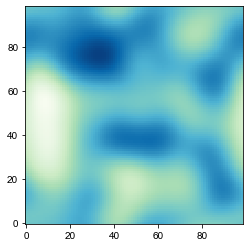

8720 50000 99 0.5269682092701716 0.06818830477894197
24490.0 25000.0 24490.0 25000.0


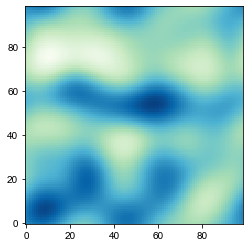

8720 50000 99 0.492205373702256 -0.2101211002231467
24490.0 25000.0 24490.0 25000.0


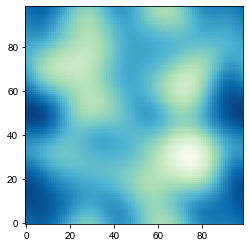

8720 50000 99 0.4796899660774792 -0.19289367102648142
24490.0 25000.0 24490.0 25000.0


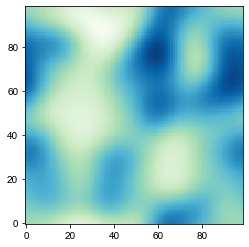

8720 50000 99 0.42700504205942347 -0.07991326604480305
24490.0 25000.0 24490.0 25000.0


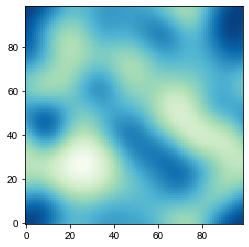

8720 50000 99 0.509991312787983 -0.21127839455713196
24490.0 25000.0 24490.0 25000.0


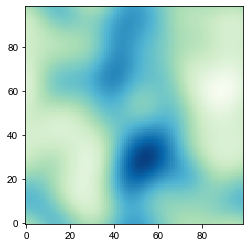

8720 50000 99 0.6878730669701756 0.1385678790153579
24490.0 25000.0 24490.0 25000.0


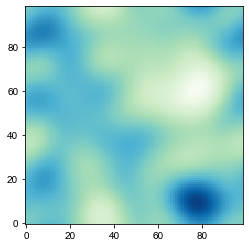

8720 50000 99 0.4145017022779164 -0.35436426038226665
24490.0 25000.0 24490.0 25000.0


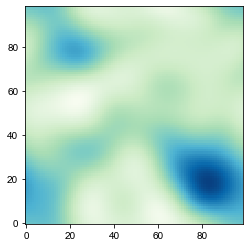

8720 50000 99 0.6548823124082562 0.12968006381766517
24490.0 25000.0 24490.0 25000.0


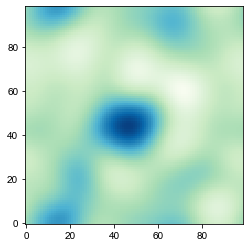

8720 50000 99 0.4848163482113176 -0.17781094203538994
24490.0 25000.0 24490.0 25000.0


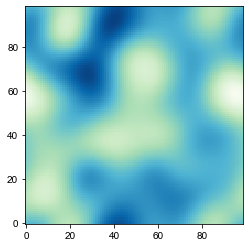

8720 50000 99 0.5070209569647934 -0.27468824847811163
24490.0 25000.0 24490.0 25000.0


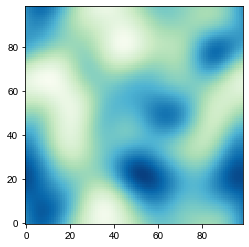

8720 50000 99 0.5650296061498302 0.2589547044476469
24490.0 25000.0 24490.0 25000.0


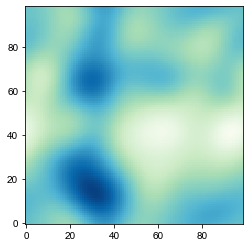

8720 50000 99 0.5886959304942059 0.033289246907781705
24490.0 25000.0 24490.0 25000.0


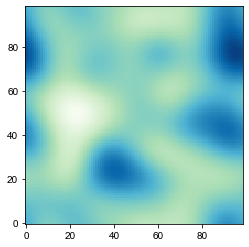

8720 50000 99 0.5530687939666195 -0.13707180011504466
24490.0 25000.0 24490.0 25000.0


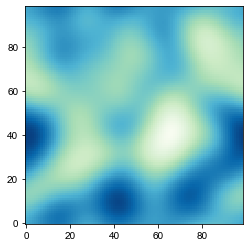

8720 50000 99 0.5286759094425965 0.1966145236233168
24490.0 25000.0 24490.0 25000.0


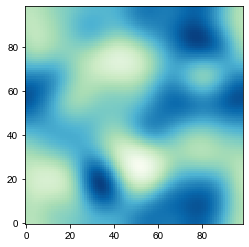

8720 50000 99 0.46500230071905013 0.057306309351171564
24490.0 25000.0 24490.0 25000.0


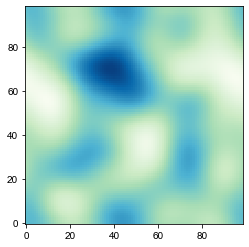

8720 50000 99 0.48085829612796815 -0.13636050943359523
24490.0 25000.0 24490.0 25000.0


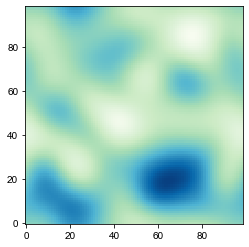

8720 50000 99 0.4556943123964498 -0.13974460944166
24490.0 25000.0 24490.0 25000.0


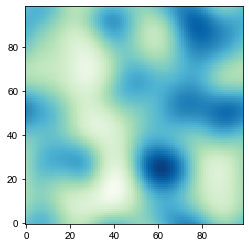

8720 50000 99 0.4370714539504538 -0.06554486073453995
24490.0 25000.0 24490.0 25000.0


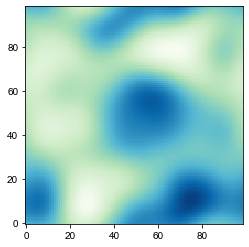

8720 50000 99 0.6001759569651616 -0.022089776063957452
24490.0 25000.0 24490.0 25000.0


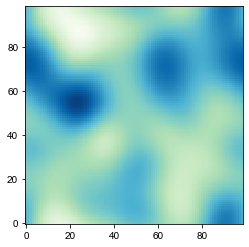

8720 50000 99 0.6228535910670826 0.23155193020457288
24490.0 25000.0 24490.0 25000.0


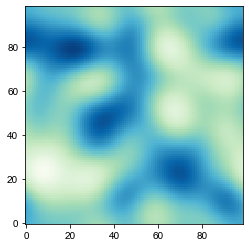

8720 50000 99 0.3877832829351683 -0.0182901397900762
24490.0 25000.0 24490.0 25000.0


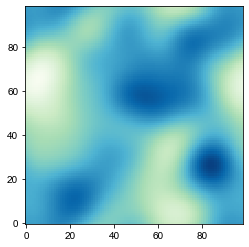

8720 50000 99 0.5944505732326637 -0.11401377819325001
24490.0 25000.0 24490.0 25000.0


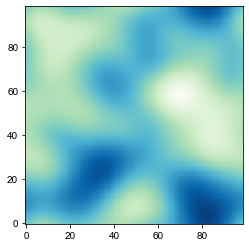

8720 50000 99 0.5390625980411904 0.3114048259985962
24490.0 25000.0 24490.0 25000.0


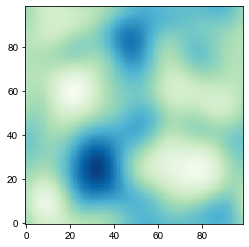

8720 50000 99 0.41453658094064677 0.08571184489814279
24490.0 25000.0 24490.0 25000.0


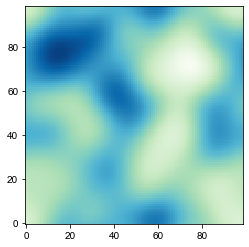

8720 50000 99 0.4147711880813012 -0.05879422192741173
24490.0 25000.0 24490.0 25000.0


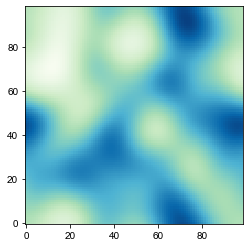

8720 50000 99 0.5597710016545641 0.10536054764937772
24490.0 25000.0 24490.0 25000.0


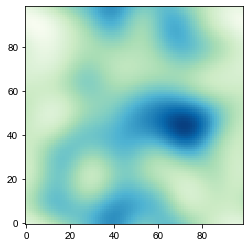

8720 50000 99 0.6603357176054675 -0.10649815844383627
24490.0 25000.0 24490.0 25000.0


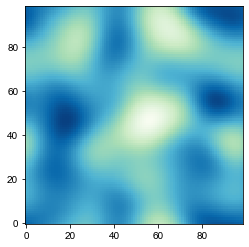

8720 50000 99 0.4655621173393019 -0.0667435182509239
24490.0 25000.0 24490.0 25000.0


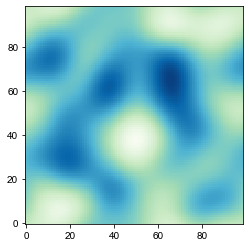

8720 50000 99 0.5419490913294424 0.07790005704806725
24490.0 25000.0 24490.0 25000.0


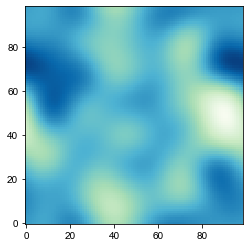

8720 50000 99 0.5231469997337395 -0.0641129815719685
24490.0 25000.0 24490.0 25000.0


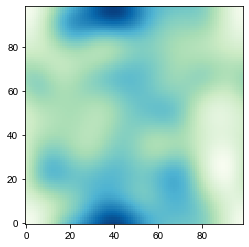

8720 50000 99 0.5722557334216263 -0.10356882690102576
24490.0 25000.0 24490.0 25000.0


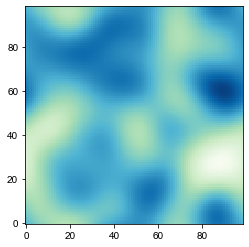

8720 50000 99 0.550202927235309 -0.10149333254036008
24490.0 25000.0 24490.0 25000.0


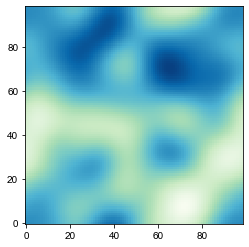

8720 50000 99 0.5911782489957548 0.12476175818495822
24490.0 25000.0 24490.0 25000.0


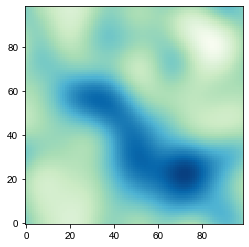

8720 50000 99 0.6171856749046528 -0.11528544892031946
24490.0 25000.0 24490.0 25000.0


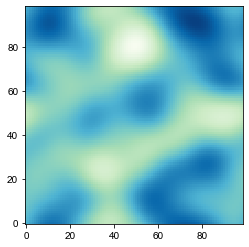

8720 50000 99 0.41340152801418556 -0.1308522476193638
24490.0 25000.0 24490.0 25000.0


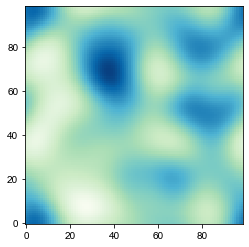

8720 50000 99 0.4353833890737416 0.1844994834653012
24490.0 25000.0 24490.0 25000.0


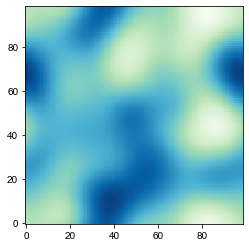

8720 50000 99 0.7455112254140113 -0.09599733598636552
24490.0 25000.0 24490.0 25000.0


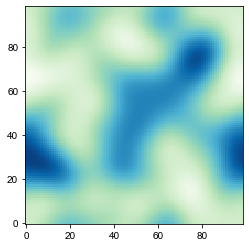

8720 50000 99 0.49595978103180943 0.35634040188078847
24490.0 25000.0 24490.0 25000.0


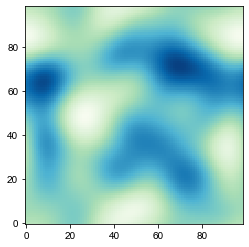

8720 50000 99 0.592573739016437 -0.17669110146566458
24490.0 25000.0 24490.0 25000.0


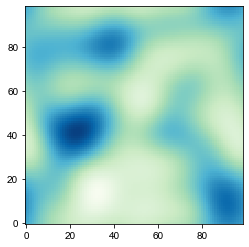

8720 50000 99 0.6187911790705366 -0.14961906383623513
24490.0 25000.0 24490.0 25000.0


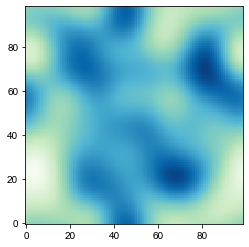

8720 50000 99 0.4759607948830342 -0.013789084590183031
24490.0 25000.0 24490.0 25000.0


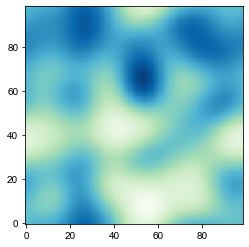

8720 50000 99 0.5317145186973422 -0.10339118329000142
24490.0 25000.0 24490.0 25000.0


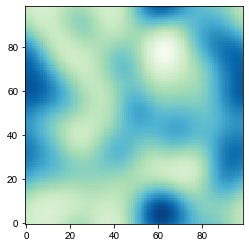

8720 50000 99 0.468052498713275 -0.11973903346118701
24490.0 25000.0 24490.0 25000.0


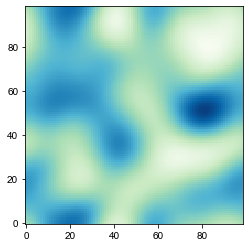

8720 50000 99 0.4801352664463881 -0.14497272467556893
24490.0 25000.0 24490.0 25000.0


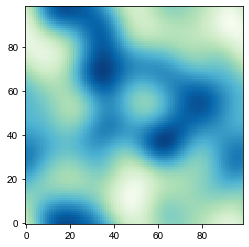

8720 50000 99 0.564037504067887 0.10635790129758811
24490.0 25000.0 24490.0 25000.0


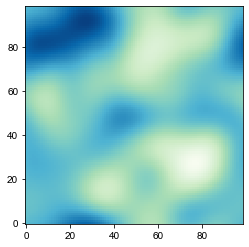

8720 50000 99 0.48244038130263356 0.15529256006247497
24490.0 25000.0 24490.0 25000.0


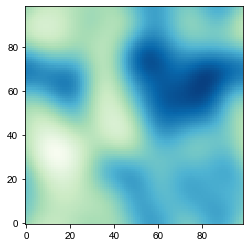

8720 50000 99 0.7334482105808382 0.1067450054507914
24490.0 25000.0 24490.0 25000.0


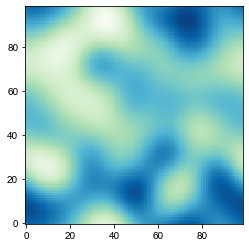

8720 50000 99 0.4626592222786917 -0.4404796672530388
24490.0 25000.0 24490.0 25000.0


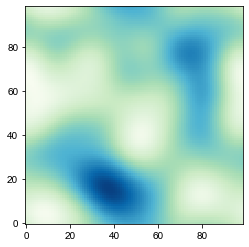

8720 50000 99 0.6693115174317639 -0.08624637297056391
24490.0 25000.0 24490.0 25000.0


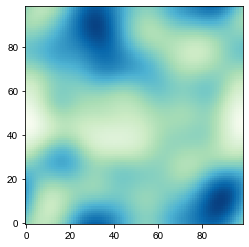

8720 50000 99 0.5000925475144383 -0.0485140274624389
24490.0 25000.0 24490.0 25000.0


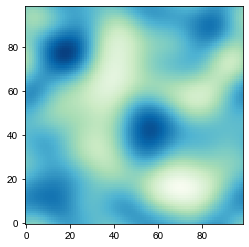

8720 50000 99 0.4484851190464604 0.15137472938344276
24490.0 25000.0 24490.0 25000.0


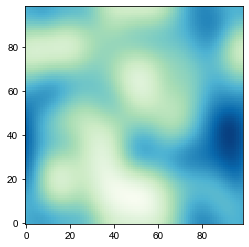

8720 50000 99 0.5428106366093113 0.409084676568313
24490.0 25000.0 24490.0 25000.0


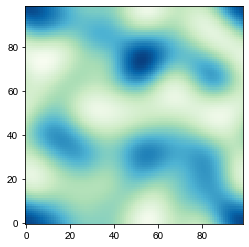

8720 50000 99 0.4729370585583652 -0.2950162974541465
24490.0 25000.0 24490.0 25000.0


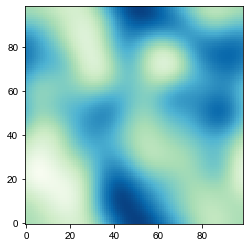

8720 50000 99 0.6333649098122204 0.08935981315499586
24490.0 25000.0 24490.0 25000.0


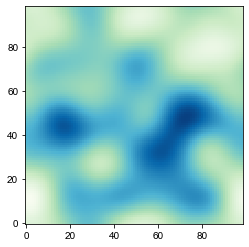

8720 50000 99 0.4765478336380062 -0.025054872223591162
24490.0 25000.0 24490.0 25000.0


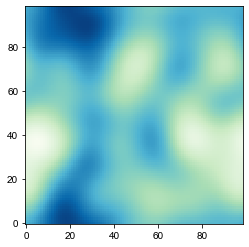

8720 50000 99 0.58508019802271 0.04080429371313139
24490.0 25000.0 24490.0 25000.0


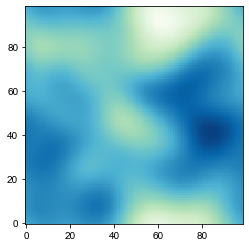

8720 50000 99 0.5666001079257342 0.10994397017013524
24490.0 25000.0 24490.0 25000.0


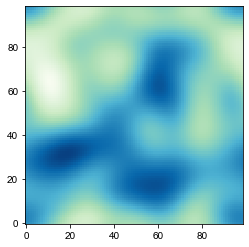

8720 50000 99 0.5111000313536075 -0.08290105727247278
24490.0 25000.0 24490.0 25000.0


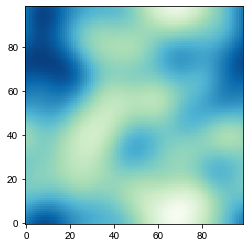

8720 50000 99 0.6028670528160756 -0.12244210944425721
24490.0 25000.0 24490.0 25000.0


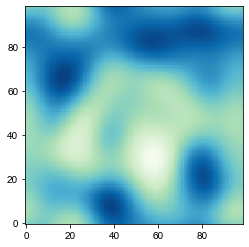

8720 50000 99 0.5826537362908335 -0.31805249345471975
24490.0 25000.0 24490.0 25000.0


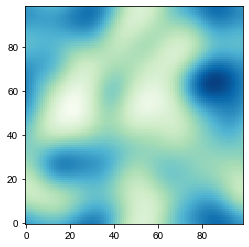

8720 50000 99 0.5276145599059471 -0.2583394413925517
24490.0 25000.0 24490.0 25000.0


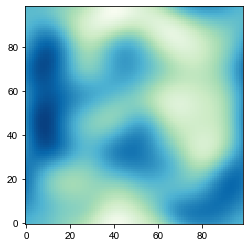

8720 50000 99 0.5227351700305592 0.024699973282015206
24490.0 25000.0 24490.0 25000.0


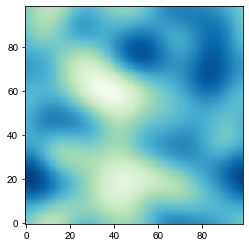

8720 50000 99 0.5313603577405874 0.122063693428662
24490.0 25000.0 24490.0 25000.0


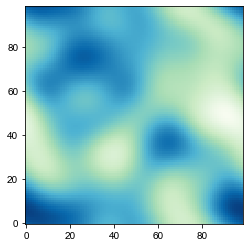

8720 50000 99 0.6077059943803395 -0.0420270686835968
24490.0 25000.0 24490.0 25000.0


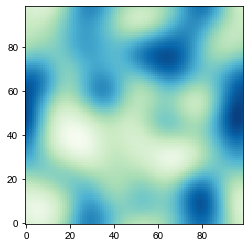

8720 50000 99 0.4948998465311489 0.34483375492243334
24490.0 25000.0 24490.0 25000.0


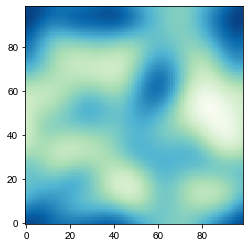

8720 50000 99 0.5929108912542195 -0.14017454113563066
24490.0 25000.0 24490.0 25000.0


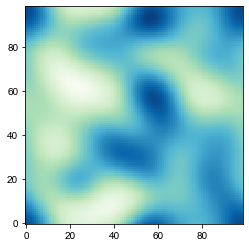

8720 50000 99 0.44221272184480426 -0.008808354761788128
24490.0 25000.0 24490.0 25000.0


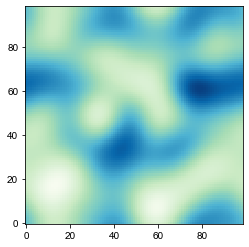

8720 50000 99 0.424625934061342 0.05314061889703258
24490.0 25000.0 24490.0 25000.0


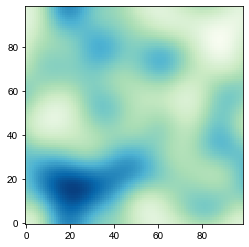

8720 50000 99 0.4931531306977641 0.191265351548083
24490.0 25000.0 24490.0 25000.0


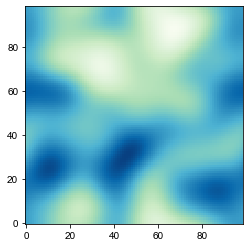

8720 50000 99 0.570243689234634 -0.21462816559924855
24490.0 25000.0 24490.0 25000.0


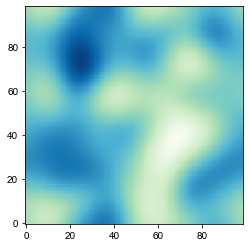

8720 50000 99 0.5260277098356463 0.0736092953350204
24490.0 25000.0 24490.0 25000.0


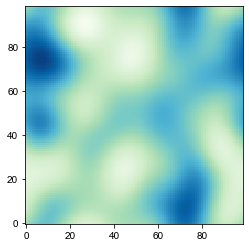

8720 50000 99 0.47105342324841376 0.08220020188277888
24490.0 25000.0 24490.0 25000.0


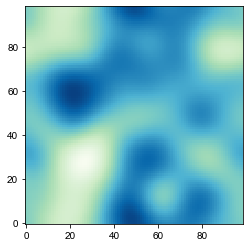

8720 50000 99 0.4618950204378529 0.0466110860052761
24490.0 25000.0 24490.0 25000.0


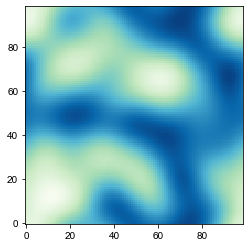

8720 50000 99 0.48691372263747645 -0.11699306447721092
24490.0 25000.0 24490.0 25000.0


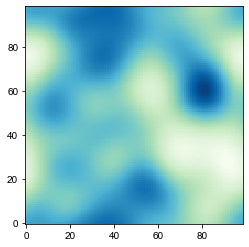

8720 50000 99 0.6016070824400683 0.051585314271313944
24490.0 25000.0 24490.0 25000.0


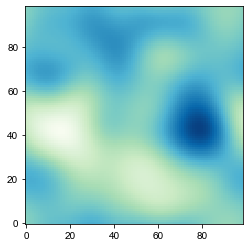

8720 50000 99 0.7239573491364923 -0.3005121840531003
24490.0 25000.0 24490.0 25000.0


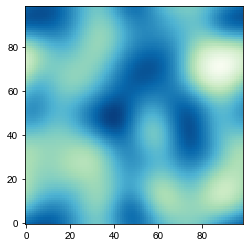

8720 50000 99 0.5605682500091076 0.2564317812019178
24490.0 25000.0 24490.0 25000.0


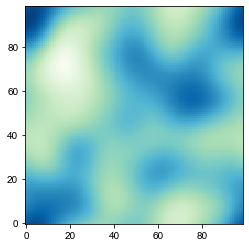

8720 50000 99 0.5689795494226515 0.32614500416485603
24490.0 25000.0 24490.0 25000.0


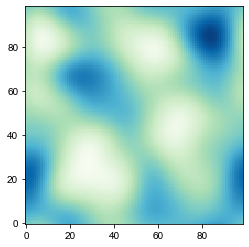

8720 50000 99 0.4220468009870956 -0.023043209487510482
24490.0 25000.0 24490.0 25000.0


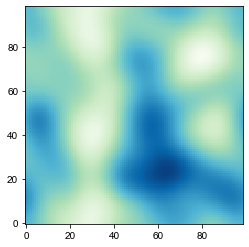

8720 50000 99 0.6199094856483519 0.03902372440411576
24490.0 25000.0 24490.0 25000.0


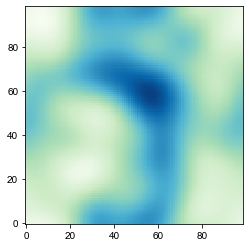

8720 50000 99 0.6070855336647137 -0.1673776118265284
24490.0 25000.0 24490.0 25000.0


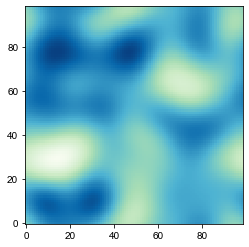

8720 50000 99 0.4667503573852367 -0.3081847977724617
24490.0 25000.0 24490.0 25000.0


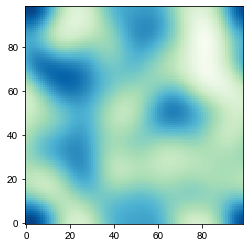

8720 50000 99 0.39796616543833113 0.24279021398377001
24490.0 25000.0 24490.0 25000.0


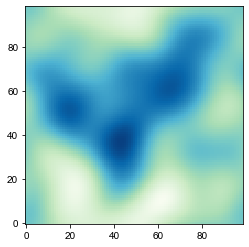

8720 50000 99 0.6797751055681585 0.016301487151223218
24490.0 25000.0 24490.0 25000.0


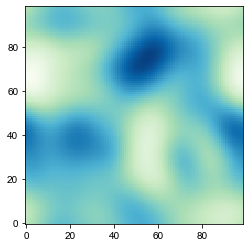

8720 50000 99 0.5359222412309966 -0.2817594876182621
24490.0 25000.0 24490.0 25000.0


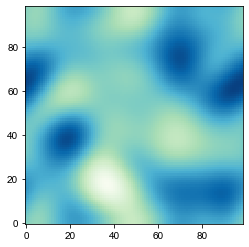

8720 50000 99 0.5328787767426748 -0.27260369988026284
24490.0 25000.0 24490.0 25000.0


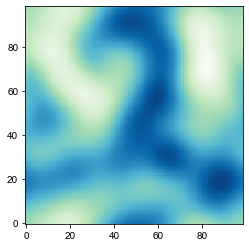

8720 50000 99 0.43639121514048673 -0.09469943987094298
24490.0 25000.0 24490.0 25000.0


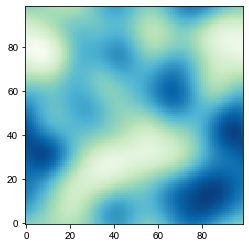

8720 50000 99 0.5997130089998578 0.07796726754425297
24490.0 25000.0 24490.0 25000.0


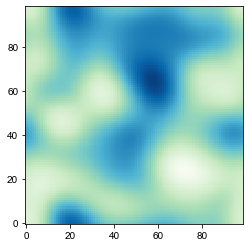

8720 50000 99 0.45042755946386237 0.14243790555857155
24490.0 25000.0 24490.0 25000.0


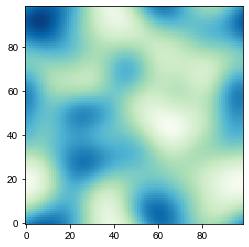

8720 50000 99 0.5196448872245012 -0.10259251995331636
24490.0 25000.0 24490.0 25000.0


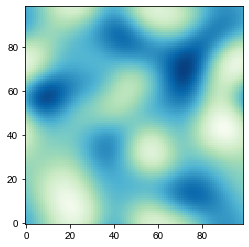

8720 50000 99 0.48811854951858874 0.2357284786023978
24490.0 25000.0 24490.0 25000.0


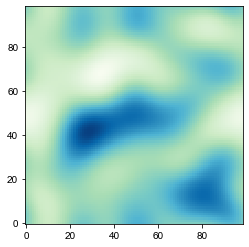

8720 50000 99 0.5432256777063593 0.07846904188198381
24490.0 25000.0 24490.0 25000.0


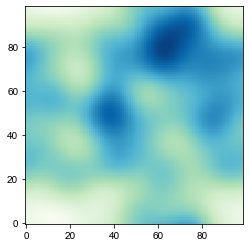

8720 50000 99 0.4840945879218759 0.09641816089480686
24490.0 25000.0 24490.0 25000.0


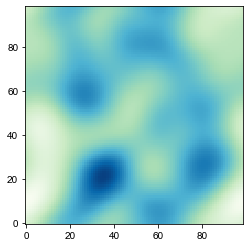

8720 50000 99 0.47204617411902916 -0.11589796700827963
24490.0 25000.0 24490.0 25000.0


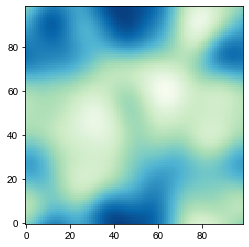

8720 50000 99 0.4672009082474529 0.1641826416172259
24490.0 25000.0 24490.0 25000.0


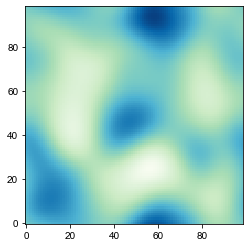

8720 50000 99 0.4909637717519176 0.08655541999836036
24490.0 25000.0 24490.0 25000.0


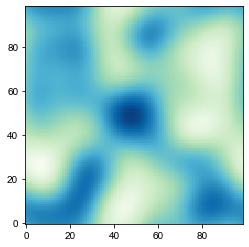

8720 50000 99 0.5202248097382731 -0.0018557498019245637
24490.0 25000.0 24490.0 25000.0


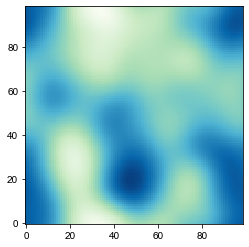

8720 50000 99 0.55581519429427 0.05668770972397545
24490.0 25000.0 24490.0 25000.0


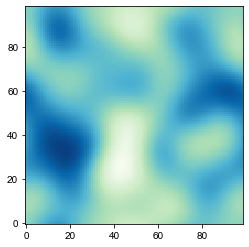

8720 50000 99 0.4781750846502647 0.17804915375837213
24490.0 25000.0 24490.0 25000.0


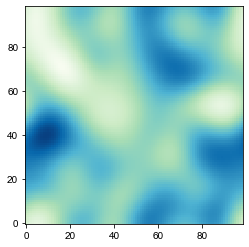

8720 50000 99 0.44882387780865357 0.021834037024306703
24490.0 25000.0 24490.0 25000.0


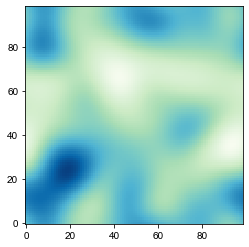

8720 50000 99 0.5582285454186743 0.04950432499063986
24490.0 25000.0 24490.0 25000.0


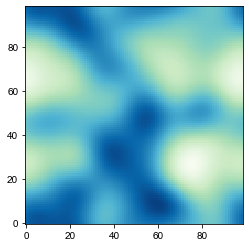

8720 50000 99 0.5580774022368156 -0.011795508619373172
24490.0 25000.0 24490.0 25000.0


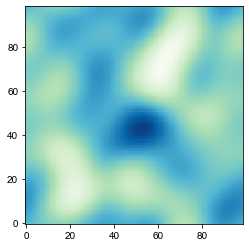

8720 50000 99 0.43070566057136406 0.08278876055154902
24490.0 25000.0 24490.0 25000.0


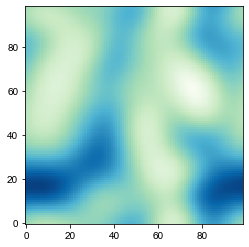

8720 50000 99 0.5953786980983513 -0.2694114890523384
24490.0 25000.0 24490.0 25000.0


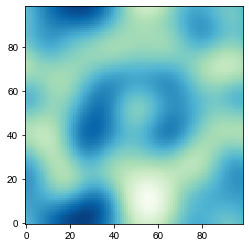

8720 50000 99 0.5614738396677081 -0.09338194010330503
24490.0 25000.0 24490.0 25000.0


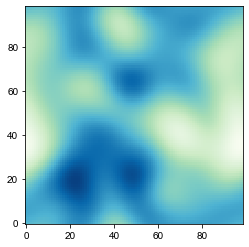

8720 50000 99 0.6053113288476213 0.23777454958243086
24490.0 25000.0 24490.0 25000.0


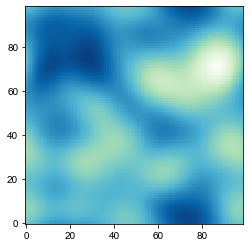

8720 50000 99 0.37691977796760934 -0.20247231301370777
24490.0 25000.0 24490.0 25000.0


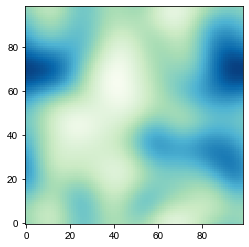

8720 50000 99 0.7246048846736798 0.012503608656840548
24490.0 25000.0 24490.0 25000.0


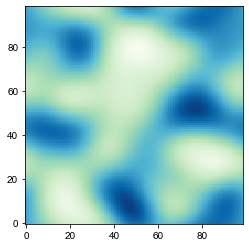

8720 50000 99 0.4402717975602626 0.008688711167310173
24490.0 25000.0 24490.0 25000.0


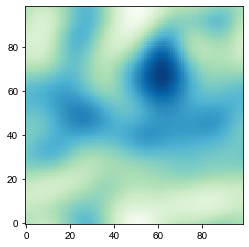

8720 50000 99 0.5937534779699895 0.10909012408332801
24490.0 25000.0 24490.0 25000.0


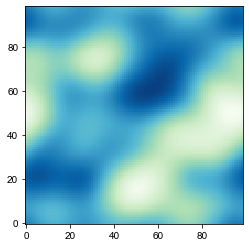

8720 50000 99 0.5094815646477318 -0.09304453212814146
24490.0 25000.0 24490.0 25000.0


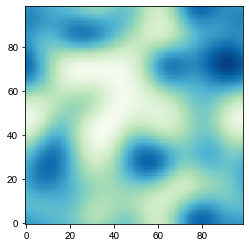

8720 50000 99 0.4989939800146061 0.18912742818879286
24490.0 25000.0 24490.0 25000.0


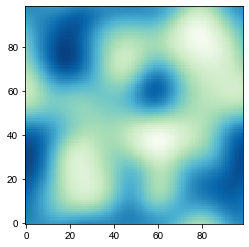

8720 50000 99 0.6204933285237323 -0.3057751536400577
24490.0 25000.0 24490.0 25000.0


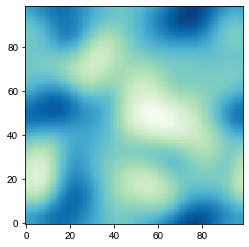

8720 50000 99 0.48301904628435083 0.194826428167554
24490.0 25000.0 24490.0 25000.0


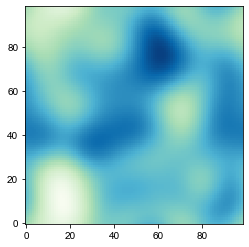

8720 50000 99 0.5370215146471055 -0.06726272284824102
24490.0 25000.0 24490.0 25000.0


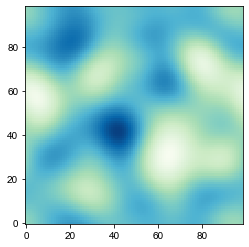

8720 50000 99 0.40340301590609307 -0.026130782701612707
24490.0 25000.0 24490.0 25000.0


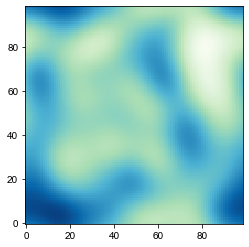

8720 50000 99 0.5120023711801371 -0.0719791043640619
24490.0 25000.0 24490.0 25000.0


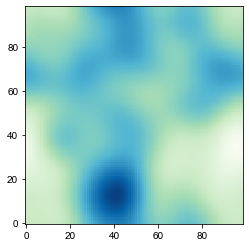

8720 50000 99 0.5756952236801098 0.00212525008464869
24490.0 25000.0 24490.0 25000.0


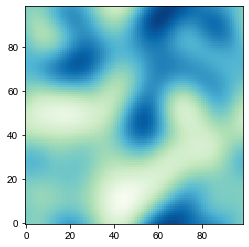

8720 50000 99 0.4771175903716715 -0.04622887273729073
24490.0 25000.0 24490.0 25000.0


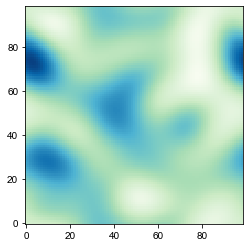

8720 50000 99 0.4576703792593376 0.046447502767006744
24490.0 25000.0 24490.0 25000.0


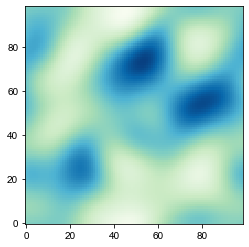

8720 50000 99 0.5128843619208802 0.06879673331900724
24490.0 25000.0 24490.0 25000.0


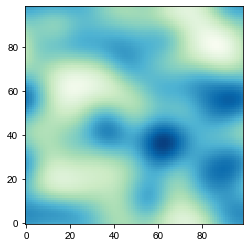

8720 50000 99 0.463499976280503 -0.059589395986828934
24490.0 25000.0 24490.0 25000.0


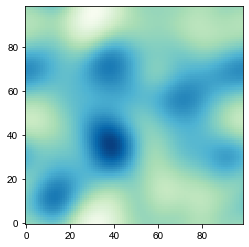

8720 50000 99 0.46658871510648947 0.18586580111081824
24490.0 25000.0 24490.0 25000.0


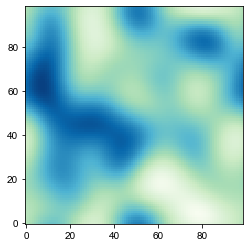

8720 50000 99 0.5241440588000715 -0.2109130620317106
24490.0 25000.0 24490.0 25000.0


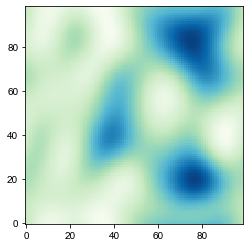

8720 50000 99 0.5711076297811489 -0.17263130846733124
24490.0 25000.0 24490.0 25000.0


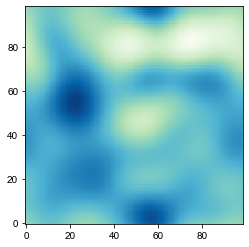

8720 50000 99 0.5627743748723582 -0.14914284032369204
24490.0 25000.0 24490.0 25000.0


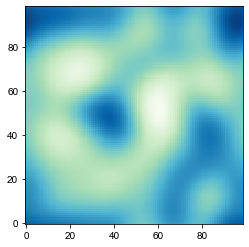

8720 50000 99 0.5219279424326186 0.24791515250176324
24490.0 25000.0 24490.0 25000.0


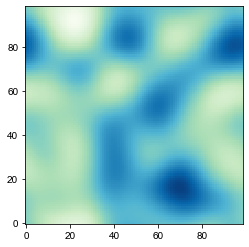

8720 50000 99 0.48043346531857384 0.09252583833693508
24490.0 25000.0 24490.0 25000.0


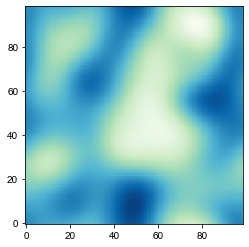

8720 50000 99 0.5476190226603712 0.13555058228748318
24490.0 25000.0 24490.0 25000.0


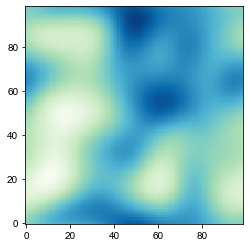

8720 50000 99 0.7003297433331157 0.05196535391401814
24490.0 25000.0 24490.0 25000.0


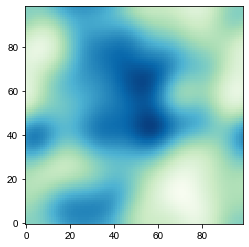

8720 50000 99 0.6374198808902469 0.13462582265790912
24490.0 25000.0 24490.0 25000.0


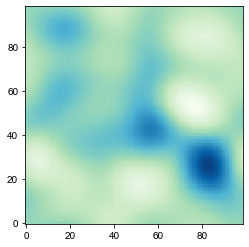

8720 50000 99 0.46732565786437397 0.3524413107755185
24490.0 25000.0 24490.0 25000.0


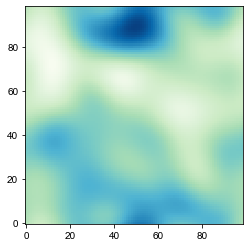

8720 50000 99 0.5583517012744548 -0.13262751320360974
24490.0 25000.0 24490.0 25000.0


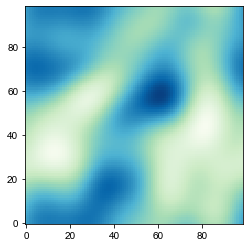

8720 50000 99 0.5428977287232519 -0.3215330517604903
24490.0 25000.0 24490.0 25000.0


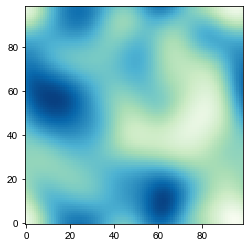

8720 50000 99 0.6384010746857138 -0.014556842613700032
24490.0 25000.0 24490.0 25000.0


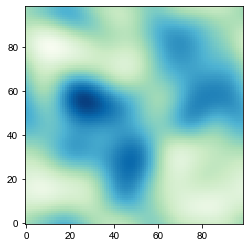

8720 50000 99 0.5425828891066056 0.022672531281362596
24490.0 25000.0 24490.0 25000.0


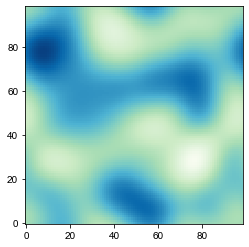

8720 50000 99 0.49792929181650103 0.23828175178697641
24490.0 25000.0 24490.0 25000.0


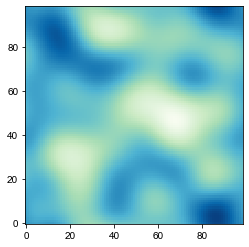

8720 50000 99 0.5283637693423388 0.28176663022649656
24490.0 25000.0 24490.0 25000.0


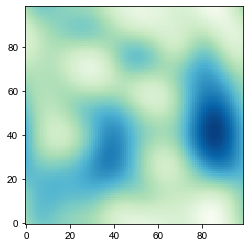

8720 50000 99 0.655826665292026 0.20123083807368702
24490.0 25000.0 24490.0 25000.0


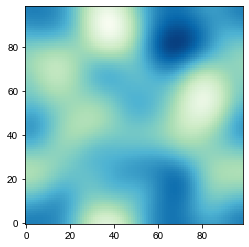

8720 50000 99 0.5939263401242446 0.1468547784029145
24490.0 25000.0 24490.0 25000.0


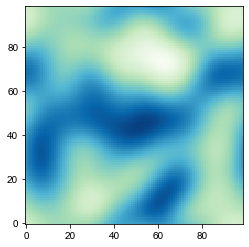

8720 50000 99 0.44172709454484876 0.060867966271592897
24490.0 25000.0 24490.0 25000.0


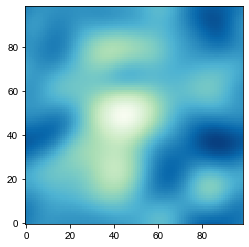

8720 50000 99 0.5254765803484922 -0.10421275703094322
24490.0 25000.0 24490.0 25000.0


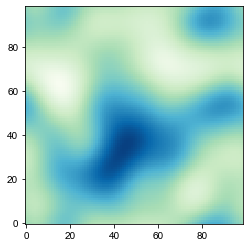

8720 50000 99 0.6818702264079854 0.25980762793678286
24490.0 25000.0 24490.0 25000.0


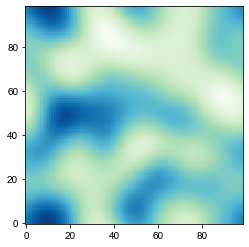

8720 50000 99 0.4833687796880016 0.1576680422475073
24490.0 25000.0 24490.0 25000.0


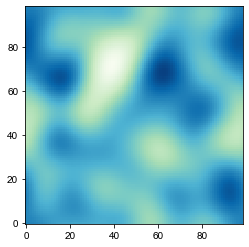

8720 50000 99 0.4294666553987888 -0.12182315666737066
24490.0 25000.0 24490.0 25000.0


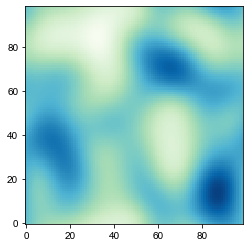

8720 50000 99 0.5996631237286251 -0.2711562554353919
24490.0 25000.0 24490.0 25000.0


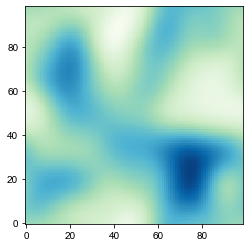

8720 50000 99 0.5107698420786162 0.0075677459178376955
24490.0 25000.0 24490.0 25000.0


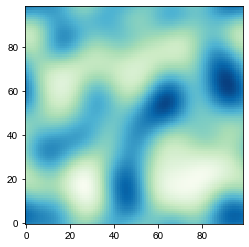

8720 50000 99 0.38606978724683466 -0.12519235813180052
24490.0 25000.0 24490.0 25000.0


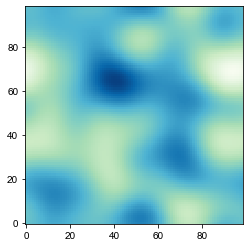

8720 50000 99 0.4231974561975211 0.053366948833203656
24490.0 25000.0 24490.0 25000.0


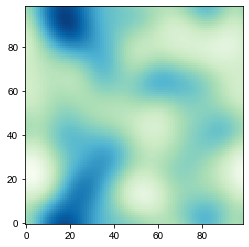

8720 50000 99 0.5886019027816697 0.13043641674920378
24490.0 25000.0 24490.0 25000.0


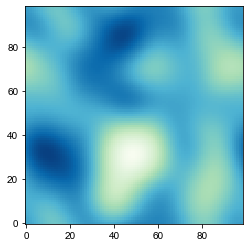

8720 50000 99 0.5649505428893025 0.24912306410512866
24490.0 25000.0 24490.0 25000.0


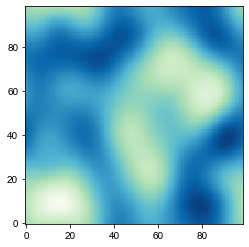

8720 50000 99 0.4977499460434276 0.15200756469962098
24490.0 25000.0 24490.0 25000.0


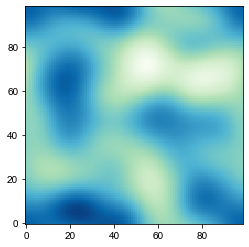

8720 50000 99 0.546753561425645 0.01335409589928959
24490.0 25000.0 24490.0 25000.0


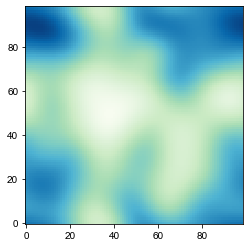

8720 50000 99 0.6960498839256328 0.190729822456519
24490.0 25000.0 24490.0 25000.0


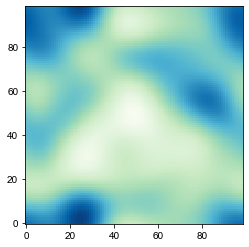

8720 50000 99 0.627779238988265 -0.2756132459285131
24490.0 25000.0 24490.0 25000.0


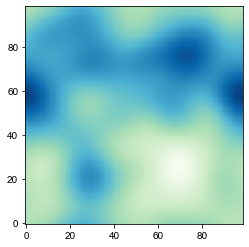

8720 50000 99 0.6760608631196114 0.08737264815651641
24490.0 25000.0 24490.0 25000.0


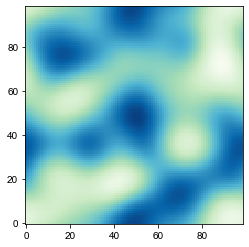

8720 50000 99 0.44868396602396504 0.05264814065021061
24490.0 25000.0 24490.0 25000.0


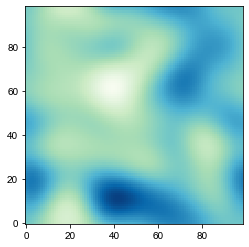

8720 50000 99 0.5438356109598832 -0.09668903519960527
24490.0 25000.0 24490.0 25000.0


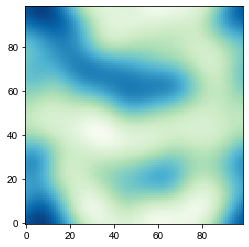

8720 50000 99 0.6485051990673771 0.22117540535749927
24490.0 25000.0 24490.0 25000.0


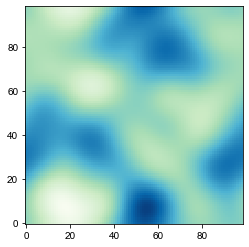

8720 50000 99 0.627760968798919 -0.28307913705960785
24490.0 25000.0 24490.0 25000.0


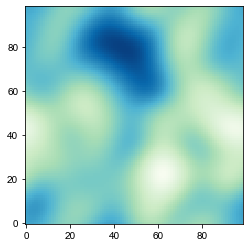

8720 50000 99 0.5639281828221814 -0.3087240212957305
24490.0 25000.0 24490.0 25000.0


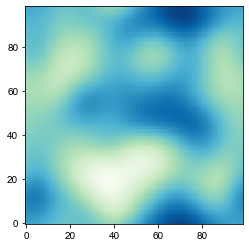

8720 50000 99 0.6045703297113971 0.19777356283079972
24490.0 25000.0 24490.0 25000.0


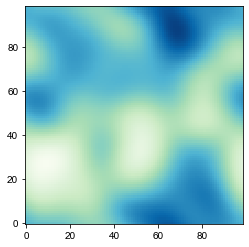

8720 50000 99 0.5938246781571739 0.009916596515273301
24490.0 25000.0 24490.0 25000.0


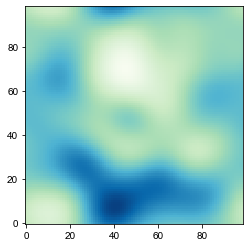

8720 50000 99 0.5765562507479219 -0.07564379514556846
24490.0 25000.0 24490.0 25000.0


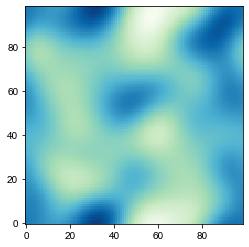

8720 50000 99 0.5451030795432789 0.1108232224587341
24490.0 25000.0 24490.0 25000.0


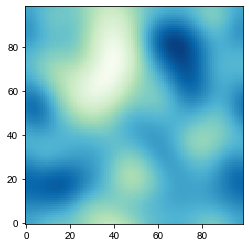

8720 50000 99 0.6543944858456779 -0.011917577256260015
24490.0 25000.0 24490.0 25000.0


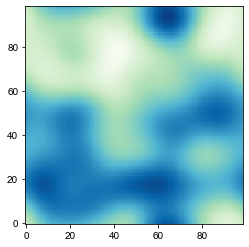

8720 50000 99 0.6182275635413562 0.029411641183823094
24490.0 25000.0 24490.0 25000.0


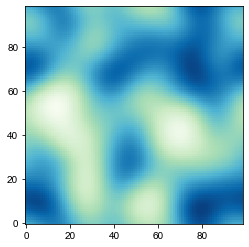

8720 50000 99 0.45243176024413984 -0.21526878581237302
24490.0 25000.0 24490.0 25000.0


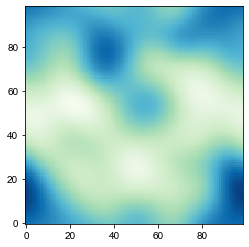

8720 50000 99 0.7237245637348151 -0.4682744731856989
24490.0 25000.0 24490.0 25000.0


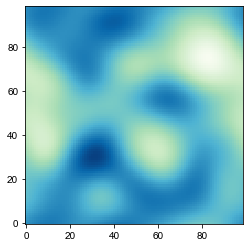

8720 50000 99 0.6255003377771741 0.041713652064445786
24490.0 25000.0 24490.0 25000.0


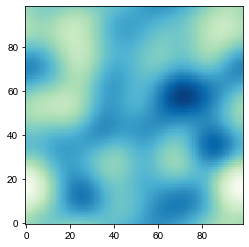

8720 50000 99 0.4778624079875579 -0.061531204556866344
24490.0 25000.0 24490.0 25000.0


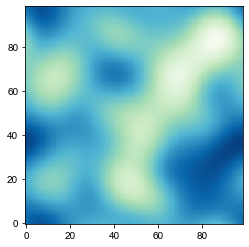

8720 50000 99 0.6459528185725592 -0.08048991620016874
24490.0 25000.0 24490.0 25000.0


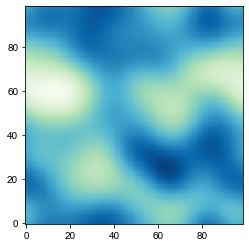

8720 50000 99 0.6145079806324147 0.13358591573018008
24490.0 25000.0 24490.0 25000.0


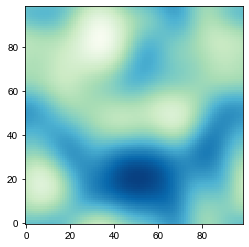

8720 50000 99 0.5841211509341928 0.21550098005734938
24490.0 25000.0 24490.0 25000.0


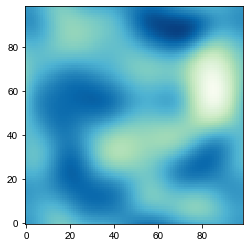

8720 50000 99 0.47966810669107973 -0.31401521848856395
24490.0 25000.0 24490.0 25000.0


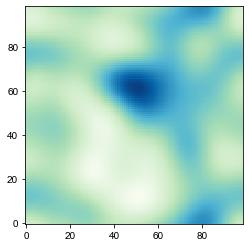

8720 50000 99 0.482464367013409 -0.14826815437948676
24490.0 25000.0 24490.0 25000.0


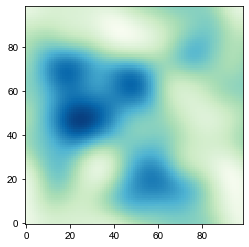

8720 50000 99 0.542127301293274 -0.12823087062822047
24490.0 25000.0 24490.0 25000.0


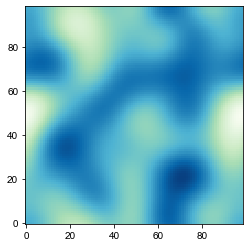

8720 50000 99 0.5311079019396251 -0.20103408290770738
24490.0 25000.0 24490.0 25000.0


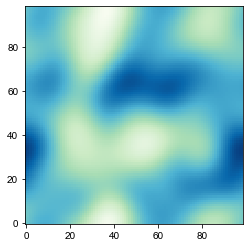

8720 50000 99 0.5335925003338003 0.045624613166986766
24490.0 25000.0 24490.0 25000.0


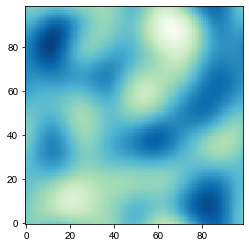

8720 50000 99 0.535655327667846 0.18500529285227174
24490.0 25000.0 24490.0 25000.0


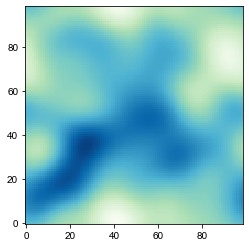

8720 50000 99 0.5424150744427139 -0.14836197979391386
24490.0 25000.0 24490.0 25000.0


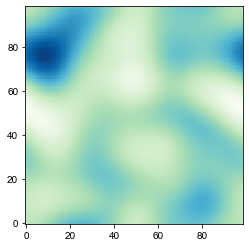

8720 50000 99 0.6125950265811176 -0.21449200115850556
24490.0 25000.0 24490.0 25000.0


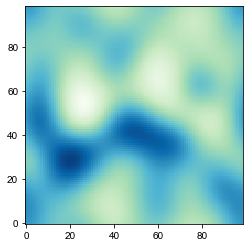

8720 50000 99 0.5125549303812408 -0.3819168903615945
24490.0 25000.0 24490.0 25000.0


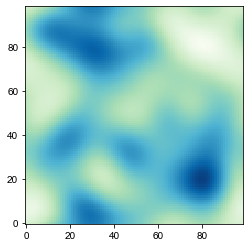

8720 50000 99 0.44845586232896395 -0.034078168828569316
24490.0 25000.0 24490.0 25000.0


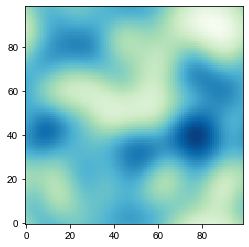

8720 50000 99 0.4732723158276336 -0.0586767409421636
24490.0 25000.0 24490.0 25000.0


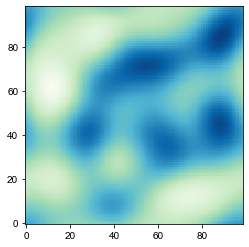

8720 50000 99 0.5705681896229312 -0.02520988048635662
24490.0 25000.0 24490.0 25000.0


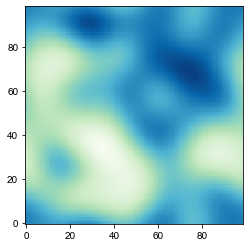

8720 50000 99 0.721434935093675 0.050629939361809075
24490.0 25000.0 24490.0 25000.0


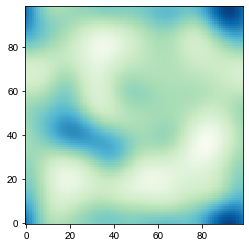

8720 50000 99 0.4241337776509039 0.18922399200977763
24490.0 25000.0 24490.0 25000.0


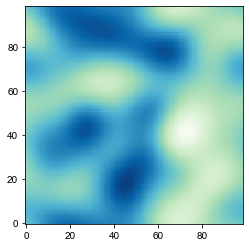

8720 50000 99 0.5252846839758015 0.10812130407494817
24490.0 25000.0 24490.0 25000.0


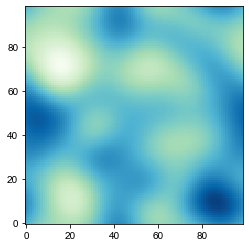

8720 50000 99 0.5690749908467643 0.13592305433189036
24490.0 25000.0 24490.0 25000.0


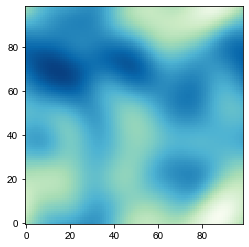

8720 50000 99 0.6030165594753799 -0.058388305916171356
24490.0 25000.0 24490.0 25000.0


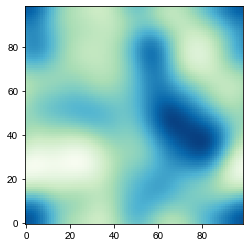

8720 50000 99 0.5833374664757642 -0.14776793144332262
24490.0 25000.0 24490.0 25000.0


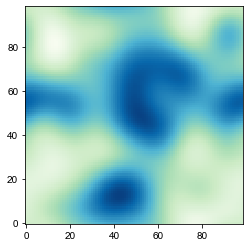

8720 50000 99 0.624148724169318 0.03770550059176082
24490.0 25000.0 24490.0 25000.0


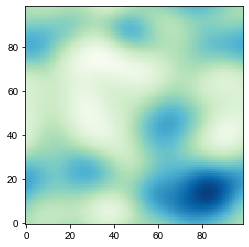

8720 50000 99 0.5347812010765938 -0.14970296405932743
24490.0 25000.0 24490.0 25000.0


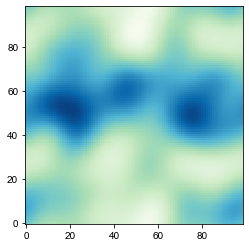

8720 50000 99 0.5308382609658191 -0.008861481008387696
24490.0 25000.0 24490.0 25000.0


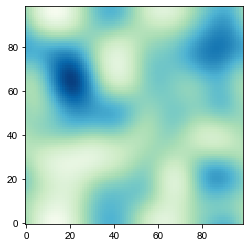

8720 50000 99 0.42988704219193585 0.20461066883944512
24490.0 25000.0 24490.0 25000.0


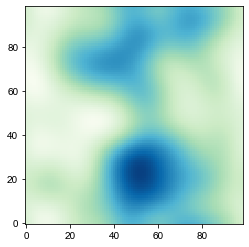

8720 50000 99 0.6665097994794179 -0.20446007059123877
24490.0 25000.0 24490.0 25000.0


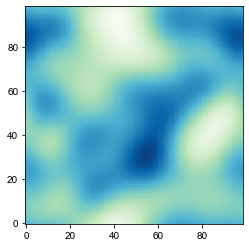

8720 50000 99 0.5272413118894256 0.07514733217011435
24490.0 25000.0 24490.0 25000.0


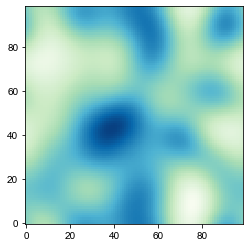

8720 50000 99 0.5256010058660883 -0.01348939557487361
24490.0 25000.0 24490.0 25000.0


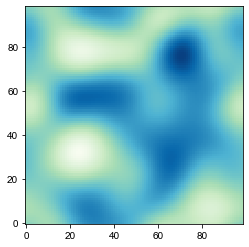

8720 50000 99 0.5526118912742717 -0.3990712267842819
24490.0 25000.0 24490.0 25000.0


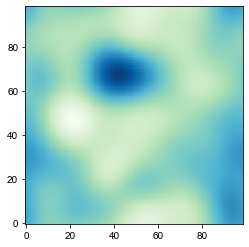

8720 50000 99 0.5233384918969184 0.09373901689966088
24490.0 25000.0 24490.0 25000.0


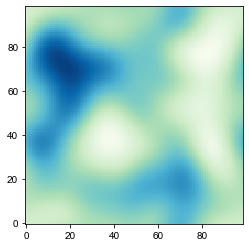

8720 50000 99 0.5209427976862792 -0.022580073502156975
24490.0 25000.0 24490.0 25000.0


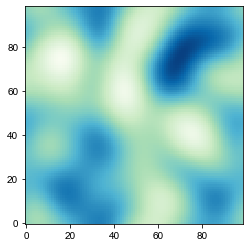

8720 50000 99 0.44977195318185326 0.14141000304137213
24490.0 25000.0 24490.0 25000.0


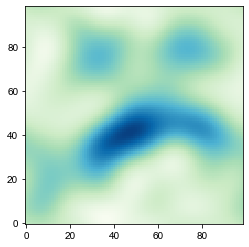

8720 50000 99 0.5368207263667446 -0.2322374584440008
24490.0 25000.0 24490.0 25000.0


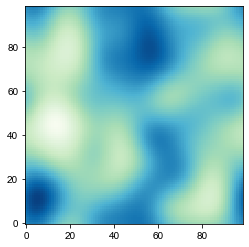

8720 50000 99 0.5273842877173728 -0.041593473609011423
24490.0 25000.0 24490.0 25000.0


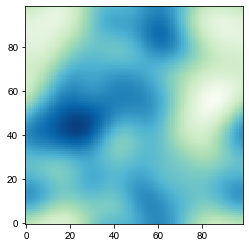

8720 50000 99 0.6800367518101297 0.11409650260414139
24490.0 25000.0 24490.0 25000.0


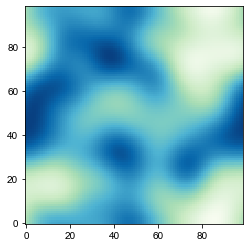

8720 50000 99 0.599619012602266 -0.0617509084380383
24490.0 25000.0 24490.0 25000.0


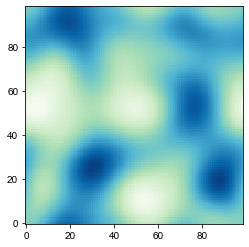

8720 50000 99 0.5654011467951898 -0.1773042612733185
24490.0 25000.0 24490.0 25000.0


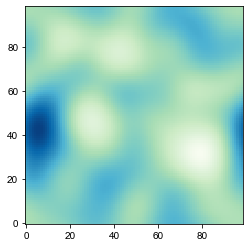

8720 50000 99 0.5257189944214183 -0.07027379359215052
24490.0 25000.0 24490.0 25000.0


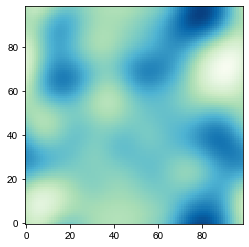

8720 50000 99 0.5072580875155105 -0.26118592247173844
24490.0 25000.0 24490.0 25000.0


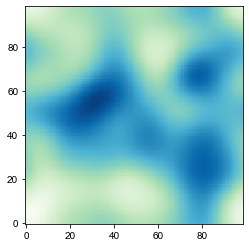

8720 50000 99 0.6810395210127117 0.34029336945539335
24490.0 25000.0 24490.0 25000.0


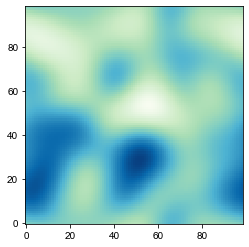

8720 50000 99 0.5760330283509091 0.04835664897920577
24490.0 25000.0 24490.0 25000.0


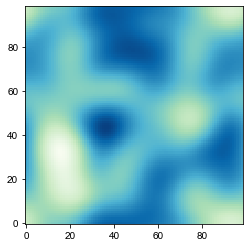

8720 50000 99 0.49666539225026396 0.020649295490892408
24490.0 25000.0 24490.0 25000.0


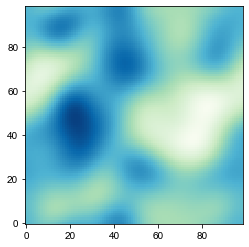

8720 50000 99 0.46863085994219733 0.051212275688598846
24490.0 25000.0 24490.0 25000.0


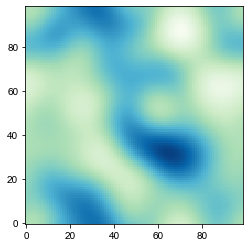

8720 50000 99 0.46388709353362706 -0.020196473925592165
24490.0 25000.0 24490.0 25000.0


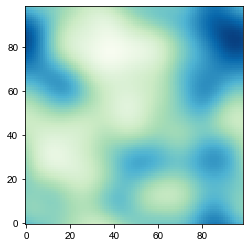

8720 50000 99 0.576906849270203 0.009242872541481076
24490.0 25000.0 24490.0 25000.0


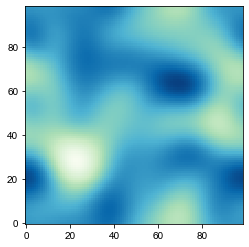

8720 50000 99 0.49423134057053875 0.012587826344259445
24490.0 25000.0 24490.0 25000.0


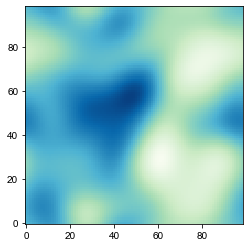

8720 50000 99 0.6007892601668009 0.12185284461227297
24490.0 25000.0 24490.0 25000.0


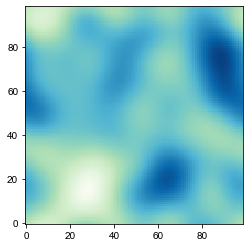

8720 50000 99 0.5759422940975204 0.09920604772448863
24490.0 25000.0 24490.0 25000.0


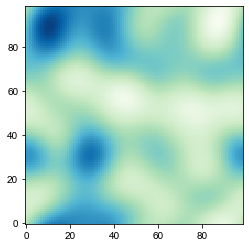

8720 50000 99 0.45483526337002406 -0.09761219028197439
24490.0 25000.0 24490.0 25000.0


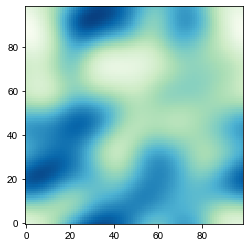

8720 50000 99 0.5572276715329996 0.040740900744577195
24490.0 25000.0 24490.0 25000.0


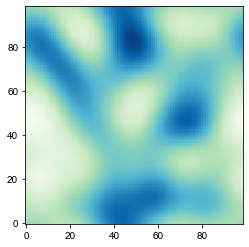

8720 50000 99 0.5693106231082736 0.17592478011630194
24490.0 25000.0 24490.0 25000.0


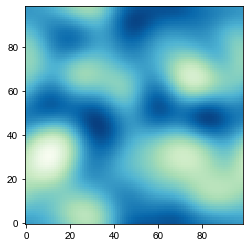

8720 50000 99 0.5182930291421735 -0.03480766916592114
24490.0 25000.0 24490.0 25000.0


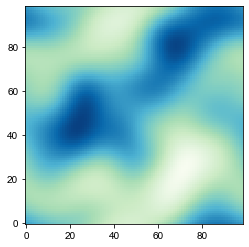

8720 50000 99 0.6984666276492828 -0.20017956151406205
24490.0 25000.0 24490.0 25000.0


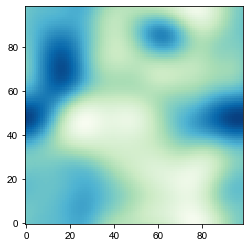

8720 50000 99 0.5212002897187322 -0.016679723751658052
24490.0 25000.0 24490.0 25000.0


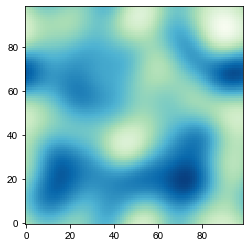

8720 50000 99 0.4564075805779294 0.18908620666980222
24490.0 25000.0 24490.0 25000.0


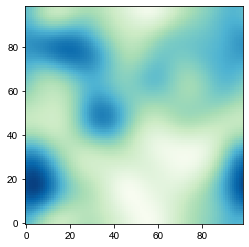

8720 50000 99 0.6485798214581155 0.08237051332323911
24490.0 25000.0 24490.0 25000.0


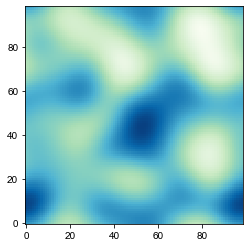

8720 50000 99 0.5490674793536505 -0.2826956284352094
24490.0 25000.0 24490.0 25000.0


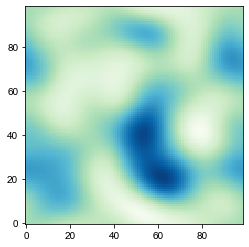

8720 50000 99 0.47850110516294403 -0.02590300264884266
24490.0 25000.0 24490.0 25000.0


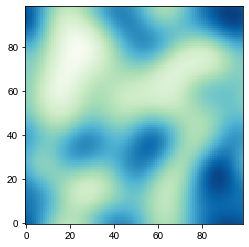

8720 50000 99 0.6563064844369723 0.1724320237607392
24490.0 25000.0 24490.0 25000.0


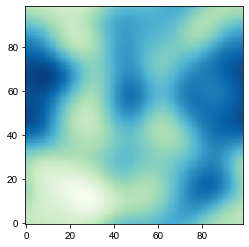

8720 50000 99 0.6340418779068819 -0.008361460516373136
24490.0 25000.0 24490.0 25000.0


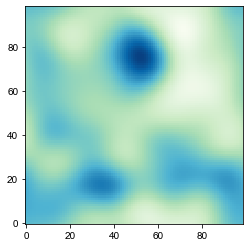

8720 50000 99 0.48226537278486603 -0.13886293516282538
24490.0 25000.0 24490.0 25000.0


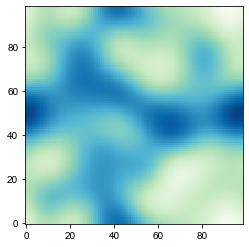

8720 50000 99 0.49809646636993316 0.06890705805212519
24490.0 25000.0 24490.0 25000.0


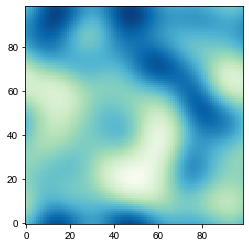

8720 50000 99 0.5891519633929578 -0.22558679341745522
24490.0 25000.0 24490.0 25000.0


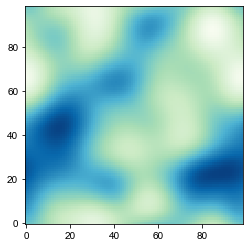

8720 50000 99 0.5167689954904086 0.2453148792160909
24490.0 25000.0 24490.0 25000.0


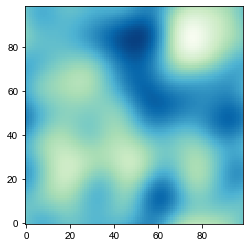

8720 50000 99 0.530751821582639 0.02590137534549563
24490.0 25000.0 24490.0 25000.0


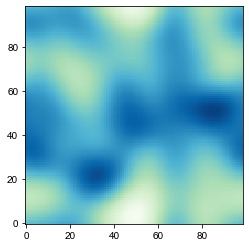

8720 50000 99 0.5399423550886989 0.30084966710887606
24490.0 25000.0 24490.0 25000.0


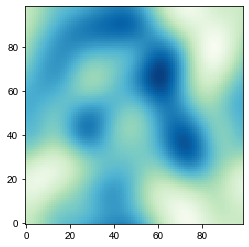

8720 50000 99 0.597857663617807 -0.1496992787558754
24490.0 25000.0 24490.0 25000.0


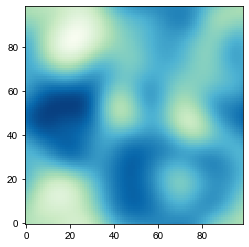

8720 50000 99 0.43326874582871877 0.3304825281833041
24490.0 25000.0 24490.0 25000.0


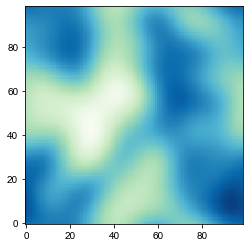

8720 50000 99 0.6444695522481158 -0.32930529720356355
24490.0 25000.0 24490.0 25000.0


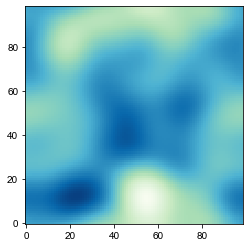

8720 50000 99 0.6295924271494645 0.2322642949916625
24490.0 25000.0 24490.0 25000.0


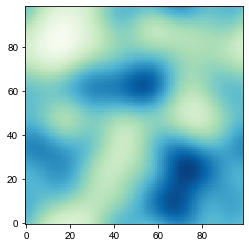

8720 50000 99 0.637563930107445 -0.09769530737626815
24490.0 25000.0 24490.0 25000.0


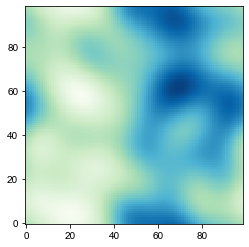

8720 50000 99 0.7027599035748137 -0.11694257050958036
24490.0 25000.0 24490.0 25000.0


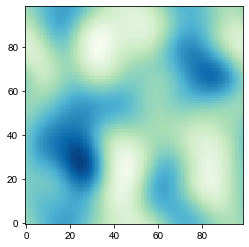

8720 50000 99 0.44655542192041675 -0.10729647672337142
24490.0 25000.0 24490.0 25000.0


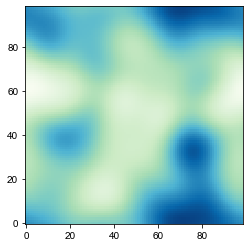

8720 50000 99 0.5925180025377123 0.12793923901622917
24490.0 25000.0 24490.0 25000.0


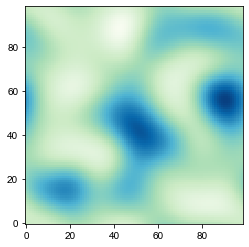

8720 50000 99 0.5778504964780936 -0.2077152205563339
24490.0 25000.0 24490.0 25000.0


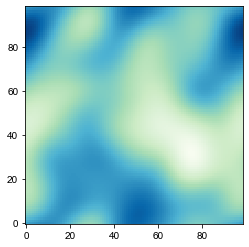

8720 50000 99 0.5953928914420494 0.037158328384377125
24490.0 25000.0 24490.0 25000.0


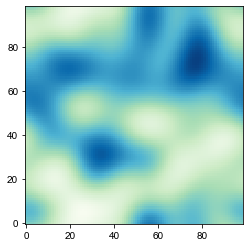

8720 50000 99 0.47387196390520303 -0.08906932607569418
24490.0 25000.0 24490.0 25000.0


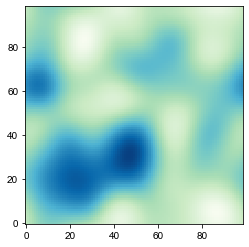

8720 50000 99 0.555606019323591 0.091690571626411
24490.0 25000.0 24490.0 25000.0


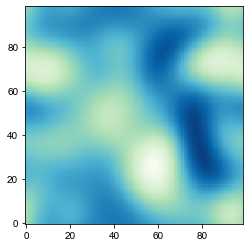

8720 50000 99 0.517543103613379 -0.21195146691865127
24490.0 25000.0 24490.0 25000.0


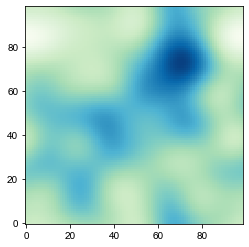

8720 50000 99 0.48278082165197006 0.027018647761591255
24490.0 25000.0 24490.0 25000.0


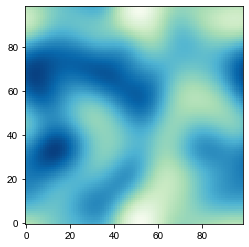

8720 50000 99 0.4883315262387109 -0.0065415024545451735
24490.0 25000.0 24490.0 25000.0


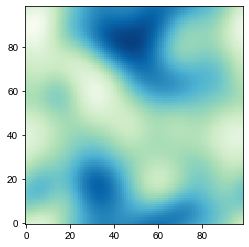

8720 50000 99 0.5997419956828195 0.04740567821081438
24490.0 25000.0 24490.0 25000.0


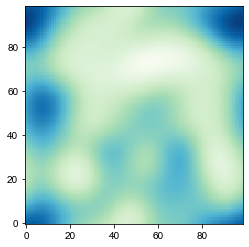

8720 50000 99 0.5918686633167612 -0.050949302656730026
24490.0 25000.0 24490.0 25000.0


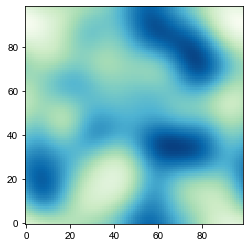

8720 50000 99 0.5724771298832716 0.09213044200047468
24490.0 25000.0 24490.0 25000.0


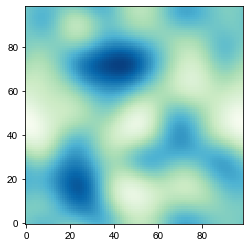

8720 50000 99 0.4889073726705171 0.01154940419361827
24490.0 25000.0 24490.0 25000.0


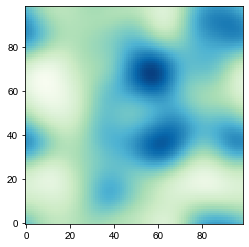

8720 50000 99 0.5222707097708925 0.2227325328711037
24490.0 25000.0 24490.0 25000.0


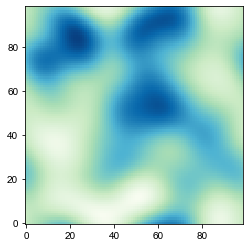

8720 50000 99 0.45050251195605523 -0.0485762510306142
24490.0 25000.0 24490.0 25000.0


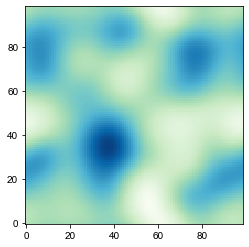

8720 50000 99 0.5001782281796009 -0.2914219905597526
24490.0 25000.0 24490.0 25000.0


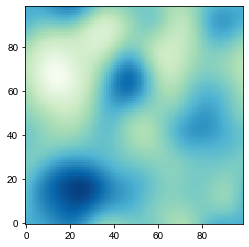

8720 50000 99 0.6548729022473696 0.25102120389126575
24490.0 25000.0 24490.0 25000.0


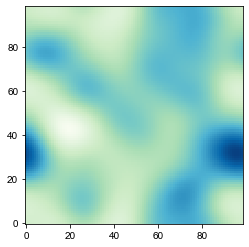

8720 50000 99 0.5008939019477874 0.26803641446810744
24490.0 25000.0 24490.0 25000.0


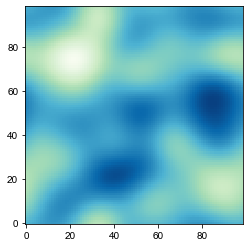

8720 50000 99 0.5252607617613386 -0.21557552771145852
24490.0 25000.0 24490.0 25000.0


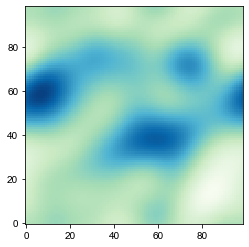

8720 50000 99 0.628474781210585 0.05164164650704861
24490.0 25000.0 24490.0 25000.0


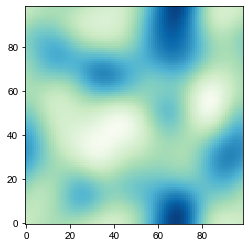

8720 50000 99 0.5719442549236943 -0.15735639582271344
24490.0 25000.0 24490.0 25000.0


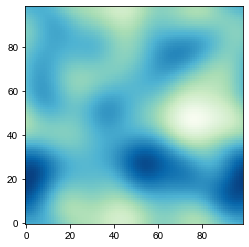

8720 50000 99 0.5583123600651246 0.07646001104758766
24490.0 25000.0 24490.0 25000.0


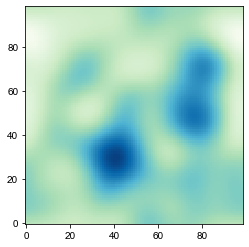

8720 50000 99 0.4693827670588215 0.17291430954977388
24490.0 25000.0 24490.0 25000.0


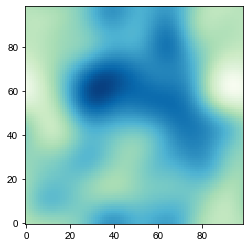

8720 50000 99 0.6221595125075898 -0.1533336315727026
24490.0 25000.0 24490.0 25000.0


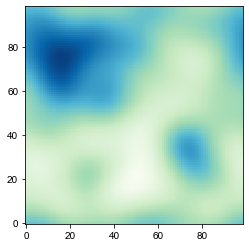

8720 50000 99 0.7449085215456792 0.05776901966574357
24490.0 25000.0 24490.0 25000.0


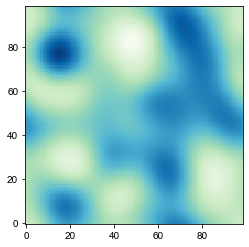

8720 50000 99 0.5091871998183509 -0.23244818009900467
24490.0 25000.0 24490.0 25000.0


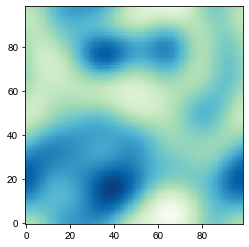

8720 50000 99 0.5171290122332431 0.2001003351626255
24490.0 25000.0 24490.0 25000.0


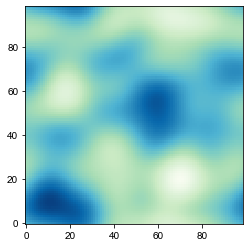

8720 50000 99 0.45506340164677506 0.08981369563578827
24490.0 25000.0 24490.0 25000.0


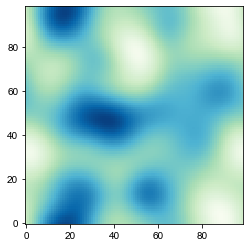

8720 50000 99 0.52109986631891 -0.127123366180936
24490.0 25000.0 24490.0 25000.0


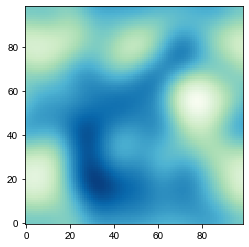

8720 50000 99 0.6807795445150824 -0.2681110712857476
24490.0 25000.0 24490.0 25000.0


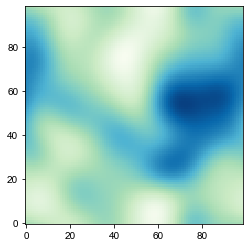

8720 50000 99 0.607248724147538 0.13687397776719135
24490.0 25000.0 24490.0 25000.0


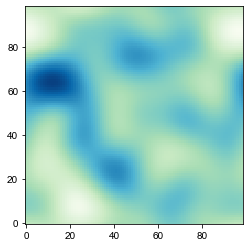

8720 50000 99 0.4908601762498274 0.27286996126104196
24490.0 25000.0 24490.0 25000.0


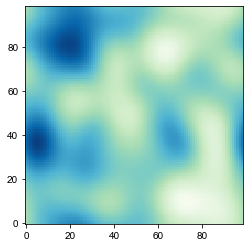

8720 50000 99 0.451832475660844 0.23624596337004355
24490.0 25000.0 24490.0 25000.0


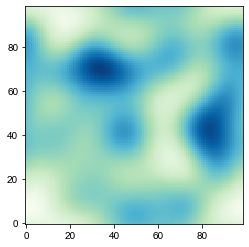

8720 50000 99 0.4843857451140091 0.02376774040246497
24490.0 25000.0 24490.0 25000.0


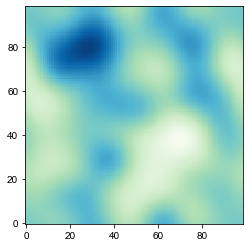

8720 50000 99 0.5333515920359809 -0.2335954095442327
24490.0 25000.0 24490.0 25000.0


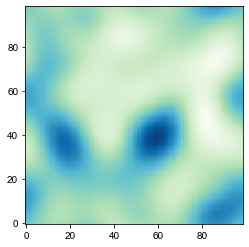

8720 50000 99 0.4306500692621098 0.07276846424198383
24490.0 25000.0 24490.0 25000.0


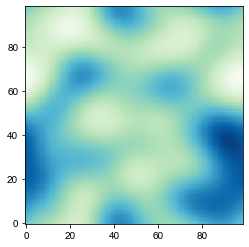

8720 50000 99 0.5612654267219805 -0.05026530525287089
24490.0 25000.0 24490.0 25000.0


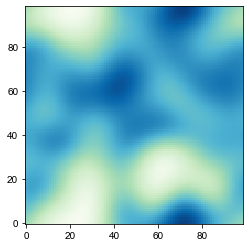

8720 50000 99 0.607666114834779 -0.21317990716934762
24490.0 25000.0 24490.0 25000.0


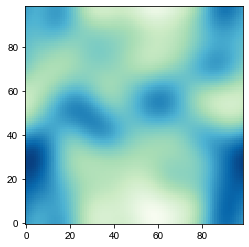

8720 50000 99 0.5209727219984475 -0.567842732775543
24490.0 25000.0 24490.0 25000.0


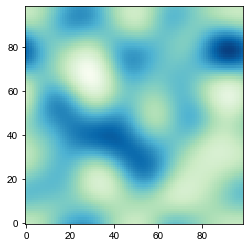

8720 50000 99 0.46032564443014296 0.4605990239822264
24490.0 25000.0 24490.0 25000.0


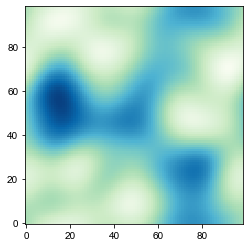

8720 50000 99 0.6208092144775995 -0.013776395798413141
24490.0 25000.0 24490.0 25000.0


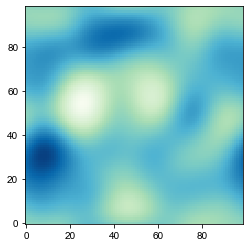

8720 50000 99 0.5629629921935518 -0.020599933830638614
24490.0 25000.0 24490.0 25000.0


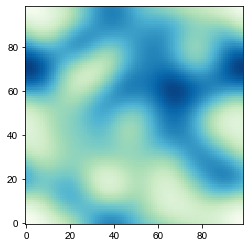

8720 50000 99 0.469658524694742 0.07789123627333204
24490.0 25000.0 24490.0 25000.0


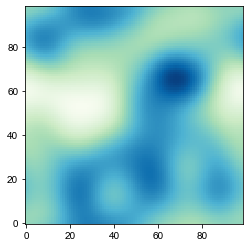

8720 50000 99 0.7449687685854803 0.07114488016048558
24490.0 25000.0 24490.0 25000.0


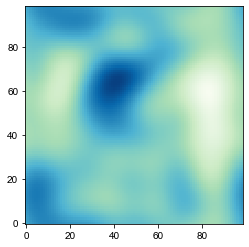

8720 50000 99 0.49682982491199884 0.03526591061704875
24490.0 25000.0 24490.0 25000.0


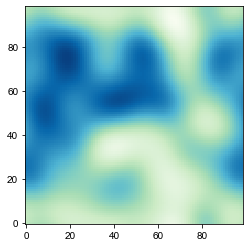

8720 50000 99 0.5446224199851877 0.21732300539961696
24490.0 25000.0 24490.0 25000.0


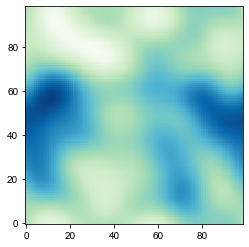

8720 50000 99 0.5106452958798503 -0.26241069969839054
24490.0 25000.0 24490.0 25000.0


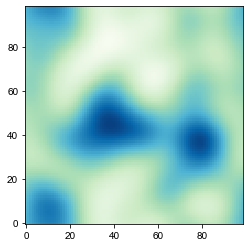

8720 50000 99 0.596317715927653 0.005786429472199967
24490.0 25000.0 24490.0 25000.0


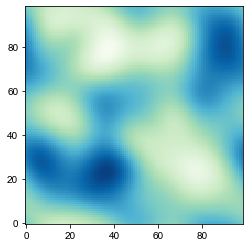

8720 50000 99 0.5443964097555564 0.31346203532034855
24490.0 25000.0 24490.0 25000.0


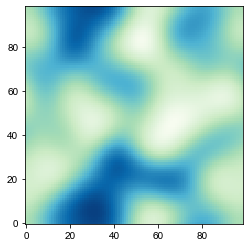

8720 50000 99 0.48251649021534937 -0.053949698835064924
24490.0 25000.0 24490.0 25000.0


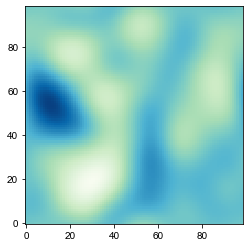

8720 50000 99 0.49620172507185073 -0.09760505542545232
24490.0 25000.0 24490.0 25000.0


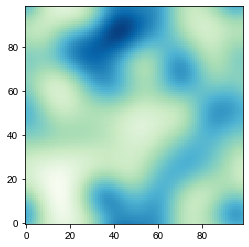

8720 50000 99 0.4536979174841292 -0.1650762039441115
24490.0 25000.0 24490.0 25000.0


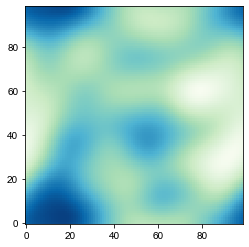

8720 50000 99 0.7212965001298975 0.026142794577182972
24490.0 25000.0 24490.0 25000.0


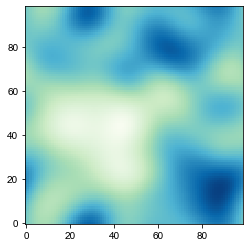

8720 50000 99 0.5752477880174506 -0.3050962175372598
24490.0 25000.0 24490.0 25000.0


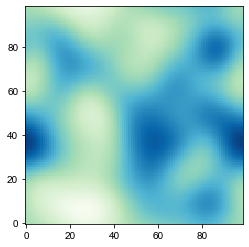

8720 50000 99 0.5396285590643004 -0.1754615173822009
24490.0 25000.0 24490.0 25000.0


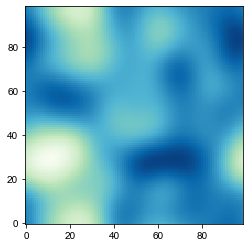

8720 50000 99 0.5611492644158141 -0.0016439266818432244
24490.0 25000.0 24490.0 25000.0


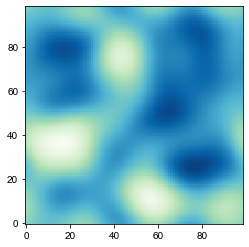

8720 50000 99 0.42925192622295777 -0.17458055175174772
24490.0 25000.0 24490.0 25000.0


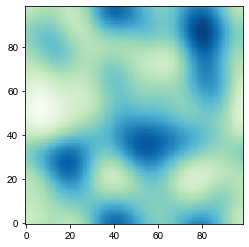

8720 50000 99 0.4200111631277549 -0.00490749964571893
24490.0 25000.0 24490.0 25000.0


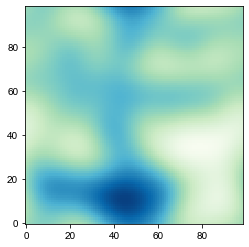

8720 50000 99 0.6856552961582981 -0.08388154461869797
24490.0 25000.0 24490.0 25000.0


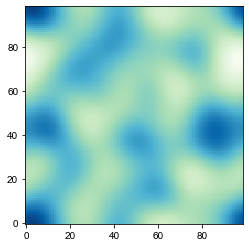

8720 50000 99 0.34692226535180465 -0.28858342852275165
24490.0 25000.0 24490.0 25000.0


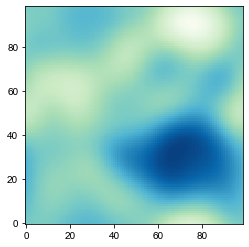

8720 50000 99 0.7299188355628723 -0.12265497535167662
24490.0 25000.0 24490.0 25000.0


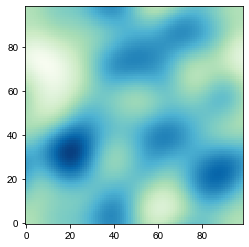

8720 50000 99 0.6277722863213896 0.0779925682716826
24490.0 25000.0 24490.0 25000.0


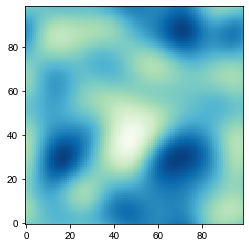

8720 50000 99 0.42543036161405584 -0.1360869847840214
24490.0 25000.0 24490.0 25000.0


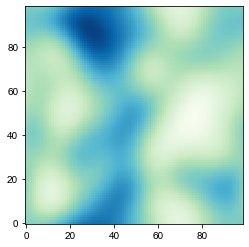

8720 50000 99 0.6141337520093094 -0.033591541158622194
24490.0 25000.0 24490.0 25000.0


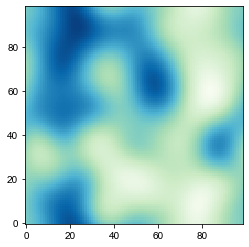

8720 50000 99 0.5559839128609219 -0.012678925811363415
24490.0 25000.0 24490.0 25000.0


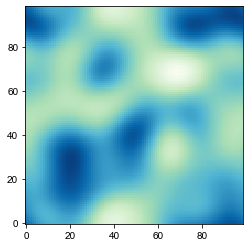

8720 50000 99 0.43535973589806026 -0.011900947167837397
24490.0 25000.0 24490.0 25000.0


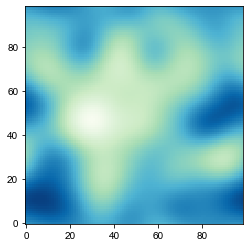

8720 50000 99 0.5961987559149179 0.23180740170505498
24490.0 25000.0 24490.0 25000.0


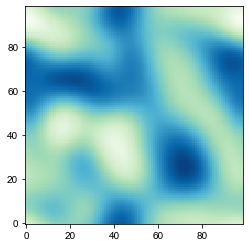

8720 50000 99 0.4047071469756441 -0.3090088843095374
24490.0 25000.0 24490.0 25000.0


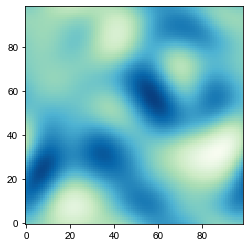

8720 50000 99 0.4683851524822605 -0.33977257800918753
24490.0 25000.0 24490.0 25000.0


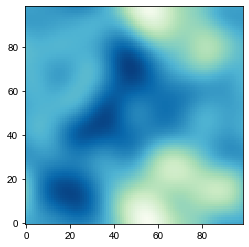

8720 50000 99 0.515783942227031 0.4378545418988635
24490.0 25000.0 24490.0 25000.0


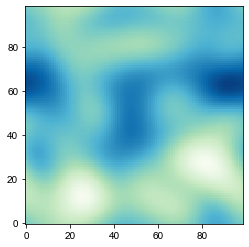

8720 50000 99 0.5622507312178284 0.40555749141330166
24490.0 25000.0 24490.0 25000.0


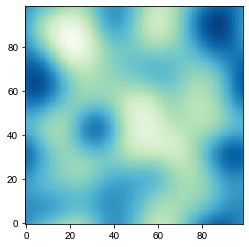

8720 50000 99 0.5800954889647685 0.017790443275596212
24490.0 25000.0 24490.0 25000.0


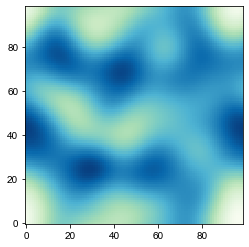

8720 50000 99 0.5435260267636776 0.06187969996814055
24490.0 25000.0 24490.0 25000.0


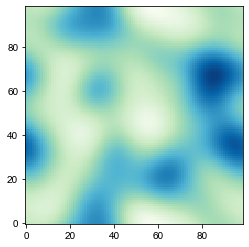

8720 50000 99 0.530865848594047 -0.13716373360462303
24490.0 25000.0 24490.0 25000.0


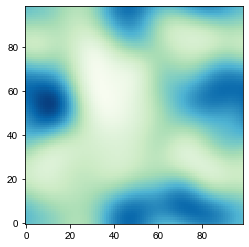

8720 50000 99 0.604538713114526 -0.08231727211755978
24490.0 25000.0 24490.0 25000.0


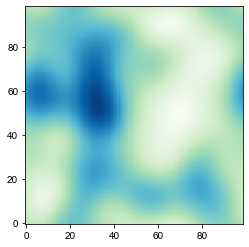

8720 50000 99 0.5968569264456286 -0.2321513010935215
24490.0 25000.0 24490.0 25000.0


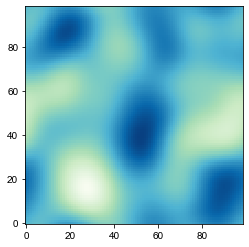

8720 50000 99 0.6200575889582258 0.18719998989928036
24490.0 25000.0 24490.0 25000.0


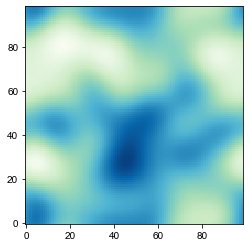

8720 50000 99 0.47754026786496884 0.09631614404822281
24490.0 25000.0 24490.0 25000.0


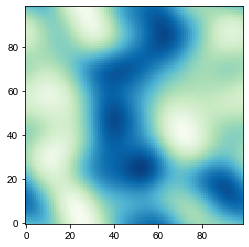

8720 50000 99 0.6391949620240115 0.26755559052669714
24490.0 25000.0 24490.0 25000.0


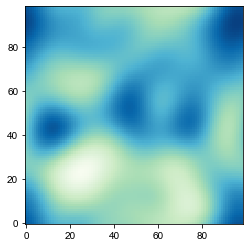

8720 50000 99 0.6068110631697908 -0.04941839421997634
24490.0 25000.0 24490.0 25000.0


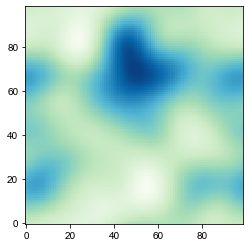

8720 50000 99 0.5506847083942129 0.004543604530969749
24490.0 25000.0 24490.0 25000.0


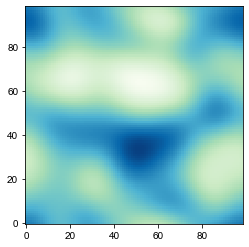

8720 50000 99 0.7021361455017322 0.029146520487746057
24490.0 25000.0 24490.0 25000.0


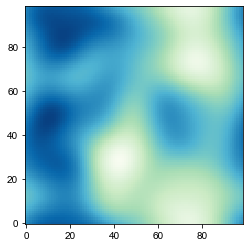

8720 50000 99 0.6932040091104668 0.0016021000097051468
24490.0 25000.0 24490.0 25000.0


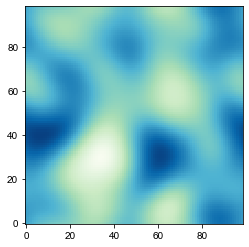

8720 50000 99 0.49236384865808275 -0.05798311313888913
24490.0 25000.0 24490.0 25000.0


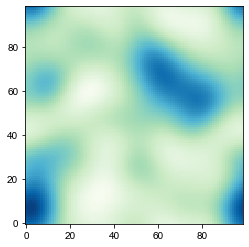

8720 50000 99 0.501212564359385 0.36625184869062616
24490.0 25000.0 24490.0 25000.0


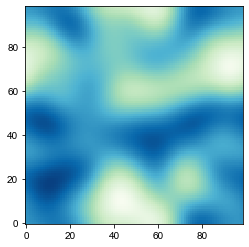

8720 50000 99 0.5291454393134224 0.14655596952686223
24490.0 25000.0 24490.0 25000.0


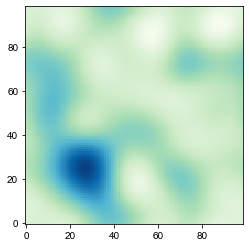

8720 50000 99 0.5023127213584462 -0.27584153039342135
24490.0 25000.0 24490.0 25000.0


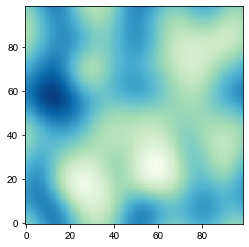

8720 50000 99 0.5142373122121496 -0.04975680873848404
24490.0 25000.0 24490.0 25000.0


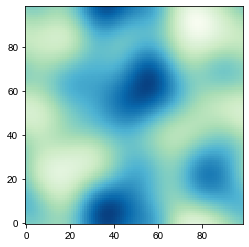

8720 50000 99 0.6865202287619537 -0.29915325928209185
24490.0 25000.0 24490.0 25000.0


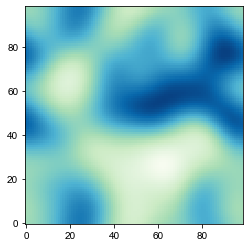

8720 50000 99 0.6730837866929357 -0.19613608246532174
24490.0 25000.0 24490.0 25000.0


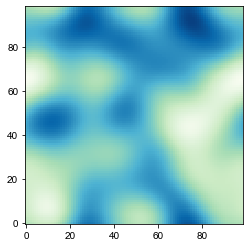

8720 50000 99 0.5311905232824621 -0.05575138148982413
24490.0 25000.0 24490.0 25000.0


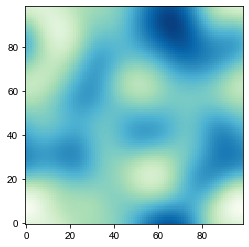

8720 50000 99 0.5948086978199109 0.09960712154837456
24490.0 25000.0 24490.0 25000.0


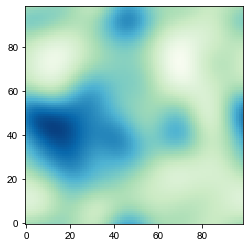

8720 50000 99 0.6600520330042523 -0.25833205261046155
24490.0 25000.0 24490.0 25000.0


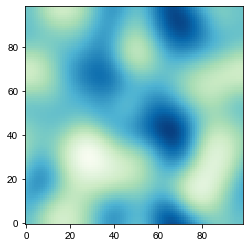

8720 50000 99 0.48280446616981054 -0.008560788341655258
24490.0 25000.0 24490.0 25000.0


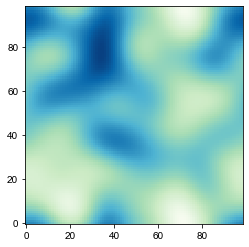

8720 50000 99 0.5348634405250068 -0.051947975355890894
24490.0 25000.0 24490.0 25000.0


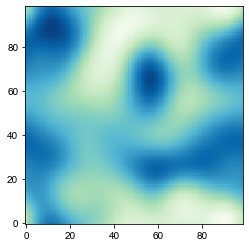

8720 50000 99 0.5283295394043439 -0.07685296960912599
24490.0 25000.0 24490.0 25000.0


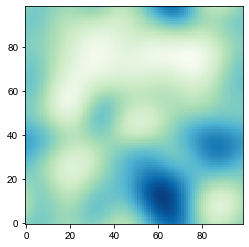

8720 50000 99 0.5951051200869829 0.0074904068778470865
24490.0 25000.0 24490.0 25000.0


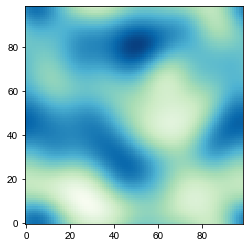

8720 50000 99 0.5619364372590988 0.032740280018388114
24490.0 25000.0 24490.0 25000.0


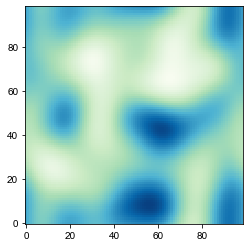

8720 50000 99 0.4328433992424424 0.10765979072375609
24490.0 25000.0 24490.0 25000.0


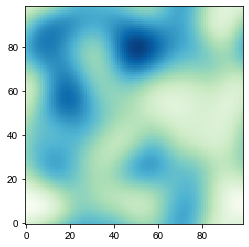

8720 50000 99 0.5646840439547197 0.4385000411562504
24490.0 25000.0 24490.0 25000.0


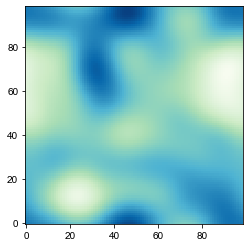

8720 50000 99 0.5914504296079645 0.22848428368744747
24490.0 25000.0 24490.0 25000.0


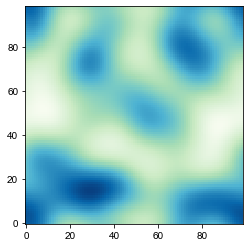

8720 50000 99 0.5192590541196228 0.050466240805971695
24490.0 25000.0 24490.0 25000.0


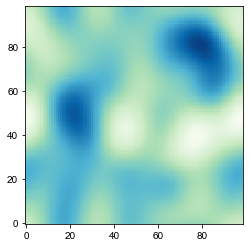

8720 50000 99 0.4578408866458644 0.130995982584015
24490.0 25000.0 24490.0 25000.0


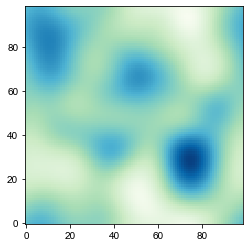

8720 50000 99 0.5809326053308826 -0.2145480643511324
24490.0 25000.0 24490.0 25000.0


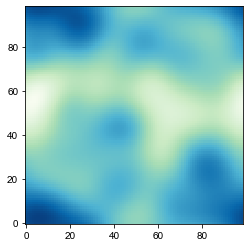

8720 50000 99 0.6492300433148277 -0.05005959273689068
24490.0 25000.0 24490.0 25000.0


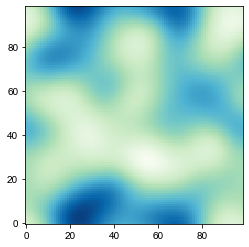

8720 50000 99 0.4903985266970452 0.09738895717625269
24490.0 25000.0 24490.0 25000.0


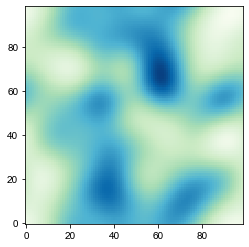

8720 50000 99 0.5136479536719721 0.10027859654829811
24490.0 25000.0 24490.0 25000.0


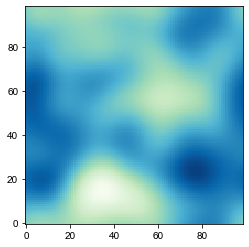

8720 50000 99 0.6039346335641236 0.09162716777829731
24490.0 25000.0 24490.0 25000.0


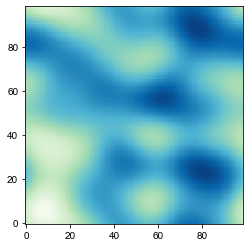

8720 50000 99 0.5627210019133847 -0.030808708347013266
24490.0 25000.0 24490.0 25000.0


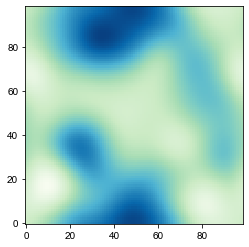

8720 50000 99 0.7559180153758531 -0.1803953165030266
24490.0 25000.0 24490.0 25000.0


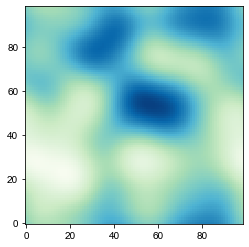

8720 50000 99 0.6901761446703657 -0.0017986126612982898
24490.0 25000.0 24490.0 25000.0


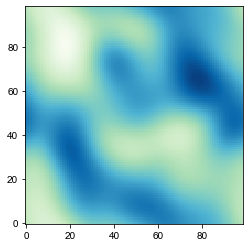

8720 50000 99 0.6915326126817595 -0.05162457260307681
24490.0 25000.0 24490.0 25000.0


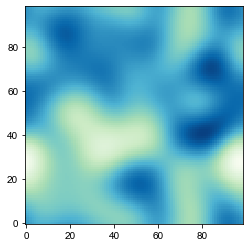

8720 50000 99 0.45900532829761986 0.02939486141816283
24490.0 25000.0 24490.0 25000.0


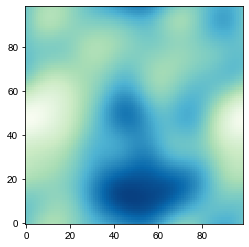

8720 50000 99 0.6402774184833618 0.041945581374896686
24490.0 25000.0 24490.0 25000.0


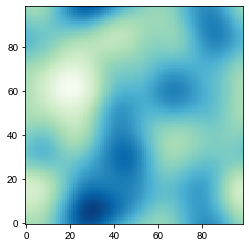

8720 50000 99 0.6939420498076682 -0.2583591768745601
24490.0 25000.0 24490.0 25000.0


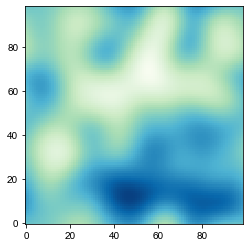

8720 50000 99 0.4368610887186899 0.0025939786974199215
24490.0 25000.0 24490.0 25000.0


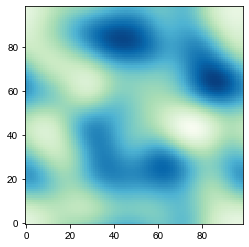

8720 50000 99 0.6113333151978372 -0.29871738979594464
24490.0 25000.0 24490.0 25000.0


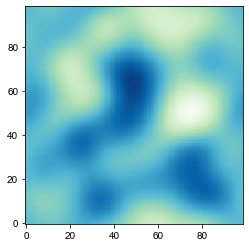

8720 50000 99 0.4765007770017492 -0.0009312597959014711
24490.0 25000.0 24490.0 25000.0


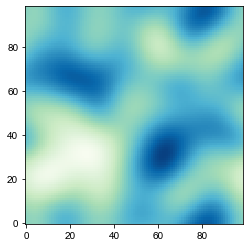

8720 50000 99 0.5775365714559761 0.12055908994694259
24490.0 25000.0 24490.0 25000.0


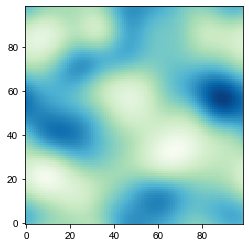

8720 50000 99 0.5226683764510712 0.10055994801769079
24490.0 25000.0 24490.0 25000.0


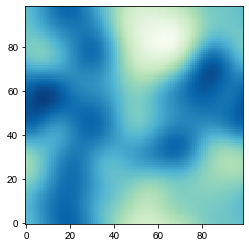

8720 50000 99 0.6613190390229152 -0.08186314478057445
24490.0 25000.0 24490.0 25000.0


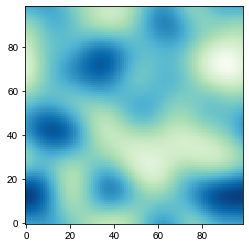

8720 50000 99 0.5227791382330234 -0.06365773754415162
24490.0 25000.0 24490.0 25000.0


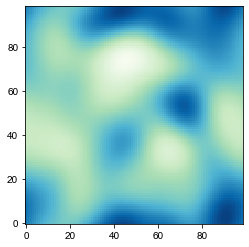

8720 50000 99 0.5668216762558472 0.2475982361357168
24490.0 25000.0 24490.0 25000.0


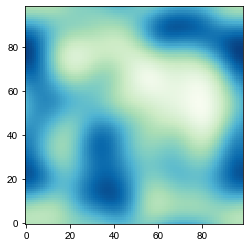

8720 50000 99 0.529211822286259 -0.01524098639479298
24490.0 25000.0 24490.0 25000.0


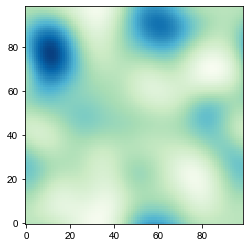

8720 50000 99 0.6791672555252296 0.20193251940503915
24490.0 25000.0 24490.0 25000.0


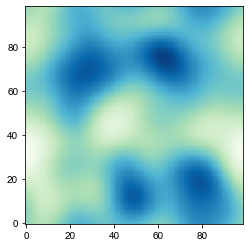

8720 50000 99 0.4528474833217495 -0.4129915208740575
24490.0 25000.0 24490.0 25000.0


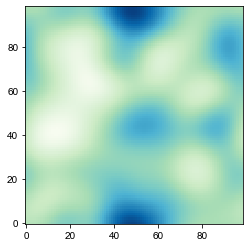

8720 50000 99 0.5926807466057318 0.006334452434856487
24490.0 25000.0 24490.0 25000.0


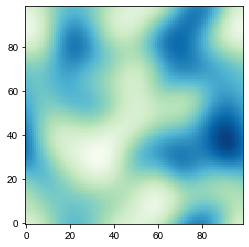

8720 50000 99 0.591217328438831 0.2008252668112122
24490.0 25000.0 24490.0 25000.0


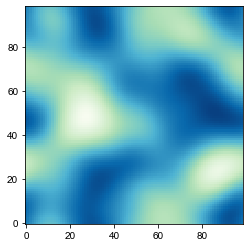

8720 50000 99 0.5316438317185452 0.1844289317027811
24490.0 25000.0 24490.0 25000.0


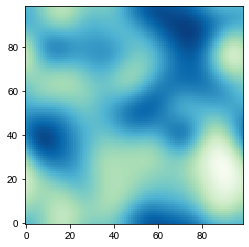

8720 50000 99 0.4977301803800389 0.102598221108783
24490.0 25000.0 24490.0 25000.0


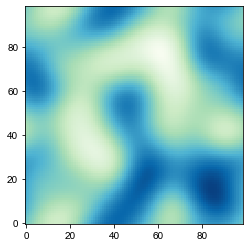

8720 50000 99 0.5621797135119486 0.15859211736311596
24490.0 25000.0 24490.0 25000.0


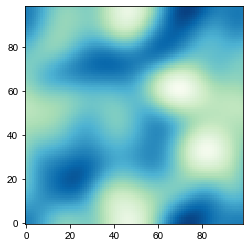

8720 50000 99 0.5664073154351887 -0.0168293246425465
24490.0 25000.0 24490.0 25000.0


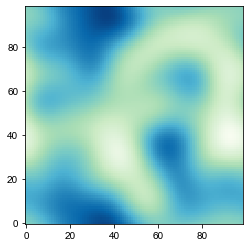

8720 50000 99 0.5133422591672117 -0.2649039316068112
24490.0 25000.0 24490.0 25000.0


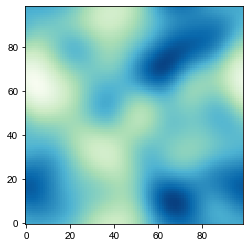

8720 50000 99 0.5253882657564519 0.07547324626881435
24490.0 25000.0 24490.0 25000.0


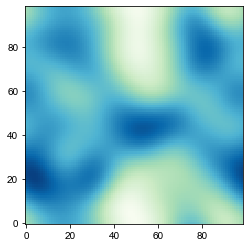

8720 50000 99 0.6506681813430781 -0.00331280300513892
24490.0 25000.0 24490.0 25000.0


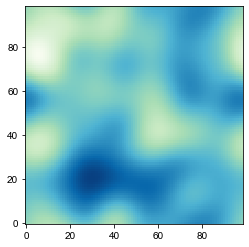

8720 50000 99 0.5851543940156583 -0.33401292090753426
24490.0 25000.0 24490.0 25000.0


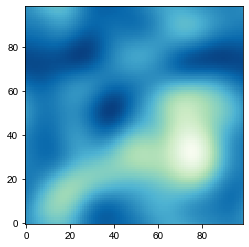

8720 50000 99 0.5726097184111105 -0.11602848544243896
24490.0 25000.0 24490.0 25000.0


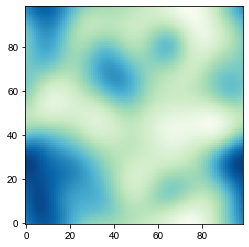

8720 50000 99 0.5934097125290895 -0.054926521088350215
24490.0 25000.0 24490.0 25000.0


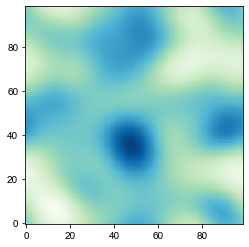

8720 50000 99 0.5693645452688155 0.014449855007630625
24490.0 25000.0 24490.0 25000.0


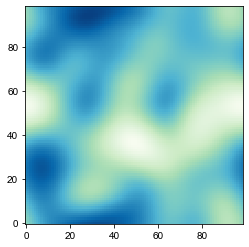

8720 50000 99 0.6380480778609646 -0.10251196686779496
24490.0 25000.0 24490.0 25000.0


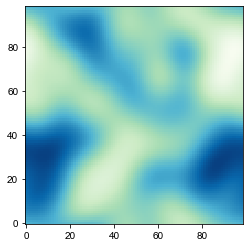

8720 50000 99 0.502620220741781 -0.11688418069395849
24490.0 25000.0 24490.0 25000.0


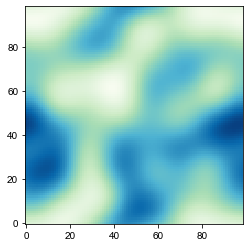

8720 50000 99 0.495012160332643 -0.05384544729242556
24490.0 25000.0 24490.0 25000.0


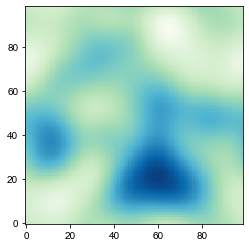

8720 50000 99 0.6042849382545054 0.12525784531418255
24490.0 25000.0 24490.0 25000.0


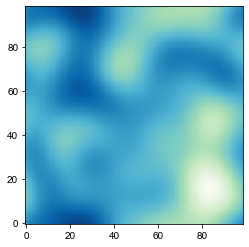

8720 50000 99 0.5590434508653637 -0.05977299744845315
24490.0 25000.0 24490.0 25000.0


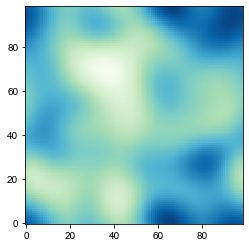

8720 50000 99 0.49822531598508796 0.03593129515475705
24490.0 25000.0 24490.0 25000.0


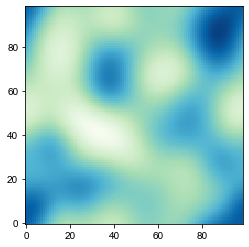

8720 50000 99 0.5662386042559204 -0.08348731300989638
24490.0 25000.0 24490.0 25000.0


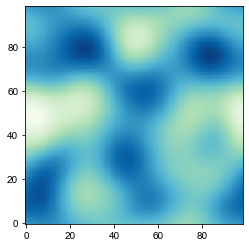

8720 50000 99 0.5426795193175552 0.46433320082948093
24490.0 25000.0 24490.0 25000.0


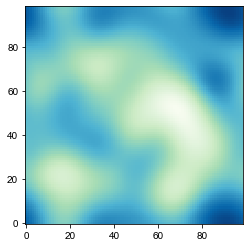

8720 50000 99 0.6328202288142541 -0.1844564730733344
24490.0 25000.0 24490.0 25000.0


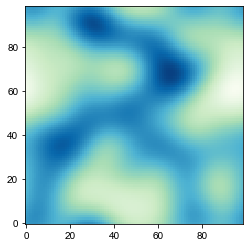

8720 50000 99 0.5348945110597293 0.17049643083191104
24490.0 25000.0 24490.0 25000.0


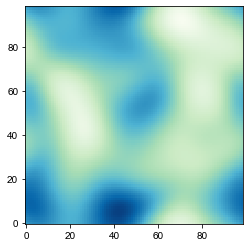

8720 50000 99 0.6212893069386255 -0.11943537279366206
24490.0 25000.0 24490.0 25000.0


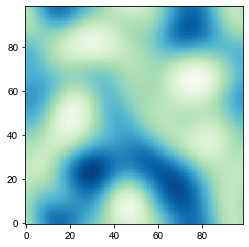

8720 50000 99 0.4473479592750955 0.09910545313791404
24490.0 25000.0 24490.0 25000.0


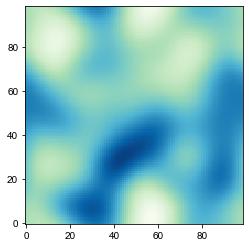

8720 50000 99 0.5468550781872273 -0.05603724375026262
24490.0 25000.0 24490.0 25000.0


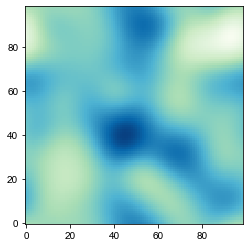

8720 50000 99 0.43442312278425266 0.3552349121055197
24490.0 25000.0 24490.0 25000.0


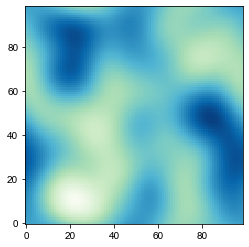

8720 50000 99 0.5138256028530201 -0.21821366628979152
24490.0 25000.0 24490.0 25000.0


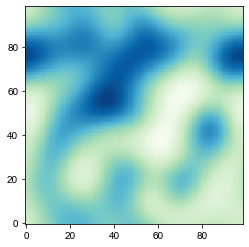

8720 50000 99 0.4570527353268229 -0.10752022742321903
24490.0 25000.0 24490.0 25000.0


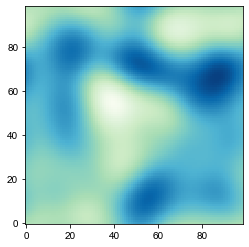

8720 50000 99 0.5782289142405808 -0.3349522464086196
24490.0 25000.0 24490.0 25000.0


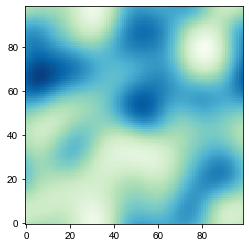

8720 50000 99 0.5193050837959315 0.021469325605825415
24490.0 25000.0 24490.0 25000.0


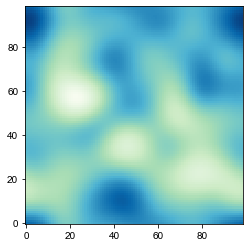

8720 50000 99 0.42711239467259304 0.07023259783434965
24490.0 25000.0 24490.0 25000.0


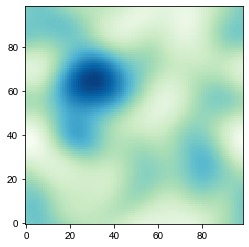

8720 50000 99 0.4524342242519876 -0.07594991983422258
24490.0 25000.0 24490.0 25000.0


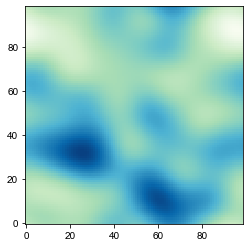

8720 50000 99 0.5167762738297691 0.039014597313527785
24490.0 25000.0 24490.0 25000.0


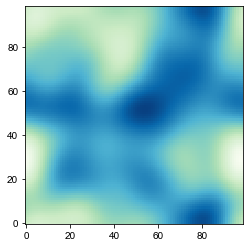

8720 50000 99 0.5783092923828524 -0.027920414157215075
24490.0 25000.0 24490.0 25000.0


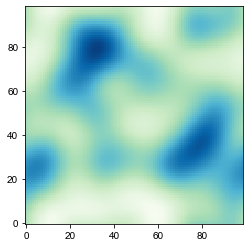

8720 50000 99 0.46195451513327207 0.34623923641891
24490.0 25000.0 24490.0 25000.0


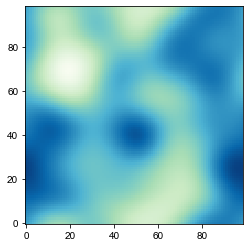

8720 50000 99 0.7073264316404902 0.27233081063278486
24490.0 25000.0 24490.0 25000.0


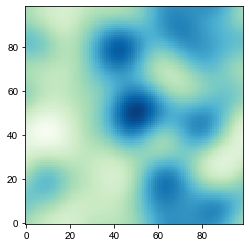

8720 50000 99 0.4938413880045949 -0.16049906579495993
24490.0 25000.0 24490.0 25000.0


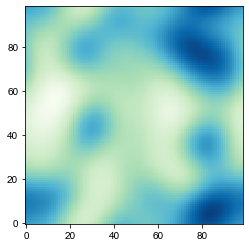

8720 50000 99 0.6320533049746893 0.22112383036422012
24490.0 25000.0 24490.0 25000.0


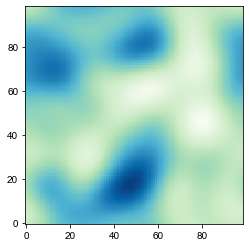

8720 50000 99 0.5671294698674847 -0.14800275782206163
24490.0 25000.0 24490.0 25000.0


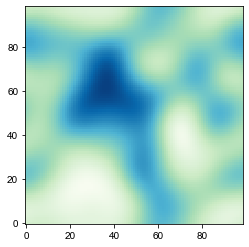

8720 50000 99 0.5257603488398664 0.16388321396007619
24490.0 25000.0 24490.0 25000.0


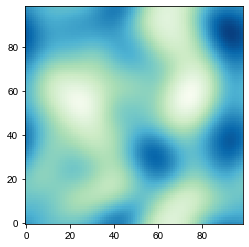

8720 50000 99 0.6001821295943796 0.2890005090729866
24490.0 25000.0 24490.0 25000.0


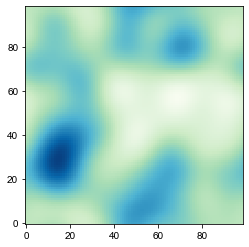

8720 50000 99 0.48659133118873366 -0.12429364854352143
24490.0 25000.0 24490.0 25000.0


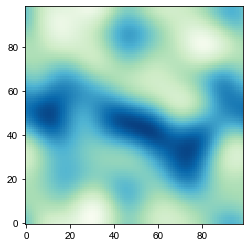

8720 50000 99 0.461734854603147 0.2338871024130437
24490.0 25000.0 24490.0 25000.0


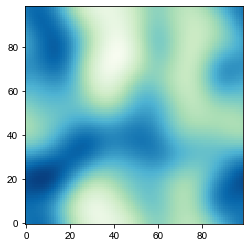

8720 50000 99 0.5697906873151085 0.3946087014782
24490.0 25000.0 24490.0 25000.0


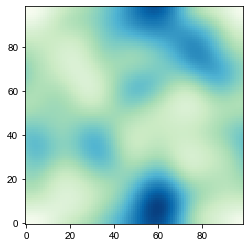

8720 50000 99 0.5910163161532218 -0.08163714357587654
24490.0 25000.0 24490.0 25000.0


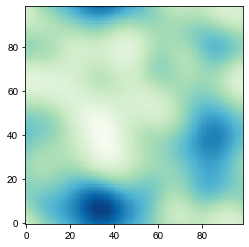

8720 50000 99 0.6047806152866152 -0.03133795002871148
24490.0 25000.0 24490.0 25000.0


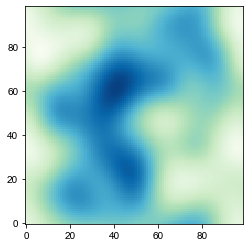

8720 50000 99 0.5628606131774733 -0.08873904406291731
24490.0 25000.0 24490.0 25000.0


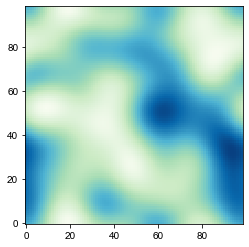

8720 50000 99 0.4998204817468296 0.09109408900477192
24490.0 25000.0 24490.0 25000.0


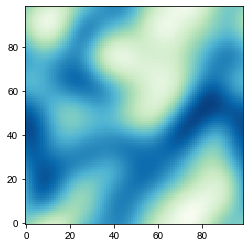

8720 50000 99 0.47770118529652156 -0.0334078484106657
24490.0 25000.0 24490.0 25000.0


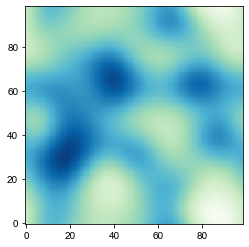

8720 50000 99 0.5558249549731532 -0.058973732337947025
24490.0 25000.0 24490.0 25000.0


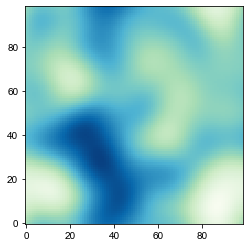

8720 50000 99 0.6276634252543282 0.008093253127784056
24490.0 25000.0 24490.0 25000.0


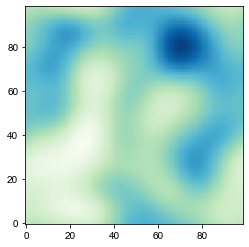

8720 50000 99 0.5856610492015719 -0.0846122006248389
24490.0 25000.0 24490.0 25000.0


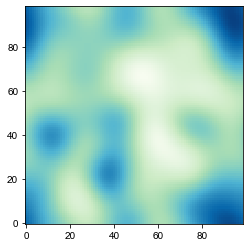

8720 50000 99 0.6553751522631884 -0.1846725642178486
24490.0 25000.0 24490.0 25000.0


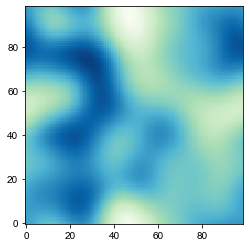

8720 50000 99 0.5405153077826942 -0.0774047781599954
24490.0 25000.0 24490.0 25000.0


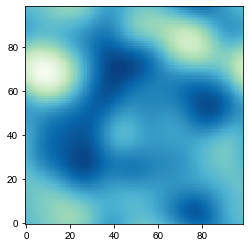

8720 50000 99 0.6633431861124963 -0.15490499463732868
24490.0 25000.0 24490.0 25000.0


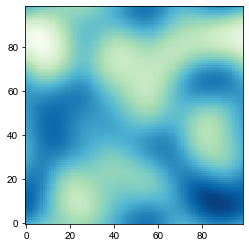

8720 50000 99 0.7040476234631373 -0.011588202323852579
24490.0 25000.0 24490.0 25000.0


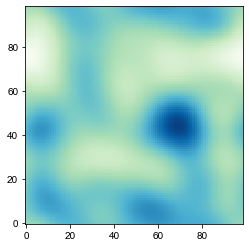

8720 50000 99 0.4717516274276289 0.027720674742179544
24490.0 25000.0 24490.0 25000.0


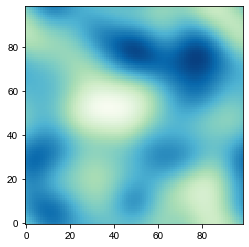

8720 50000 99 0.6509499093223531 -0.09206909247857253
24490.0 25000.0 24490.0 25000.0


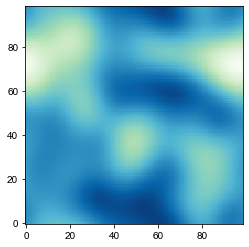

8720 50000 99 0.6304165303809114 -0.122702000562267
24490.0 25000.0 24490.0 25000.0


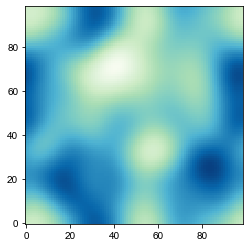

8720 50000 99 0.5376239692080679 0.12970308407653489
24490.0 25000.0 24490.0 25000.0


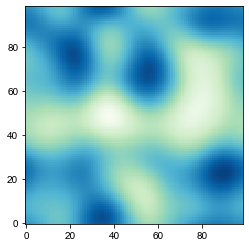

8720 50000 99 0.5722199711626432 -0.22659152098540702
24490.0 25000.0 24490.0 25000.0


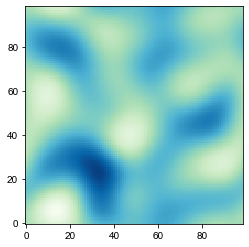

8720 50000 99 0.42480113992514174 0.11362858705853796
24490.0 25000.0 24490.0 25000.0


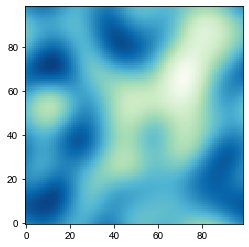

8720 50000 99 0.5143643555636611 0.5246968124856168
24490.0 25000.0 24490.0 25000.0


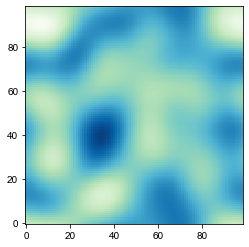

8720 50000 99 0.4433285176967953 -0.06316124071799535
24490.0 25000.0 24490.0 25000.0


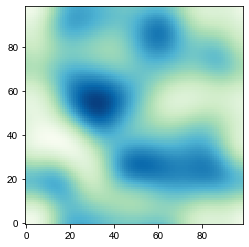

8720 50000 99 0.5880903087659227 0.36205244992159047
24490.0 25000.0 24490.0 25000.0


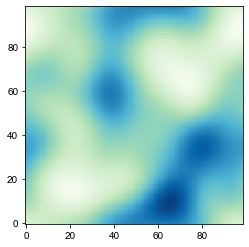

8720 50000 99 0.6638067404471578 -0.19406378346718056
24490.0 25000.0 24490.0 25000.0


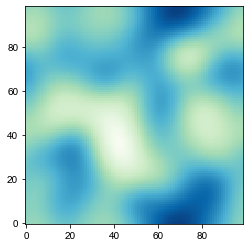

8720 50000 99 0.5839899029246349 -0.05465309836211998
24490.0 25000.0 24490.0 25000.0


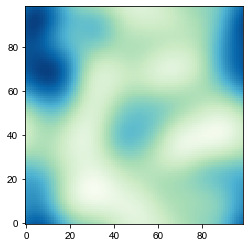

8720 50000 99 0.7633629012932217 0.14560112809684495
24490.0 25000.0 24490.0 25000.0


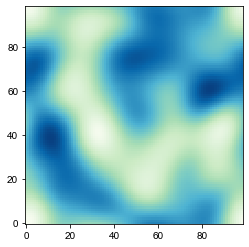

8720 50000 99 0.40584461163942626 -0.0870622990896032
24490.0 25000.0 24490.0 25000.0


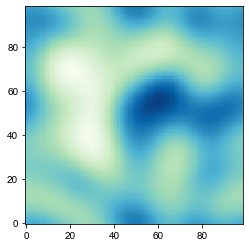

8720 50000 99 0.5982465537530237 0.23185956100350075
24490.0 25000.0 24490.0 25000.0


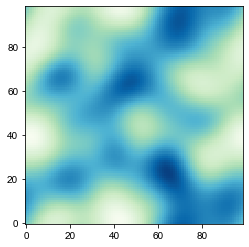

8720 50000 99 0.40229827707028865 -0.16919755733106598
24490.0 25000.0 24490.0 25000.0


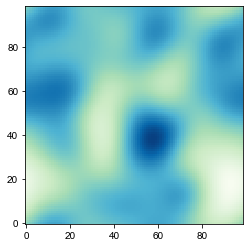

8720 50000 99 0.6101941762902545 -0.11531096254324284
24490.0 25000.0 24490.0 25000.0


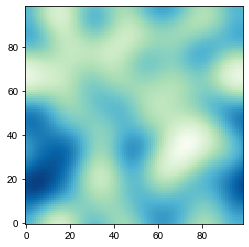

8720 50000 99 0.456867947735388 -0.072877067935565
24490.0 25000.0 24490.0 25000.0


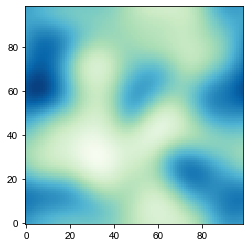

8720 50000 99 0.6515186217167231 0.09115929230161736
24490.0 25000.0 24490.0 25000.0


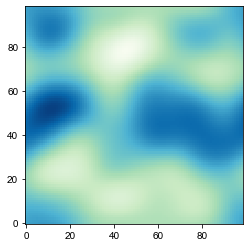

8720 50000 99 0.6407801012316074 0.14277536810675712
24490.0 25000.0 24490.0 25000.0


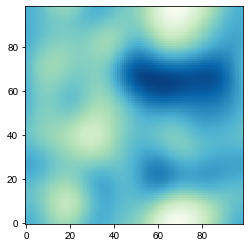

8720 50000 99 0.5453786568791196 0.18803896368072848
24490.0 25000.0 24490.0 25000.0


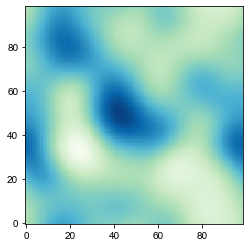

8720 50000 99 0.6217695929821533 0.1256960181518271
24490.0 25000.0 24490.0 25000.0


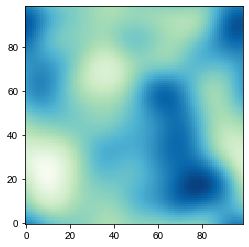

8720 50000 99 0.6195899281983436 -0.00844931041144001
24490.0 25000.0 24490.0 25000.0


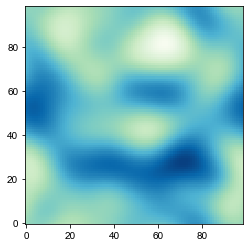

8720 50000 99 0.4159545870384107 -0.08987310488047325
24490.0 25000.0 24490.0 25000.0


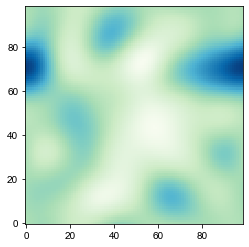

8720 50000 99 0.44396640407556104 -0.052255459114170476
24490.0 25000.0 24490.0 25000.0


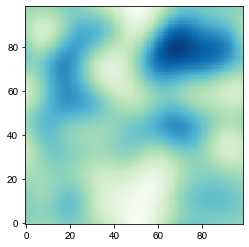

8720 50000 99 0.46658826354590627 0.0009275838261182186
24490.0 25000.0 24490.0 25000.0


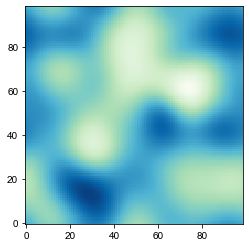

8720 50000 99 0.5595572552759056 0.16937890729591049
24490.0 25000.0 24490.0 25000.0


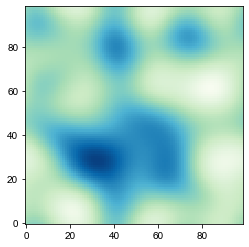

8720 50000 99 0.5312886075834982 -0.20118973839567317
24490.0 25000.0 24490.0 25000.0


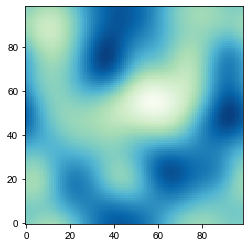

8720 50000 99 0.6343171814615685 -0.12557940506810933
24490.0 25000.0 24490.0 25000.0


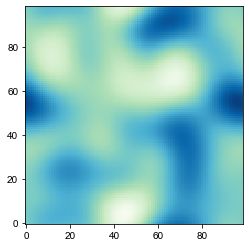

8720 50000 99 0.521514126683322 -0.15275595127123137
24490.0 25000.0 24490.0 25000.0


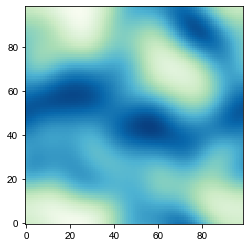

8720 50000 99 0.6730295622537568 0.10810418116273031
24490.0 25000.0 24490.0 25000.0


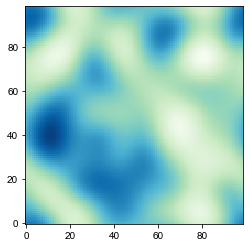

8720 50000 99 0.42492982585723027 0.28453598010661635
24490.0 25000.0 24490.0 25000.0


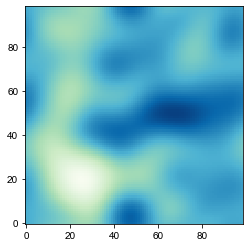

8720 50000 99 0.5008296367604447 -0.017999018875454954
24490.0 25000.0 24490.0 25000.0


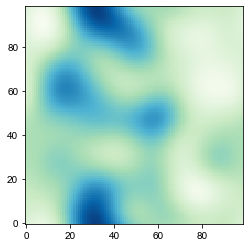

8720 50000 99 0.6194754621665771 -0.36366233708298995
24490.0 25000.0 24490.0 25000.0


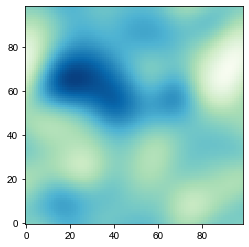

8720 50000 99 0.6323496263341847 -0.009118203051124613
24490.0 25000.0 24490.0 25000.0


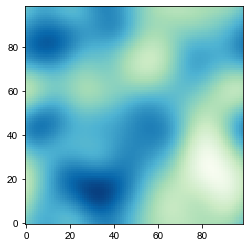

8720 50000 99 0.6069842971170704 -0.048691402884561405
24490.0 25000.0 24490.0 25000.0


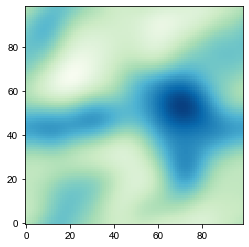

8720 50000 99 0.6198237771987573 -0.05268530630148514
24490.0 25000.0 24490.0 25000.0


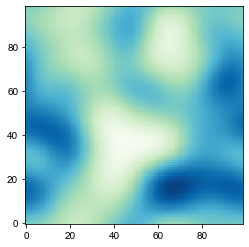

8720 50000 99 0.645116165734798 -0.25350097465707044
24490.0 25000.0 24490.0 25000.0


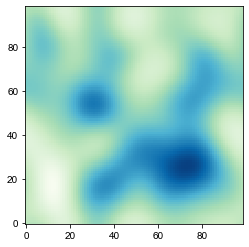

8720 50000 99 0.5001528445774791 0.10247930686997073
24490.0 25000.0 24490.0 25000.0


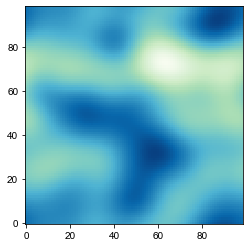

8720 50000 99 0.5931219107300658 -0.27279004924599454
24490.0 25000.0 24490.0 25000.0


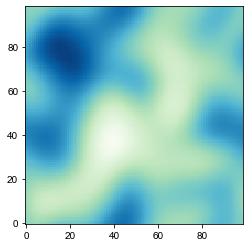

8720 50000 99 0.5791972491746114 0.16860018947202882
24490.0 25000.0 24490.0 25000.0


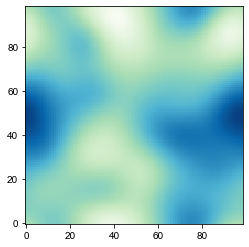

8720 50000 99 0.8708149317943372 -0.17903467693291625
24490.0 25000.0 24490.0 25000.0


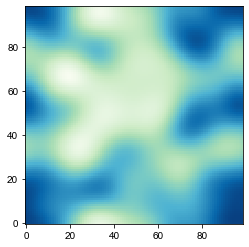

8720 50000 99 0.4335466515789668 0.04818524013889222
24490.0 25000.0 24490.0 25000.0


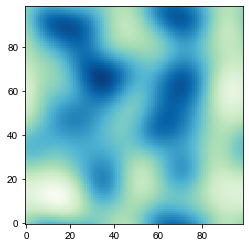

8720 50000 99 0.47273592670164216 -0.15759120234405852
24490.0 25000.0 24490.0 25000.0


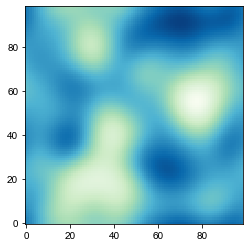

8720 50000 99 0.48546332543534704 0.08598592559254148
24490.0 25000.0 24490.0 25000.0


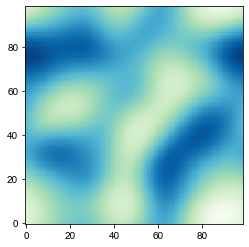

8720 50000 99 0.6044133420838295 0.21880089553323348
24490.0 25000.0 24490.0 25000.0


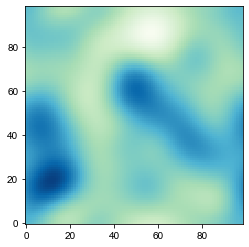

8720 50000 99 0.6414414518058433 0.06539520708575462
24490.0 25000.0 24490.0 25000.0


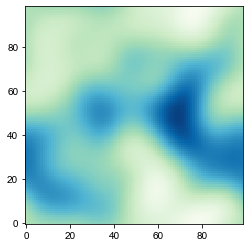

8720 50000 99 0.6155576428052303 0.05906830398047562
24490.0 25000.0 24490.0 25000.0


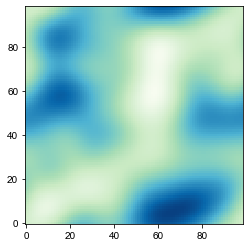

8720 50000 99 0.5916284418455074 0.24798801645751148
24490.0 25000.0 24490.0 25000.0


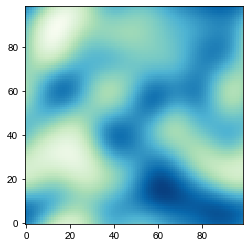

8720 50000 99 0.4700254644133699 -0.2602461247936838
24490.0 25000.0 24490.0 25000.0


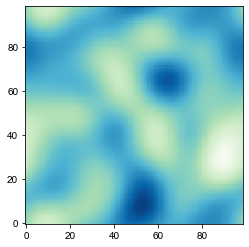

8720 50000 99 0.38998619125260287 -0.11386211858154419
24490.0 25000.0 24490.0 25000.0


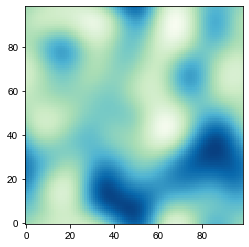

8720 50000 99 0.44595396510911195 -0.05127948290185794
24490.0 25000.0 24490.0 25000.0


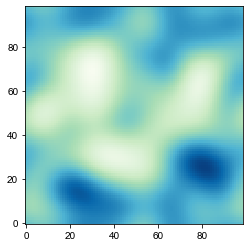

8720 50000 99 0.431797639363906 -0.20270151420948934
24490.0 25000.0 24490.0 25000.0


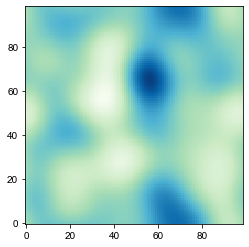

8720 50000 99 0.4755123793819813 -0.34950808084204343
24490.0 25000.0 24490.0 25000.0


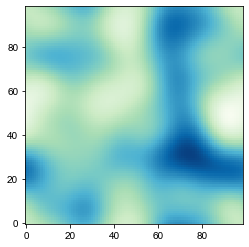

8720 50000 99 0.4685203015370415 -0.1523227676739736
24490.0 25000.0 24490.0 25000.0


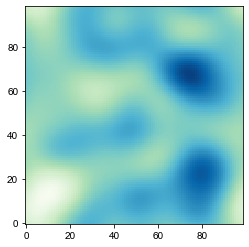

8720 50000 99 0.5383151060491173 -0.027244305512296865
24490.0 25000.0 24490.0 25000.0


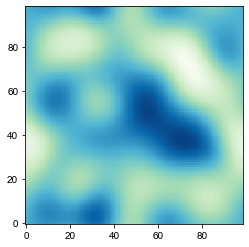

8720 50000 99 0.48541680027675665 -0.21260785515213027
24490.0 25000.0 24490.0 25000.0


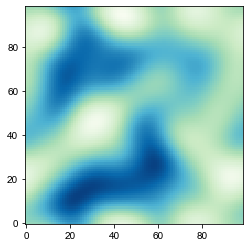

8720 50000 99 0.4555424445567454 0.0695064065272672
24490.0 25000.0 24490.0 25000.0


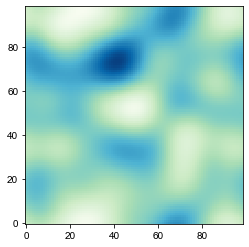

8720 50000 99 0.36515146788426006 0.054936905423669684
24490.0 25000.0 24490.0 25000.0


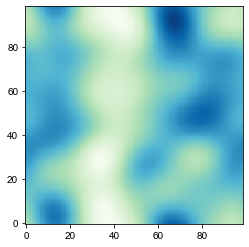

8720 50000 99 0.5390040352981442 -0.03981865864671083
24490.0 25000.0 24490.0 25000.0


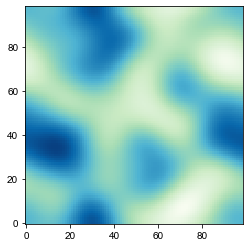

8720 50000 99 0.5238037623341122 0.07022193120124275
24490.0 25000.0 24490.0 25000.0


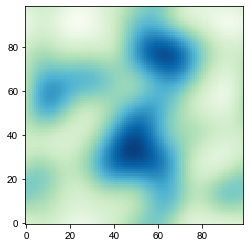

8720 50000 99 0.6723521953409695 -0.14430445913448975
24490.0 25000.0 24490.0 25000.0


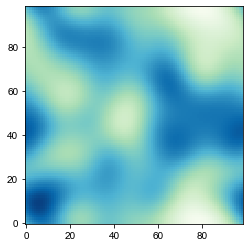

8720 50000 99 0.47497342260718917 0.051799478850156726
24490.0 25000.0 24490.0 25000.0


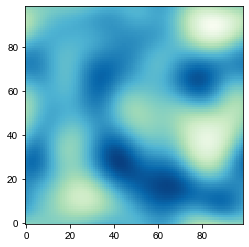

8720 50000 99 0.49772193425513367 0.05373549039621166
24490.0 25000.0 24490.0 25000.0


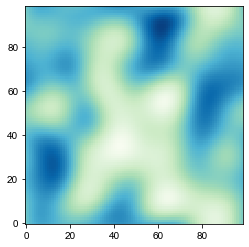

8720 50000 99 0.3650380356497484 0.27448696678674567
24490.0 25000.0 24490.0 25000.0


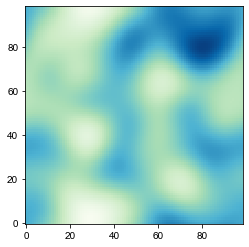

8720 50000 99 0.49417929936491106 -0.05025300619938876
24490.0 25000.0 24490.0 25000.0


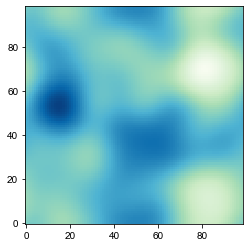

8720 50000 99 0.6147075653375972 0.06848664090730211
24490.0 25000.0 24490.0 25000.0


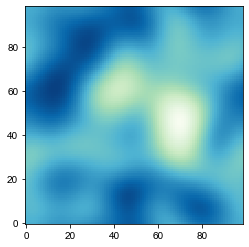

8720 50000 99 0.5997299982032587 0.08811339946180295
24490.0 25000.0 24490.0 25000.0


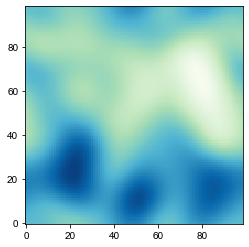

8720 50000 99 0.7384174806883472 0.2554840782552288
24490.0 25000.0 24490.0 25000.0


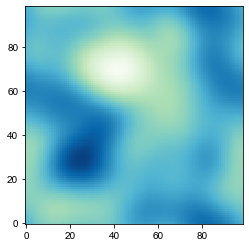

8720 50000 99 0.6337289576364604 -0.5768732047176934
24490.0 25000.0 24490.0 25000.0


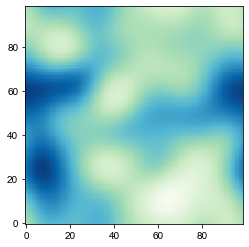

8720 50000 99 0.5207186201135166 -0.12154115552296801
24490.0 25000.0 24490.0 25000.0


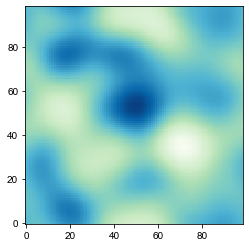

8720 50000 99 0.5448615443212892 0.010808329186465144
24490.0 25000.0 24490.0 25000.0


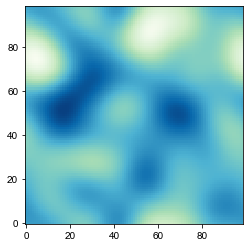

8720 50000 99 0.39136052417256934 0.14407921551896657
24490.0 25000.0 24490.0 25000.0


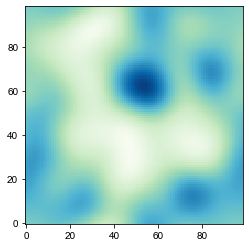

8720 50000 99 0.511772365281814 0.23336221063382154
24490.0 25000.0 24490.0 25000.0


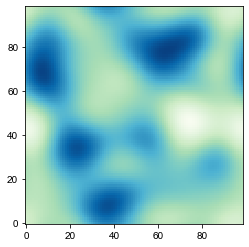

8720 50000 99 0.5123816842691428 -0.28217349316087253
24490.0 25000.0 24490.0 25000.0


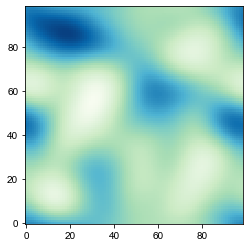

8720 50000 99 0.5382684606709313 0.030479175676940754
24490.0 25000.0 24490.0 25000.0


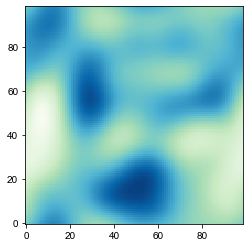

8720 50000 99 0.5692570972112758 -0.008787134121169101
24490.0 25000.0 24490.0 25000.0


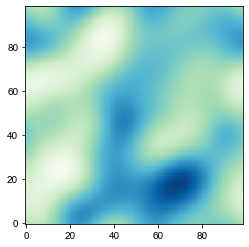

8720 50000 99 0.540437960791916 0.03465255564045406
24490.0 25000.0 24490.0 25000.0


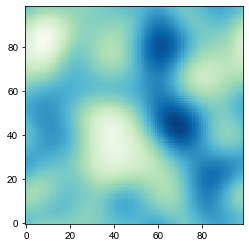

8720 50000 99 0.5276458820429558 0.26639497270621937
24490.0 25000.0 24490.0 25000.0


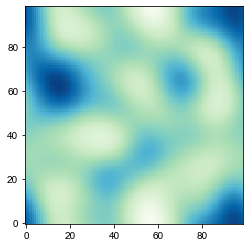

8720 50000 99 0.5030686451393431 -0.20161913349956864
24490.0 25000.0 24490.0 25000.0


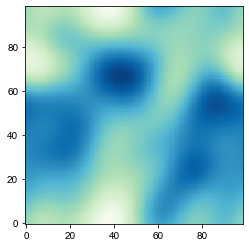

8720 50000 99 0.6966914002524235 0.08675921914920144
24490.0 25000.0 24490.0 25000.0


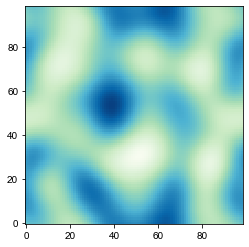

8720 50000 99 0.320789958551581 0.18746170672925963
24490.0 25000.0 24490.0 25000.0


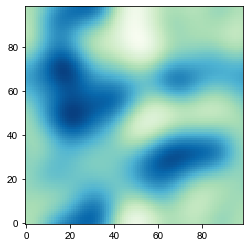

8720 50000 99 0.5089192489665535 0.0026916488209185827
24490.0 25000.0 24490.0 25000.0


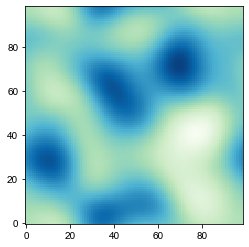

8720 50000 99 0.6427057922739599 0.06378584620396256
24490.0 25000.0 24490.0 25000.0


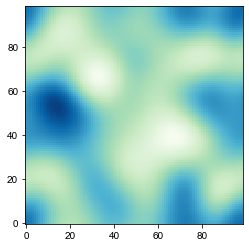

8720 50000 99 0.4632714443836551 -0.01494475528379389
24490.0 25000.0 24490.0 25000.0


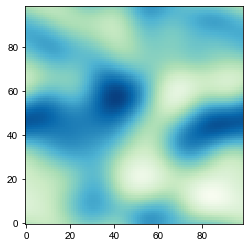

8720 50000 99 0.4899766326096578 0.019730435056104927
24490.0 25000.0 24490.0 25000.0


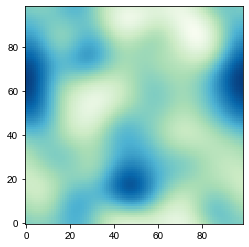

8720 50000 99 0.5031554721668806 -0.27728389558262984
24490.0 25000.0 24490.0 25000.0


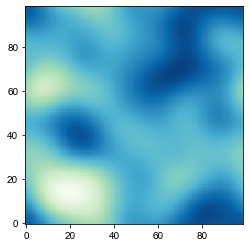

8720 50000 99 0.5074623031824125 -0.11753348870619115
24490.0 25000.0 24490.0 25000.0


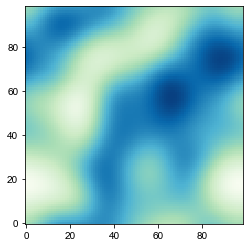

8720 50000 99 0.6649612141081547 0.16999133230505478
24490.0 25000.0 24490.0 25000.0


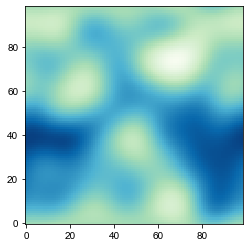

8720 50000 99 0.5162877990084284 -0.09845513585297204
24490.0 25000.0 24490.0 25000.0


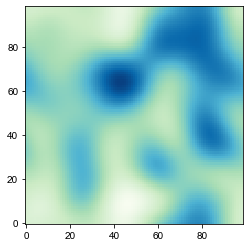

8720 50000 99 0.5062564001830133 0.2062646946320398
24490.0 25000.0 24490.0 25000.0


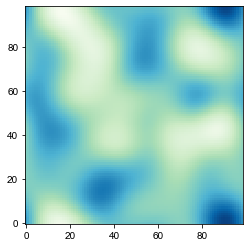

8720 50000 99 0.4287588415669168 0.042583226605004326
24490.0 25000.0 24490.0 25000.0


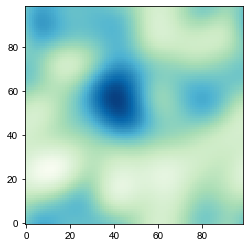

8720 50000 99 0.588702863078056 -0.17698381826367987
24490.0 25000.0 24490.0 25000.0


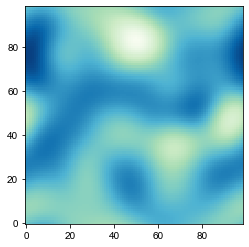

8720 50000 99 0.4679097191541053 0.3528758775980726
24490.0 25000.0 24490.0 25000.0


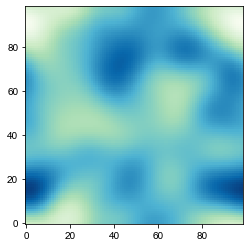

8720 50000 99 0.48467061856649035 -0.10028625403839415
24490.0 25000.0 24490.0 25000.0


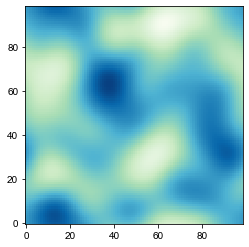

8720 50000 99 0.37317580523067506 -0.07147737148127652
24490.0 25000.0 24490.0 25000.0


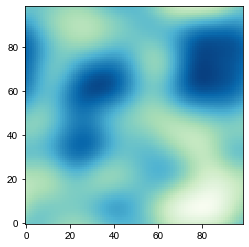

8720 50000 99 0.6880695347199505 -0.14189030404282363
24490.0 25000.0 24490.0 25000.0


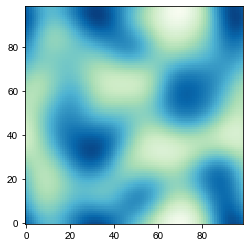

8720 50000 99 0.5251354905582858 0.1801103105238329
24490.0 25000.0 24490.0 25000.0


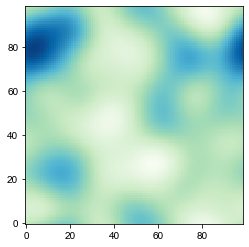

8720 50000 99 0.521782028133654 -0.08347777560935514
24490.0 25000.0 24490.0 25000.0


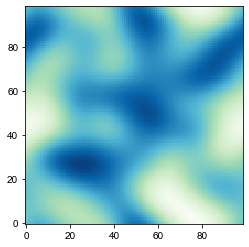

8720 50000 99 0.48630652003963853 0.02480105455272886
24490.0 25000.0 24490.0 25000.0


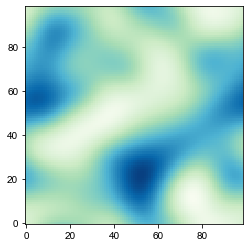

8720 50000 99 0.7545441663186362 -0.14179168356001737
24490.0 25000.0 24490.0 25000.0


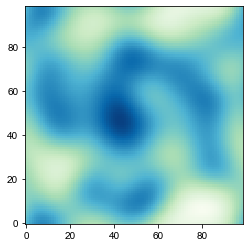

8720 50000 99 0.5452536389008343 0.31031371666696755
24490.0 25000.0 24490.0 25000.0


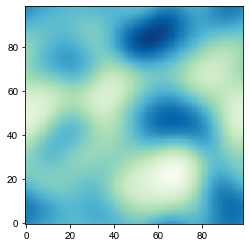

8720 50000 99 0.5584226208011346 0.07805931438074382
24490.0 25000.0 24490.0 25000.0


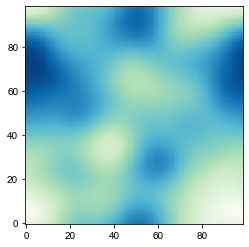

8720 50000 99 0.6231433558685822 0.3771876874534155
24490.0 25000.0 24490.0 25000.0


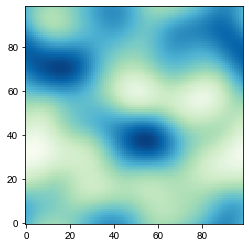

8720 50000 99 0.628210758243059 -0.167042358954351
24490.0 25000.0 24490.0 25000.0


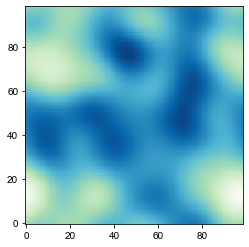

8720 50000 99 0.555622956633948 0.022266248905705693
24490.0 25000.0 24490.0 25000.0


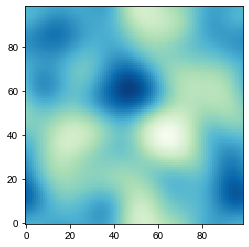

8720 50000 99 0.5419336296947463 -0.0028996072751691837
24490.0 25000.0 24490.0 25000.0


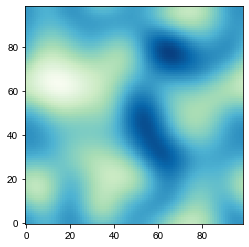

8720 50000 99 0.5028169134558551 0.1998619187483798
24490.0 25000.0 24490.0 25000.0


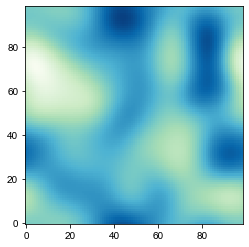

8720 50000 99 0.5041028725132888 0.04637614060670288
24490.0 25000.0 24490.0 25000.0


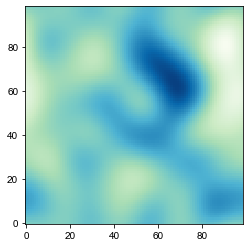

8720 50000 99 0.5080640026700217 0.1771969456649665
24490.0 25000.0 24490.0 25000.0


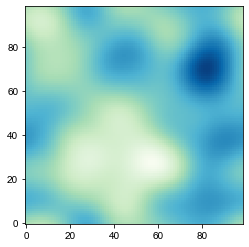

8720 50000 99 0.5962709642015983 -0.32707009783197716
24490.0 25000.0 24490.0 25000.0


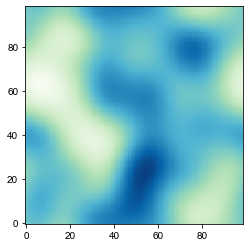

8720 50000 99 0.6403727974389011 0.04868991226421792
24490.0 25000.0 24490.0 25000.0


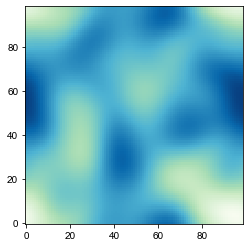

8720 50000 99 0.634320219093612 0.035676379154583465
24490.0 25000.0 24490.0 25000.0


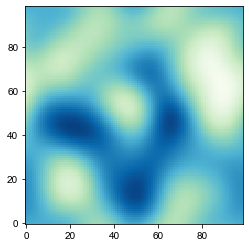

8720 50000 99 0.5216124299361535 -0.21038195713549435
24490.0 25000.0 24490.0 25000.0


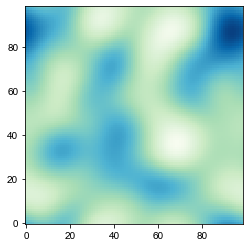

8720 50000 99 0.4974858033503336 0.08884959812563265
24490.0 25000.0 24490.0 25000.0


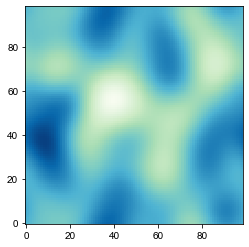

8720 50000 99 0.5140142532914511 -0.031645663807672655
24490.0 25000.0 24490.0 25000.0


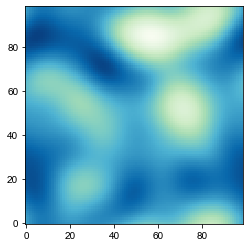

8720 50000 99 0.5063873793726558 -0.07053052953255877
24490.0 25000.0 24490.0 25000.0


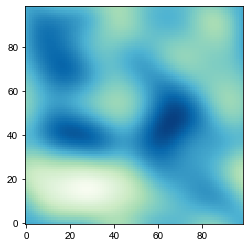

8720 50000 99 0.5763455231671236 0.10024880881844386
24490.0 25000.0 24490.0 25000.0


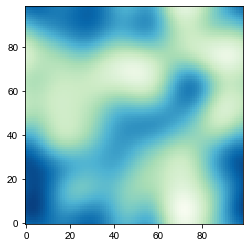

8720 50000 99 0.5767232802006036 0.24943837209427236
24490.0 25000.0 24490.0 25000.0


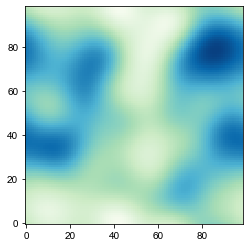

8720 50000 99 0.5928230213994604 -0.08869274287664008
24490.0 25000.0 24490.0 25000.0


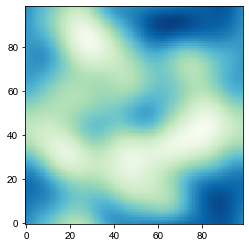

8720 50000 99 0.6266035701601692 0.0027303075348889547
24490.0 25000.0 24490.0 25000.0


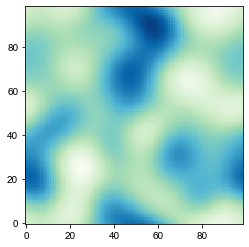

8720 50000 99 0.43843909685260146 -0.09594232741291434
24490.0 25000.0 24490.0 25000.0


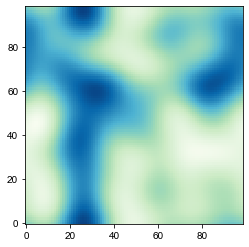

8720 50000 99 0.5166057672529085 0.23716139127744956
24490.0 25000.0 24490.0 25000.0


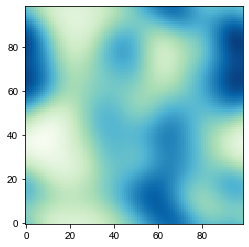

8720 50000 99 0.5869354381528061 0.0338051897732744
24490.0 25000.0 24490.0 25000.0


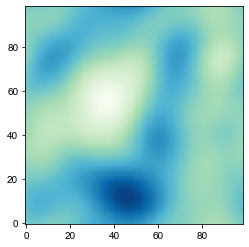

8720 50000 99 0.7378806082924593 -0.19818547709831902
24490.0 25000.0 24490.0 25000.0


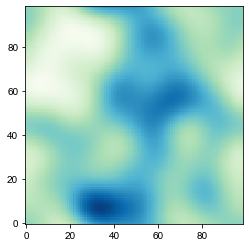

8720 50000 99 0.5327192390366978 0.05855832473644075
24490.0 25000.0 24490.0 25000.0


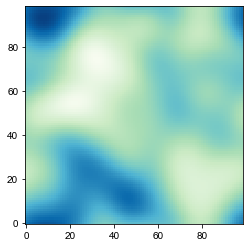

8720 50000 99 0.6524276221665838 0.14374826258927614
24490.0 25000.0 24490.0 25000.0


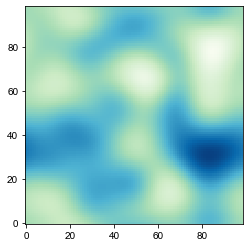

8720 50000 99 0.4541582834450117 0.007852614632882948
24490.0 25000.0 24490.0 25000.0


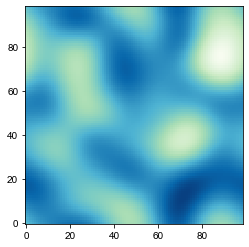

8720 50000 99 0.48840200702655817 -0.06338066424929854
24490.0 25000.0 24490.0 25000.0


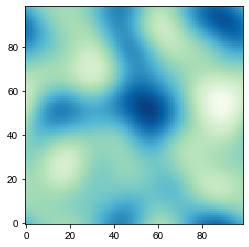

8720 50000 99 0.5697517967802318 -0.08542010678103369
24490.0 25000.0 24490.0 25000.0


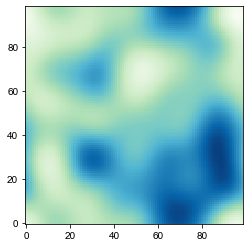

8720 50000 99 0.5200499318932913 0.14701111990704924
24490.0 25000.0 24490.0 25000.0


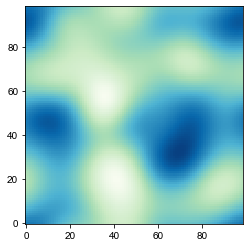

8720 50000 99 0.7128289050828441 0.1185380865551962
24490.0 25000.0 24490.0 25000.0


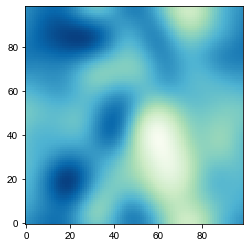

8720 50000 99 0.5516273522477656 -0.0702461782354574
24490.0 25000.0 24490.0 25000.0


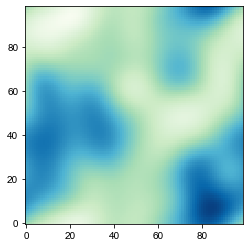

8720 50000 99 0.6430697352272141 0.1739956051246081
24490.0 25000.0 24490.0 25000.0


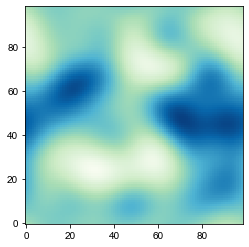

8720 50000 99 0.5446375750466409 -0.04458405296103912
24490.0 25000.0 24490.0 25000.0


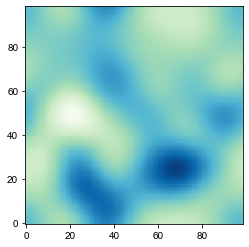

8720 50000 99 0.5084375564629346 -0.19207690392365706
24490.0 25000.0 24490.0 25000.0


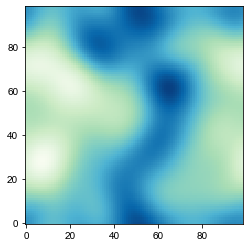

8720 50000 99 0.7531699323134226 -0.14635262517867978
24490.0 25000.0 24490.0 25000.0


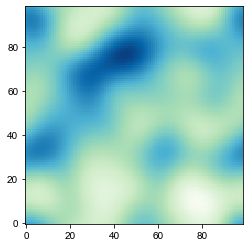

8720 50000 99 0.5225698086826651 -0.17155482117341317
24490.0 25000.0 24490.0 25000.0


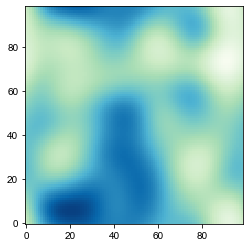

8720 50000 99 0.6347671085131708 0.0772562186293156
24490.0 25000.0 24490.0 25000.0


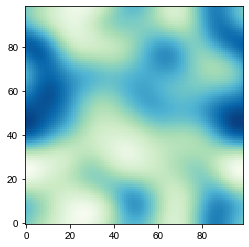

8720 50000 99 0.4512770466596066 -0.4091899235327979
24490.0 25000.0 24490.0 25000.0


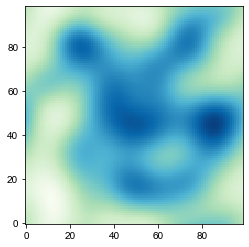

8720 50000 99 0.5388803543853066 -0.3047888150949996
24490.0 25000.0 24490.0 25000.0


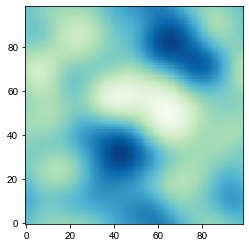

8720 50000 99 0.5740195959634281 -0.06925416700097034
24490.0 25000.0 24490.0 25000.0


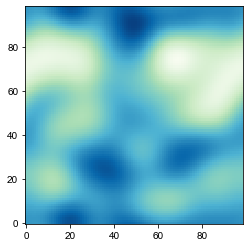

8720 50000 99 0.5320601096020017 -0.23045086488559074
24490.0 25000.0 24490.0 25000.0


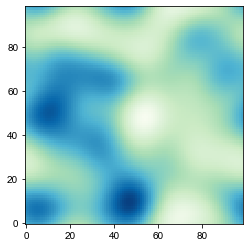

8720 50000 99 0.5478492932455782 -0.12851992122592953
24490.0 25000.0 24490.0 25000.0


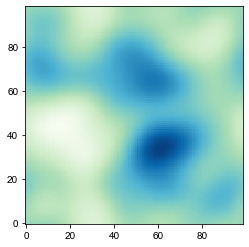

8720 50000 99 0.5342723966161412 -0.4622478707334447
24490.0 25000.0 24490.0 25000.0


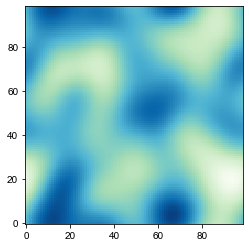

8720 50000 99 0.49957231686257897 0.019957308249455227
24490.0 25000.0 24490.0 25000.0


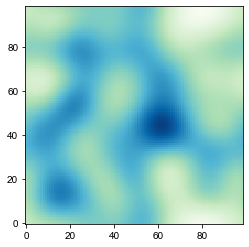

8720 50000 99 0.4800241430710635 0.1574645189218551
24490.0 25000.0 24490.0 25000.0


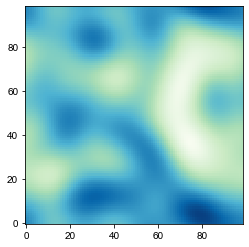

8720 50000 99 0.475634049920708 -0.002436209515814173
24490.0 25000.0 24490.0 25000.0


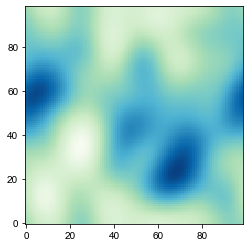

8720 50000 99 0.5266504500938469 0.02630876952716574
24490.0 25000.0 24490.0 25000.0


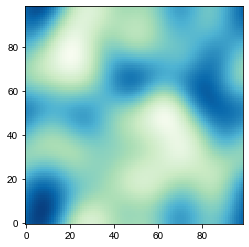

8720 50000 99 0.6086250802006823 0.023876619185539107
24490.0 25000.0 24490.0 25000.0


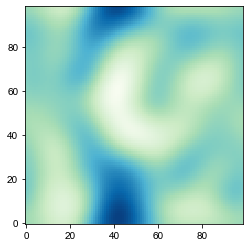

8720 50000 99 0.5473954369162192 -0.1816854435012578
24490.0 25000.0 24490.0 25000.0


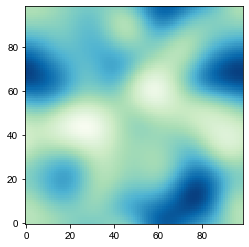

8720 50000 99 0.5538087800432058 -0.4102925812791745
24490.0 25000.0 24490.0 25000.0


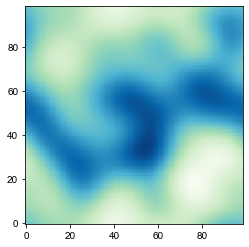

8720 50000 99 0.6710351952590766 0.31928350483522655
24490.0 25000.0 24490.0 25000.0


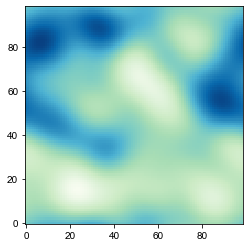

8720 50000 99 0.5539511685386849 0.09199788380989872
24490.0 25000.0 24490.0 25000.0


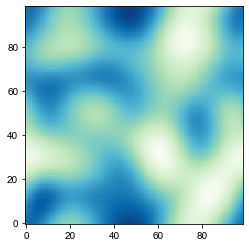

8720 50000 99 0.5369998432693689 0.11710703350355854
24490.0 25000.0 24490.0 25000.0


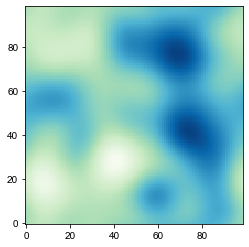

8720 50000 99 0.5972332550051559 -0.22093749477853303
24490.0 25000.0 24490.0 25000.0


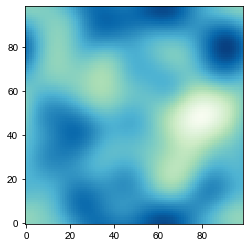

8720 50000 99 0.5239367229982624 0.1272509340163797
24490.0 25000.0 24490.0 25000.0


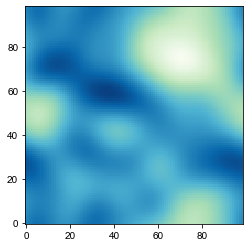

8720 50000 99 0.5698809113102253 0.39838481996040903
24490.0 25000.0 24490.0 25000.0


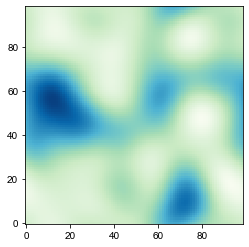

8720 50000 99 0.518125283024157 0.015569347885676299
24490.0 25000.0 24490.0 25000.0


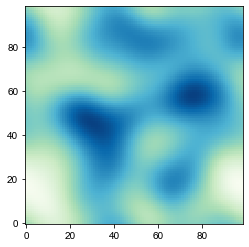

8720 50000 99 0.489911393462913 0.14741932484523948
24490.0 25000.0 24490.0 25000.0


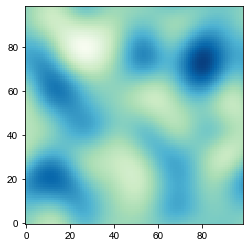

8720 50000 99 0.4396749385339057 0.03114208499705888
24490.0 25000.0 24490.0 25000.0


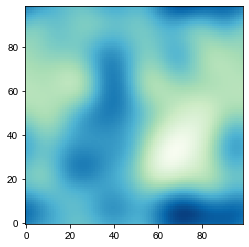

8720 50000 99 0.540262342732463 0.42986064053099476
24490.0 25000.0 24490.0 25000.0


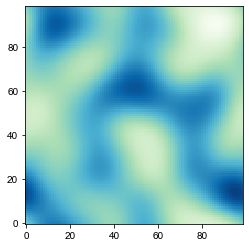

8720 50000 99 0.5412899630213357 0.09547610318848396
24490.0 25000.0 24490.0 25000.0


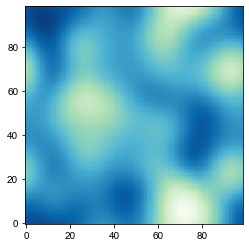

8720 50000 99 0.42822863579151627 -0.16941076346886566
24490.0 25000.0 24490.0 25000.0


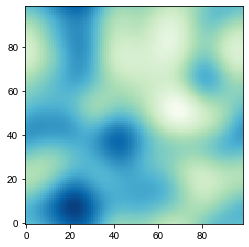

8720 50000 99 0.5409943350964866 -0.2776301394731476
24490.0 25000.0 24490.0 25000.0


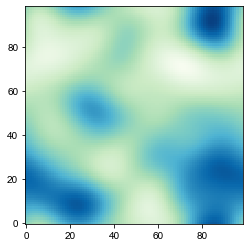

8720 50000 99 0.590547992584279 -0.17134360973542273
24490.0 25000.0 24490.0 25000.0


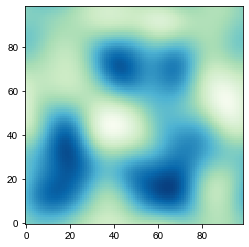

8720 50000 99 0.5352504500592782 0.10345953058084947
24490.0 25000.0 24490.0 25000.0


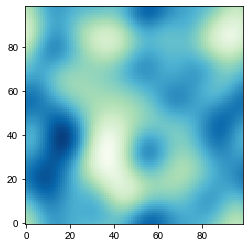

8720 50000 99 0.44298576336951984 0.37725506504441053
24490.0 25000.0 24490.0 25000.0


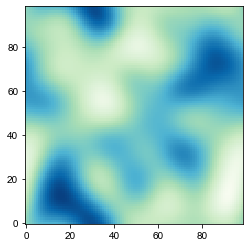

8720 50000 99 0.43246785508685526 -0.07540857566068847
24490.0 25000.0 24490.0 25000.0


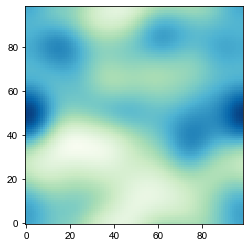

8720 50000 99 0.6656095700155515 -0.1847661734702512
24490.0 25000.0 24490.0 25000.0


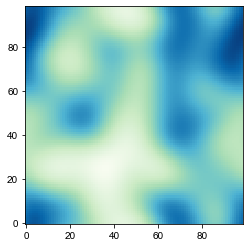

8720 50000 99 0.5982486193116884 -0.13699661801274715
24490.0 25000.0 24490.0 25000.0


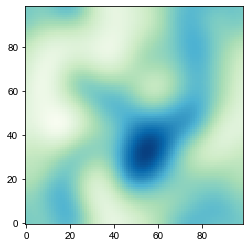

8720 50000 99 0.5786786203531568 -0.0034188251940182462
24490.0 25000.0 24490.0 25000.0


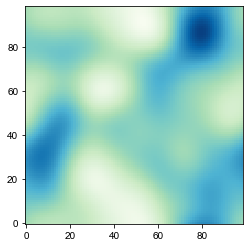

8720 50000 99 0.6072339684411527 0.01974851611183874
24490.0 25000.0 24490.0 25000.0


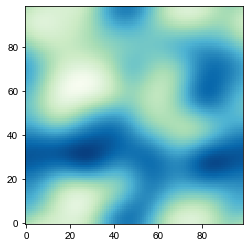

8720 50000 99 0.6228071293319444 0.28896449024626775
24490.0 25000.0 24490.0 25000.0


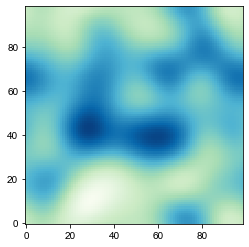

8720 50000 99 0.5019325962855168 0.05274838724511549
24490.0 25000.0 24490.0 25000.0


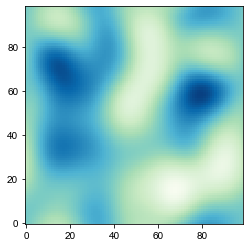

8720 50000 99 0.5380335649799248 0.10497773573047392
24490.0 25000.0 24490.0 25000.0


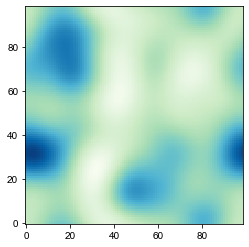

8720 50000 99 0.5030296302462083 -0.10467201819956203
24490.0 25000.0 24490.0 25000.0


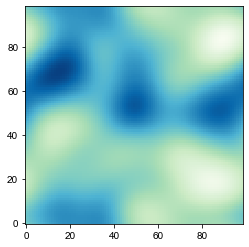

8720 50000 99 0.6615154971258049 0.013327457628424234
24490.0 25000.0 24490.0 25000.0


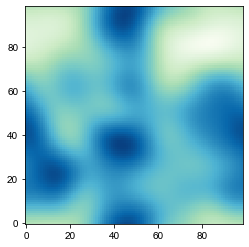

8720 50000 99 0.6151492655602135 0.011659469547918008
24490.0 25000.0 24490.0 25000.0


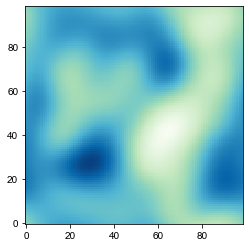

8720 50000 99 0.5805128407329537 0.25453782050797136
24490.0 25000.0 24490.0 25000.0


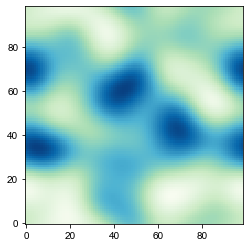

8720 50000 99 0.4524213602924254 0.13487283865943966
24490.0 25000.0 24490.0 25000.0


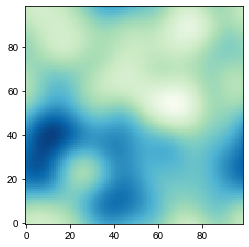

8720 50000 99 0.7366156262261018 -0.10706778617767368
24490.0 25000.0 24490.0 25000.0


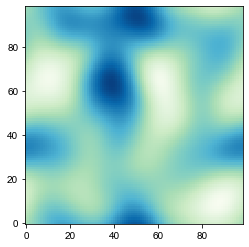

8720 50000 99 0.5463507330602497 0.301331679561792
24490.0 25000.0 24490.0 25000.0


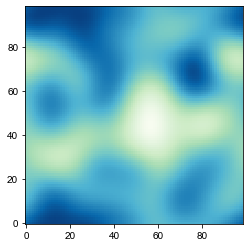

8720 50000 99 0.517161492144802 -0.32305795799412496
24490.0 25000.0 24490.0 25000.0


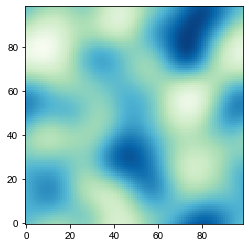

8720 50000 99 0.4880655118569163 -0.06738077544170472
24490.0 25000.0 24490.0 25000.0


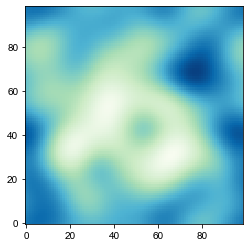

8720 50000 99 0.553096710745464 0.20010073229287825
24490.0 25000.0 24490.0 25000.0


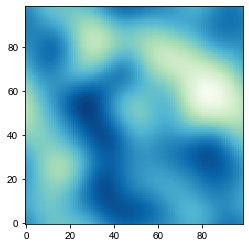

8720 50000 99 0.58007409415062 -0.04879526196252121
24490.0 25000.0 24490.0 25000.0


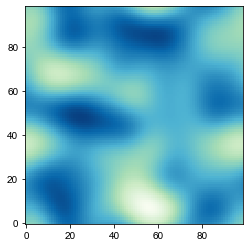

8720 50000 99 0.4068852697763228 -0.07872146734636498
24490.0 25000.0 24490.0 25000.0


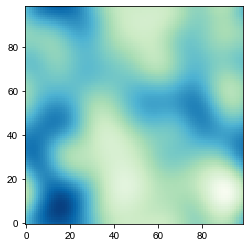

8720 50000 99 0.5728622357261193 0.013776508272918262
24490.0 25000.0 24490.0 25000.0


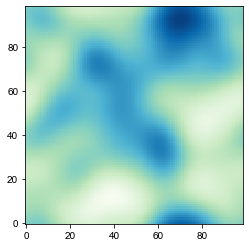

8720 50000 99 0.524731067030925 0.1269331576653702
24490.0 25000.0 24490.0 25000.0


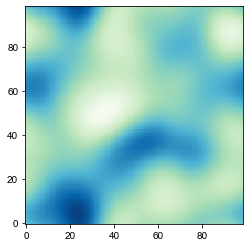

8720 50000 99 0.5375895344794783 0.29430667666425453
24490.0 25000.0 24490.0 25000.0


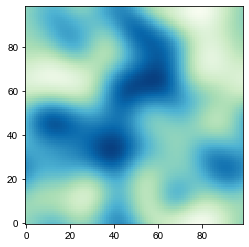

8720 50000 99 0.5186959251114277 0.05979790518835221
24490.0 25000.0 24490.0 25000.0


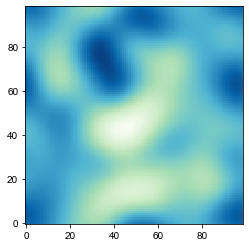

8720 50000 99 0.45641694804559 -0.4935023005215497
24490.0 25000.0 24490.0 25000.0


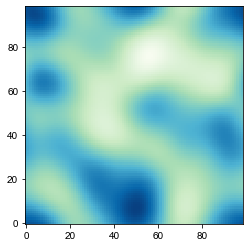

8720 50000 99 0.47296066975330603 -0.3537888938293778
24490.0 25000.0 24490.0 25000.0


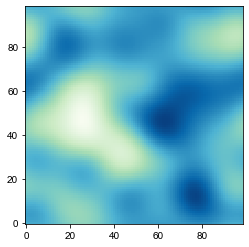

8720 50000 99 0.5605354985850791 -0.13548866271122145
24490.0 25000.0 24490.0 25000.0


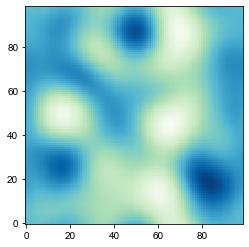

8720 50000 99 0.49264143979975533 0.07708607316602162
24490.0 25000.0 24490.0 25000.0


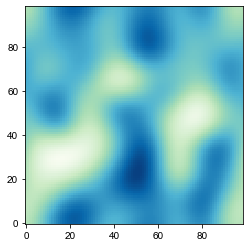

8720 50000 99 0.4081035842827925 -0.5038000873315674
24490.0 25000.0 24490.0 25000.0


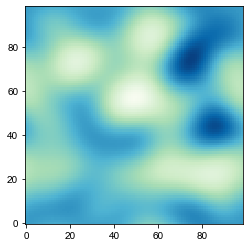

8720 50000 99 0.48209605375552184 0.02478679743054527
24490.0 25000.0 24490.0 25000.0


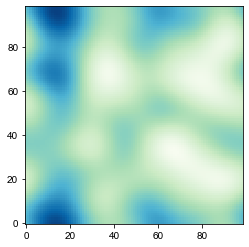

8720 50000 99 0.5170105916813139 0.030823126283957218
24490.0 25000.0 24490.0 25000.0


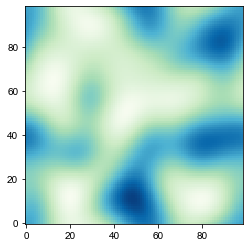

8720 50000 99 0.566210266167254 0.11837473112710983
24490.0 25000.0 24490.0 25000.0


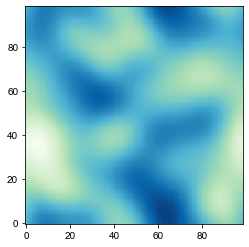

8720 50000 99 0.5307984400273217 -0.3020866262778364
24490.0 25000.0 24490.0 25000.0


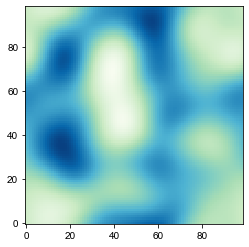

8720 50000 99 0.5465898977796212 0.1552289779053093
24490.0 25000.0 24490.0 25000.0


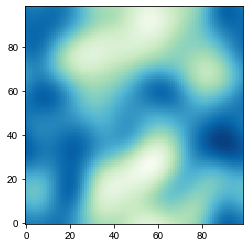

8720 50000 99 0.5415274899428201 -0.006678786012076496
24490.0 25000.0 24490.0 25000.0


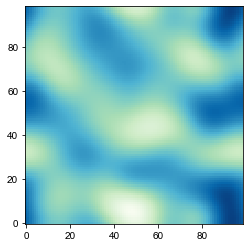

8720 50000 99 0.4757359522876655 0.19701987073538274
24490.0 25000.0 24490.0 25000.0


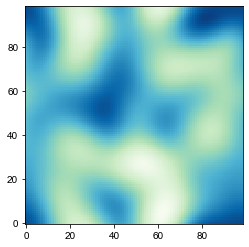

8720 50000 99 0.5419986675618658 -0.27214884020564517
24490.0 25000.0 24490.0 25000.0


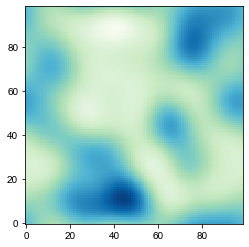

8720 50000 99 0.4751655166867286 0.016484116100937383
24490.0 25000.0 24490.0 25000.0


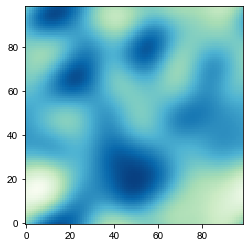

8720 50000 99 0.47080201573431024 0.03877313624724601
24490.0 25000.0 24490.0 25000.0


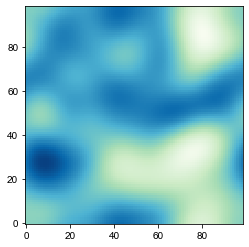

8720 50000 99 0.6512775161534594 -0.1313443294005758
24490.0 25000.0 24490.0 25000.0


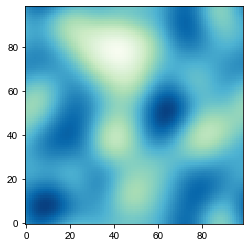

8720 50000 99 0.5066351983211727 0.07069736294546373
24490.0 25000.0 24490.0 25000.0


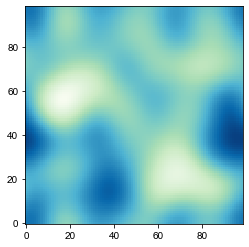

8720 50000 99 0.590338176552585 0.21006725938009232
24490.0 25000.0 24490.0 25000.0


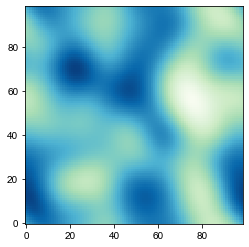

8720 50000 99 0.536886785814695 -0.3871314862973063
24490.0 25000.0 24490.0 25000.0


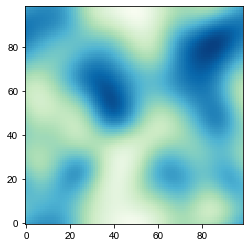

8720 50000 99 0.5561045756222435 0.1895818564437274
24490.0 25000.0 24490.0 25000.0


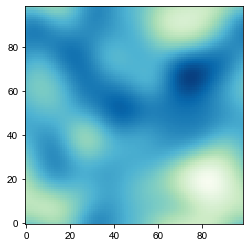

8720 50000 99 0.5226769756455286 -0.14497759276228914
24490.0 25000.0 24490.0 25000.0


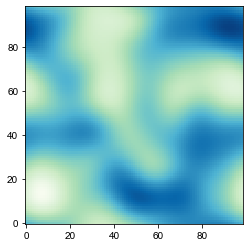

8720 50000 99 0.49239713766428134 -0.005098411505798931
24490.0 25000.0 24490.0 25000.0


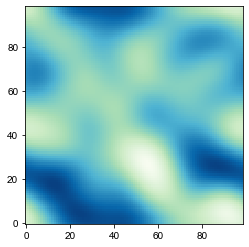

8720 50000 99 0.512083650991287 0.18585701940685284
24490.0 25000.0 24490.0 25000.0


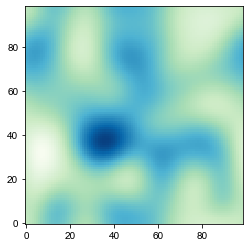

8720 50000 99 0.47637089844062735 0.008978083297090779
24490.0 25000.0 24490.0 25000.0


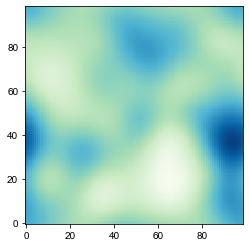

8720 50000 99 0.4908023852876292 -0.061574038787782844
24490.0 25000.0 24490.0 25000.0


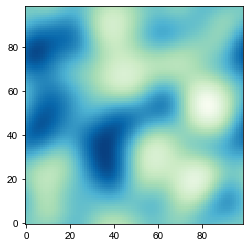

8720 50000 99 0.40415676048756133 0.5667428542537354
24490.0 25000.0 24490.0 25000.0


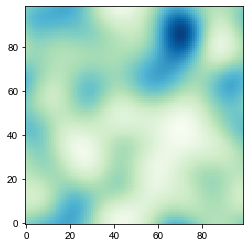

8720 50000 99 0.4342156171455016 0.05405844560550283
24490.0 25000.0 24490.0 25000.0


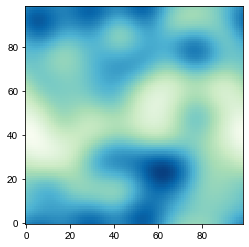

8720 50000 99 0.5253652024358674 -0.4225356855143323
24490.0 25000.0 24490.0 25000.0


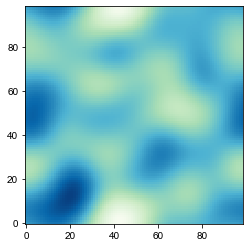

8720 50000 99 0.5264108605049722 0.012608184775031209
24490.0 25000.0 24490.0 25000.0


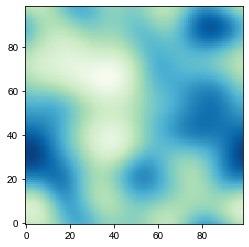

8720 50000 99 0.6018096090581238 -0.08466019335464245
24490.0 25000.0 24490.0 25000.0


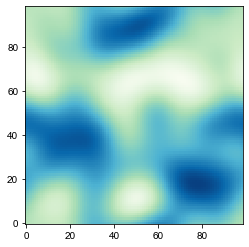

8720 50000 99 0.5611371647706239 -0.34391685271965
24490.0 25000.0 24490.0 25000.0


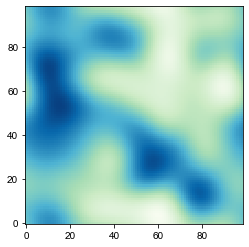

8720 50000 99 0.4620996468222559 0.11486551529490518
24490.0 25000.0 24490.0 25000.0


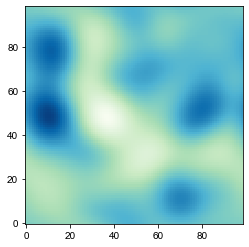

8720 50000 99 0.470763000677383 0.05092832453114081
24490.0 25000.0 24490.0 25000.0


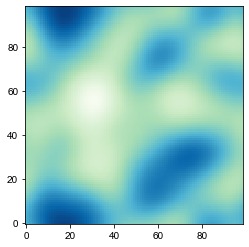

8720 50000 99 0.6162237818658186 -0.09585850432588312
24490.0 25000.0 24490.0 25000.0


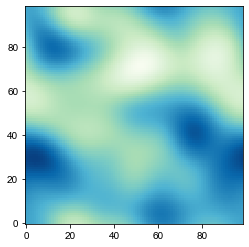

8720 50000 99 0.6109041704877367 -0.1557071239752929
24490.0 25000.0 24490.0 25000.0


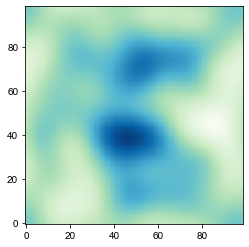

8720 50000 99 0.4995535308120906 0.06391777269979992
24490.0 25000.0 24490.0 25000.0


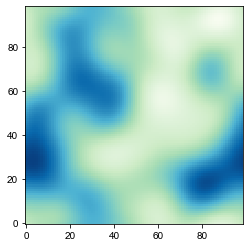

8720 50000 99 0.7345899528893143 -0.1305763990049747
24490.0 25000.0 24490.0 25000.0


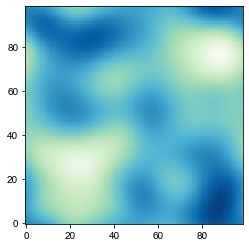

8720 50000 99 0.5526711110837482 -0.3613682194177662
24490.0 25000.0 24490.0 25000.0


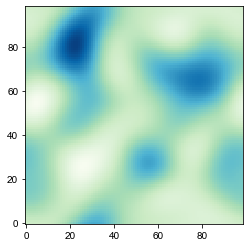

8720 50000 99 0.4920299528847152 0.29540764012143456
24490.0 25000.0 24490.0 25000.0


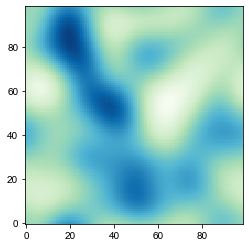

8720 50000 99 0.4893322637841823 -0.032260518756714665
24490.0 25000.0 24490.0 25000.0


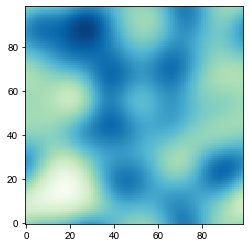

8720 50000 99 0.5707753394640589 -0.3802277683661474
24490.0 25000.0 24490.0 25000.0


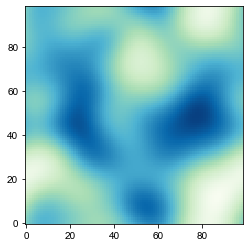

8720 50000 99 0.8658204077349517 0.04728388237017443
24490.0 25000.0 24490.0 25000.0


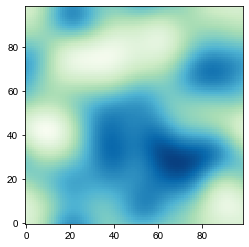

8720 50000 99 0.6285992760687 0.2640190755037261
24490.0 25000.0 24490.0 25000.0


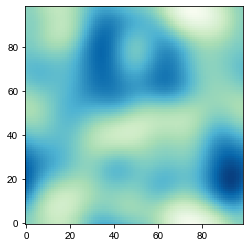

8720 50000 99 0.41543245113722593 -0.02227466799746842
24490.0 25000.0 24490.0 25000.0


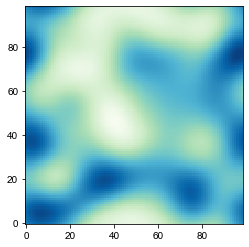

8720 50000 99 0.5054194193228478 -0.26904594106073565
24490.0 25000.0 24490.0 25000.0


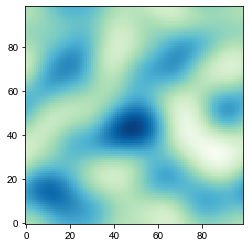

8720 50000 99 0.4471978706686621 0.056896438606116845
24490.0 25000.0 24490.0 25000.0


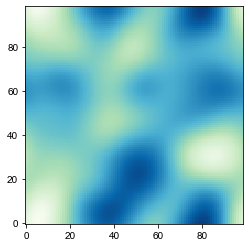

8720 50000 99 0.6329877745396537 -0.0949589671183614
24490.0 25000.0 24490.0 25000.0


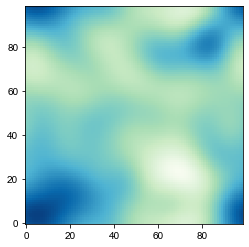

8720 50000 99 0.5519520677002385 0.26343233351723194
24490.0 25000.0 24490.0 25000.0


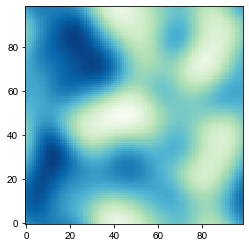

8720 50000 99 0.44550242370112475 -0.035736086362316434
24490.0 25000.0 24490.0 25000.0


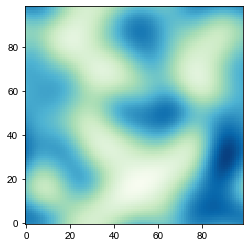

8720 50000 99 0.47894252272363763 0.13438232024105978
24490.0 25000.0 24490.0 25000.0


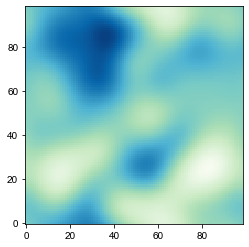

8720 50000 99 0.6254510708210247 -0.05273246415006994
24490.0 25000.0 24490.0 25000.0


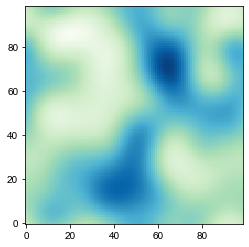

8720 50000 99 0.5152450059040108 0.05743152894959671
24490.0 25000.0 24490.0 25000.0


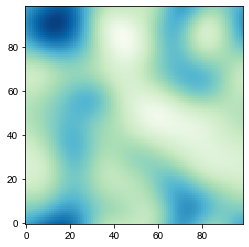

8720 50000 99 0.6039432599588997 -0.20128917527149812
24490.0 25000.0 24490.0 25000.0


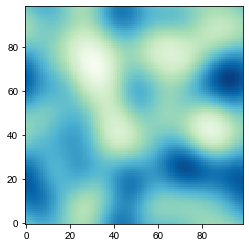

8720 50000 99 0.48014533762111106 -0.045329180974676656
24490.0 25000.0 24490.0 25000.0


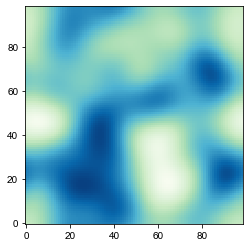

8720 50000 99 0.4404166459228592 0.030900175254023124
24490.0 25000.0 24490.0 25000.0


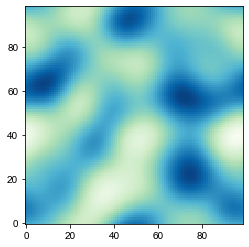

8720 50000 99 0.4731125395915079 -0.10647221537215805
24490.0 25000.0 24490.0 25000.0


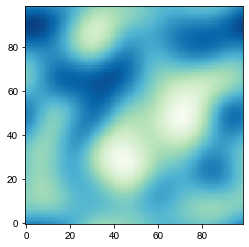

8720 50000 99 0.502577006749904 -0.1641754201422029
24490.0 25000.0 24490.0 25000.0


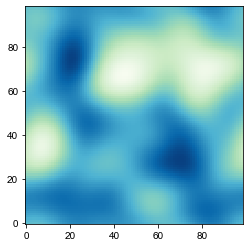

8720 50000 99 0.5016208374831228 -0.14570934389359613
24490.0 25000.0 24490.0 25000.0


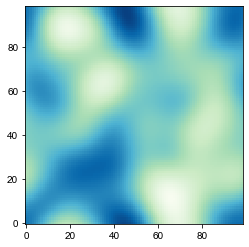

8720 50000 99 0.5014259906200335 0.2507272374188579
24490.0 25000.0 24490.0 25000.0


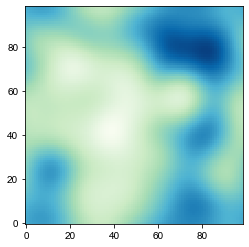

8720 50000 99 0.642857246019852 -0.03391734330723734
24490.0 25000.0 24490.0 25000.0


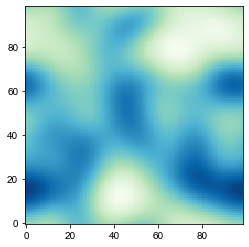

8720 50000 99 0.5733578218020164 0.024596418793366544
24490.0 25000.0 24490.0 25000.0


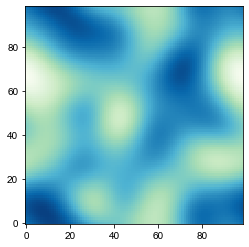

8720 50000 99 0.6409502717876784 0.0397845422010137
24490.0 25000.0 24490.0 25000.0


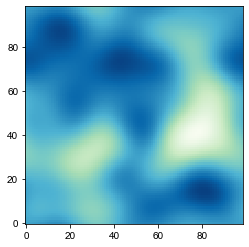

8720 50000 99 0.6430958206667022 -0.3978572308712448
24490.0 25000.0 24490.0 25000.0


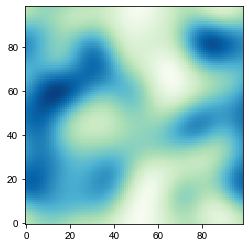

8720 50000 99 0.6380227216137146 -0.25906783993870874
24490.0 25000.0 24490.0 25000.0


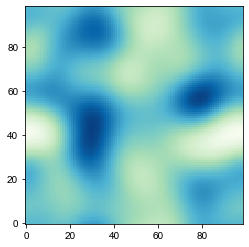

8720 50000 99 0.49958147578942724 -0.11445031886611026
24490.0 25000.0 24490.0 25000.0


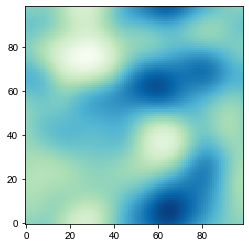

8720 50000 99 0.5506621265654873 -0.0254177868301596
24490.0 25000.0 24490.0 25000.0


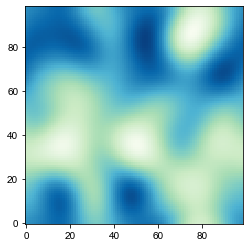

8720 50000 99 0.5189088289690197 -0.03249275574799989
24490.0 25000.0 24490.0 25000.0


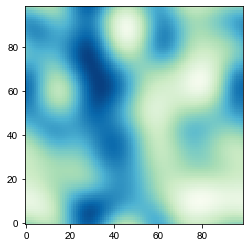

8720 50000 99 0.46353893692078324 0.23041610951832087
24490.0 25000.0 24490.0 25000.0


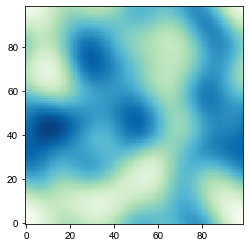

8720 50000 99 0.5460231494623276 -0.012649359022945316
24490.0 25000.0 24490.0 25000.0


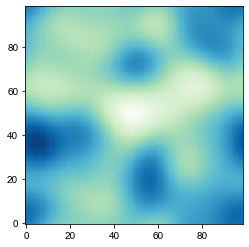

8720 50000 99 0.5883050986783811 -0.07728291220782808
24490.0 25000.0 24490.0 25000.0


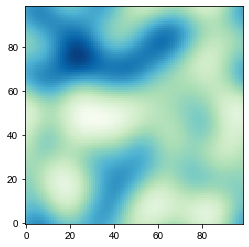

8720 50000 99 0.5897655776728626 -0.44127588168472354
24490.0 25000.0 24490.0 25000.0


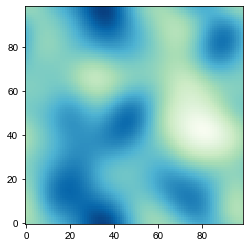

8720 50000 99 0.6483009382966198 0.01154591797402012
24490.0 25000.0 24490.0 25000.0


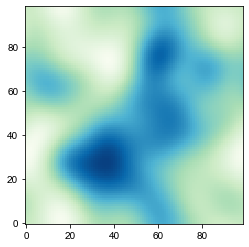

8720 50000 99 0.6332695238485915 0.22277972634450507
24490.0 25000.0 24490.0 25000.0


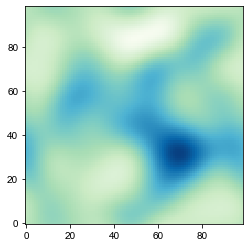

8720 50000 99 0.5119121598063279 -0.07646313545533526
24490.0 25000.0 24490.0 25000.0


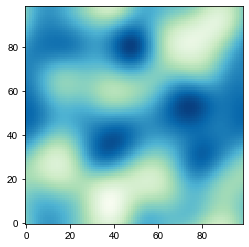

8720 50000 99 0.590957298320645 0.29635911710574037
24490.0 25000.0 24490.0 25000.0


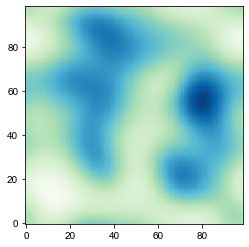

8720 50000 99 0.5768717261089247 -0.19919421843860402
24490.0 25000.0 24490.0 25000.0


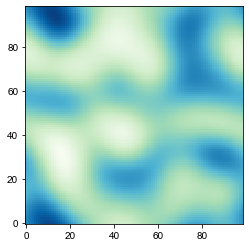

8720 50000 99 0.4546350887641455 -0.18272878315543228
24490.0 25000.0 24490.0 25000.0


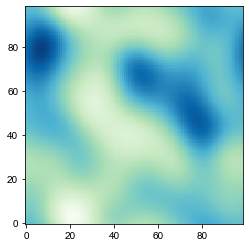

8720 50000 99 0.5867524615211255 -0.14815302637962105
24490.0 25000.0 24490.0 25000.0


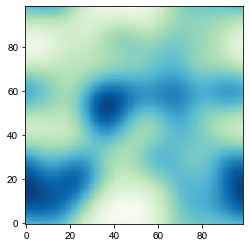

8720 50000 99 0.7030049412538661 -0.12263888723583247
24490.0 25000.0 24490.0 25000.0


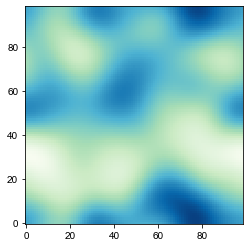

8720 50000 99 0.590515927892062 0.0737103903943094
24490.0 25000.0 24490.0 25000.0


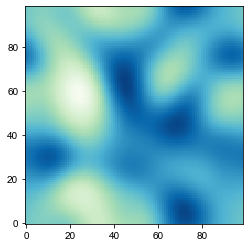

8720 50000 99 0.47780740170534 -0.22653919518208218
24490.0 25000.0 24490.0 25000.0


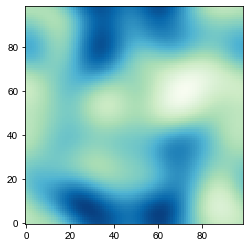

8720 50000 99 0.6177488326133438 -0.34177659093995866
24490.0 25000.0 24490.0 25000.0


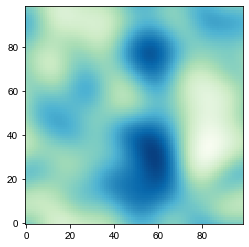

8720 50000 99 0.46357971854834845 0.12235372838381624
24490.0 25000.0 24490.0 25000.0


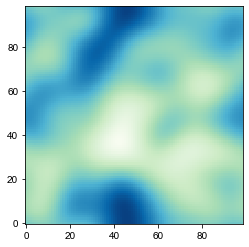

8720 50000 99 0.45256345069187665 0.031362395098754416
24490.0 25000.0 24490.0 25000.0


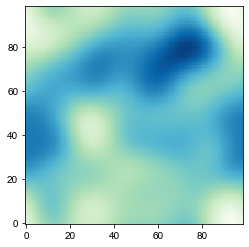

8720 50000 99 0.6090431305274506 0.08311600196945099
24490.0 25000.0 24490.0 25000.0


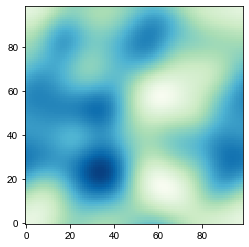

8720 50000 99 0.6955864347757932 -0.077366393875318
24490.0 25000.0 24490.0 25000.0


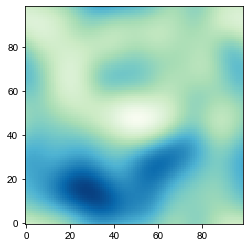

8720 50000 99 0.5642545453167024 -0.008237036031393516
24490.0 25000.0 24490.0 25000.0


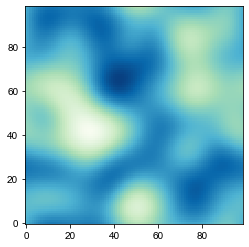

8720 50000 99 0.42523492694137405 0.03879022840111759
24490.0 25000.0 24490.0 25000.0


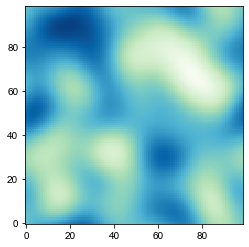

8720 50000 99 0.47540743797188334 0.07430121770944687
24490.0 25000.0 24490.0 25000.0


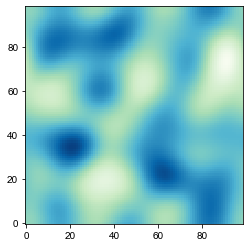

8720 50000 99 0.3150606042046231 -0.1305190447425221
24490.0 25000.0 24490.0 25000.0


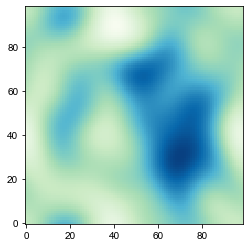

8720 50000 99 0.5596493033770679 0.03694338092858735
24490.0 25000.0 24490.0 25000.0


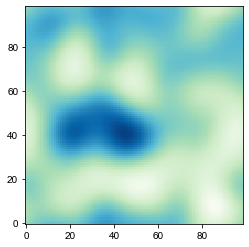

8720 50000 99 0.44467197763102884 0.17974542493820633
24490.0 25000.0 24490.0 25000.0


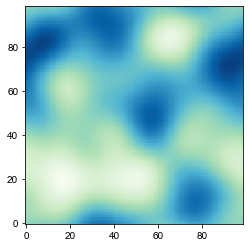

8720 50000 99 0.5322939329489128 0.20926468229088172
24490.0 25000.0 24490.0 25000.0


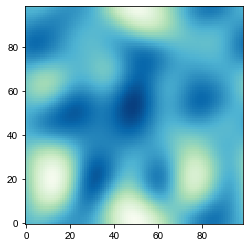

8720 50000 99 0.48483414936754554 -0.10769613255128847
24490.0 25000.0 24490.0 25000.0


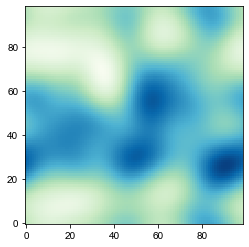

8720 50000 99 0.5776806324083149 -0.013462954506870253
24490.0 25000.0 24490.0 25000.0


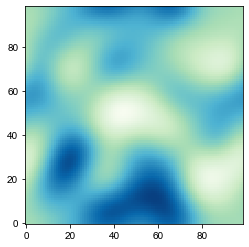

8720 50000 99 0.6257348513464662 0.046409017039812636
24490.0 25000.0 24490.0 25000.0


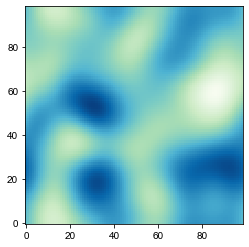

8720 50000 99 0.47477924870212124 -0.010637798998414173
24490.0 25000.0 24490.0 25000.0


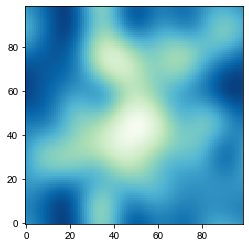

8720 50000 99 0.5782749640424563 0.07662219204221973
24490.0 25000.0 24490.0 25000.0


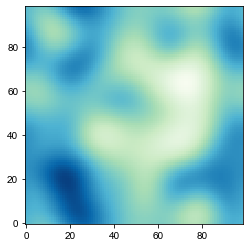

8720 50000 99 0.5344025781623504 -0.11348465408763575
24490.0 25000.0 24490.0 25000.0


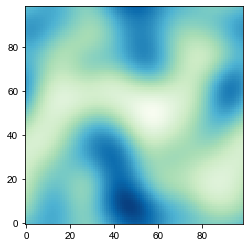

8720 50000 99 0.662001862229178 0.11141021734065731
24490.0 25000.0 24490.0 25000.0


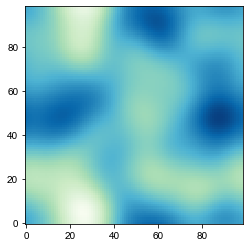

8720 50000 99 0.6141797398330662 -0.1375109328665003
24490.0 25000.0 24490.0 25000.0


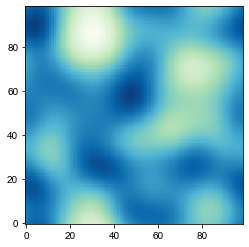

8720 50000 99 0.440133100149225 0.21409745784709255
24490.0 25000.0 24490.0 25000.0


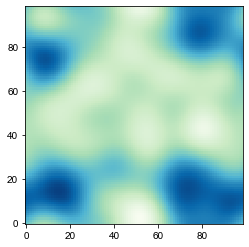

8720 50000 99 0.5214407585439161 0.15426574512081903
24490.0 25000.0 24490.0 25000.0


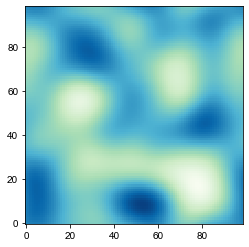

8720 50000 99 0.41436882971216626 -0.06353840007200694
24490.0 25000.0 24490.0 25000.0


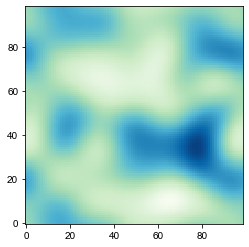

8720 50000 99 0.41798941694771624 0.2082440129719977
24490.0 25000.0 24490.0 25000.0


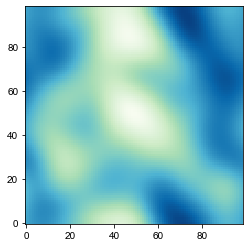

8720 50000 99 0.6492284756699491 0.013980009761165283
24490.0 25000.0 24490.0 25000.0


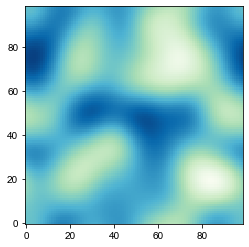

8720 50000 99 0.5164267797086102 -0.06256958730863688
24490.0 25000.0 24490.0 25000.0


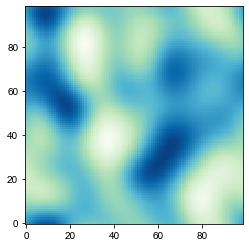

8720 50000 99 0.4688014490031673 -0.15719928914667058
24490.0 25000.0 24490.0 25000.0


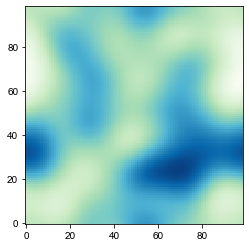

8720 50000 99 0.5842448210025305 -0.045280831438773185
24490.0 25000.0 24490.0 25000.0


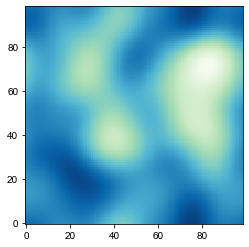

8720 50000 99 0.6606985493333872 0.04420731779780238
24490.0 25000.0 24490.0 25000.0


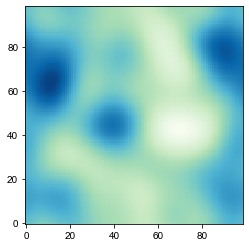

8720 50000 99 0.5521857600694877 0.18481656489732462
24490.0 25000.0 24490.0 25000.0


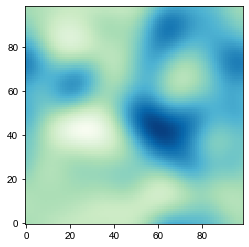

8720 50000 99 0.5050113137509161 0.3022964248311853
24490.0 25000.0 24490.0 25000.0


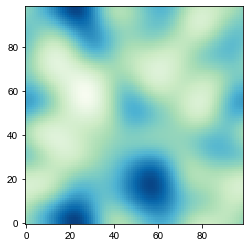

8720 50000 99 0.36663024259868426 0.1442325910931265
24490.0 25000.0 24490.0 25000.0


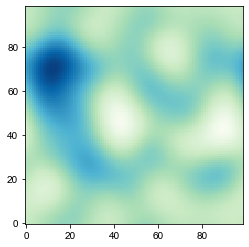

8720 50000 99 0.5757954597749543 0.3346063100625723
24490.0 25000.0 24490.0 25000.0


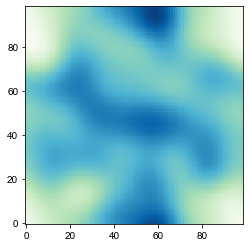

8720 50000 99 0.5556667935475804 -0.19008771446023323
24490.0 25000.0 24490.0 25000.0


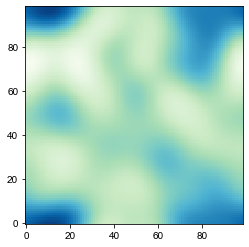

8720 50000 99 0.507601560339946 -0.046487726108442706
24490.0 25000.0 24490.0 25000.0


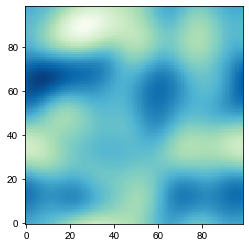

8720 50000 99 0.5795745191353828 -0.09317897811198031
24490.0 25000.0 24490.0 25000.0


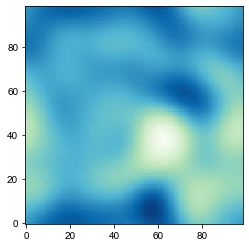

8720 50000 99 0.4811621637805461 0.05098283040965741
24490.0 25000.0 24490.0 25000.0


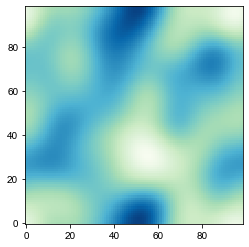

8720 50000 99 0.6077341371060657 0.03575053853339553
24490.0 25000.0 24490.0 25000.0


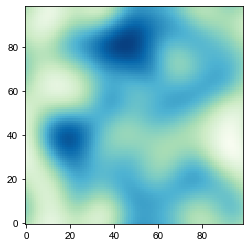

8720 50000 99 0.47556910095279264 0.179371680394027
24490.0 25000.0 24490.0 25000.0


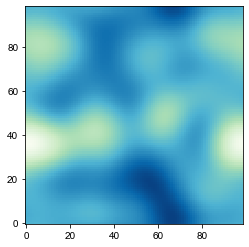

8720 50000 99 0.6455416366683283 0.06331382905914826
24490.0 25000.0 24490.0 25000.0


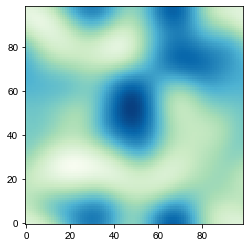

8720 50000 99 0.612070029696507 -0.017472952685597527
24490.0 25000.0 24490.0 25000.0


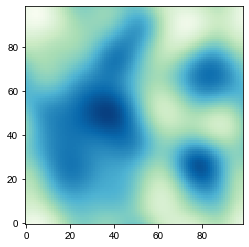

8720 50000 99 0.5957596544941086 0.020612914384586553
24490.0 25000.0 24490.0 25000.0


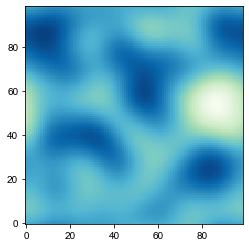

8720 50000 99 0.41493140034810183 -0.09160536358105631
24490.0 25000.0 24490.0 25000.0


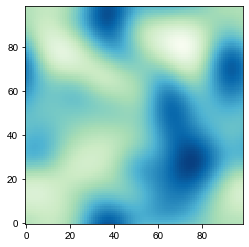

8720 50000 99 0.6455675408032813 0.0338498849345158
24490.0 25000.0 24490.0 25000.0


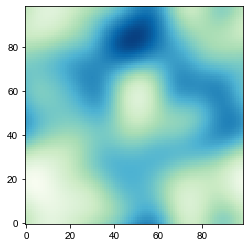

8720 50000 99 0.7020425840105042 -0.3822749139736162
24490.0 25000.0 24490.0 25000.0


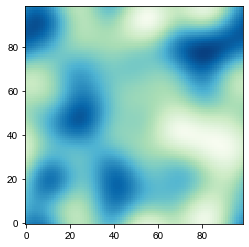

8720 50000 99 0.5172422216943684 -0.10236548936065672
24490.0 25000.0 24490.0 25000.0


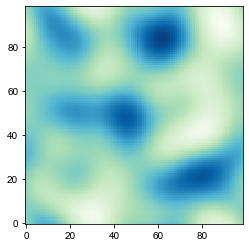

8720 50000 99 0.4792016163016216 -0.3827874919321994
24490.0 25000.0 24490.0 25000.0


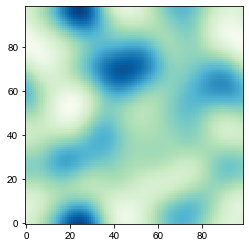

8720 50000 99 0.45338561387358367 0.14555549132718257
24490.0 25000.0 24490.0 25000.0


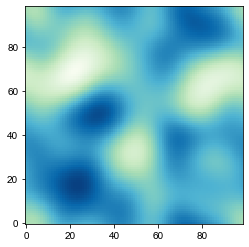

8720 50000 99 0.4905106804212215 -0.16685434044939676
24490.0 25000.0 24490.0 25000.0


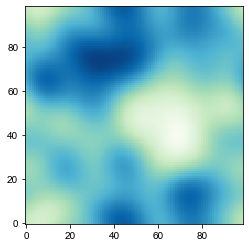

8720 50000 99 0.5712235174876301 0.2829266809007347
24490.0 25000.0 24490.0 25000.0


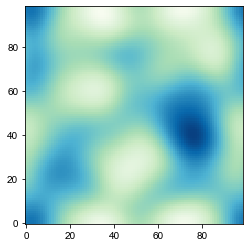

8720 50000 99 0.5768341681644175 0.18679792236130632
24490.0 25000.0 24490.0 25000.0


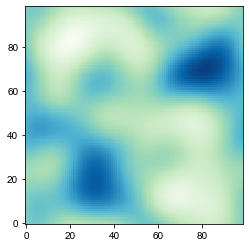

8720 50000 99 0.5603422340581466 -0.0611254453161162
24490.0 25000.0 24490.0 25000.0


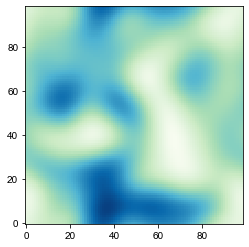

8720 50000 99 0.39151065362670834 -0.056390999104891246
24490.0 25000.0 24490.0 25000.0


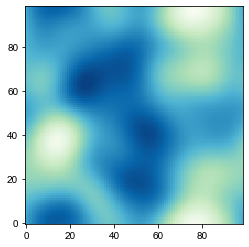

8720 50000 99 0.5818613421553268 -0.09380686279469759
24490.0 25000.0 24490.0 25000.0


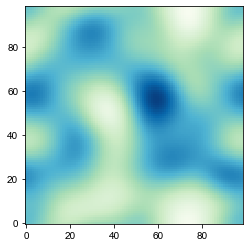

8720 50000 99 0.4754130976226461 0.08613592731865137
24490.0 25000.0 24490.0 25000.0


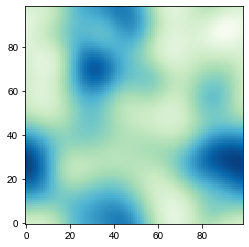

8720 50000 99 0.5261565315129458 0.11284385288286368
24490.0 25000.0 24490.0 25000.0


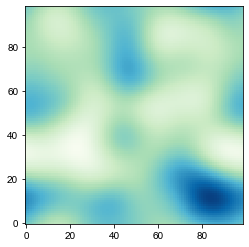

8720 50000 99 0.6358130211128984 0.2258252219972492
24490.0 25000.0 24490.0 25000.0


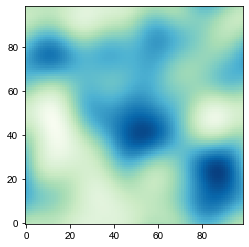

8720 50000 99 0.5573415046154526 0.1257563720803322
24490.0 25000.0 24490.0 25000.0


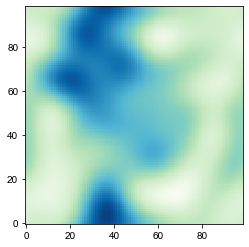

8720 50000 99 0.4677187893565051 -0.33750024119433886
24490.0 25000.0 24490.0 25000.0


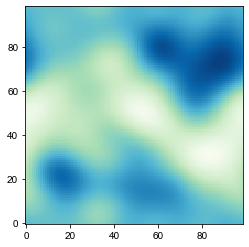

8720 50000 99 0.6227657807293521 -0.28381881343474846
24490.0 25000.0 24490.0 25000.0


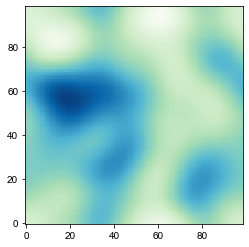

8720 50000 99 0.6878418081137845 0.29641439486489646
24490.0 25000.0 24490.0 25000.0


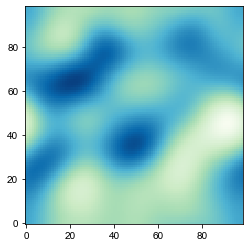

8720 50000 99 0.5741355725515043 -0.23434317091786527
24490.0 25000.0 24490.0 25000.0


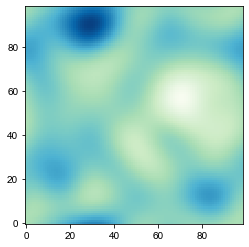

8720 50000 99 0.534356061380788 0.11779153841475104
24490.0 25000.0 24490.0 25000.0


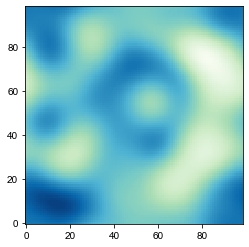

8720 50000 99 0.568743147442398 0.2347472751021775
24490.0 25000.0 24490.0 25000.0


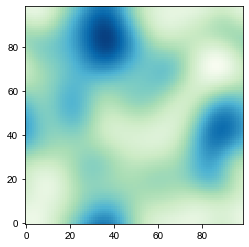

8720 50000 99 0.6232642246266699 -0.0756293435175146
24490.0 25000.0 24490.0 25000.0


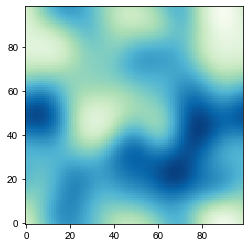

8720 50000 99 0.667132548953677 0.05923564807712525
24490.0 25000.0 24490.0 25000.0


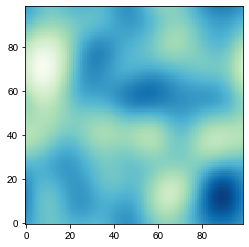

8720 50000 99 0.5348353440924655 0.3131162022095394
24490.0 25000.0 24490.0 25000.0


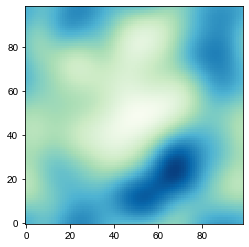

8720 50000 99 0.6512494376319423 0.06151357685288747
24490.0 25000.0 24490.0 25000.0


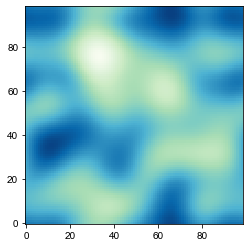

8720 50000 99 0.4135581710629169 0.19460265515128852
24490.0 25000.0 24490.0 25000.0


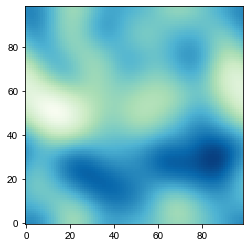

8720 50000 99 0.6230296068854356 0.15262748532929832
24490.0 25000.0 24490.0 25000.0


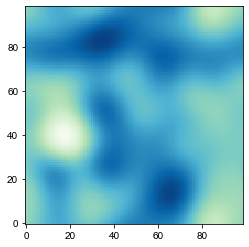

8720 50000 99 0.45210004052345426 -0.17795527365515432
24490.0 25000.0 24490.0 25000.0


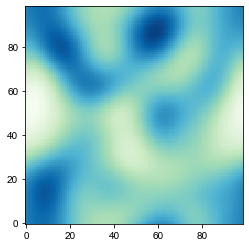

8720 50000 99 0.5198177258475385 -0.06272895089201252
24490.0 25000.0 24490.0 25000.0


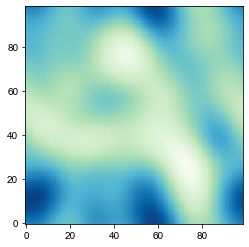

8720 50000 99 0.6041188748446782 0.15874014472060566
24490.0 25000.0 24490.0 25000.0


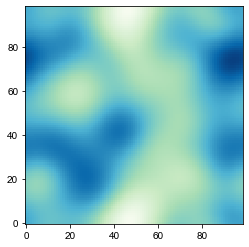

8720 50000 99 0.5917208560573621 -0.07282641079972037
24490.0 25000.0 24490.0 25000.0


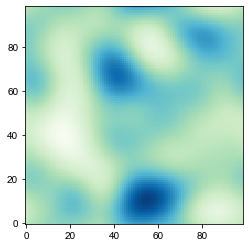

8720 50000 99 0.477633012503109 -0.014551008656072941
24490.0 25000.0 24490.0 25000.0


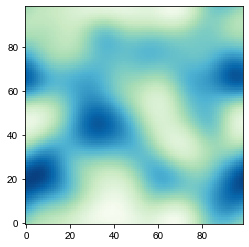

8720 50000 99 0.4481953903349249 -0.22419662753489303
24490.0 25000.0 24490.0 25000.0


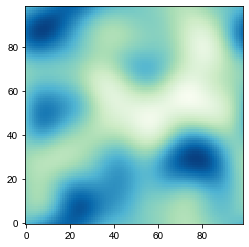

8720 50000 99 0.6045302122558235 0.282203473608349
24490.0 25000.0 24490.0 25000.0


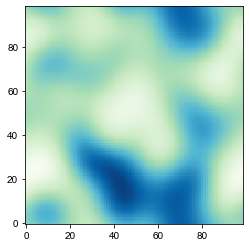

8720 50000 99 0.5179305205134238 0.49153469730788973
24490.0 25000.0 24490.0 25000.0


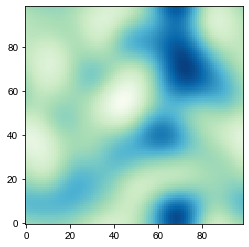

8720 50000 99 0.46480254902101786 -0.2754883758224232
24490.0 25000.0 24490.0 25000.0


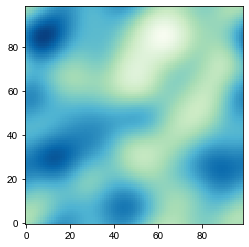

8720 50000 99 0.5541821509496586 -0.14203625801395436
24490.0 25000.0 24490.0 25000.0


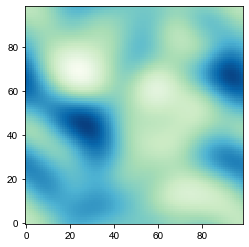

8720 50000 99 0.5546243721013568 0.0648008141945343
24490.0 25000.0 24490.0 25000.0


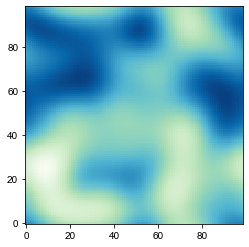

8720 50000 99 0.5547780858149807 -0.047778919971046774
24490.0 25000.0 24490.0 25000.0


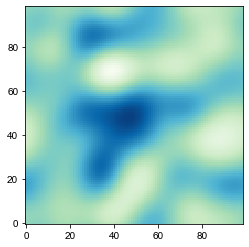

8720 50000 99 0.3715444231651068 0.07801041722652359
24490.0 25000.0 24490.0 25000.0


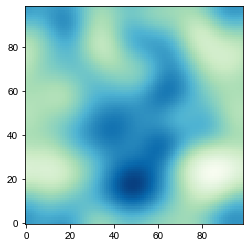

8720 50000 99 0.43736671489424206 0.15517316495782352
24490.0 25000.0 24490.0 25000.0


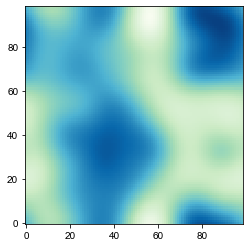

8720 50000 99 0.6460586088729717 -0.10997280726139627
24490.0 25000.0 24490.0 25000.0


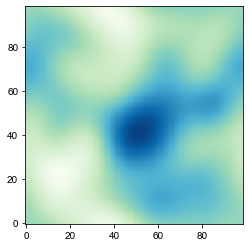

8720 50000 99 0.7718165856913984 -0.21184001061822166
24490.0 25000.0 24490.0 25000.0


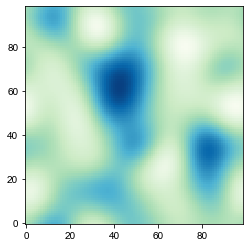

8720 50000 99 0.42637282960056555 -0.1188234842393139
24490.0 25000.0 24490.0 25000.0


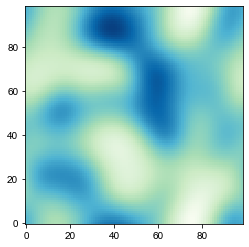

8720 50000 99 0.5303994756117572 0.22399923908319655
24490.0 25000.0 24490.0 25000.0


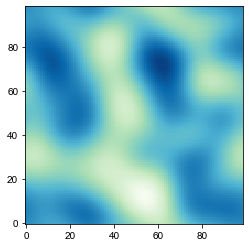

8720 50000 99 0.5005510436461228 0.24767423804143776
24490.0 25000.0 24490.0 25000.0


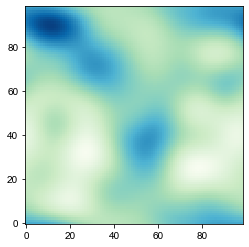

8720 50000 99 0.5136752454883333 0.17037519493154155
24490.0 25000.0 24490.0 25000.0


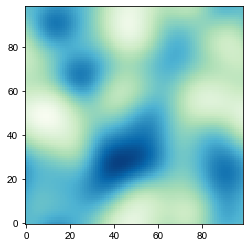

8720 50000 99 0.5754817670185393 0.27328717343435643
24490.0 25000.0 24490.0 25000.0


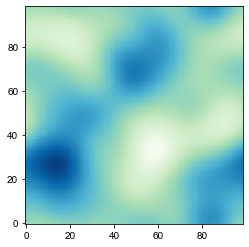

8720 50000 99 0.6341618628334791 0.09184236636801306
24490.0 25000.0 24490.0 25000.0


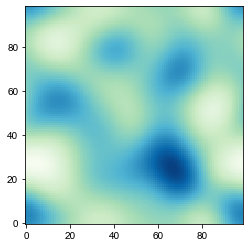

8720 50000 99 0.5231726316167421 0.37136509411841406
24490.0 25000.0 24490.0 25000.0


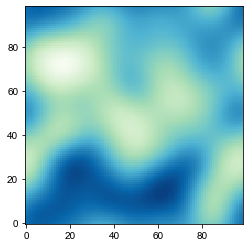

8720 50000 99 0.6786202221151587 0.08752608856903042
24490.0 25000.0 24490.0 25000.0


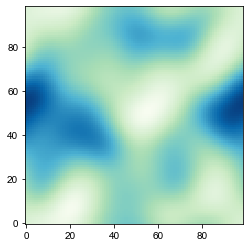

8720 50000 99 0.6249958207683277 -0.17371240682383643
24490.0 25000.0 24490.0 25000.0


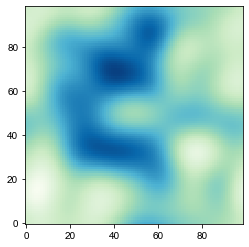

8720 50000 99 0.5201643751751165 -0.2085150646424056
24490.0 25000.0 24490.0 25000.0


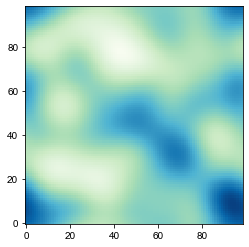

8720 50000 99 0.5486983124632752 0.07149133288457427
24490.0 25000.0 24490.0 25000.0


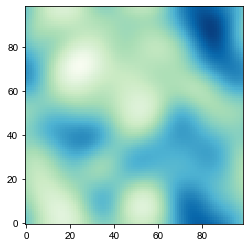

8720 50000 99 0.5214152505156869 -0.20989509906887815
24490.0 25000.0 24490.0 25000.0


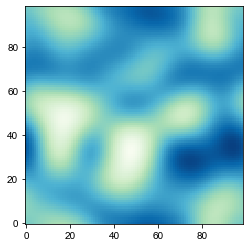

8720 50000 99 0.3846310036807372 0.18169730151289668
24490.0 25000.0 24490.0 25000.0


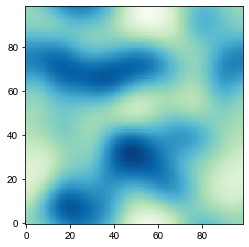

8720 50000 99 0.5293847242337614 -0.07789443950213008
24490.0 25000.0 24490.0 25000.0


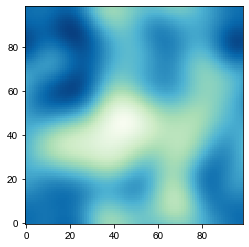

8720 50000 99 0.6424280996556918 -0.04322511061480012
24490.0 25000.0 24490.0 25000.0


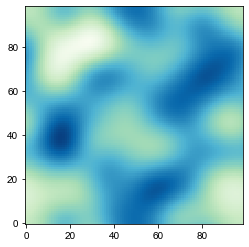

8720 50000 99 0.4647298078568584 -0.1991657208716823
24490.0 25000.0 24490.0 25000.0


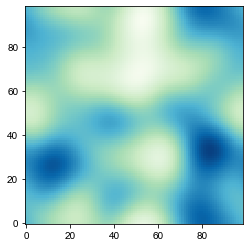

8720 50000 99 0.7053056980904785 -0.2001307372771234
24490.0 25000.0 24490.0 25000.0


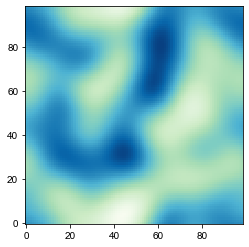

8720 50000 99 0.4729546970887588 -0.18689134094817106
24490.0 25000.0 24490.0 25000.0


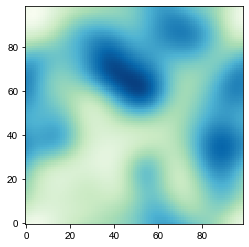

8720 50000 99 0.5601737586245873 0.07249479742541019
24490.0 25000.0 24490.0 25000.0


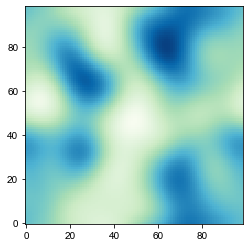

8720 50000 99 0.581155470297656 0.08445881338426932
24490.0 25000.0 24490.0 25000.0


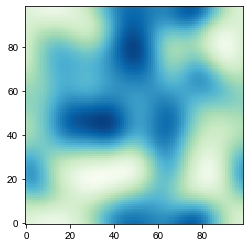

8720 50000 99 0.5687439970222776 0.06676442796701489
24490.0 25000.0 24490.0 25000.0


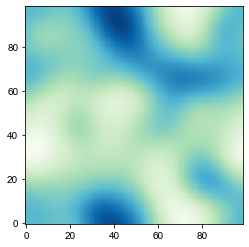

8720 50000 99 0.5996531385389569 -0.19673657945065223
24490.0 25000.0 24490.0 25000.0


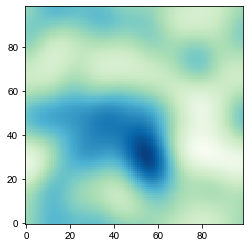

8720 50000 99 0.5084901067047792 0.09392500013101107
24490.0 25000.0 24490.0 25000.0


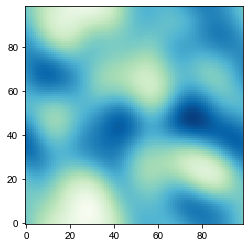

8720 50000 99 0.47971979176894386 -0.03069569914136217
24490.0 25000.0 24490.0 25000.0


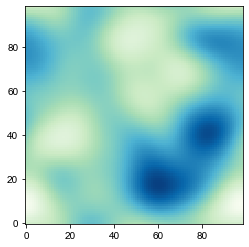

8720 50000 99 0.7045565706633897 0.23656668813831355
24490.0 25000.0 24490.0 25000.0


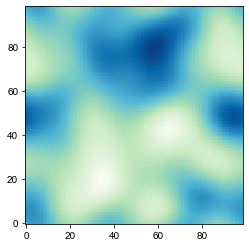

8720 50000 99 0.5498015962525233 0.08776614960604924
24490.0 25000.0 24490.0 25000.0


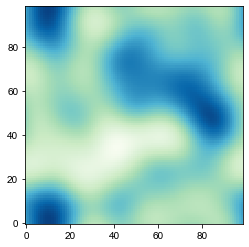

8720 50000 99 0.5151534094063934 -0.16031840907677716
24490.0 25000.0 24490.0 25000.0


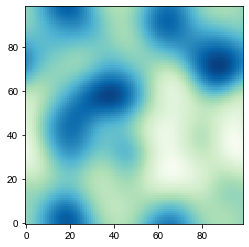

8720 50000 99 0.5539040803376643 0.004742139345382708
24490.0 25000.0 24490.0 25000.0


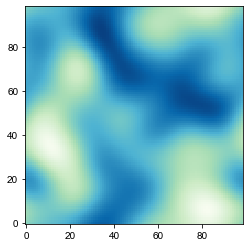

8720 50000 99 0.6112916925044187 -0.02335415216482397
24490.0 25000.0 24490.0 25000.0


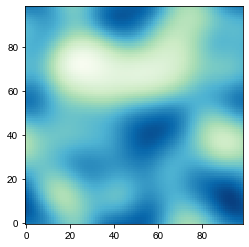

8720 50000 99 0.5373540552845637 -0.22579718259968637
24490.0 25000.0 24490.0 25000.0


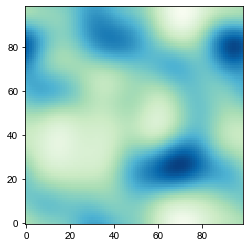

8720 50000 99 0.5346061887775946 -0.048189785308409464
24490.0 25000.0 24490.0 25000.0


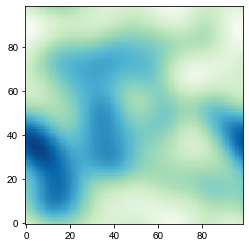

8720 50000 99 0.5379341000672053 -0.1695856489940049
24490.0 25000.0 24490.0 25000.0


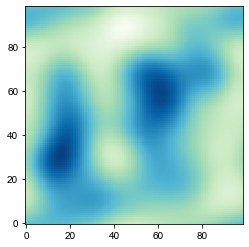

8720 50000 99 0.6204336766282879 -0.296711248014312
24490.0 25000.0 24490.0 25000.0


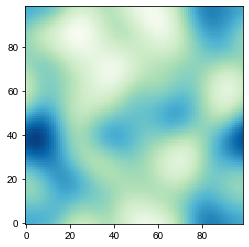

8720 50000 99 0.5808969994730356 0.17931830244266833
24490.0 25000.0 24490.0 25000.0


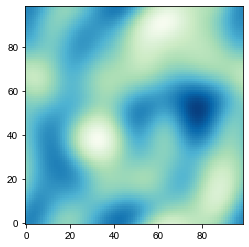

8720 50000 99 0.3957262380709939 0.1317298853943021
24490.0 25000.0 24490.0 25000.0


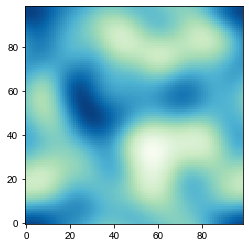

8720 50000 99 0.46624544735979584 0.03688944840238006
24490.0 25000.0 24490.0 25000.0


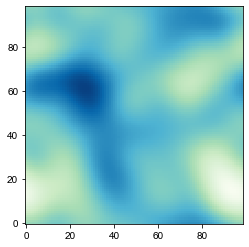

8720 50000 99 0.5748374046841661 -0.10779004339072694
24490.0 25000.0 24490.0 25000.0


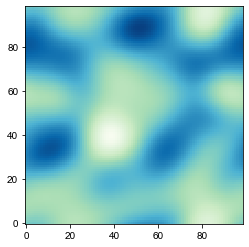

8720 50000 99 0.4598532066351897 -0.06363883515397967
24490.0 25000.0 24490.0 25000.0


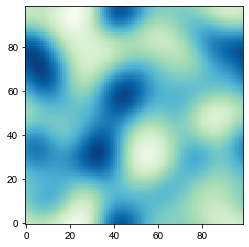

8720 50000 99 0.5031247776229442 0.39457447023265585
24490.0 25000.0 24490.0 25000.0


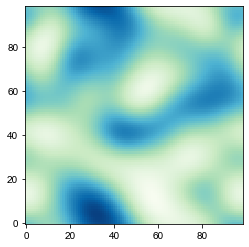

8720 50000 99 0.4266780071750186 0.3074305196376217
24490.0 25000.0 24490.0 25000.0


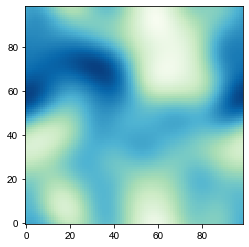

8720 50000 99 0.6313846119364426 -0.012099673589230326
24490.0 25000.0 24490.0 25000.0


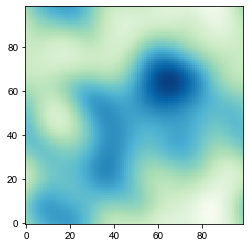

8720 50000 99 0.6663375209399001 -0.020568606505374856
24490.0 25000.0 24490.0 25000.0


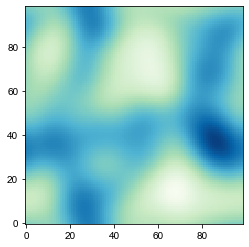

8720 50000 99 0.6809697681386228 0.37248042959759353
24490.0 25000.0 24490.0 25000.0


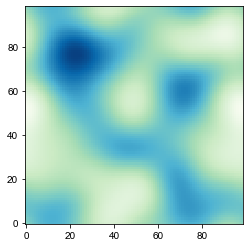

8720 50000 99 0.6154918003859586 -0.3620127806169797
24490.0 25000.0 24490.0 25000.0


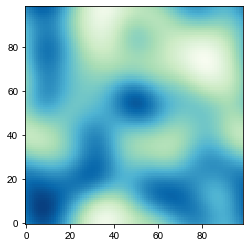

8720 50000 99 0.5435572887934902 -0.060656885145903866
24490.0 25000.0 24490.0 25000.0


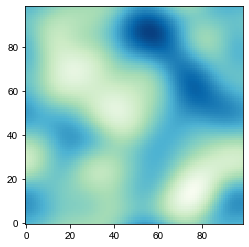

8720 50000 99 0.6318401207079419 -0.052026315603933684
24490.0 25000.0 24490.0 25000.0


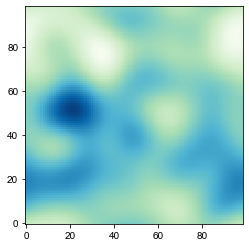

8720 50000 99 0.5666570986412465 -0.09469024038227257
24490.0 25000.0 24490.0 25000.0


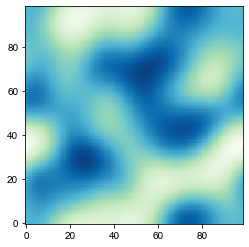

8720 50000 99 0.5178361153949463 0.21264764043502446
24490.0 25000.0 24490.0 25000.0


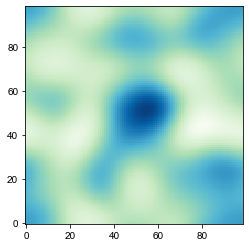

8720 50000 99 0.49684823786717297 0.07733616313430229
24490.0 25000.0 24490.0 25000.0


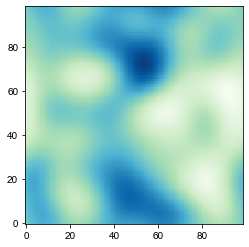

8720 50000 99 0.5193317481463177 -0.045858936074647035
24490.0 25000.0 24490.0 25000.0


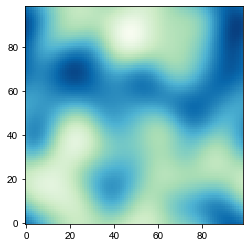

8720 50000 99 0.5549964999537736 0.12538325785892535
24490.0 25000.0 24490.0 25000.0


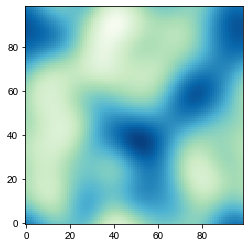

8720 50000 99 0.688446304234602 -0.03235928657525906
24490.0 25000.0 24490.0 25000.0


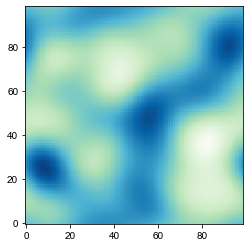

8720 50000 99 0.5167807467446882 -0.03946375230186742
24490.0 25000.0 24490.0 25000.0


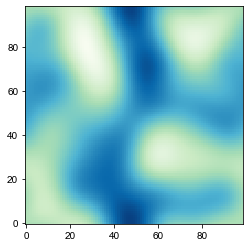

8720 50000 99 0.6199708051451337 -0.010809562318216982
24490.0 25000.0 24490.0 25000.0


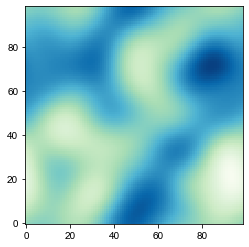

8720 50000 99 0.5714264446956929 0.2217511290846529
24490.0 25000.0 24490.0 25000.0


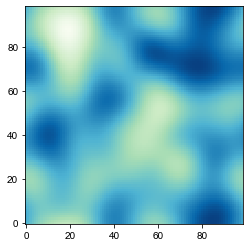

8720 50000 99 0.4982112624416414 -0.12966554562258584
24490.0 25000.0 24490.0 25000.0


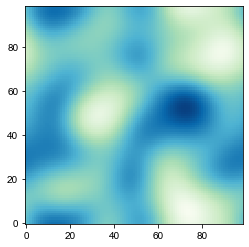

8720 50000 99 0.5838212548204368 -0.2634947299296463
24490.0 25000.0 24490.0 25000.0


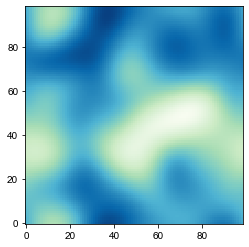

8720 50000 99 0.6374004954449591 -0.013909725444908138
24490.0 25000.0 24490.0 25000.0


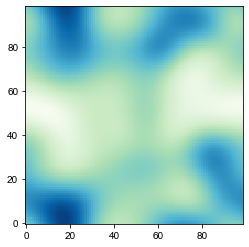

8720 50000 99 0.7036926672586069 -0.16491810387019828
24490.0 25000.0 24490.0 25000.0


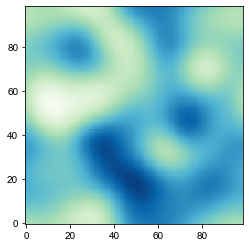

8720 50000 99 0.4537682571595831 0.07465416875077556
24490.0 25000.0 24490.0 25000.0


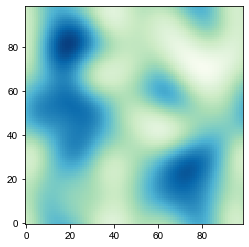

8720 50000 99 0.5397759389020601 -0.2574995018589374
24490.0 25000.0 24490.0 25000.0


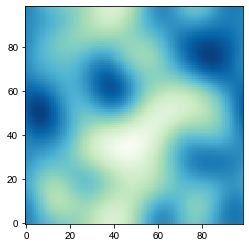

8720 50000 99 0.5991104296029902 0.04038440526935858
24490.0 25000.0 24490.0 25000.0


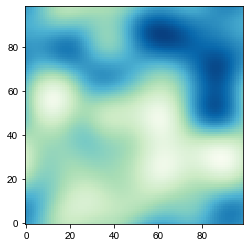

8720 50000 99 0.6809823927175083 -0.2249569382160246
24490.0 25000.0 24490.0 25000.0


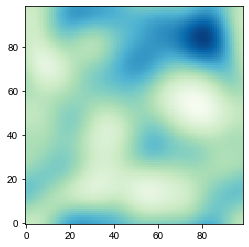

8720 50000 99 0.5034133644019295 -0.028167974874626755
24490.0 25000.0 24490.0 25000.0


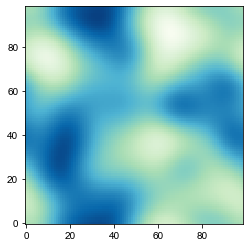

8720 50000 99 0.6590583099277764 -0.004539606361742982
24490.0 25000.0 24490.0 25000.0


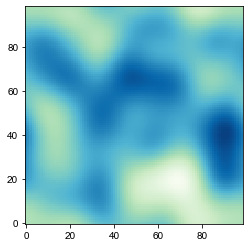

8720 50000 99 0.4379929645655153 -0.057466099360402464
24490.0 25000.0 24490.0 25000.0


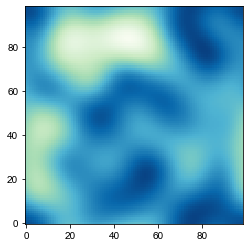

8720 50000 99 0.4637082727810068 -0.10243560742806694
24490.0 25000.0 24490.0 25000.0


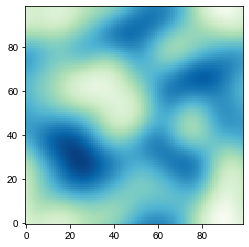

8720 50000 99 0.5121391720129719 -0.0876004835116727
24490.0 25000.0 24490.0 25000.0


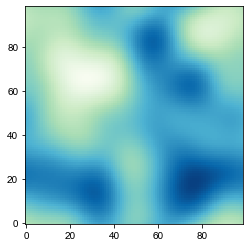

8720 50000 99 0.748495016851567 -0.10916559984953329
24490.0 25000.0 24490.0 25000.0


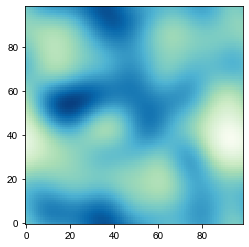

8720 50000 99 0.5858525314293539 -0.11356375343430695
24490.0 25000.0 24490.0 25000.0


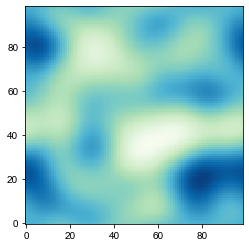

8720 50000 99 0.5450172072411879 0.22475624942756
24490.0 25000.0 24490.0 25000.0


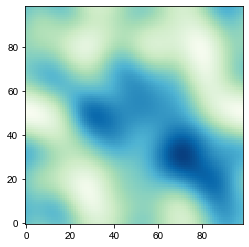

8720 50000 99 0.5330999118961123 -0.1882039565159186
24490.0 25000.0 24490.0 25000.0


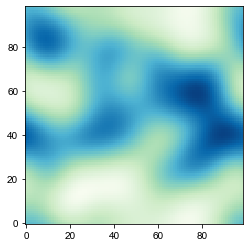

8720 50000 99 0.7096445929098314 0.14676249195812605
24490.0 25000.0 24490.0 25000.0


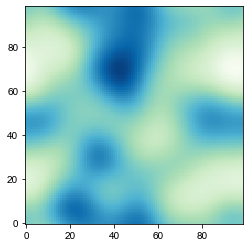

8720 50000 99 0.7362336283491243 -0.3202057462811988
24490.0 25000.0 24490.0 25000.0


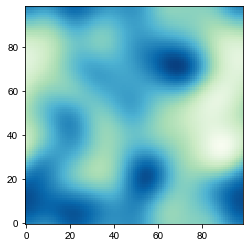

8720 50000 99 0.5494203642569826 -0.04070645573451888
24490.0 25000.0 24490.0 25000.0


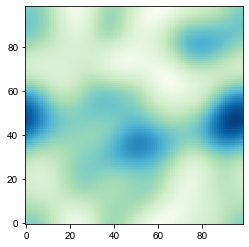

8720 50000 99 0.5626646462912894 0.23644350066143166
24490.0 25000.0 24490.0 25000.0


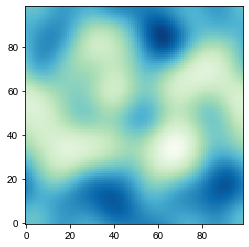

8720 50000 99 0.5493168047743725 -0.07480318576150807
24490.0 25000.0 24490.0 25000.0


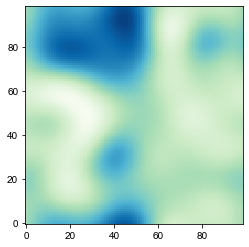

8720 50000 99 0.5391151512321881 -0.025270807711996537
24490.0 25000.0 24490.0 25000.0


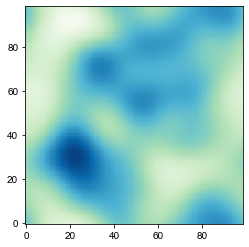

8720 50000 99 0.6431281367334846 -0.4190311194180967
24490.0 25000.0 24490.0 25000.0


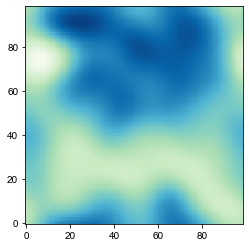

8720 50000 99 0.5644203375397246 0.08136267967058758
24490.0 25000.0 24490.0 25000.0


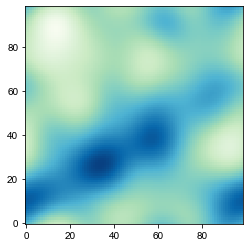

8720 50000 99 0.5664678434891467 -0.18132877900326913
24490.0 25000.0 24490.0 25000.0


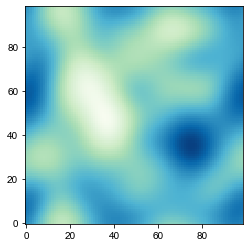

8720 50000 99 0.5316308587856642 0.103957356249714
24490.0 25000.0 24490.0 25000.0


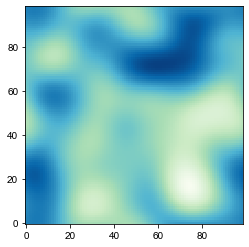

8720 50000 99 0.5387155801943363 -0.13924285890480673
24490.0 25000.0 24490.0 25000.0


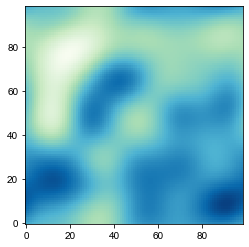

8720 50000 99 0.6289948277842161 0.07387844135681991
24490.0 25000.0 24490.0 25000.0


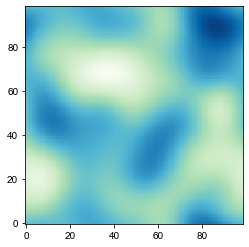

8720 50000 99 0.6165329096412681 -0.13131874010854036
24490.0 25000.0 24490.0 25000.0


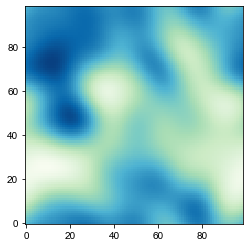

8720 50000 99 0.47268932866508145 -0.0815235161994258
24490.0 25000.0 24490.0 25000.0


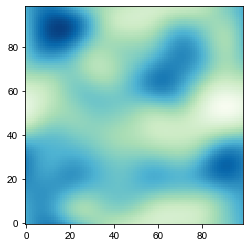

8720 50000 99 0.423272801491358 -0.22915143066015065
24490.0 25000.0 24490.0 25000.0


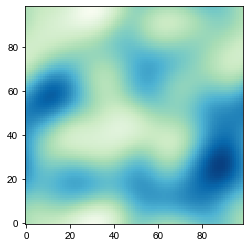

8720 50000 99 0.685932811825087 -0.11044590326334923
24490.0 25000.0 24490.0 25000.0


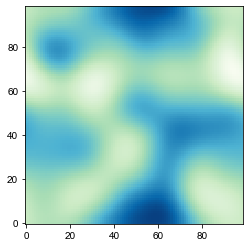

8720 50000 99 0.6118504387887083 0.21026995850357194
24490.0 25000.0 24490.0 25000.0


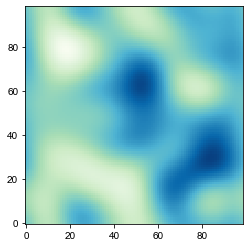

8720 50000 99 0.5464904862577956 -0.08545370355438821
24490.0 25000.0 24490.0 25000.0


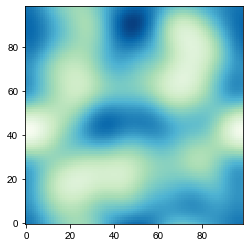

8720 50000 99 0.508770070108046 0.02321142187740006
24490.0 25000.0 24490.0 25000.0


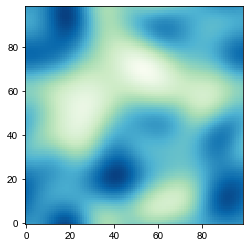

8720 50000 99 0.4622314841647039 -0.027491334254922253
24490.0 25000.0 24490.0 25000.0


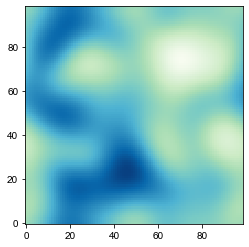

8720 50000 99 0.6358021644949787 0.31499228387861505
24490.0 25000.0 24490.0 25000.0


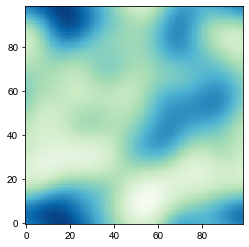

8720 50000 99 0.6724341676519922 -0.09176458491030215
24490.0 25000.0 24490.0 25000.0


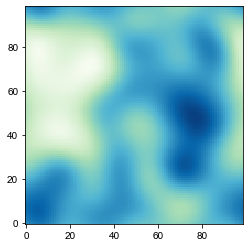

8720 50000 99 0.455411161384592 0.12215532858972751
24490.0 25000.0 24490.0 25000.0


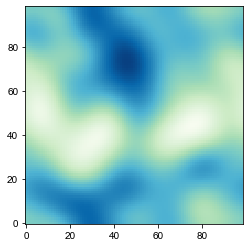

8720 50000 99 0.6036713063412429 0.10832350075651664
24490.0 25000.0 24490.0 25000.0


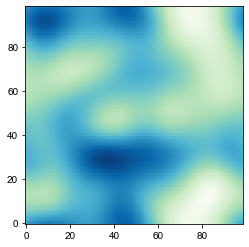

8720 50000 99 0.6201737715813467 0.2446429693364364
24490.0 25000.0 24490.0 25000.0


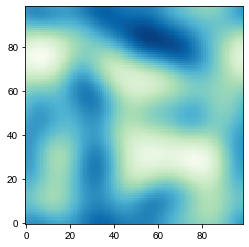

8720 50000 99 0.5132360261104449 -0.01452638388872367
24490.0 25000.0 24490.0 25000.0


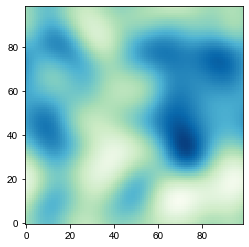

8720 50000 99 0.44461299265164805 -0.06369429018537946
24490.0 25000.0 24490.0 25000.0


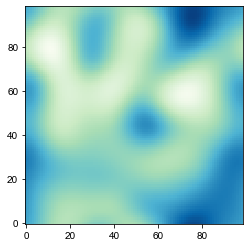

8720 50000 99 0.5482977537449502 -0.11602610419553334
24490.0 25000.0 24490.0 25000.0


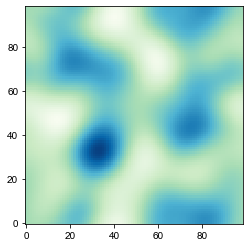

8720 50000 99 0.4134691742357591 0.19908674997657053
24490.0 25000.0 24490.0 25000.0


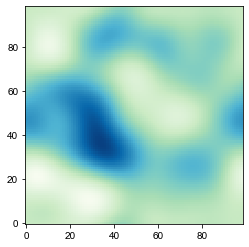

8720 50000 99 0.5219438071263031 -0.06540798552988017
24490.0 25000.0 24490.0 25000.0


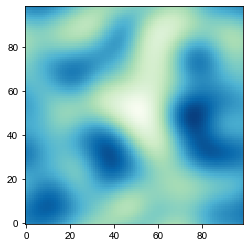

8720 50000 99 0.48195647776639816 0.029248627254438126
24490.0 25000.0 24490.0 25000.0


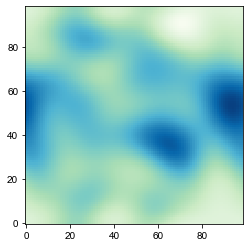

8720 50000 99 0.582726555033439 -0.22541038479617154
24490.0 25000.0 24490.0 25000.0


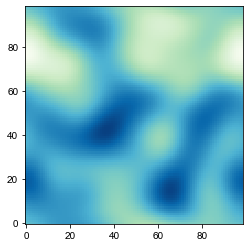

8720 50000 99 0.5007911430860156 0.21762892954225435
24490.0 25000.0 24490.0 25000.0


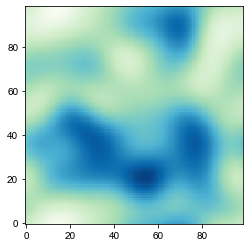

8720 50000 99 0.48029763000399117 -0.07628454690119613
24490.0 25000.0 24490.0 25000.0


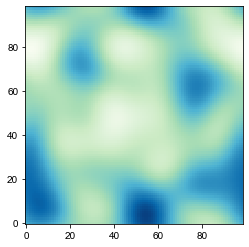

8720 50000 99 0.5096964442309474 0.1397644415221501
24490.0 25000.0 24490.0 25000.0


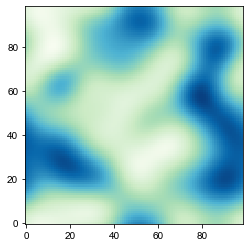

8720 50000 99 0.396793269013484 -0.06753124867057922
24490.0 25000.0 24490.0 25000.0


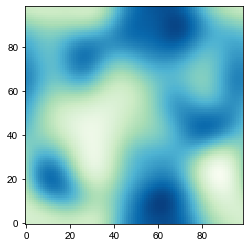

8720 50000 99 0.731229277790136 0.26210309534068094
24490.0 25000.0 24490.0 25000.0


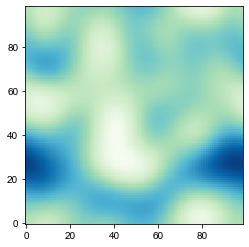

8720 50000 99 0.4899299396507543 0.3432739343234339
24490.0 25000.0 24490.0 25000.0


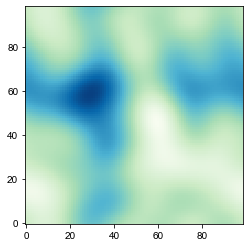

8720 50000 99 0.6342845525099258 0.07895780598621766
24490.0 25000.0 24490.0 25000.0


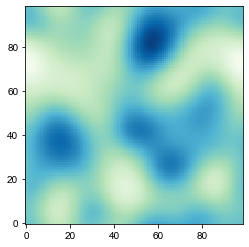

8720 50000 99 0.5012379436560571 0.0073403382001362115
24490.0 25000.0 24490.0 25000.0


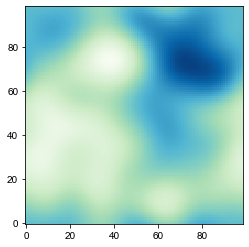

8720 50000 99 0.7292549698682101 0.17798154221210225
24490.0 25000.0 24490.0 25000.0


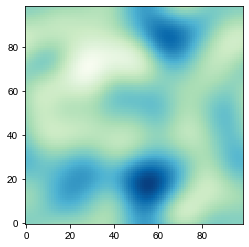

8720 50000 99 0.4829443854426836 -0.00617994829605873
24490.0 25000.0 24490.0 25000.0


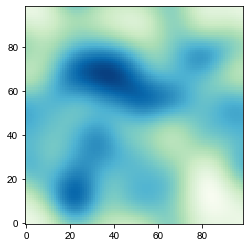

8720 50000 99 0.6072299959197641 -0.053872718508947016
24490.0 25000.0 24490.0 25000.0


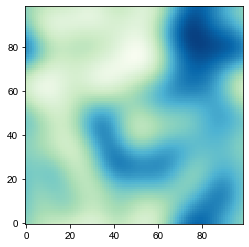

8720 50000 99 0.5224883817021067 -0.07645837291578136
24490.0 25000.0 24490.0 25000.0


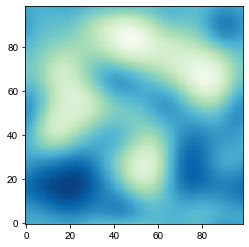

8720 50000 99 0.48892127295814547 -0.008612943622426672
24490.0 25000.0 24490.0 25000.0


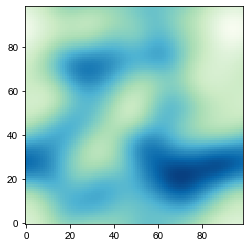

8720 50000 99 0.6078263962836653 0.19237993518073188
24490.0 25000.0 24490.0 25000.0


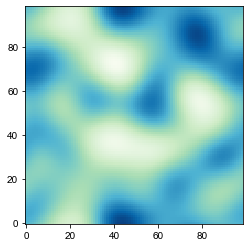

8720 50000 99 0.41721744972835406 0.1202758374507417
24490.0 25000.0 24490.0 25000.0


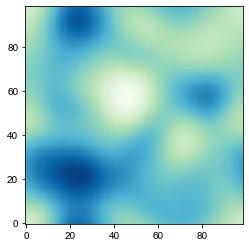

8720 50000 99 0.5945652468407188 -0.1787120664376653
24490.0 25000.0 24490.0 25000.0


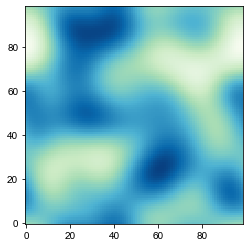

8720 50000 99 0.5693556349573455 0.32112395854365844
24490.0 25000.0 24490.0 25000.0


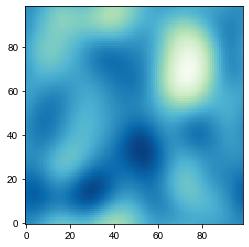

8720 50000 99 0.5170659293235423 -0.12971883451071894
24490.0 25000.0 24490.0 25000.0


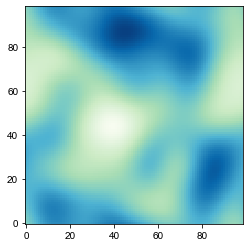

8720 50000 99 0.7990581706795195 0.00017526207616256272
24490.0 25000.0 24490.0 25000.0


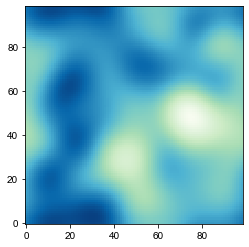

8720 50000 99 0.5151795366039572 -0.14424186788430704
24490.0 25000.0 24490.0 25000.0


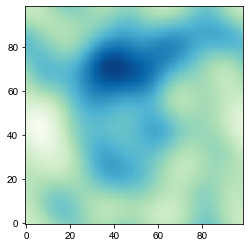

8720 50000 99 0.5552992695079223 0.3944297339364136
24490.0 25000.0 24490.0 25000.0


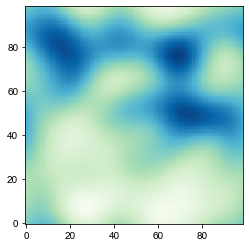

8720 50000 99 0.6679685225606922 0.124044595518611
24490.0 25000.0 24490.0 25000.0


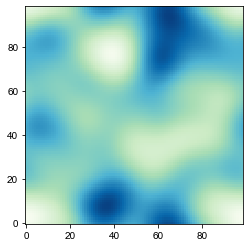

8720 50000 99 0.5545234362817834 0.07329670421985056
24490.0 25000.0 24490.0 25000.0


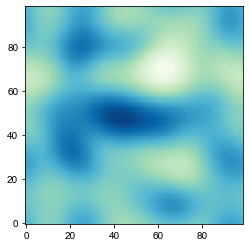

8720 50000 99 0.4533689589988023 -0.2353990049346502
24490.0 25000.0 24490.0 25000.0


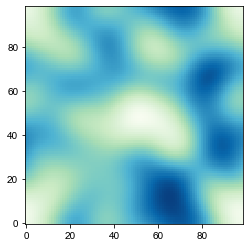

8720 50000 99 0.47279081530514855 -0.14601094699762743
24490.0 25000.0 24490.0 25000.0


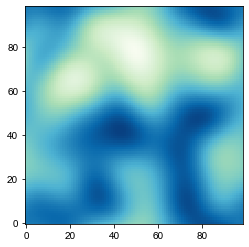

8720 50000 99 0.5949024505429704 -0.15844990879281012
24490.0 25000.0 24490.0 25000.0


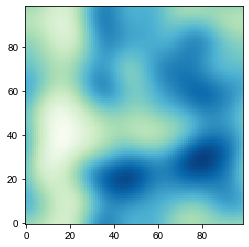

8720 50000 99 0.6002778305617266 -0.15994483065726164
24490.0 25000.0 24490.0 25000.0


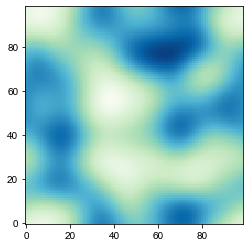

8720 50000 99 0.5011871397055291 -0.1031722653358067
24490.0 25000.0 24490.0 25000.0


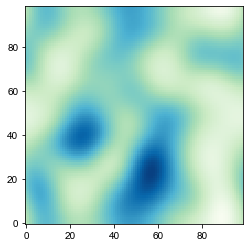

8720 50000 99 0.44643906356456514 0.0988363176274102
24490.0 25000.0 24490.0 25000.0


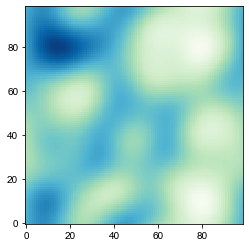

8720 50000 99 0.530977183116844 0.08943275342508358
24490.0 25000.0 24490.0 25000.0


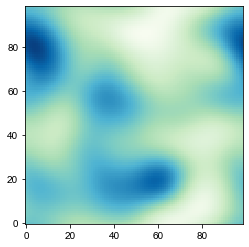

8720 50000 99 0.614308367051244 -0.15855588915806612
24490.0 25000.0 24490.0 25000.0


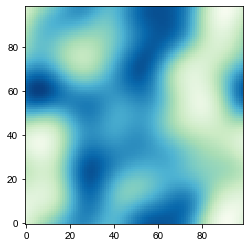

8720 50000 99 0.6033610205031185 -0.3591164226904296
24490.0 25000.0 24490.0 25000.0


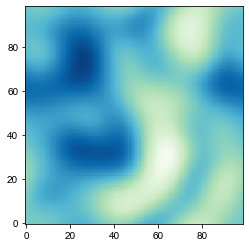

8720 50000 99 0.4849850723433343 -0.048940730119743585
24490.0 25000.0 24490.0 25000.0


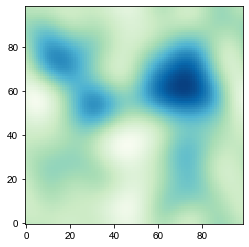

8720 50000 99 0.5278218864738147 -0.16111423935449462
24490.0 25000.0 24490.0 25000.0


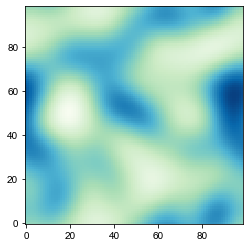

8720 50000 99 0.44898216156982934 -0.04317783541687017
24490.0 25000.0 24490.0 25000.0


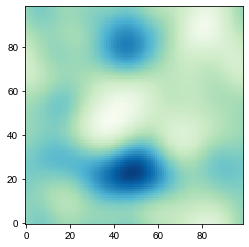

8720 50000 99 0.5899427527524661 -0.10825467141771972
24490.0 25000.0 24490.0 25000.0


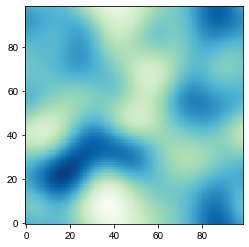

8720 50000 99 0.5638216618247587 -0.24174815058153828
24490.0 25000.0 24490.0 25000.0


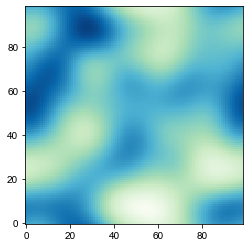

8720 50000 99 0.6141780809397627 -0.260992242748352
24490.0 25000.0 24490.0 25000.0


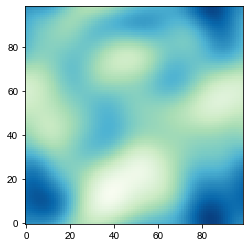

8720 50000 99 0.6537655636942376 -0.03811572089142593
24490.0 25000.0 24490.0 25000.0


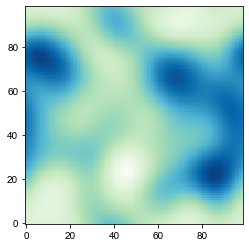

8720 50000 99 0.4995308763328993 0.13260486099711294
24490.0 25000.0 24490.0 25000.0


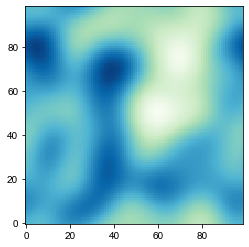

8720 50000 99 0.48538569377814794 -0.17874069647889318
24490.0 25000.0 24490.0 25000.0


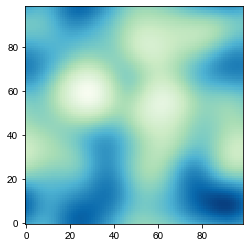

8720 50000 99 0.6233513230447038 0.10485263327141552
24490.0 25000.0 24490.0 25000.0


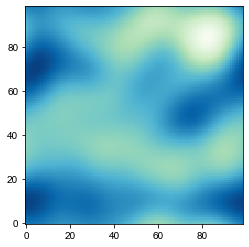

8720 50000 99 0.6224722475030162 0.03884692579438513
24490.0 25000.0 24490.0 25000.0


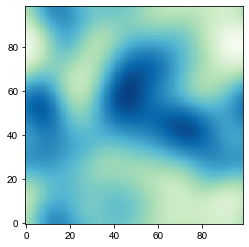

8720 50000 99 0.6539936802444666 -0.2446597207919813
24490.0 25000.0 24490.0 25000.0


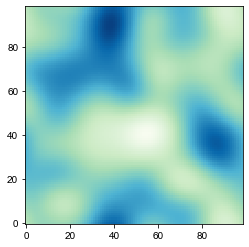

8720 50000 99 0.40827060079717464 0.06494194337032602
24490.0 25000.0 24490.0 25000.0


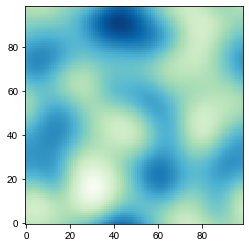

8720 50000 99 0.4902784622436878 0.16798548126582166
24490.0 25000.0 24490.0 25000.0


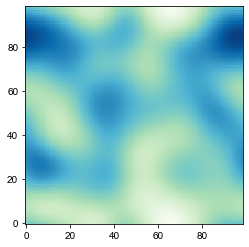

8720 50000 99 0.5862962279702136 0.10803672488653852
24490.0 25000.0 24490.0 25000.0


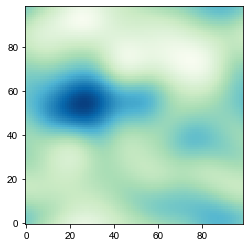

8720 50000 99 0.6161470547275105 0.003980691178142167
24490.0 25000.0 24490.0 25000.0


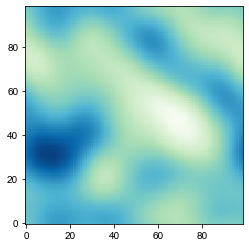

8720 50000 99 0.5909319374103043 -0.01273756606588934
24490.0 25000.0 24490.0 25000.0


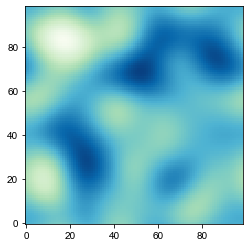

8720 50000 99 0.5029838891323283 -0.28415977492692074
24490.0 25000.0 24490.0 25000.0


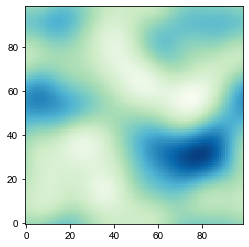

8720 50000 99 0.5718043796912956 -0.15056458603613748
24490.0 25000.0 24490.0 25000.0


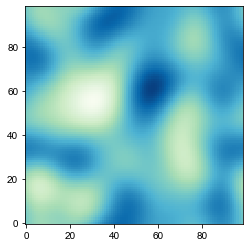

8720 50000 99 0.4327460820284946 -0.22132251345222465
24490.0 25000.0 24490.0 25000.0


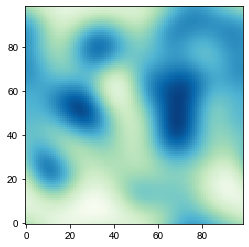

8720 50000 99 0.5299653889706887 -0.08997746497440641
24490.0 25000.0 24490.0 25000.0


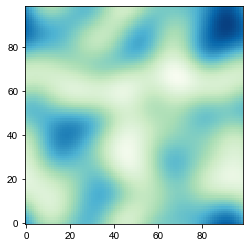

8720 50000 99 0.42265043398574514 -0.26774333693251856
24490.0 25000.0 24490.0 25000.0


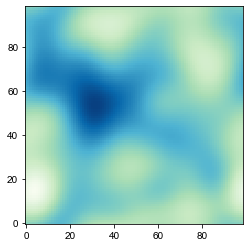

8720 50000 99 0.5528827789993352 0.03995150669076996
24490.0 25000.0 24490.0 25000.0


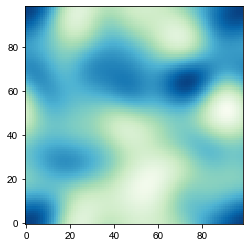

8720 50000 99 0.5826717804978109 -0.034288718936862694
24490.0 25000.0 24490.0 25000.0


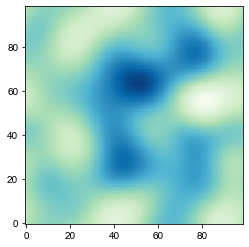

8720 50000 99 0.5652344996643415 -0.0036545902172764357
24490.0 25000.0 24490.0 25000.0


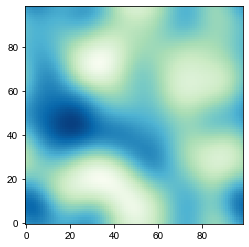

8720 50000 99 0.50445046170324 0.028015248989073132
24490.0 25000.0 24490.0 25000.0


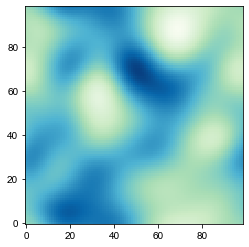

8720 50000 99 0.5551105791034521 -0.05535019158262419
24490.0 25000.0 24490.0 25000.0


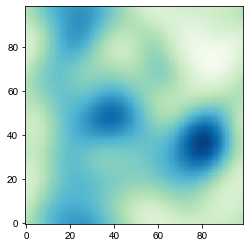

8720 50000 99 0.735765388601016 -0.37665440119348287
24490.0 25000.0 24490.0 25000.0


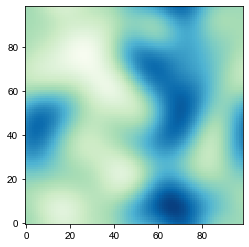

8720 50000 99 0.6608188344948754 0.01953875113046201
24490.0 25000.0 24490.0 25000.0


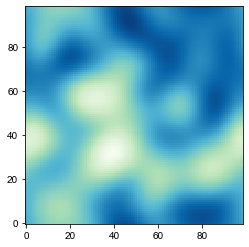

8720 50000 99 0.43325331355758073 -0.2357224406377663
24490.0 25000.0 24490.0 25000.0


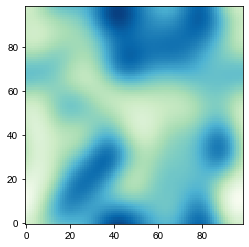

8720 50000 99 0.484427716631689 -0.16565108434193923
24490.0 25000.0 24490.0 25000.0


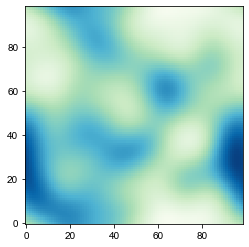

8720 50000 99 0.5567292157685707 0.3421282483543111
24490.0 25000.0 24490.0 25000.0


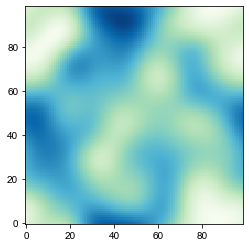

8720 50000 99 0.5018398627684475 -0.036435309291330854
24490.0 25000.0 24490.0 25000.0


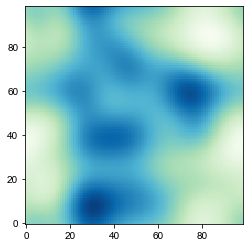

8720 50000 99 0.6820960907326202 -0.10577283670463405
24490.0 25000.0 24490.0 25000.0


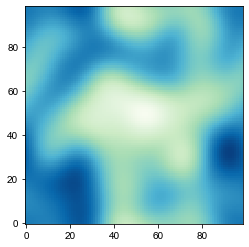

8720 50000 99 0.6103062846189107 0.2948907361581507
24490.0 25000.0 24490.0 25000.0


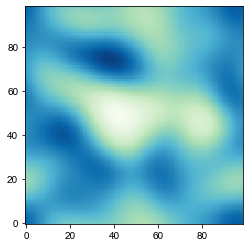

8720 50000 99 0.5166438673233754 0.01900273750446871
24490.0 25000.0 24490.0 25000.0


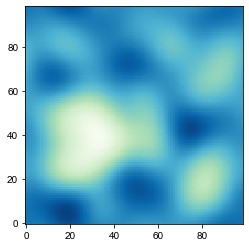

8720 50000 99 0.519062102123545 0.11206255415281452
24490.0 25000.0 24490.0 25000.0


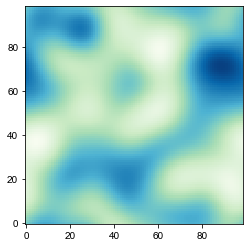

8720 50000 99 0.4746788333087918 0.1160142588901092
24490.0 25000.0 24490.0 25000.0


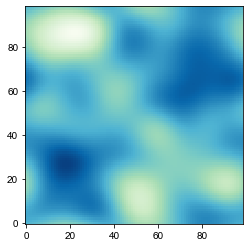

8720 50000 99 0.5694281546695831 -0.010341021003180502
24490.0 25000.0 24490.0 25000.0


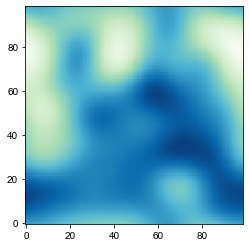

8720 50000 99 0.6799010918327436 0.21232755779994353
24490.0 25000.0 24490.0 25000.0


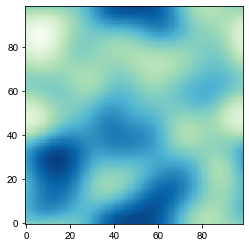

8720 50000 99 0.5753466784416724 -0.10660032066842033
24490.0 25000.0 24490.0 25000.0


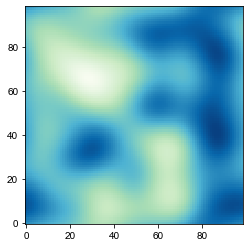

8720 50000 99 0.5937121511353675 0.3643968056290925
24490.0 25000.0 24490.0 25000.0


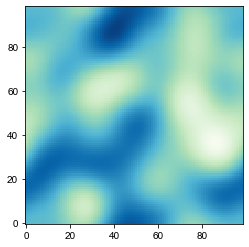

8720 50000 99 0.5903315859460702 -0.09606901777327544
24490.0 25000.0 24490.0 25000.0


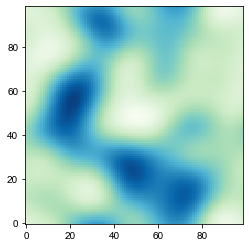

8720 50000 99 0.49945901349213007 -0.020083466294595974
24490.0 25000.0 24490.0 25000.0


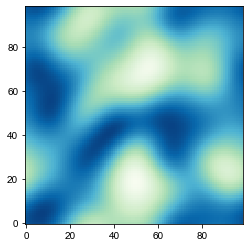

8720 50000 99 0.4888518147216456 0.4196639584786353
24490.0 25000.0 24490.0 25000.0


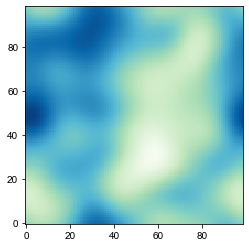

8720 50000 99 0.5935905074828485 -0.21371834646223795
24490.0 25000.0 24490.0 25000.0


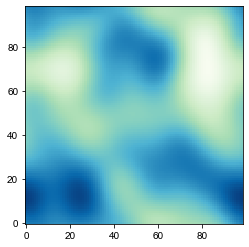

8720 50000 99 0.5784580651744862 0.2730107904662524
24490.0 25000.0 24490.0 25000.0


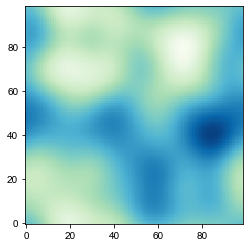

8720 50000 99 0.6777721229725816 0.056942911556077565
24490.0 25000.0 24490.0 25000.0


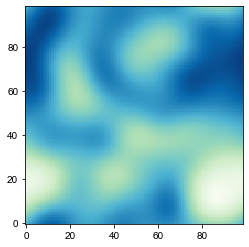

8720 50000 99 0.4887861860349388 0.01325248898305296
24490.0 25000.0 24490.0 25000.0


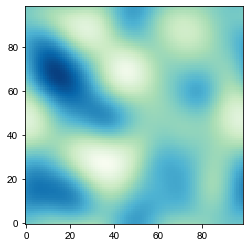

8720 50000 99 0.5382211895594199 0.2691485626807915
24490.0 25000.0 24490.0 25000.0


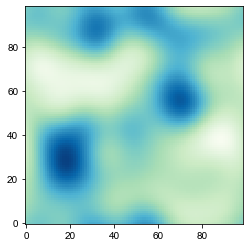

8720 50000 99 0.4574495615613597 0.12199595982581164
24490.0 25000.0 24490.0 25000.0


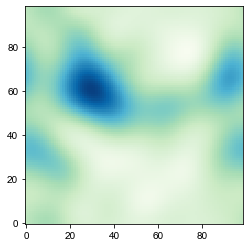

8720 50000 99 0.6514299509000757 -0.17537834469626054
24490.0 25000.0 24490.0 25000.0


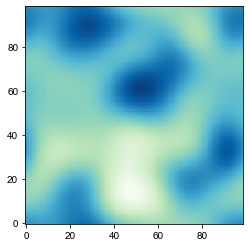

8720 50000 99 0.6098743369607326 0.15260123249695323
24490.0 25000.0 24490.0 25000.0


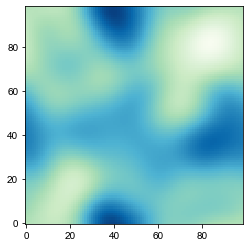

8720 50000 99 0.7271152019011162 0.20952810502664995
24490.0 25000.0 24490.0 25000.0


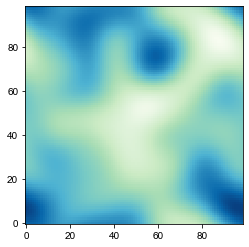

8720 50000 99 0.5759469305846809 0.30338413508519485
24490.0 25000.0 24490.0 25000.0


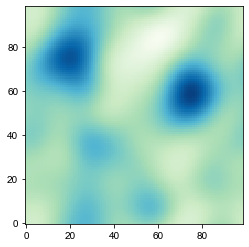

8720 50000 99 0.5937561796778058 0.48191534796206964
24490.0 25000.0 24490.0 25000.0


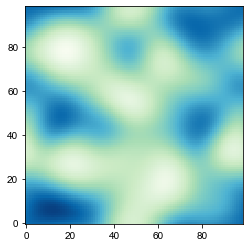

8720 50000 99 0.5258029240067738 0.1397330136769603
24490.0 25000.0 24490.0 25000.0


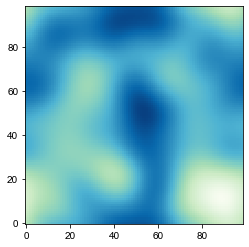

8720 50000 99 0.5997587042783104 -0.24916643961471158
24490.0 25000.0 24490.0 25000.0


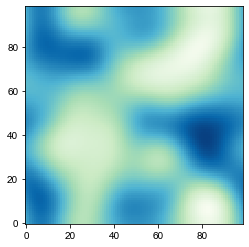

8720 50000 99 0.6561564809013828 -0.0886055733708159
24490.0 25000.0 24490.0 25000.0


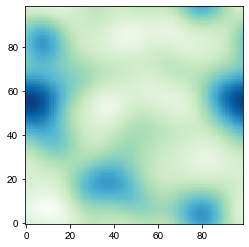

8720 50000 99 0.486076811324769 -0.05909381505973639
24490.0 25000.0 24490.0 25000.0


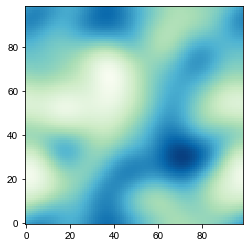

8720 50000 99 0.5220173062570967 -0.08059928888455009
24490.0 25000.0 24490.0 25000.0


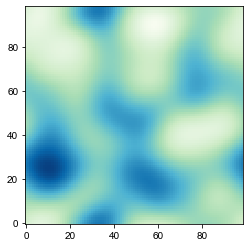

8720 50000 99 0.5209559511472949 0.23141425707023516
24490.0 25000.0 24490.0 25000.0


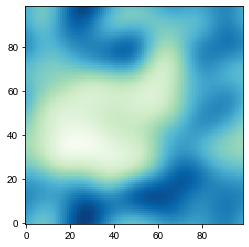

8720 50000 99 0.6009878338326253 -0.08996636578464656
24490.0 25000.0 24490.0 25000.0


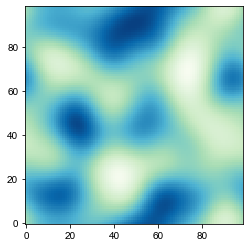

8720 50000 99 0.4048521446067994 0.0721074657282044
24490.0 25000.0 24490.0 25000.0


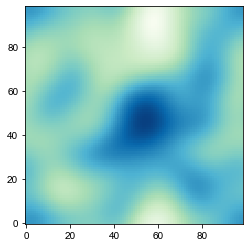

8720 50000 99 0.6224657201140009 0.06413067905697778
24490.0 25000.0 24490.0 25000.0


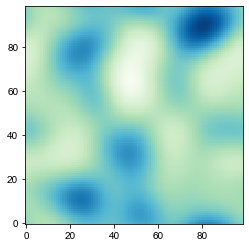

8720 50000 99 0.4842836864363649 -0.03458286200287629
24490.0 25000.0 24490.0 25000.0


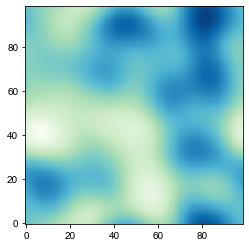

8720 50000 99 0.46784521317762284 0.038278073644417626
24490.0 25000.0 24490.0 25000.0


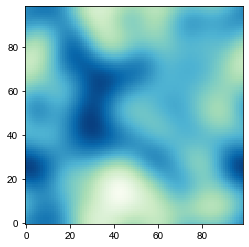

8720 50000 99 0.39849031894727305 0.13713447078785934
24490.0 25000.0 24490.0 25000.0


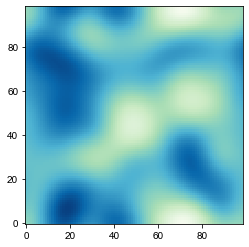

8720 50000 99 0.4580038570793608 0.1397229822147001
24490.0 25000.0 24490.0 25000.0


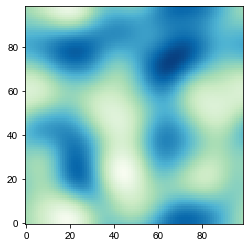

8720 50000 99 0.508324790052295 -0.027096006069032084
24490.0 25000.0 24490.0 25000.0


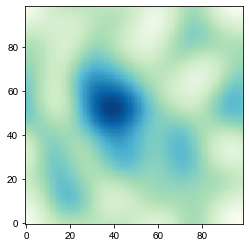

8720 50000 99 0.42731637556260976 0.05406971839918755
24490.0 25000.0 24490.0 25000.0


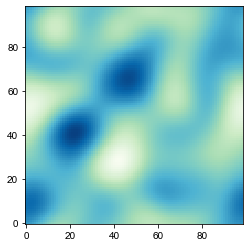

8720 50000 99 0.351346517501503 -0.15836440657240486
24490.0 25000.0 24490.0 25000.0


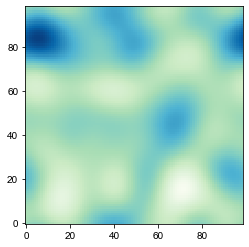

8720 50000 99 0.4243692341301484 0.508828971027449
24490.0 25000.0 24490.0 25000.0


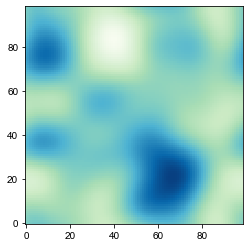

8720 50000 99 0.5087067423806492 -0.0954474715608951
24490.0 25000.0 24490.0 25000.0


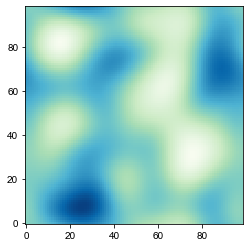

8720 50000 99 0.556556307945396 0.037235371988972324
24490.0 25000.0 24490.0 25000.0


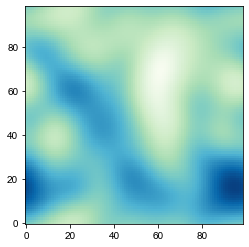

8720 50000 99 0.5366489835590645 0.0849800631920425
24490.0 25000.0 24490.0 25000.0


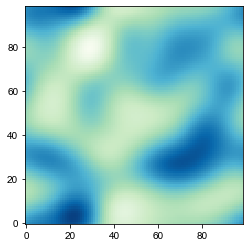

8720 50000 99 0.4875452046909171 0.19992563753769366
24490.0 25000.0 24490.0 25000.0


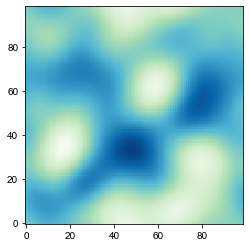

8720 50000 99 0.49993532367596794 -0.10263968979619473
24490.0 25000.0 24490.0 25000.0


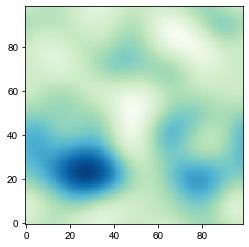

8720 50000 99 0.5389658351853829 0.0757406559578281
24490.0 25000.0 24490.0 25000.0


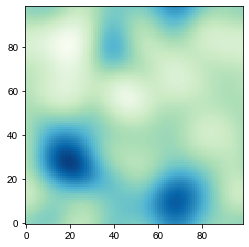

8720 50000 99 0.5555914217944924 0.07071469524849547
24490.0 25000.0 24490.0 25000.0


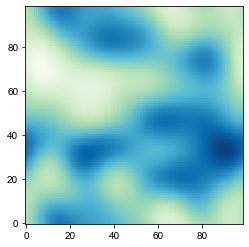

8720 50000 99 0.43434651646044353 -0.061553393411014866
24490.0 25000.0 24490.0 25000.0


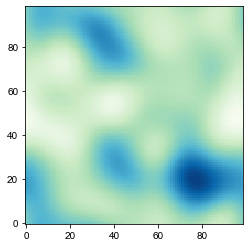

8720 50000 99 0.5751234681367483 0.06593044255818543
24490.0 25000.0 24490.0 25000.0


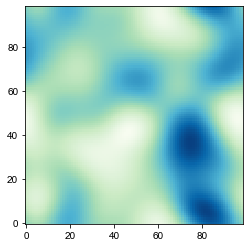

8720 50000 99 0.5824973215537331 -0.0302441188716687
24490.0 25000.0 24490.0 25000.0


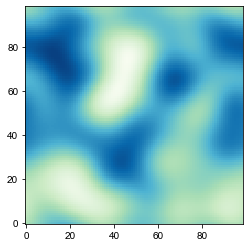

8720 50000 99 0.47126469208104355 0.3133981706287171
24490.0 25000.0 24490.0 25000.0


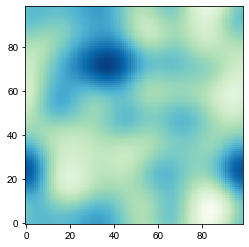

8720 50000 99 0.4564471404824581 0.20882043058654917
24490.0 25000.0 24490.0 25000.0


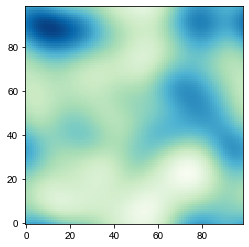

8720 50000 99 0.6264750172698283 0.1695544873712431
24490.0 25000.0 24490.0 25000.0


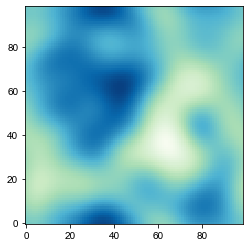

8720 50000 99 0.4453255416714804 -0.2010780126971076
24490.0 25000.0 24490.0 25000.0


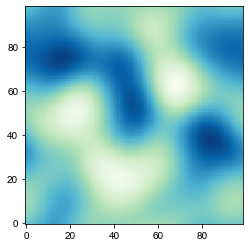

8720 50000 99 0.6733203676416871 0.07533297744377922
24490.0 25000.0 24490.0 25000.0


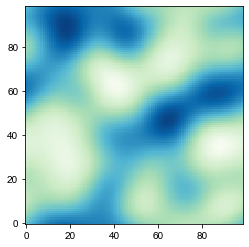

8720 50000 99 0.6095187596011599 0.22744215369537188
24490.0 25000.0 24490.0 25000.0


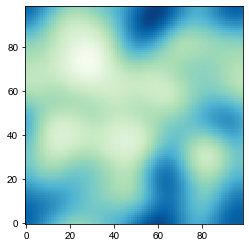

8720 50000 99 0.546390961837403 0.053492516935623666
24490.0 25000.0 24490.0 25000.0


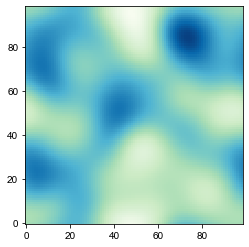

8720 50000 99 0.48072552060484 -0.1490441515368063
24490.0 25000.0 24490.0 25000.0


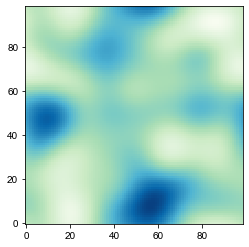

8720 50000 99 0.5321164933827942 -0.14668161912790376
24490.0 25000.0 24490.0 25000.0


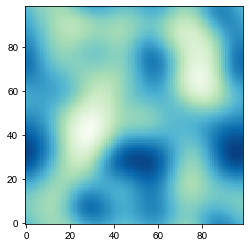

8720 50000 99 0.4631323584096333 0.20555487341992681
24490.0 25000.0 24490.0 25000.0


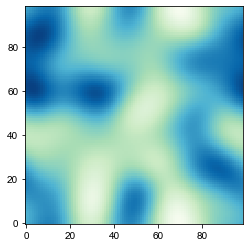

8720 50000 99 0.5616562926161475 -0.2774637576889448
24490.0 25000.0 24490.0 25000.0


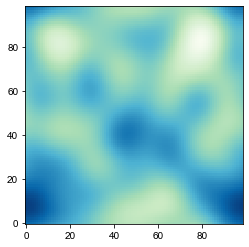

8720 50000 99 0.5010229447741242 0.12314994779855956
24490.0 25000.0 24490.0 25000.0


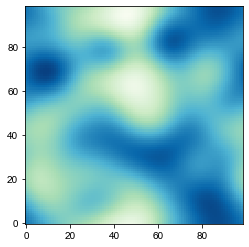

8720 50000 99 0.5388681202411643 0.21587426278289937
24490.0 25000.0 24490.0 25000.0


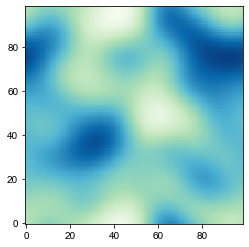

8720 50000 99 0.6303693230716723 0.006957715503764758
24490.0 25000.0 24490.0 25000.0


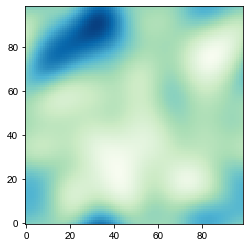

8720 50000 99 0.45512688852484856 -0.13742014753353193
24490.0 25000.0 24490.0 25000.0


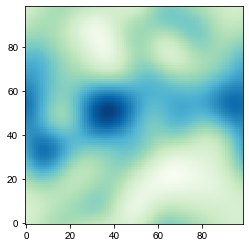

8720 50000 99 0.5767958246521716 0.10254350202933385
24490.0 25000.0 24490.0 25000.0


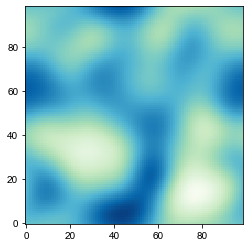

8720 50000 99 0.4906972132497876 0.06694819936193269
24490.0 25000.0 24490.0 25000.0


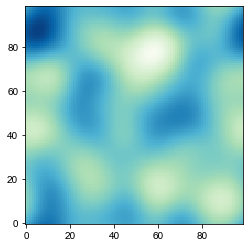

8720 50000 99 0.4123439806016411 0.09279214252986948
24490.0 25000.0 24490.0 25000.0


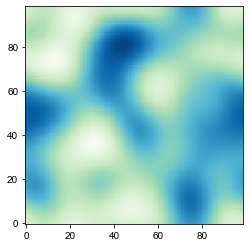

8720 50000 99 0.5132123744749894 -0.06577844399864305
24490.0 25000.0 24490.0 25000.0


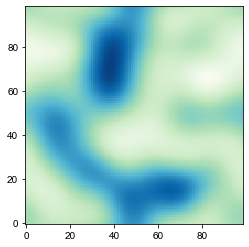

8720 50000 99 0.5082549330752709 -0.06900075494083552
24490.0 25000.0 24490.0 25000.0


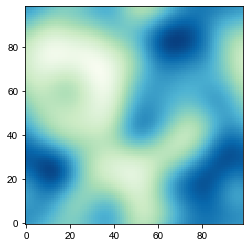

8720 50000 99 0.6965637435018134 0.17944071249266946
24490.0 25000.0 24490.0 25000.0


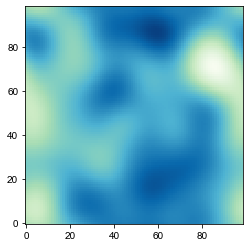

8720 50000 99 0.5723285512835972 -0.09634372083850372
24490.0 25000.0 24490.0 25000.0


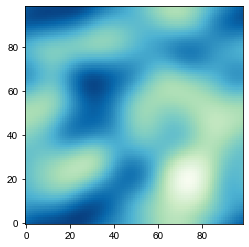

8720 50000 99 0.5784929315793425 0.24877648638117883
24490.0 25000.0 24490.0 25000.0


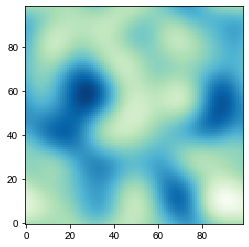

8720 50000 99 0.3716742108783573 -0.11623620980699768
24490.0 25000.0 24490.0 25000.0


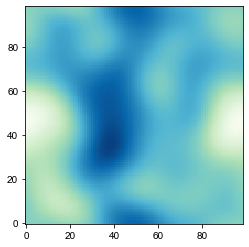

8720 50000 99 0.699954872487653 -0.5936286235247346
24490.0 25000.0 24490.0 25000.0


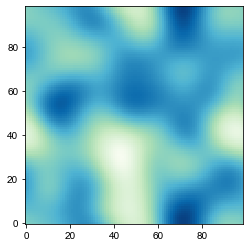

8720 50000 99 0.46792821668279416 -0.14277583917675218
24490.0 25000.0 24490.0 25000.0


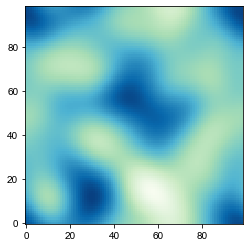

8720 50000 99 0.5869959127701816 0.3795652166109592
24490.0 25000.0 24490.0 25000.0


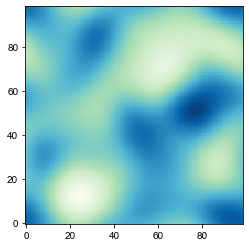

8720 50000 99 0.5602554701395146 -0.025041201132969405
24490.0 25000.0 24490.0 25000.0


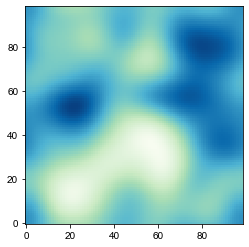

8720 50000 99 0.5477038730168601 0.06771583528843142
24490.0 25000.0 24490.0 25000.0


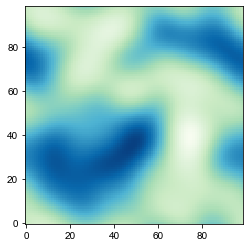

8720 50000 99 0.632778426394386 0.03240420946746425
24490.0 25000.0 24490.0 25000.0


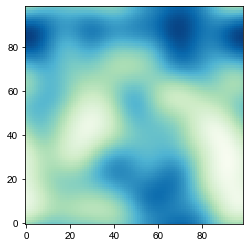

8720 50000 99 0.515861354849657 0.14542219409507795
24490.0 25000.0 24490.0 25000.0


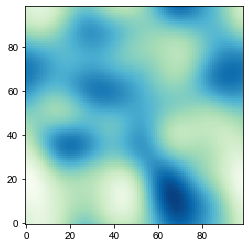

8720 50000 99 0.5917530791320207 -0.023515933943212906
24490.0 25000.0 24490.0 25000.0


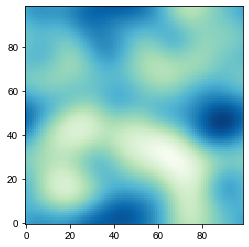

8720 50000 99 0.5116325103846375 -0.037284473308137354
24490.0 25000.0 24490.0 25000.0


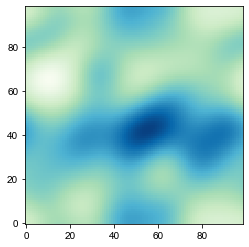

8720 50000 99 0.6742855636841876 -0.012815271471289554
24490.0 25000.0 24490.0 25000.0


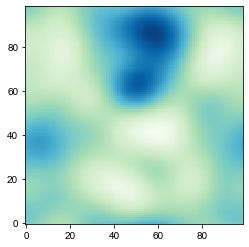

8720 50000 99 0.6129917668265822 -0.10367859485609739
24490.0 25000.0 24490.0 25000.0


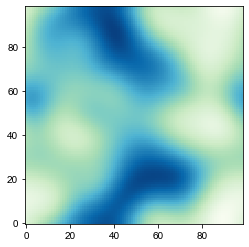

8720 50000 99 0.6378528801640992 0.21307973243148115
24490.0 25000.0 24490.0 25000.0


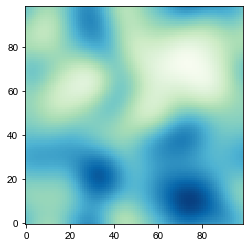

8720 50000 99 0.5993021055035498 -0.001426271008975175
24490.0 25000.0 24490.0 25000.0


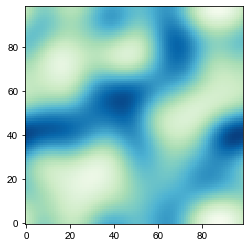

8720 50000 99 0.5105063647419945 0.17764652507794015
24490.0 25000.0 24490.0 25000.0


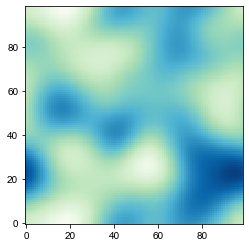

8720 50000 99 0.6002908260066411 -0.06018908936951232
24490.0 25000.0 24490.0 25000.0


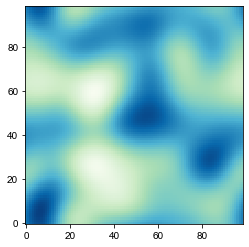

8720 50000 99 0.4516209628014859 0.03715245227970789
24490.0 25000.0 24490.0 25000.0


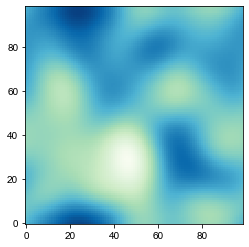

8720 50000 99 0.6387904563200236 -0.06269760192940095
24490.0 25000.0 24490.0 25000.0


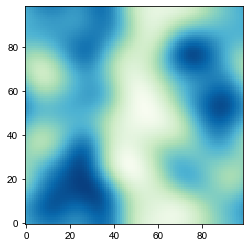

8720 50000 99 0.565519960077043 0.3172659609186691
24490.0 25000.0 24490.0 25000.0


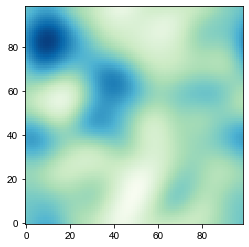

8720 50000 99 0.48463686632293446 0.17192273737463462
24490.0 25000.0 24490.0 25000.0


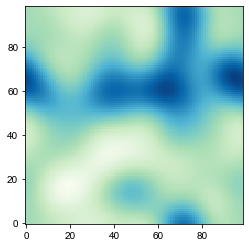

8720 50000 99 0.5796965007717152 0.272288546079811
24490.0 25000.0 24490.0 25000.0


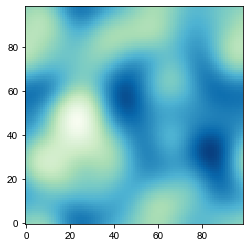

8720 50000 99 0.46768267051273316 0.0659459283741436
24490.0 25000.0 24490.0 25000.0


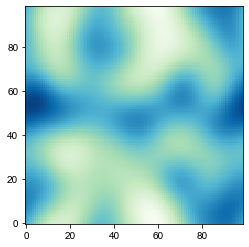

8720 50000 99 0.6424961737320486 -0.2986192400433725
24490.0 25000.0 24490.0 25000.0


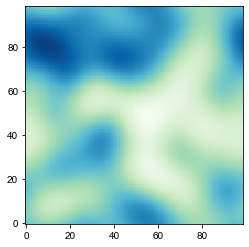

8720 50000 99 0.6301977559054525 -0.12784764101910354
24490.0 25000.0 24490.0 25000.0


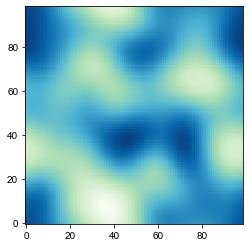

8720 50000 99 0.6133908685974665 -0.22929786100853408
24490.0 25000.0 24490.0 25000.0


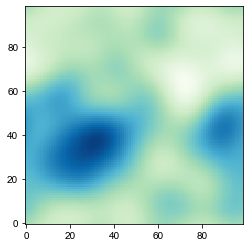

8720 50000 99 0.5898887631476912 0.2626947468906213
24490.0 25000.0 24490.0 25000.0


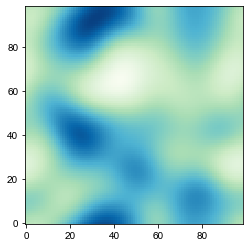

8720 50000 99 0.6537408248405238 -0.3800191073137762
24490.0 25000.0 24490.0 25000.0


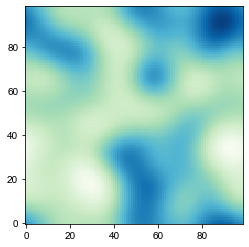

8720 50000 99 0.42515605407013973 -0.44656646402948535
24490.0 25000.0 24490.0 25000.0


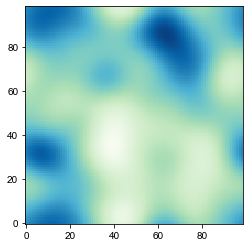

8720 50000 99 0.5568823281453256 -0.002528392185483937
24490.0 25000.0 24490.0 25000.0


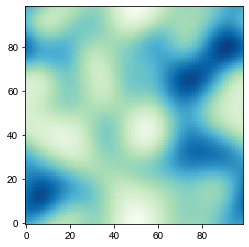

8720 50000 99 0.44295802248241833 0.13198483390772406
24490.0 25000.0 24490.0 25000.0


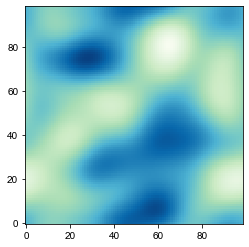

8720 50000 99 0.4920361312001608 0.08125844046098639
24490.0 25000.0 24490.0 25000.0


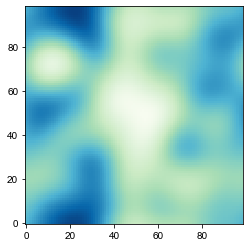

8720 50000 99 0.6958359018315076 0.018524959591556873
24490.0 25000.0 24490.0 25000.0


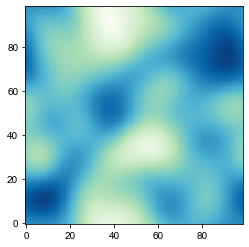

8720 50000 99 0.4818026775519244 -0.06749504067202437
24490.0 25000.0 24490.0 25000.0


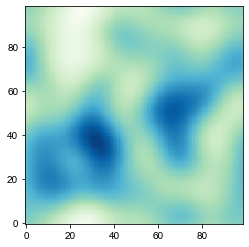

8720 50000 99 0.4659165150562306 -0.07562053116227814
24490.0 25000.0 24490.0 25000.0


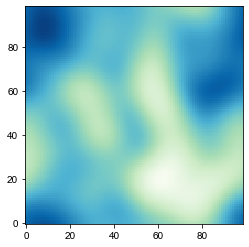

8720 50000 99 0.6526899512083212 -0.15660981440362412
24490.0 25000.0 24490.0 25000.0


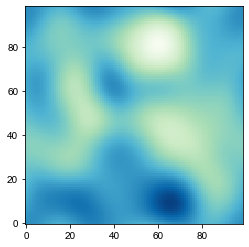

8720 50000 99 0.521609274149887 -0.013764317243429252
24490.0 25000.0 24490.0 25000.0


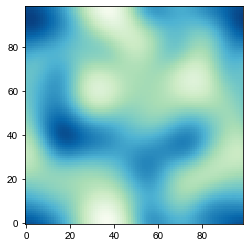

8720 50000 99 0.5402743624045944 -0.19141894094326287
24490.0 25000.0 24490.0 25000.0


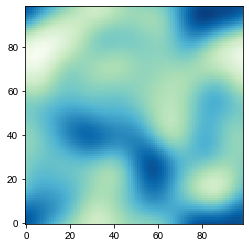

8720 50000 99 0.5573937603214056 -0.10826618879057241
24490.0 25000.0 24490.0 25000.0


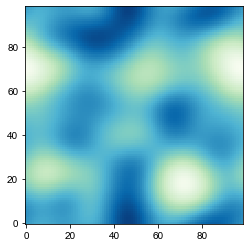

8720 50000 99 0.6028364435021742 -0.02152395093196995
24490.0 25000.0 24490.0 25000.0


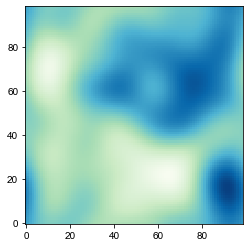

8720 50000 99 0.7203867740129525 -0.3356713409317443
24490.0 25000.0 24490.0 25000.0


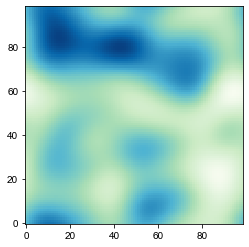

8720 50000 99 0.5444853078068204 0.24820470016129428
24490.0 25000.0 24490.0 25000.0


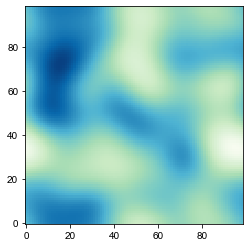

8720 50000 99 0.586715660424904 0.15497062144699633
24490.0 25000.0 24490.0 25000.0


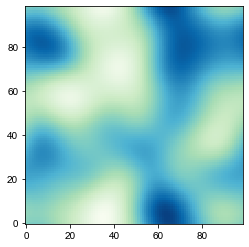

8720 50000 99 0.7597746223403026 0.020207279860344228
24490.0 25000.0 24490.0 25000.0


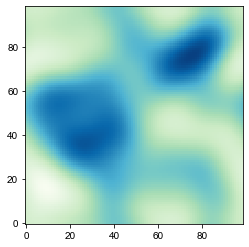

8720 50000 99 0.6223181856366244 0.044594857297838776
24490.0 25000.0 24490.0 25000.0


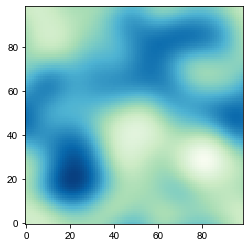

8720 50000 99 0.5350738900909836 -0.18158662627011904
24490.0 25000.0 24490.0 25000.0


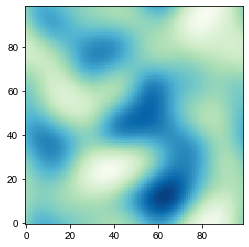

8720 50000 99 0.5087847814424783 0.06578265984465735
24490.0 25000.0 24490.0 25000.0


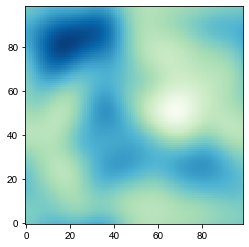

8720 50000 99 0.6527226850080678 0.1170751653545863
24490.0 25000.0 24490.0 25000.0


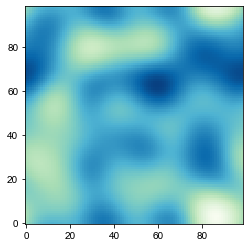

8720 50000 99 0.43462676202603256 0.022154699728597623
24490.0 25000.0 24490.0 25000.0


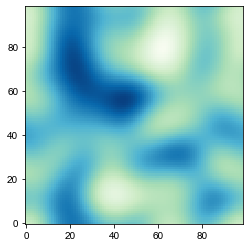

8720 50000 99 0.4856310094565973 -0.11062171239689159
24490.0 25000.0 24490.0 25000.0


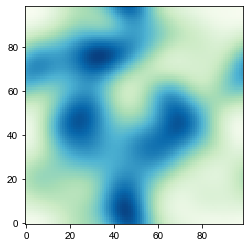

8720 50000 99 0.5352710152643929 -0.055754841078785304
24490.0 25000.0 24490.0 25000.0


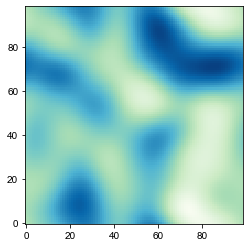

8720 50000 99 0.528091131867242 -0.38291266876613567
24490.0 25000.0 24490.0 25000.0


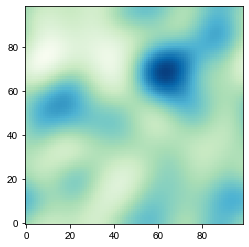

8720 50000 99 0.5161246150991586 0.20816145068478725
24490.0 25000.0 24490.0 25000.0


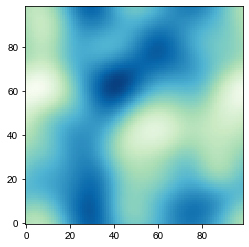

8720 50000 99 0.6736438535569693 -0.07283203099792153
24490.0 25000.0 24490.0 25000.0


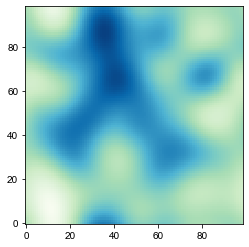

8720 50000 99 0.5406550277543793 0.1746929969756351
24490.0 25000.0 24490.0 25000.0


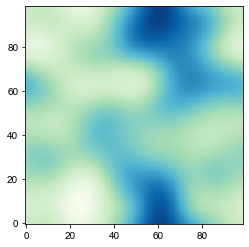

8720 50000 99 0.6920420265254299 0.12950707191102553
24490.0 25000.0 24490.0 25000.0


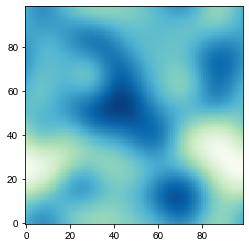

8720 50000 99 0.5789284279893105 -0.08580389791549906
24490.0 25000.0 24490.0 25000.0


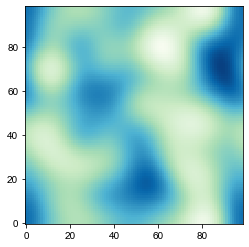

8720 50000 99 0.46024227171177234 -0.010411456592934482
24490.0 25000.0 24490.0 25000.0


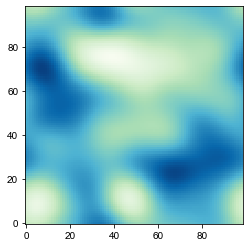

8720 50000 99 0.4984478814883933 -0.15255085672392654
24490.0 25000.0 24490.0 25000.0


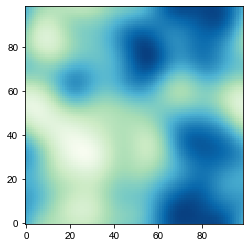

8720 50000 99 0.5727226522655895 0.30231554745017364
24490.0 25000.0 24490.0 25000.0


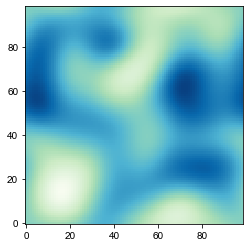

8720 50000 99 0.6270442313166685 0.023494844942793403
24490.0 25000.0 24490.0 25000.0


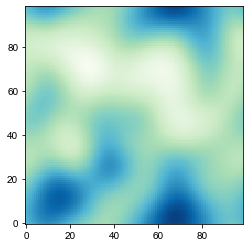

8720 50000 99 0.6106689015194183 0.23617479079670908
24490.0 25000.0 24490.0 25000.0


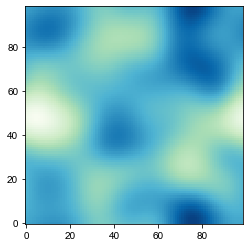

8720 50000 99 0.6775719106772355 -0.13037081761738184
24490.0 25000.0 24490.0 25000.0


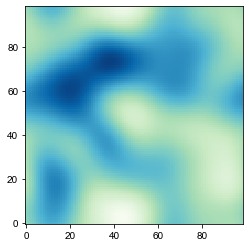

8720 50000 99 0.6556605651995014 -0.07976479762496916
24490.0 25000.0 24490.0 25000.0


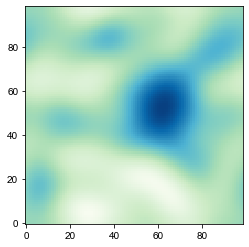

8720 50000 99 0.6213071638882602 -0.20045226704172417
24490.0 25000.0 24490.0 25000.0


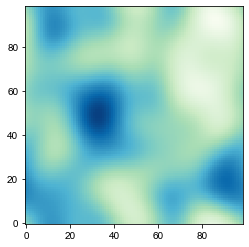

8720 50000 99 0.5490109818856815 -0.1018861901036054
24490.0 25000.0 24490.0 25000.0


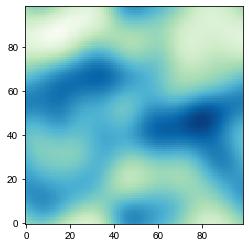

8720 50000 99 0.5486788635732477 -0.06677490209106544
24490.0 25000.0 24490.0 25000.0


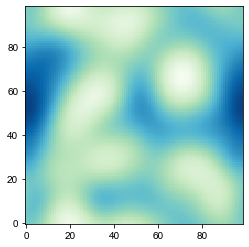

8720 50000 99 0.5667437151796755 -0.037682565071166865
24490.0 25000.0 24490.0 25000.0


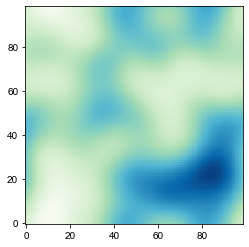

8720 50000 99 0.5845841131135185 0.0007755997515154192


In [26]:
h = 0.585 #nm 
cl = 8720 #microns


# cl*3 is what we are interested in so make our multiplier a multiple of 3
cl_ml =3

multiplier = int(cl_ml*round(12/cl_ml))

rL =  50000#int(multiplier * cl)

#510
N = int(rL/510)+1#2*int( np.ceil(rL/(multiplier/2))) #number of points

plot = 'y'

wafer_x_val = [] # x coordinates from wafer measurements
wafer_y_val = [] # y coordinates from wafer measurements
[wafer_x_val.append(each) for each in tot_hx_array if each not in wafer_x_val]
[wafer_y_val.append(each) for each in tot_hy_array if each not in wafer_y_val]
wafer_x_val = np.sort(wafer_x_val, axis=None, kind='mergesort')
wafer_y_val = np.sort(wafer_y_val, axis=None, kind='mergesort')

while True:
    waferx, wafery, waferf = surfgen2D(N, rL, h, cl, wafer_x_val, wafer_y_val, plot)
    print(cl, rL, N, np.std(waferf), np.mean(waferf))
    if(np.std(waferf)>h-0.005 and np.std(waferf)<h+0.005 and np.mean(waferf)>-0.01 and np.mean(waferf)<0.01):
        break



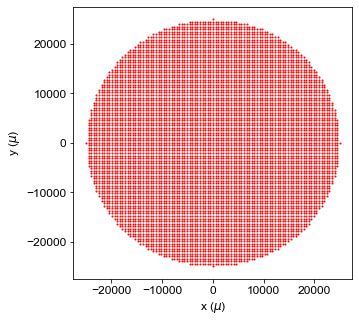

7525 7525


(0.040385039131791416, 0.5579703129801861)

In [178]:
##################################
#Virtual Wafer

origin = [0, 0]
radius = 25000
tot_hx_array = []
tot_hy_array = []
tot_dh = []
for i in range(len(waferx)):
    for j in range(len(wafery)):
        temp_x = waferx[i,j]
        temp_y = wafery[i,j]
        if(np.sqrt(temp_x**2 + temp_y**2) <= radius):
                tot_hx_array.append(temp_x)
                tot_hy_array.append(temp_y)
                tot_dh.append(waferf[i,j])

fig = plt.figure()
plt.plot(tot_hx_array, tot_hy_array, 'ro', markersize = 1)
#plt.plot(tot_hx_arr, tot_hy_arr, 'bx', markersize = 1)
fig.set_size_inches(5,5)
plt.xlabel(r'x ($\mu$)')
plt.ylabel(r'y ($\mu$)')
plt.show()

print(len(tot_dh), len(tot_dh))
#np.save('raw_wafer_data',[tot_hx_array, tot_hy_array, tot_dh])

np.mean(tot_dh), np.std(tot_dh)

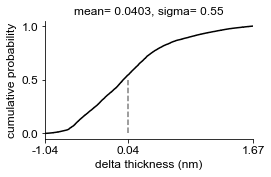

In [179]:
temp_data = tot_dh
fig = plt.figure()
h, edges = np.histogram(temp_data, density=False, bins=len(temp_data))
h = np.cumsum(h)/np.cumsum(h).max()
X = edges.repeat(2)[:-1]
y = np.zeros_like(X)
y[1:] = h.repeat(2)
plt.plot(X, y, 'k')
plt.plot([round(np.mean(temp_data),2), round(np.mean(temp_data),2)],[0, 0.5], linestyle='--', color= 'grey')
plt.xlim(left =min(temp_data), right= max(temp_data))
plt.xticks([round(min(temp_data),2), np.mean(temp_data), round(max(temp_data),2)], [round(min(temp_data),2), round(np.mean(temp_data),2), round(max(temp_data),2)])
plt.yticks([0, 0.5, 1])
plt.xlabel('delta thickness (nm)')
plt.ylabel('cumulative probability', fontsize=12)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().yaxis.set_ticks_position('left')
plt.gca().xaxis.set_ticks_position('bottom')

#plt.title('mean = '+str(np.mean(temp_data))[0:5]+' (nm), sigma = '+ str(np.std(temp_data))[0:5]+' (nm)', fontsize = 18)
fig.set_size_inches(1.5*2.625, 2.625)
plt.title('mean= ' +str(np.mean(temp_data))[:6]+', sigma= ' + str(np.std(temp_data))[:4], fontsize=12)
plt.tight_layout()
#plt.savefig('die_mean_sigma.pdf', dpi=600)

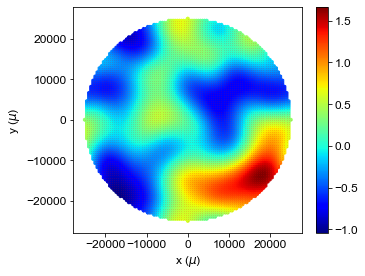

0.040385039131791416 0.5579703129801861


In [234]:
#select a wafer slice

origin_places = [-13500, -4500, 4500, 13500] #

origin = [0,origin_places[3]]
xspan = 300000
yspan = 90000
tot_hx_arr = []
tot_hy_arr = []
all_dh = []
for i in range(len(tot_hx_array)):
    temp_x = tot_hx_array[i]
    temp_y = tot_hy_array[i]
    
    if(temp_x >= origin[0]-(xspan/2) and temp_x< origin[0]+(xspan/2)):
        if(temp_y >= origin[1]-(yspan/2) and temp_y< origin[1]+(yspan/2)):
            tot_hx_arr.append(temp_x)
            tot_hy_arr.append(temp_y)
            all_dh.append(tot_dh[i])
np.mean(all_dh), np.std(all_dh)
fig = plt.figure()
plt.plot(tot_hx_array, tot_hy_array, 'rx', markersize = .05)
#plt.plot(tot_hx_arr, tot_hy_arr, 'bx', markersize = 1)
plt.scatter( tot_hx_arr, tot_hy_arr,  c = all_dh, s=10,  cmap = 'jet', marker = 'h')
fig.set_size_inches(5.25,4)
plt.colorbar()
plt.tight_layout()
plt.xlabel(r'x ($\mu$)')
plt.ylabel(r'y ($\mu$)')
plt.tight_layout()
#plt.xlim(left=-24495, right=-24485)
#plt.ylim(top=10, bottom = -10)
#plt.savefig('./images/slice_map.png', dpi=300)
plt.show()

print(np.mean(all_dh), np.std(all_dh))

<Figure size 432x288 with 0 Axes>

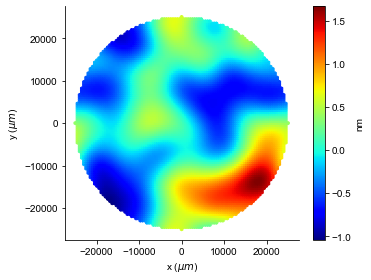

In [109]:
fig = plt.figure()
ogfig = plt.figure()
fig = plt.subplot(111)
plt.scatter( tot_hx_array, tot_hy_array,  c = tot_dh, s=10,  cmap = 'jet', marker = 'h')
ogfig.set_size_inches(5.25, 4)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().yaxis.set_ticks_position('left')
plt.gca().xaxis.set_ticks_position('bottom')
plt.xlabel(r'x ($\mu m$)')
plt.ylabel(r'y ($\mu m$)')
plt.tight_layout()
colorbar = plt.colorbar()
colorbar.set_label('nm')
plt.tight_layout()
plt.show()


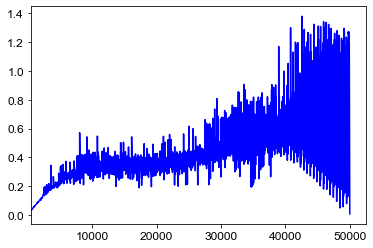

In [235]:
#for each pair generate absolute difference between heights

rh_pair = [[], []]
count = 0
for i in tqdm_notebook(range(len(tot_hx_arr))):
    for j in range(i+1,len(tot_hx_arr),1):
        e = np.sqrt((tot_hx_arr[i] - tot_hx_arr[j])**2 + (tot_hy_arr[i] - tot_hy_arr[j])**2)        
        #rh = np.sqrt((all_dh[i] - all_dh[j])**2)
        rh = abs(all_dh[i]**2 - all_dh[j]**2)
    
        rh_pair[0].append(e)
        rh_pair[1].append(rh)
        
bin_size = 1

#generate limits as arrays
ranges = []
for max_limit in range(0, int(max(rh_pair[0])), bin_size):
    ranges.append([max_limit, max_limit+bin_size,  [], []])

avg_h = [[], []]



#n times add them in the appropriate dictionaries
for i in tqdm_notebook(range(len(rh_pair[0]))):
    each_val = rh_pair[0][i]
    #print(i, len(rh_pair[0]))
    #binary search to find the best match
    left = 0
    right = len(ranges)-1
    while True:
        arr_idx = int(round((left+right)/2))
        if(each_val >= ranges[arr_idx][0] and each_val < ranges[arr_idx][1]):
            break
            
        else:
            if(each_val < ranges[arr_idx][0]):
                if(arr_idx > 0):
                    right = arr_idx -1
                else:
                    break
            elif(each_val >= ranges[arr_idx][1]):
                if(arr_idx < len(ranges)-1):
                    left = arr_idx + 1
                else:
                    break
                    
    ranges[arr_idx][2].append(rh_pair[1][i])
    ranges[arr_idx][3].append(rh_pair[0][i])

    
for i in range(len(ranges)):
        if(len(ranges[i][2])>0):
            avg_h[0].append(np.mean(ranges[i][3]))
            avg_h[1].append(np.mean(ranges[i][2]))
        
#print(max(avg_h))
plt.plot(avg_h[0], avg_h[1], 'b')
#plt.plot([cl,cl], [min(avg_h[1]),max(avg_h[1])], 'y')
#plt.plot(avg_h[0], avg_h_median, 'r',alpha=0.2)
plt.xlim(left = min(avg_h[0]))

plt.show()




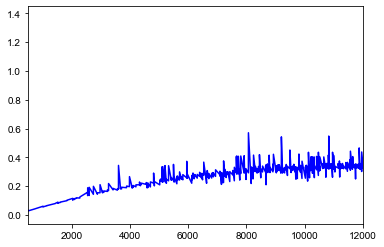

In [31]:
plt.plot(avg_h[0], avg_h[1], 'b')
#plt.plot([cl,cl], [min(avg_h[1]),max(avg_h[1])], 'y')
#plt.plot(avg_h[0], avg_h_median, 'r',alpha=0.2)
plt.xlim(left = min(avg_h[0]),right=12000)
plt.show()


Parameters [ 4.7331297   0.32050902 -0.08548655]
RMSE: 0.04399021022830761
R-squared: 0.9612542602639466
DIV 156


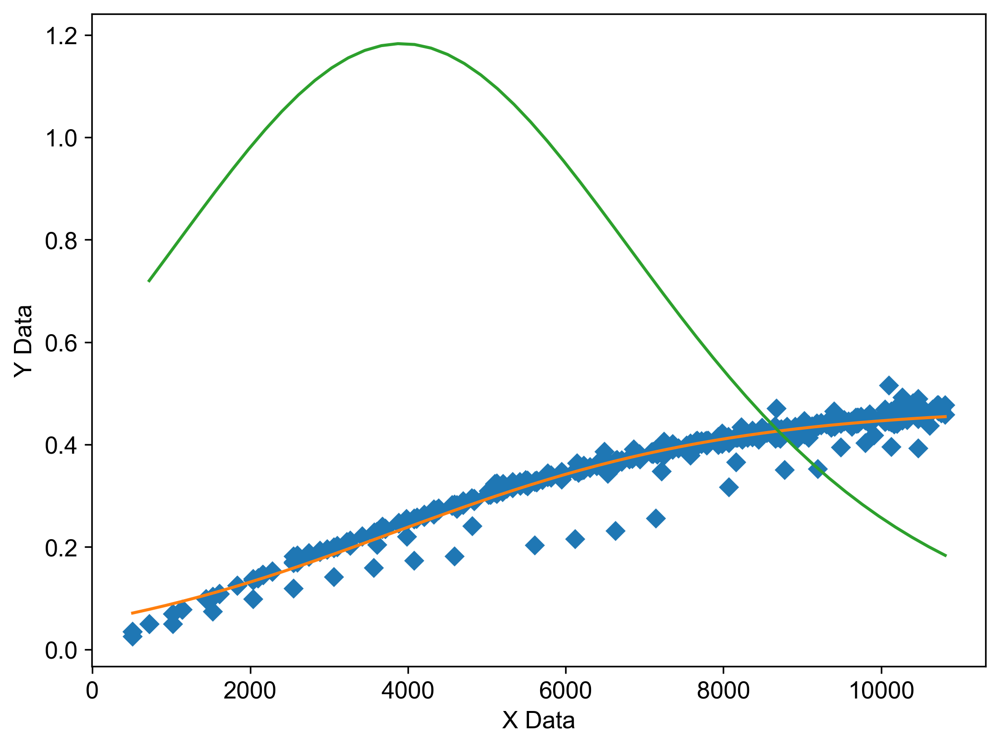


0.9 = 7926.95392730728 , 0.925 = 8407.188354255233 , 0.95 = 8988.424466235892 , 0.975 = 9735.45579704382 , 
1 = 10322.408985535762 , 


In [249]:
#you might have to tweak the tolerance and range to get better estimations

import numpy, scipy, matplotlib
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.optimize import differential_evolution
import warnings

graphWidth = 800
graphHeight = 600

##########################################################
# graphics output section
def ModelAndScatterPlot(xData, yData, xscale, yscale, graphWidth, graphHeight, plot='y'):


    # create data for the fitted equation plot
    xModel = numpy.linspace(min(xData), max(xData))
    yModel = func(xModel, *fittedParameters)
    
    ydiff = np.diff(yModel)/np.diff(xModel)
    if(np.argmin(ydiff>=0.185)>0): #TOLERANCE
        fit = 1
    else:
        fit = 0
    if(plot=='y'):
        f = plt.figure(figsize=(graphWidth/100.0, graphHeight/100.0), dpi=300)
        axes = f.add_subplot(111)
        #xData = xData*xscale
        #yData=  yData*yscale
        # first the raw data as a scatter plot
        axes.plot((xData*(xscale[1]-xscale[0])) + xscale[0], (yData*(yscale[1]-yscale[0])) + yscale[0],  'D')    
        # now the model as a line plot
        axes.plot((xModel*(xscale[1]-xscale[0])) + xscale[0], (yModel*(yscale[1]-yscale[0])) + yscale[0])
        axes.plot((xModel[1:]*(xscale[1]-xscale[0])) + xscale[0], ydiff)

        axes.set_xlabel('X Data') # X axis data label
        axes.set_ylabel('Y Data') # Y axis data label

        plt.show()
        plt.close('all') # clean up after using pyplot
    
    return (xModel*(xscale[1]-xscale[0])) + xscale[0], (yModel*(yscale[1]-yscale[0])) + yscale[0], fit


def func(x, a, b, Offset): # Sigmoid A With Offset from zunzun.com
    return  1.0 / (1.0 + numpy.exp(-a * (x-b))) + Offset


# function for genetic algorithm to minimize (sum of squared error)
def sumOfSquaredError(parameterTuple):
    warnings.filterwarnings("ignore") # do not print warnings by genetic algorithm
    val = func(xData, *parameterTuple)
    return numpy.sum((yData - val) ** 2.0)


def generate_Initial_Parameters():
    # min and max used for bounds
    maxX = max(xData)
    minX = min(xData)
    maxY = max(yData)
    minY = min(yData)

    parameterBounds = []
    parameterBounds.append([minX, maxX]) # seach bounds for a
    parameterBounds.append([minX, maxX]) # seach bounds for b
    parameterBounds.append([minX, maxY]) # seach bounds for Offset

    # "seed" the numpy random number generator for repeatable results
    result = differential_evolution(sumOfSquaredError, parameterBounds, seed=3)
    return result.x
    
rsquared_arr = []
div_arr = []


for div in tqdm_notebook(range(50,200,1)): #RANGE
    divisor = div/10
    xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
    #normalize
    max_x = max(xData)
    min_x = min(xData)
    
    xData = (xData - min_x)/(max_x - min_x)

    yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
    max_y = max(yData)
    min_y = min(yData)
    #scaley = max(yData)
    yData = (yData - min_y)/(max_y - min_y)



    # generate initial parameter values
    geneticParameters = generate_Initial_Parameters()

    # curve fit the test data
    fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

    #print('Parameters', fittedParameters)

    modelPredictions = func(xData, *fittedParameters) 

    absError = modelPredictions - yData

    SE = numpy.square(absError) # squared errors
    MSE = numpy.mean(SE) # mean squared errors
    RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
    Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
    xfit, yfit, tempfit = ModelAndScatterPlot(xData, yData, [min_x, max_x], [min_y, max_y], graphWidth, graphHeight, 'n')
    if(tempfit ==1):
        rsquared_arr.append(Rsquared)
        div_arr.append(div)
        #print('RMSE:', RMSE)
        #print('R-squared:', Rsquared)
    #print()
    #xfit, yfit = ModelAndScatterPlot(xData, yData, scalex, scaley, graphWidth, graphHeight)

#idx = len(rsquared_arr)-1#rsquared_arr.index(max(rsquared_arr))
div = div_arr[-1]
divisor = div/10
xData = np.array(avg_h[0][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([19.1647, 18.0189, 16.9550, 15.7683, 14.7044, 13.6269, 12.6040, 11.4309, 10.2987, 9.23465, 8.18440, 7.89789, 7.62498, 7.36571, 7.01106, 6.71094, 6.46548, 6.27436, 6.16543, 6.05569, 5.91904, 5.78247, 5.53661, 4.85425, 4.29468, 3.74888, 3.16206, 2.58882, 1.93371, 1.52426, 1.14211, 0.719035, 0.377708, 0.0226971, -0.223181, -0.537231, -0.878491, -1.27484, -1.45266, -1.57583, -1.61717])
#normalize
max_x = max(xData)
min_x = min(xData)

xData = (xData - min_x)/(max_x - min_x)

yData = np.array(avg_h[1][0:int(len(avg_h[0])/divisor)], dtype='float')#numpy.array([0.644557, 0.641059, 0.637555, 0.634059, 0.634135, 0.631825, 0.631899, 0.627209, 0.622516, 0.617818, 0.616103, 0.613736, 0.610175, 0.606613, 0.605445, 0.603676, 0.604887, 0.600127, 0.604909, 0.588207, 0.581056, 0.576292, 0.566761, 0.555472, 0.545367, 0.538842, 0.529336, 0.518635, 0.506747, 0.499018, 0.491885, 0.484754, 0.475230, 0.464514, 0.454387, 0.444861, 0.437128, 0.415076, 0.401363, 0.390034, 0.378698])
max_y = max(yData)
min_y = min(yData)
#scaley = max(yData)
yData = (yData - min_y)/(max_y - min_y)


# generate initial parameter values
geneticParameters = generate_Initial_Parameters()

# curve fit the test data
fittedParameters, pcov = curve_fit(func, xData, yData, geneticParameters)

print('Parameters', fittedParameters)

modelPredictions = func(xData, *fittedParameters) 

absError = modelPredictions - yData

SE = numpy.square(absError) # squared errors
MSE = numpy.mean(SE) # mean squared errors
RMSE = numpy.sqrt(MSE) # Root Mean Squared Error, RMSE
Rsquared = 1.0 - (numpy.var(absError) / numpy.var(yData))
print('RMSE:', RMSE)
print('R-squared:', Rsquared)
print('DIV', div)
rsquared_arr.append(Rsquared)
div_arr.append(div)
xofit, yofit, fit = ModelAndScatterPlot(xData, yData, [min_x, max_x], [min_y, max_y], graphWidth, graphHeight)


xfit = (xData*(max_x - min_x)) + min_x
yfit = (modelPredictions*(max_y - min_y)) + min_y

func = interpolate.interp1d(xfit, yfit)
xnew = np.linspace(min(xfit), max(xfit), max(xfit)+1)
ynew = func(xnew)
#plt.plot(xnew, ynew,'b')
maxz_idx = np.argmax(ynew > 0.9 * max(ynew))

#print(xnew[maxz_idx])
print('')
print(0.9, '=',xnew[np.argmax(ynew >= 0.9 * max(ynew))],', ', end='')
print(0.925, '=', xnew[np.argmax(ynew >= 0.925 * max(ynew))], ', ', end='')
print(0.95, '=',  xnew[np.argmax(ynew >= 0.95 * max(ynew))], ', ', end= '')
print(0.975, '=', xnew[np.argmax(ynew >= 0.975 * max(ynew))], ', ')
print(1, '=', xnew[np.argmax(ynew >= 0.99 * max(ynew))], ', ')

In [247]:
#virtualwafer = avg_h
avg_h = virtualwafer
avg_h[0][int(len(avg_h[0])/10)]
#print(1, '=', xnew[np.argmax(ynew >= 0.99 * max(ynew))], ', ')

13926.222442369259

Text(0.5, 1.0, 'E[cl] = 6154 um')

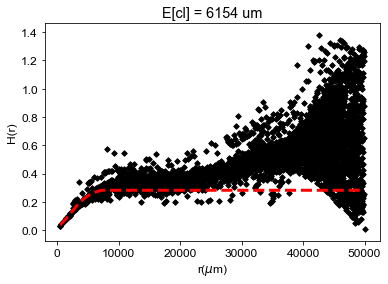

In [237]:
#experimental_avg = avg_h
#avg_h = experimental_avg
avg_h[0][int(len(avg_h[0])/16)]
#print(result_sq_diff)
#plt.axvline(x=10047)
plt.scatter(avg_h[0], avg_h[1], color = 'k', s=15, marker = 'D')
plt.plot(np.concatenate((xfit, [max(avg_h[0])])), np.concatenate((yfit, [max(yfit)])), color = 'r', linewidth =3, linestyle='--')
#plt.xlim(right=20000)
plt.xlabel('r($\mu$m)')
plt.ylabel('H(r)')
plt.title(str('E[cl] = '+ str(int(xnew[np.argmax(ynew >= 0.95 * max(ynew))]))+' um'))

In [185]:
xx = []
xy = []

for each in ranges:
    if(len(each[2])>0):
        xx.append(np.mean(each[3]))
        xy.append(len(each[2])/np.sum(each[2]))


0.0602798134006499 3609.0730111761386


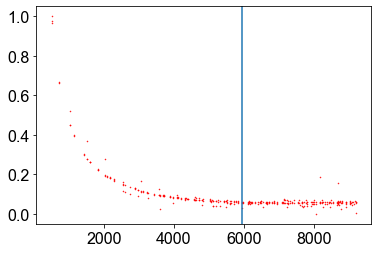

In [186]:
sel_range = 300
sel_xy = np.array(xy[0:sel_range])
sel_xy = (np.array(sel_xy)-min(sel_xy))/(max(sel_xy)-min(sel_xy))
#print(len(sel_xy))

plt.scatter(xx[0:sel_range],sel_xy, color= 'r', s=0.25)
#plt.scatter(avg_h[0], 2*np.array(avg_h[1]), color='b', s=0.25)
plt.axvline(x=cl)
print(sel_xy[np.argmax(np.array(xx)>=cl)], xx[np.argmax(np.array(sel_xy)<=0.04)])